In [1]:
import numpy as np
import pandas as pd
import datetime as dt
import matplotlib.pyplot as plt
import csv
from datetime import date, timedelta
import warnings
warnings.filterwarnings('ignore')
warnings.filterwarnings("ignore")
import itertools
%matplotlib inline

In [2]:
#from sklearn.utils import check_arrays
def mean_absolute_percentage_error(y_true, y_pred): 
  #  y_true, y_pred = check_arrays(y_true, y_pred)

    ## Note: does not handle mix 1d representation
    #if _is_1d(y_true): 
    #    y_true, y_pred = _check_1d_array(y_true, y_pred)

    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100

In [3]:
#Loading the train, empty_test and Parameters_complete csv file
df=pd.read_csv('training_data.csv')
df_test=pd.read_csv('empty_test_sheet.csv')
combine_parameter=pd.read_csv('Parameters_complete.csv')

In [4]:
### Testing For Stationarity and model prediction
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
import statsmodels.api as sm
from statsmodels.tsa.arima_model import ARIMA
from statsmodels.tsa.stattools import adfuller

In [5]:
#no. of different variabels in train dataset
a = df.columns
print(a)
for i in a:
    print(df[i].unique())
    print(len(df[i].unique()))

Index(['Account-Mapping', 'Acc2-Mapping', 'Version', 'Year-mapping',
       'Month-mapping', 'Region-Mapping', 'Market-Mapping', 'Adj_Value_Sum'],
      dtype='object')
['Advertising and Promotion' 'Gross Profit' 'Inventory' 'Net Sales'
 'Operating Profit' 'Payables and Accruals' 'Receivables'
 'Returns and Rebates']
8
['P&L' 'Working Capital']
2
['ACT' 'PLN']
2
['Y1' 'Y2' 'Y3' 'Y4' 'Y5' 'Y6']
6
['M02' 'M03' 'M04' 'M05' 'M06' 'M07' 'M08' 'M09' 'M10' 'M11' 'M12']
11
['A' 'B' 'C' 'D' 'E' 'G' 'F']
7
['A01' 'A03' 'B01' 'B03' 'B05' 'B06' 'B08' 'B17' 'B19' 'B23' 'B25' 'B27'
 'C02' 'C06' 'D01' 'D04' 'E04' 'E07' 'E09' 'E12' 'E16' 'G01' 'G08' 'G10'
 'G12' 'E11' 'B07' 'A05' 'B13' 'B14' 'B15' 'B16' 'B21' 'B22' 'C04' 'C08'
 'C09' 'D06' 'D10' 'D11' 'D12' 'E03' 'E08' 'E18' 'F02' 'F04' 'F05' 'G04'
 'G05' 'G06' 'D05' 'E02' 'F03' 'E06' 'B28' 'D07' 'B12' 'C01' 'C05' 'D03'
 'E15' 'E01' 'B11' 'B26' 'G02' 'G03' 'F01' 'G11' 'A02' 'A04' 'B02' 'B04'
 'B09' 'B18' 'B20' 'B24' 'C03' 'C07' 'D08' 'D09' 'E05' 'E10'

In [6]:
#no. of different variables in test dataset
a = df_test.columns
print(a)
for i in a:
    print(df_test[i].unique())
    print(len(df_test[i].unique()))

Index(['Account-Mapping', 'Acc2-Mapping', 'Version', 'Year-mapping',
       'Month-mapping', 'Region-Mapping', 'Market-Mapping', 'Adj_Value_Sum'],
      dtype='object')
['Inventory' 'Payables and Accruals' 'Receivables' 'Returns and Rebates']
4
['Working Capital']
1
['ACT']
1
['Y6']
1
['M03' 'M04' 'M05' 'M06']
4
['A' 'B' 'C' 'D' 'E' 'F' 'G']
7
['A01' 'A03' 'B01' 'B03' 'B05' 'B07' 'B08' 'B11' 'B13' 'B15' 'B17' 'B22'
 'B23' 'B25' 'B27' 'C01' 'C04' 'C05' 'C06' 'C09' 'D03' 'D06' 'D10' 'E01'
 'E04' 'E11' 'E15' 'E16' 'E18' 'F02' 'F04' 'F05' 'G01' 'G03' 'G05' 'G08'
 'G10' 'G12' 'E09' 'G07' 'B19' 'A02' 'B02' 'B04' 'B09' 'B12' 'B16' 'B18'
 'B20' 'B21' 'B24' 'B28' 'C02' 'C03' 'C08' 'D04' 'D05' 'D07' 'E10' 'E12'
 'E13' 'E17' 'F03' 'G02' 'G04' 'G06' 'G11' 'G13' 'E02' 'E03']
70
[nan]
1


56 A01 Inventory
for these parameters -  (1, 0, 0) t (2, 0, 0, 4)  this -  6.712453201598971 is MAPE ERROR calculated for last five available forecasting values


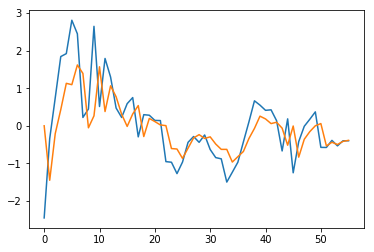

56 A03 Inventory
for these parameters -  (2, 0, 1) n (2, 1, 1, 1)  this -  234.29478243555343 is MAPE ERROR calculated for last five available forecasting values


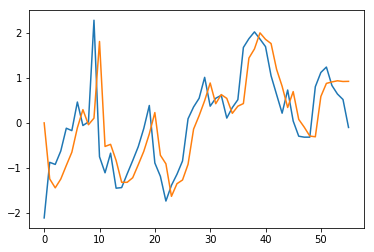

56 B01 Inventory
for these parameters -  (0, 1, 0) c (2, 0, 0, 7)  this -  9.882913462460477 is MAPE ERROR calculated for last five available forecasting values


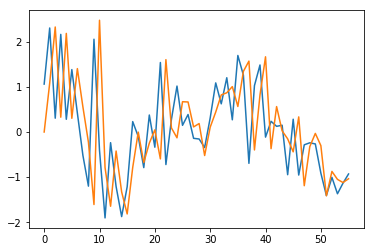

56 B03 Inventory
for these parameters -  (2, 1, 0) ct (2, 0, 1, 1)  this -  150.48521681280843 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


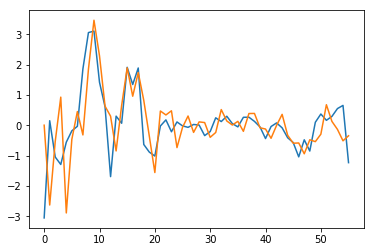

48 B05 Inventory
for these parameters -  (1, 0, 1) t (1, 1, 1, 4)  this -  38.00177202686893 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


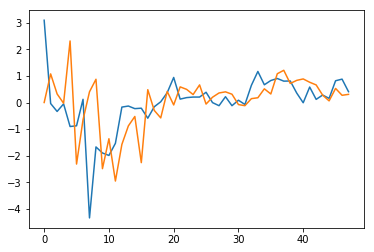

23 B07 Inventory
for these parameters -  (1, 0, 0) n (2, 0, 0, 3)  this -  67.23379477188516 is MAPE ERROR calculated for last five available forecasting values


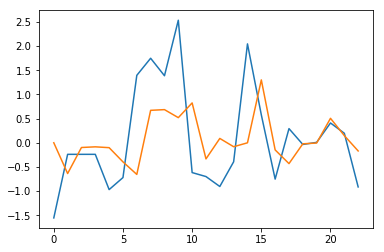

56 B08 Inventory
for these parameters -  (0, 0, 0) t (1, 0, 0, 9)  this -  22.114621744170922 is MAPE ERROR calculated for last five available forecasting values


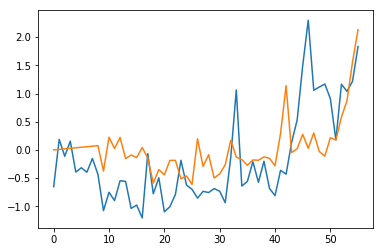

5 B11 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


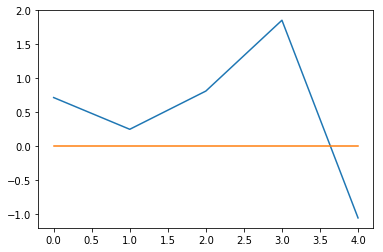

56 B13 Inventory
for these parameters -  (1, 1, 0) t (1, 1, 0, 1)  this -  163.69602410114373 is MAPE ERROR calculated for last five available forecasting values


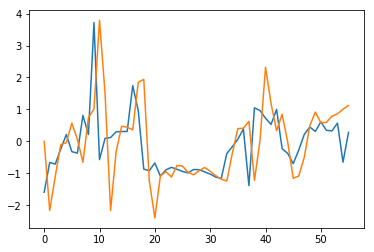

56 B15 Inventory
for these parameters -  (2, 1, 1) n (0, 1, 0, 8)  this -  28.669826759401516 is MAPE ERROR calculated for last five available forecasting values


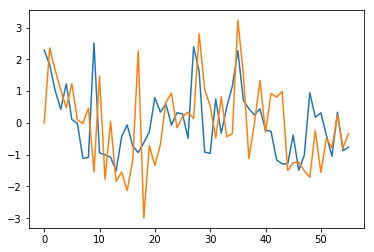

56 B17 Inventory
for these parameters -  (2, 0, 1) t (1, 1, 0, 1)  this -  132.1454478751106 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


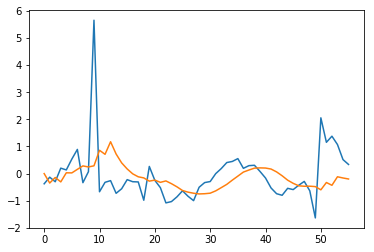

56 B22 Inventory
for these parameters -  (2, 0, 0) c (0, 1, 0, 3)  this -  14.153550957758751 is MAPE ERROR calculated for last five available forecasting values


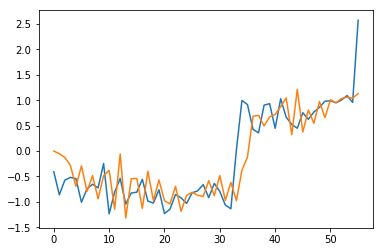

56 B23 Inventory
for these parameters -  (0, 1, 0) n (0, 1, 1, 3)  this -  5.404493790041881 is MAPE ERROR calculated for last five available forecasting values


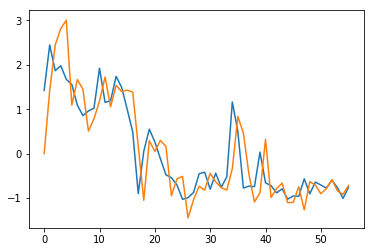

56 B25 Inventory
for these parameters -  (2, 0, 1) t (2, 0, 0, 3)  this -  39.30770849431918 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


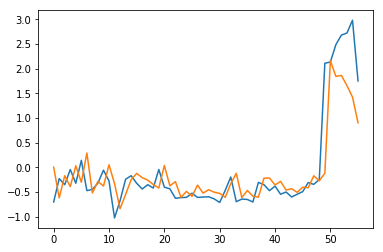

56 B27 Inventory
for these parameters -  (1, 0, 0) c (0, 1, 0, 9)  this -  9.124413003862287 is MAPE ERROR calculated for last five available forecasting values


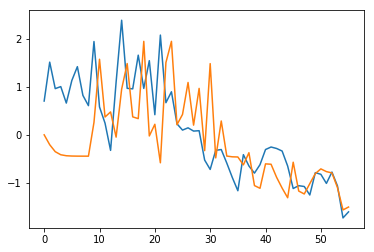

24 C01 Inventory
for these parameters -  (0, 0, 1) n (1, 0, 1, 4)  this -  13.256973156470469 is MAPE ERROR calculated for last five available forecasting values


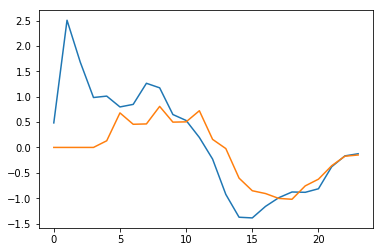

56 C04 Inventory
for these parameters -  (0, 0, 1) c (2, 1, 0, 6)  this -  50.04106707869516 is MAPE ERROR calculated for last five available forecasting values


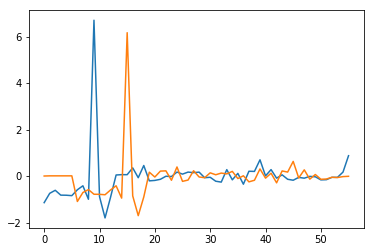

24 C05 Inventory
for these parameters -  (1, 1, 1) t (2, 1, 0, 2)  this -  11.917266074240223 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


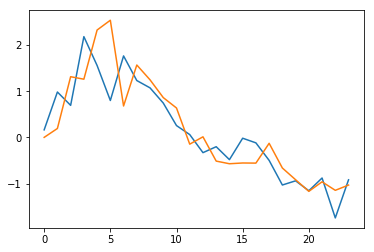

26 C06 Inventory
for these parameters -  (2, 1, 1) c (1, 1, 0, 9)  this -  43.61175168572207 is MAPE ERROR calculated for last five available forecasting values


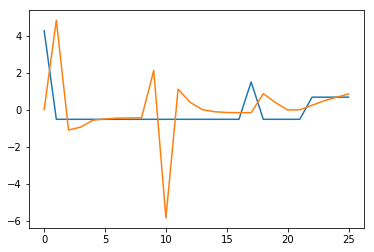

56 C09 Inventory
for these parameters -  (1, 0, 1) t (2, 1, 1, 2)  this -  7.542918124611439 is MAPE ERROR calculated for last five available forecasting values


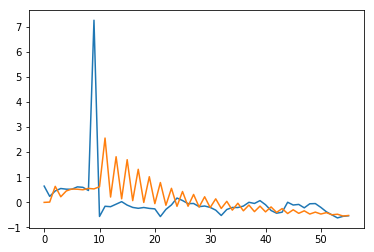

24 D03 Inventory
for these parameters -  (0, 1, 1) c (0, 1, 1, 3)  this -  12.375838415532636 is MAPE ERROR calculated for last five available forecasting values


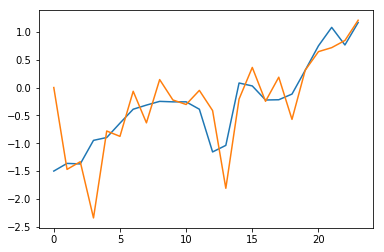

56 D06 Inventory
for these parameters -  (2, 1, 0) c (2, 1, 0, 1)  this -  120.91530954920013 is MAPE ERROR calculated for last five available forecasting values


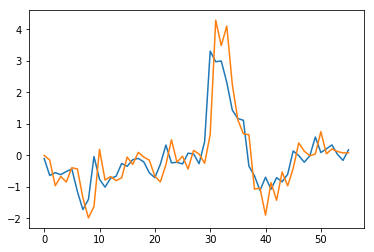

56 D10 Inventory
for these parameters -  (1, 1, 1) c (2, 0, 1, 4)  this -  49.89875857756936 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


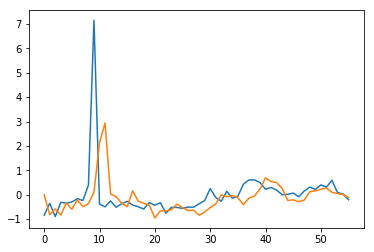

12 E01 Inventory
for these parameters -  (0, 1, 0) c (1, 0, 0, 5)  this -  44.25574073384262 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


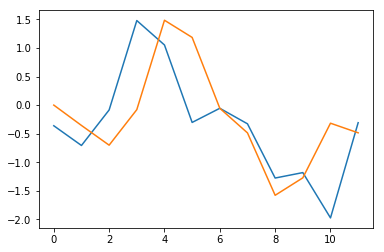

43 E04 Inventory
for these parameters -  (0, 1, 0) n (0, 1, 0, 1)  this -  2.771719371904746 is MAPE ERROR calculated for last five available forecasting values


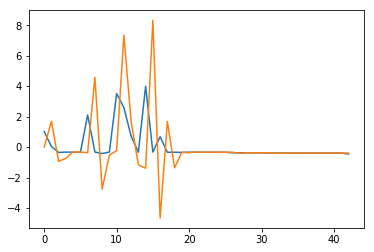

56 E11 Inventory
for these parameters -  (0, 0, 0) c (2, 0, 0, 8)  this -  13.871529353485348 is MAPE ERROR calculated for last five available forecasting values


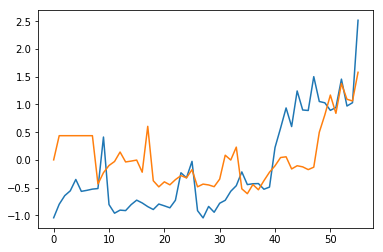

24 E15 Inventory
for these parameters -  (0, 0, 0) n (0, 1, 0, 6)  this -  46.77030530421298 is MAPE ERROR calculated for last five available forecasting values


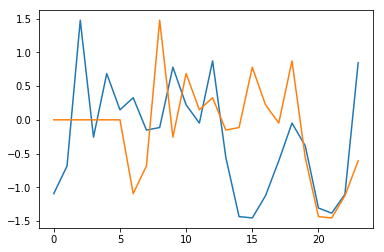

38 E16 Inventory
for these parameters -  (0, 1, 0) n (1, 1, 0, 1)  this -  0.2153262800915357 is MAPE ERROR calculated for last five available forecasting values


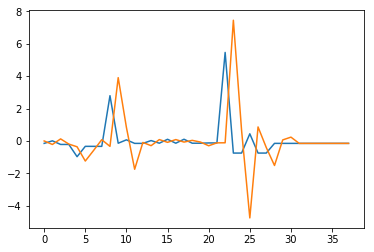

56 E18 Inventory
for these parameters -  (0, 0, 0) n (2, 0, 1, 9)  this -  52.90801563410948 is MAPE ERROR calculated for last five available forecasting values


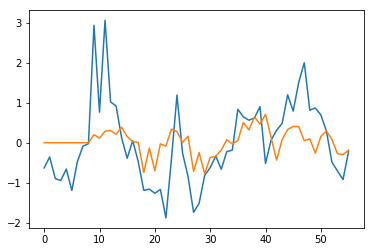

56 F02 Inventory
for these parameters -  (0, 1, 1) c (2, 0, 1, 6)  this -  13.927434328931357 is MAPE ERROR calculated for last five available forecasting values


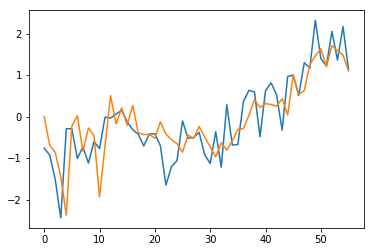

56 F04 Inventory
for these parameters -  (0, 0, 1) n (2, 0, 1, 1)  this -  79.54855905412626 is MAPE ERROR calculated for last five available forecasting values


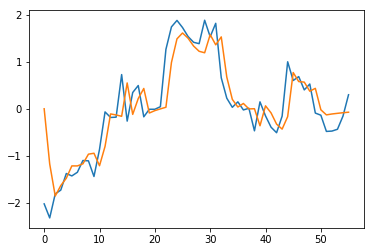

56 F05 Inventory
for these parameters -  (1, 0, 0) n (0, 1, 0, 5)  this -  30.53003093087322 is MAPE ERROR calculated for last five available forecasting values


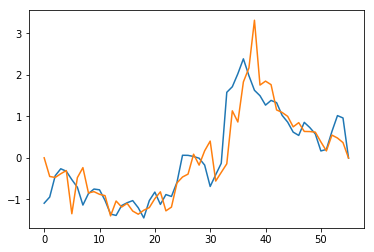

56 G01 Inventory
for these parameters -  (1, 0, 0) ct (2, 1, 1, 1)  this -  234.9535209298118 is MAPE ERROR calculated for last five available forecasting values


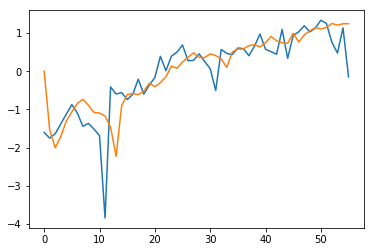

7 G03 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


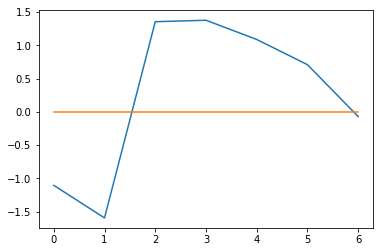

56 G05 Inventory
for these parameters -  (0, 1, 0) c (1, 1, 0, 3)  this -  7.913702064417628 is MAPE ERROR calculated for last five available forecasting values


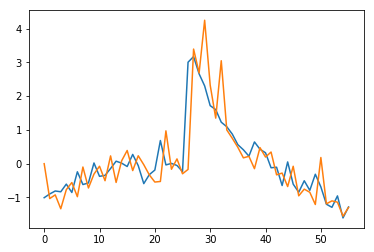

34 G08 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 1, 8)  this -  11.25433365830705 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


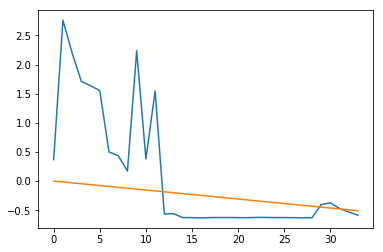

56 G10 Inventory
for these parameters -  (0, 0, 0) n (0, 1, 0, 7)  this -  38.46645671031904 is MAPE ERROR calculated for last five available forecasting values


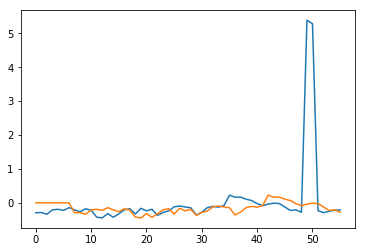

56 G12 Inventory
for these parameters -  (2, 0, 1) ct (0, 0, 1, 1)  this -  165.3730196859294 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


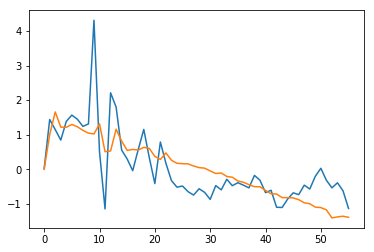

56 A01 Inventory
for these parameters -  (1, 0, 0) t (2, 0, 0, 4)  this -  6.712453201598971 is MAPE ERROR calculated for last five available forecasting values


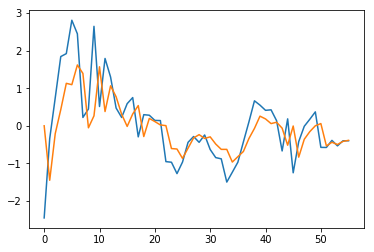

56 A03 Inventory
for these parameters -  (2, 0, 1) n (2, 1, 1, 1)  this -  234.29478243555343 is MAPE ERROR calculated for last five available forecasting values


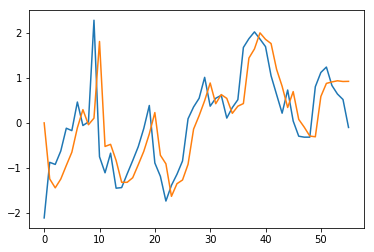

56 B01 Inventory
for these parameters -  (0, 1, 0) c (2, 0, 0, 7)  this -  9.882913462460477 is MAPE ERROR calculated for last five available forecasting values


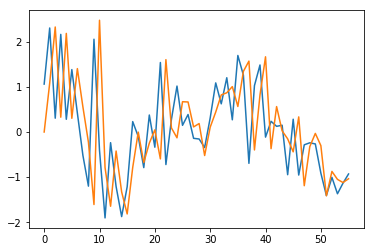

56 B03 Inventory
for these parameters -  (2, 1, 0) ct (2, 0, 1, 1)  this -  150.48521681280843 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


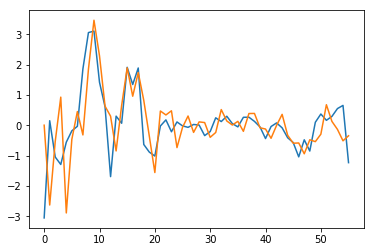

48 B05 Inventory
for these parameters -  (1, 0, 1) t (1, 1, 1, 4)  this -  38.00177202686893 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


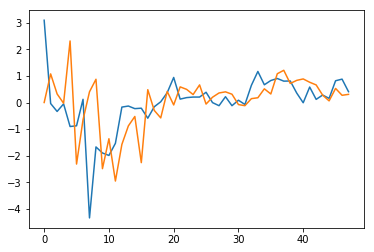

23 B07 Inventory
for these parameters -  (1, 0, 0) n (2, 0, 0, 3)  this -  67.23379477188516 is MAPE ERROR calculated for last five available forecasting values


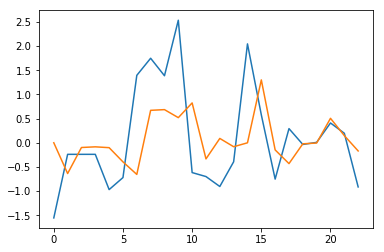

56 B08 Inventory
for these parameters -  (0, 0, 0) t (1, 0, 0, 9)  this -  22.114621744170922 is MAPE ERROR calculated for last five available forecasting values


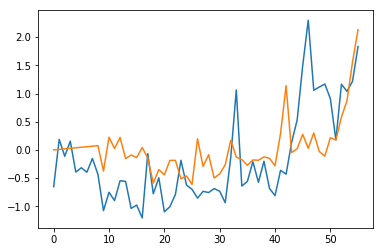

5 B11 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


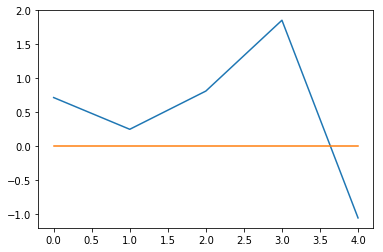

56 B13 Inventory
for these parameters -  (1, 1, 0) t (1, 1, 0, 1)  this -  163.69602410114373 is MAPE ERROR calculated for last five available forecasting values


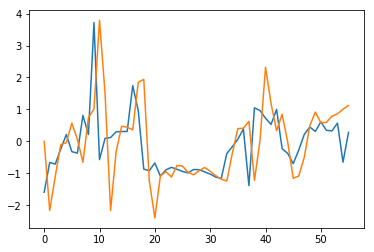

56 B15 Inventory
for these parameters -  (2, 1, 1) n (0, 1, 0, 8)  this -  28.669826759401516 is MAPE ERROR calculated for last five available forecasting values


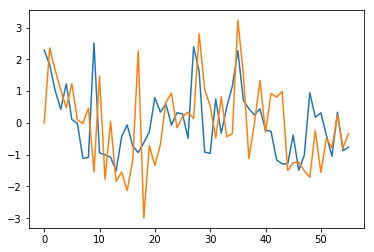

56 B17 Inventory
for these parameters -  (2, 0, 1) t (1, 1, 0, 1)  this -  132.1454478751106 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


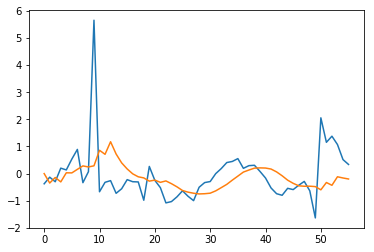

56 B22 Inventory
for these parameters -  (2, 0, 0) c (0, 1, 0, 3)  this -  14.153550957758751 is MAPE ERROR calculated for last five available forecasting values


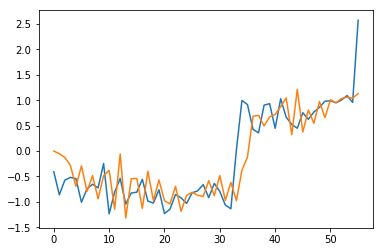

56 B23 Inventory
for these parameters -  (0, 1, 0) n (0, 1, 1, 3)  this -  5.404493790041881 is MAPE ERROR calculated for last five available forecasting values


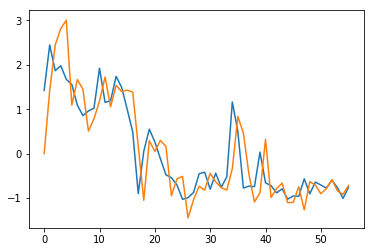

56 B25 Inventory
for these parameters -  (2, 0, 1) t (2, 0, 0, 3)  this -  39.30770849431918 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


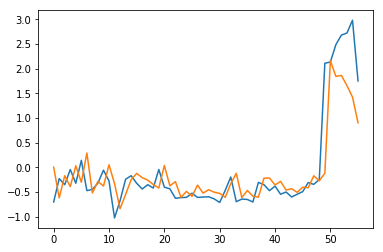

56 B27 Inventory
for these parameters -  (1, 0, 0) c (0, 1, 0, 9)  this -  9.124413003862287 is MAPE ERROR calculated for last five available forecasting values


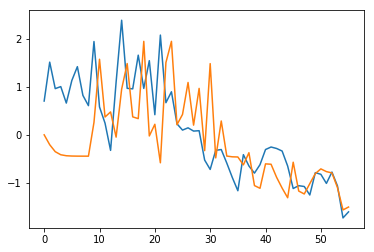

24 C01 Inventory
for these parameters -  (0, 0, 1) n (1, 0, 1, 4)  this -  13.256973156470469 is MAPE ERROR calculated for last five available forecasting values


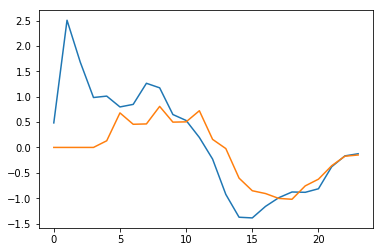

56 C04 Inventory
for these parameters -  (0, 0, 1) c (2, 1, 0, 6)  this -  50.04106707869516 is MAPE ERROR calculated for last five available forecasting values


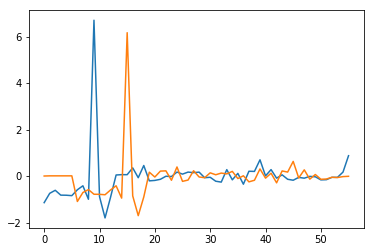

24 C05 Inventory
for these parameters -  (1, 1, 1) t (2, 1, 0, 2)  this -  11.917266074240223 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


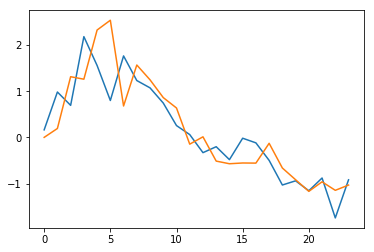

26 C06 Inventory
for these parameters -  (2, 1, 1) c (1, 1, 0, 9)  this -  43.61175168572207 is MAPE ERROR calculated for last five available forecasting values


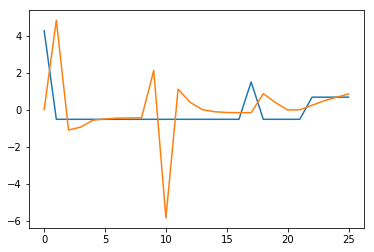

56 C09 Inventory
for these parameters -  (1, 0, 1) t (2, 1, 1, 2)  this -  7.542918124611439 is MAPE ERROR calculated for last five available forecasting values


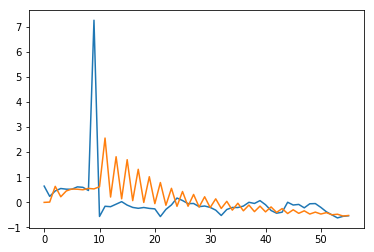

24 D03 Inventory
for these parameters -  (0, 1, 1) c (0, 1, 1, 3)  this -  12.375838415532636 is MAPE ERROR calculated for last five available forecasting values


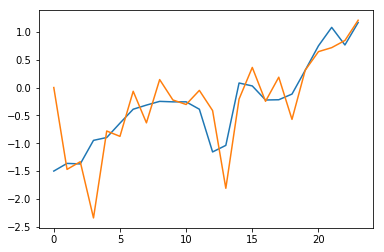

56 D06 Inventory
for these parameters -  (2, 1, 0) c (2, 1, 0, 1)  this -  120.91530954920013 is MAPE ERROR calculated for last five available forecasting values


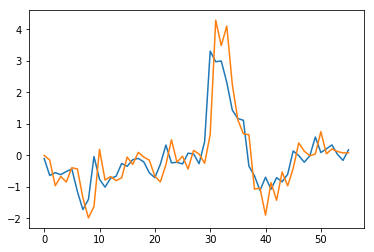

56 D10 Inventory
for these parameters -  (1, 1, 1) c (2, 0, 1, 4)  this -  49.89875857756936 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


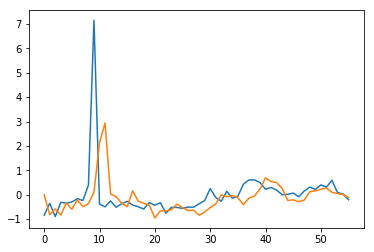

12 E01 Inventory
for these parameters -  (0, 1, 0) c (1, 0, 0, 5)  this -  44.25574073384262 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


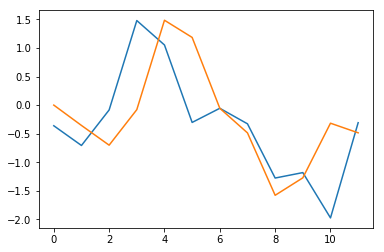

43 E04 Inventory
for these parameters -  (0, 1, 0) n (0, 1, 0, 1)  this -  2.771719371904746 is MAPE ERROR calculated for last five available forecasting values


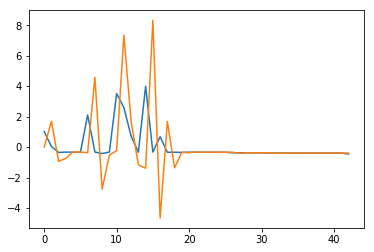

36 E09 Inventory
for these parameters -  (0, 1, 1) ct (1, 0, 0, 8)  this -  10.367270127099596 is MAPE ERROR calculated for last five available forecasting values


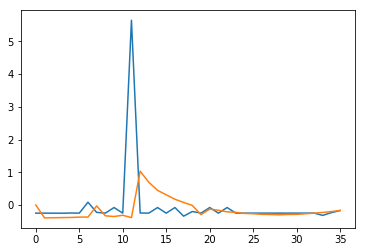

56 E11 Inventory
for these parameters -  (0, 0, 0) c (2, 0, 0, 8)  this -  13.871529353485348 is MAPE ERROR calculated for last five available forecasting values


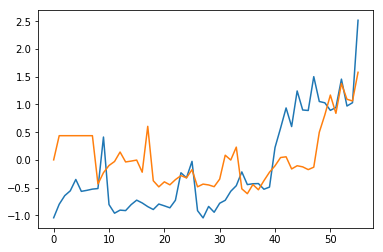

24 E15 Inventory
for these parameters -  (0, 0, 0) n (0, 1, 0, 6)  this -  46.77030530421298 is MAPE ERROR calculated for last five available forecasting values


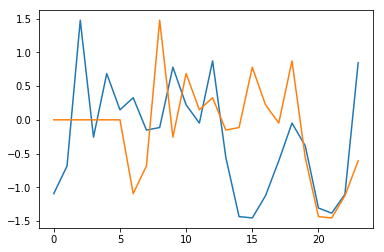

38 E16 Inventory
for these parameters -  (0, 1, 0) n (1, 1, 0, 1)  this -  0.2153262800915357 is MAPE ERROR calculated for last five available forecasting values


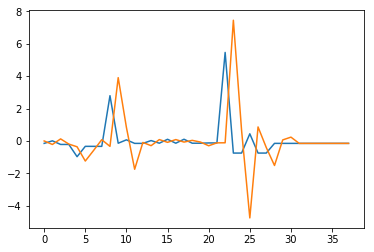

56 E18 Inventory
for these parameters -  (0, 0, 0) n (2, 0, 1, 9)  this -  52.90801563410948 is MAPE ERROR calculated for last five available forecasting values


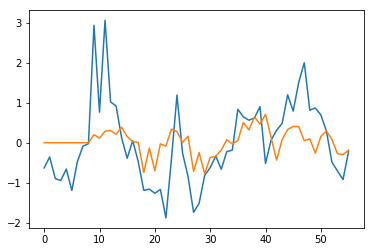

56 F02 Inventory
for these parameters -  (0, 1, 1) c (2, 0, 1, 6)  this -  13.927434328931357 is MAPE ERROR calculated for last five available forecasting values


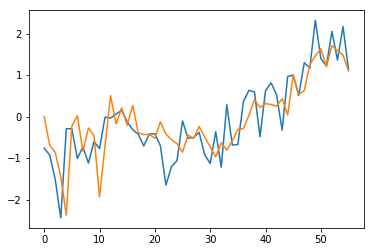

56 F04 Inventory
for these parameters -  (0, 0, 1) n (2, 0, 1, 1)  this -  79.54855905412626 is MAPE ERROR calculated for last five available forecasting values


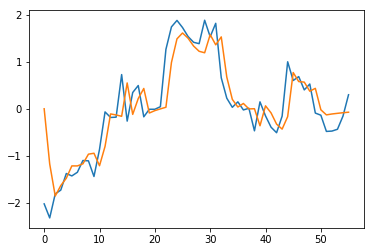

56 F05 Inventory
for these parameters -  (1, 0, 0) n (0, 1, 0, 5)  this -  30.53003093087322 is MAPE ERROR calculated for last five available forecasting values


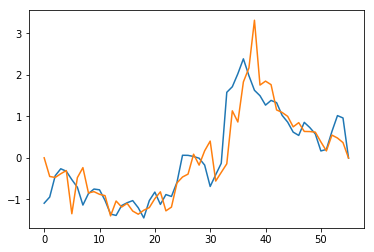

56 G01 Inventory
for these parameters -  (1, 0, 0) ct (2, 1, 1, 1)  this -  234.9535209298118 is MAPE ERROR calculated for last five available forecasting values


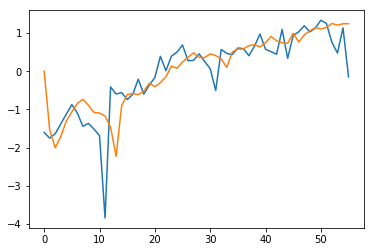

7 G03 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


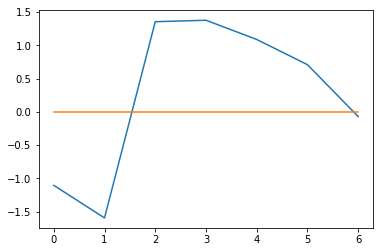

56 G05 Inventory
for these parameters -  (0, 1, 0) c (1, 1, 0, 3)  this -  7.913702064417628 is MAPE ERROR calculated for last five available forecasting values


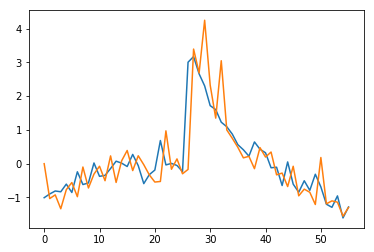

34 G08 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 1, 8)  this -  11.25433365830705 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


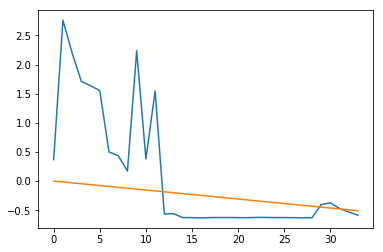

56 G10 Inventory
for these parameters -  (0, 0, 0) n (0, 1, 0, 7)  this -  38.46645671031904 is MAPE ERROR calculated for last five available forecasting values


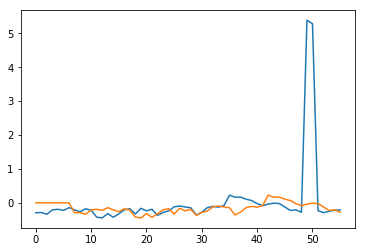

56 G12 Inventory
for these parameters -  (2, 0, 1) ct (0, 0, 1, 1)  this -  165.3730196859294 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


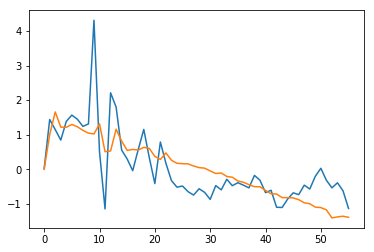

56 A01 Inventory
for these parameters -  (1, 0, 0) t (2, 0, 0, 4)  this -  6.712453201598971 is MAPE ERROR calculated for last five available forecasting values


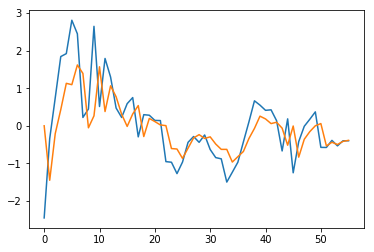

56 A03 Inventory
for these parameters -  (2, 0, 1) n (2, 1, 1, 1)  this -  234.29478243555343 is MAPE ERROR calculated for last five available forecasting values


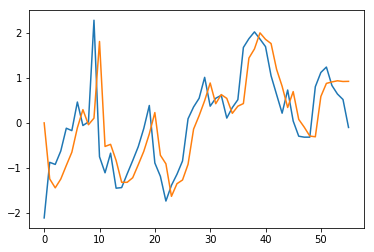

56 B01 Inventory
for these parameters -  (0, 1, 0) c (2, 0, 0, 7)  this -  9.882913462460477 is MAPE ERROR calculated for last five available forecasting values


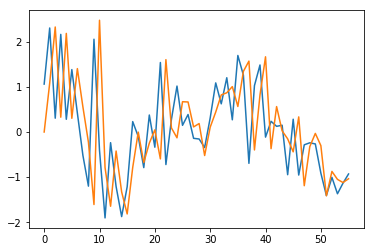

56 B03 Inventory
for these parameters -  (2, 1, 0) ct (2, 0, 1, 1)  this -  150.48521681280843 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


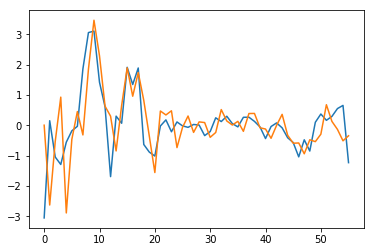

48 B05 Inventory
for these parameters -  (1, 0, 1) t (1, 1, 1, 4)  this -  38.00177202686893 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


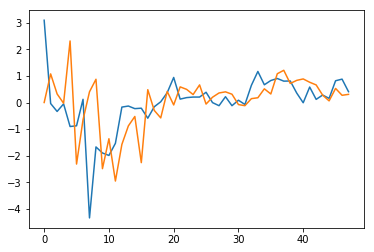

23 B07 Inventory
for these parameters -  (1, 0, 0) n (2, 0, 0, 3)  this -  67.23379477188516 is MAPE ERROR calculated for last five available forecasting values


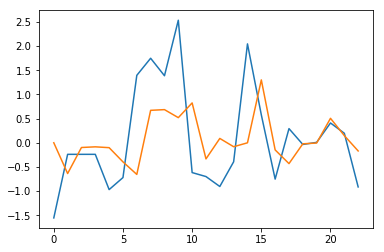

56 B08 Inventory
for these parameters -  (0, 0, 0) t (1, 0, 0, 9)  this -  22.114621744170922 is MAPE ERROR calculated for last five available forecasting values


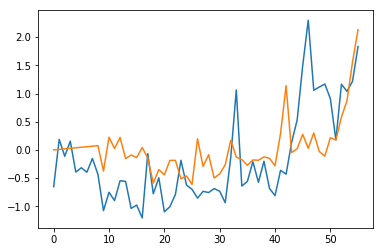

5 B11 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


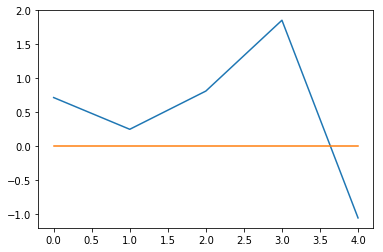

56 B13 Inventory
for these parameters -  (1, 1, 0) t (1, 1, 0, 1)  this -  163.69602410114373 is MAPE ERROR calculated for last five available forecasting values


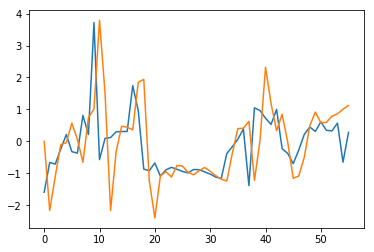

56 B15 Inventory
for these parameters -  (2, 1, 1) n (0, 1, 0, 8)  this -  28.669826759401516 is MAPE ERROR calculated for last five available forecasting values


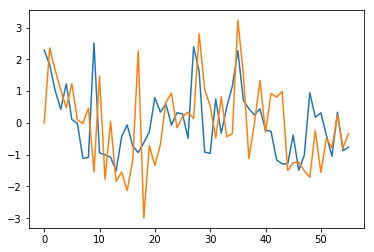

56 B17 Inventory
for these parameters -  (2, 0, 1) t (1, 1, 0, 1)  this -  132.1454478751106 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


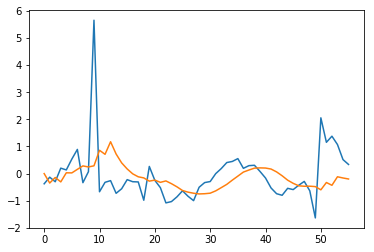

9 B19 Inventory
for these parameters -  (0, 1, 0) n (0, 0, 0, 0)  this -  19.849057660650356 is MAPE ERROR calculated for last five available forecasting values


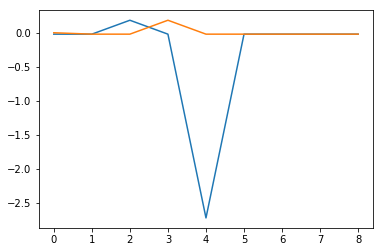

56 B22 Inventory
for these parameters -  (2, 0, 0) c (0, 1, 0, 3)  this -  14.153550957758751 is MAPE ERROR calculated for last five available forecasting values


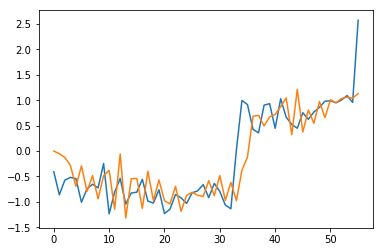

56 B23 Inventory
for these parameters -  (0, 1, 0) n (0, 1, 1, 3)  this -  5.404493790041881 is MAPE ERROR calculated for last five available forecasting values


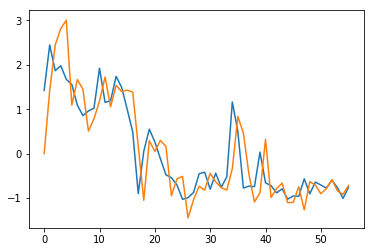

56 B25 Inventory
for these parameters -  (2, 0, 1) t (2, 0, 0, 3)  this -  39.30770849431918 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


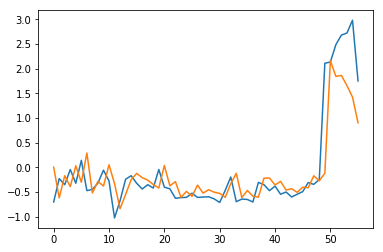

56 B27 Inventory
for these parameters -  (1, 0, 0) c (0, 1, 0, 9)  this -  9.124413003862287 is MAPE ERROR calculated for last five available forecasting values


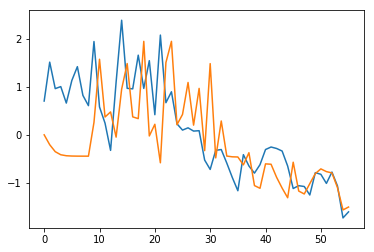

24 C01 Inventory
for these parameters -  (0, 0, 1) n (1, 0, 1, 4)  this -  13.256973156470469 is MAPE ERROR calculated for last five available forecasting values


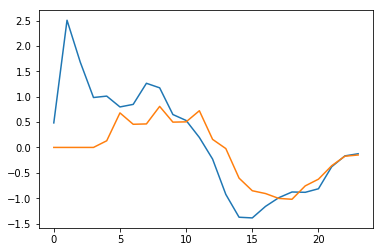

56 C04 Inventory
for these parameters -  (0, 0, 1) c (2, 1, 0, 6)  this -  50.04106707869516 is MAPE ERROR calculated for last five available forecasting values


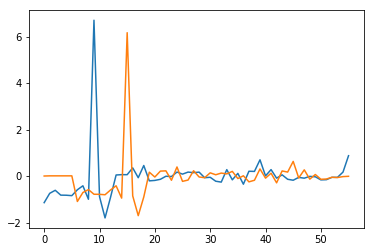

24 C05 Inventory
for these parameters -  (1, 1, 1) t (2, 1, 0, 2)  this -  11.917266074240223 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


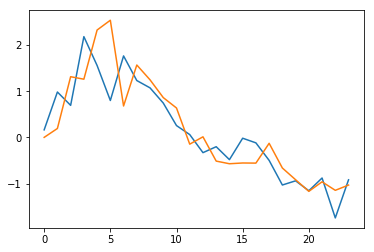

26 C06 Inventory
for these parameters -  (2, 1, 1) c (1, 1, 0, 9)  this -  43.61175168572207 is MAPE ERROR calculated for last five available forecasting values


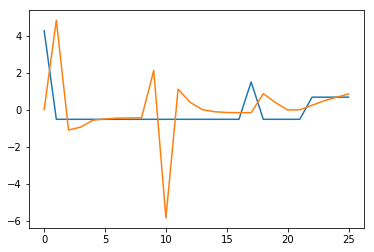

56 C09 Inventory
for these parameters -  (1, 0, 1) t (2, 1, 1, 2)  this -  7.542918124611439 is MAPE ERROR calculated for last five available forecasting values


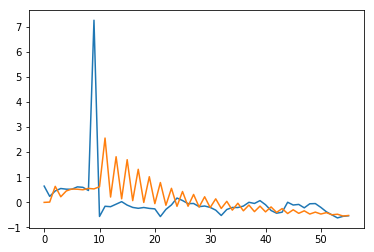

24 D03 Inventory
for these parameters -  (0, 1, 1) c (0, 1, 1, 3)  this -  12.375838415532636 is MAPE ERROR calculated for last five available forecasting values


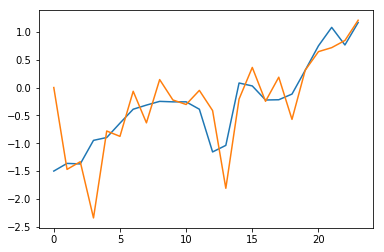

56 D06 Inventory
for these parameters -  (2, 1, 0) c (2, 1, 0, 1)  this -  120.91530954920013 is MAPE ERROR calculated for last five available forecasting values


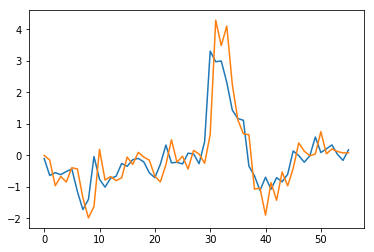

56 D10 Inventory
for these parameters -  (1, 1, 1) c (2, 0, 1, 4)  this -  49.89875857756936 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


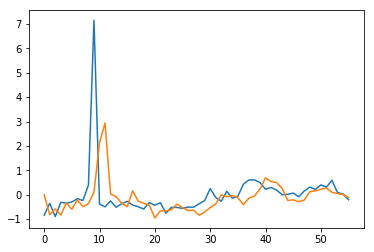

12 E01 Inventory
for these parameters -  (0, 1, 0) c (1, 0, 0, 5)  this -  44.25574073384262 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


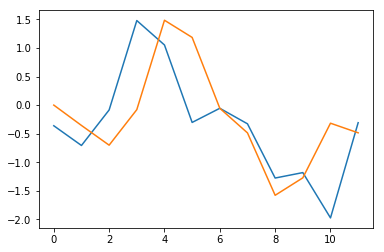

43 E04 Inventory
for these parameters -  (0, 1, 0) n (0, 1, 0, 1)  this -  2.771719371904746 is MAPE ERROR calculated for last five available forecasting values


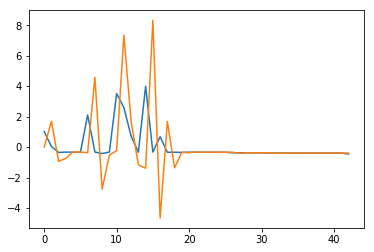

56 E11 Inventory
for these parameters -  (0, 0, 0) c (2, 0, 0, 8)  this -  13.871529353485348 is MAPE ERROR calculated for last five available forecasting values


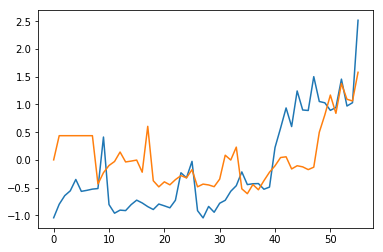

24 E15 Inventory
for these parameters -  (0, 0, 0) n (0, 1, 0, 6)  this -  46.77030530421298 is MAPE ERROR calculated for last five available forecasting values


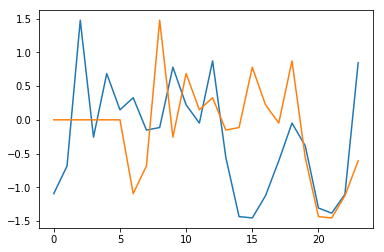

38 E16 Inventory
for these parameters -  (0, 1, 0) n (1, 1, 0, 1)  this -  0.2153262800915357 is MAPE ERROR calculated for last five available forecasting values


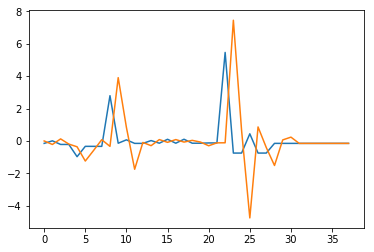

56 E18 Inventory
for these parameters -  (0, 0, 0) n (2, 0, 1, 9)  this -  52.90801563410948 is MAPE ERROR calculated for last five available forecasting values


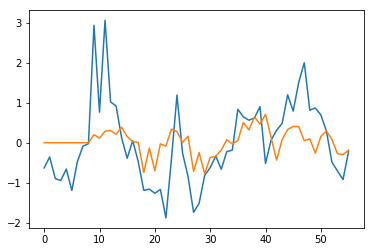

56 F02 Inventory
for these parameters -  (0, 1, 1) c (2, 0, 1, 6)  this -  13.927434328931357 is MAPE ERROR calculated for last five available forecasting values


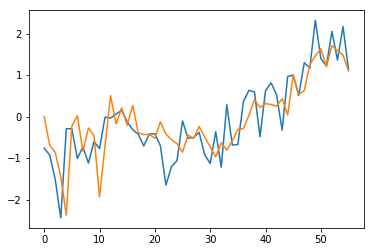

56 F04 Inventory
for these parameters -  (0, 0, 1) n (2, 0, 1, 1)  this -  79.54855905412626 is MAPE ERROR calculated for last five available forecasting values


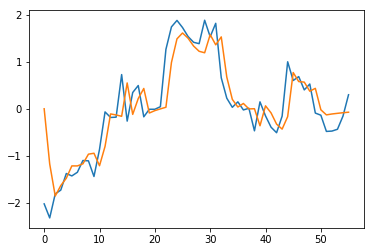

56 F05 Inventory
for these parameters -  (1, 0, 0) n (0, 1, 0, 5)  this -  30.53003093087322 is MAPE ERROR calculated for last five available forecasting values


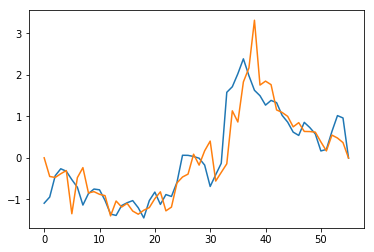

56 G01 Inventory
for these parameters -  (1, 0, 0) ct (2, 1, 1, 1)  this -  234.9535209298118 is MAPE ERROR calculated for last five available forecasting values


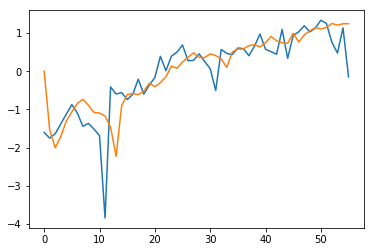

7 G03 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


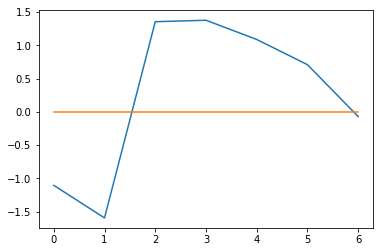

56 G05 Inventory
for these parameters -  (0, 1, 0) c (1, 1, 0, 3)  this -  7.913702064417628 is MAPE ERROR calculated for last five available forecasting values


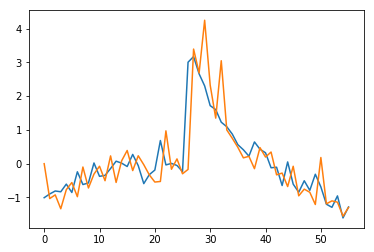

34 G08 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 1, 8)  this -  11.25433365830705 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


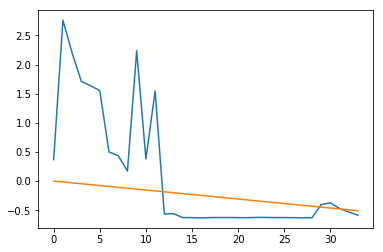

56 G10 Inventory
for these parameters -  (0, 0, 0) n (0, 1, 0, 7)  this -  38.46645671031904 is MAPE ERROR calculated for last five available forecasting values


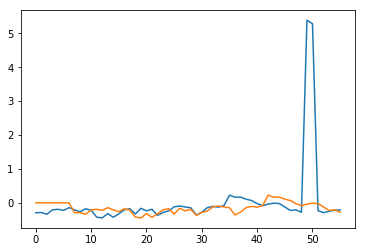

56 G12 Inventory
for these parameters -  (2, 0, 1) ct (0, 0, 1, 1)  this -  165.3730196859294 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


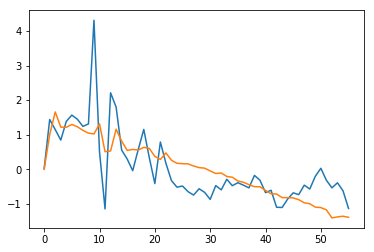

56 A01 Inventory
for these parameters -  (1, 0, 0) t (2, 0, 0, 4)  this -  6.712453201598971 is MAPE ERROR calculated for last five available forecasting values


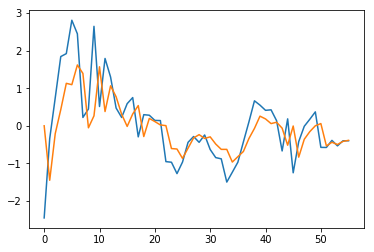

56 A03 Inventory
for these parameters -  (2, 0, 1) n (2, 1, 1, 1)  this -  234.29478243555343 is MAPE ERROR calculated for last five available forecasting values


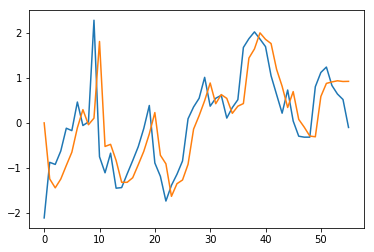

56 B01 Inventory
for these parameters -  (0, 1, 0) c (2, 0, 0, 7)  this -  9.882913462460477 is MAPE ERROR calculated for last five available forecasting values


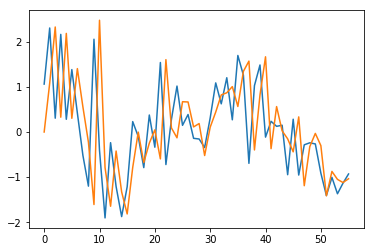

56 B03 Inventory
for these parameters -  (2, 1, 0) ct (2, 0, 1, 1)  this -  150.48521681280843 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


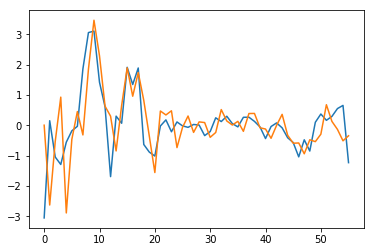

48 B05 Inventory
for these parameters -  (1, 0, 1) t (1, 1, 1, 4)  this -  38.00177202686893 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


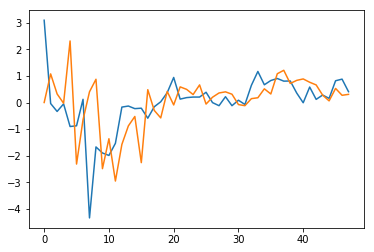

23 B07 Inventory
for these parameters -  (1, 0, 0) n (2, 0, 0, 3)  this -  67.23379477188516 is MAPE ERROR calculated for last five available forecasting values


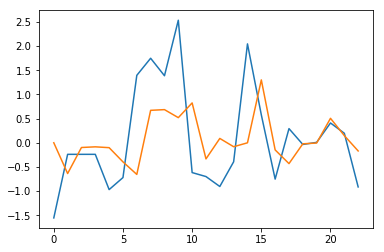

56 B08 Inventory
for these parameters -  (0, 0, 0) t (1, 0, 0, 9)  this -  22.114621744170922 is MAPE ERROR calculated for last five available forecasting values


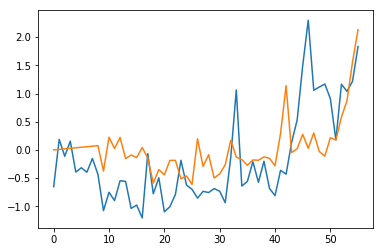

5 B11 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


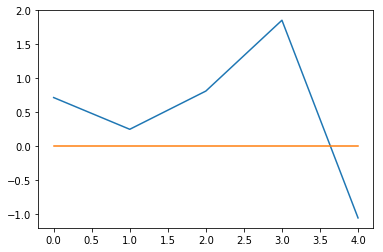

56 B13 Inventory
for these parameters -  (1, 1, 0) t (1, 1, 0, 1)  this -  163.69602410114373 is MAPE ERROR calculated for last five available forecasting values


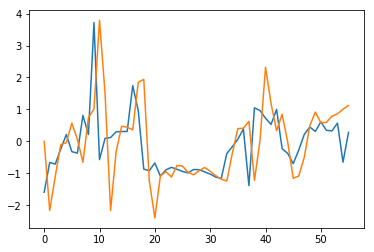

56 B15 Inventory
for these parameters -  (2, 1, 1) n (0, 1, 0, 8)  this -  28.669826759401516 is MAPE ERROR calculated for last five available forecasting values


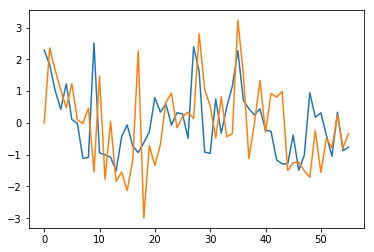

56 B17 Inventory
for these parameters -  (2, 0, 1) t (1, 1, 0, 1)  this -  132.1454478751106 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


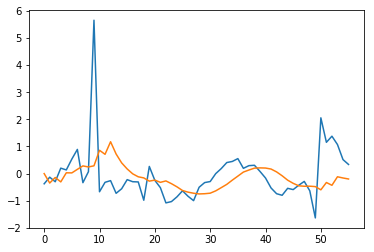

9 B19 Inventory
for these parameters -  (0, 1, 0) n (0, 0, 0, 0)  this -  19.849057660650356 is MAPE ERROR calculated for last five available forecasting values


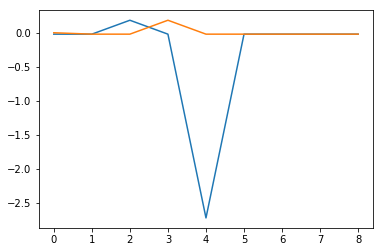

56 B22 Inventory
for these parameters -  (2, 0, 0) c (0, 1, 0, 3)  this -  14.153550957758751 is MAPE ERROR calculated for last five available forecasting values


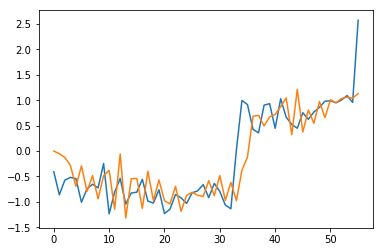

56 B23 Inventory
for these parameters -  (0, 1, 0) n (0, 1, 1, 3)  this -  5.404493790041881 is MAPE ERROR calculated for last five available forecasting values


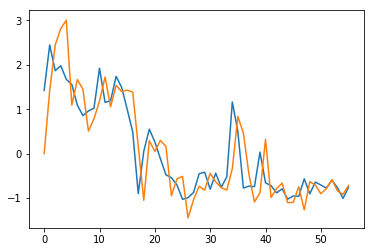

56 B25 Inventory
for these parameters -  (2, 0, 1) t (2, 0, 0, 3)  this -  39.30770849431918 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


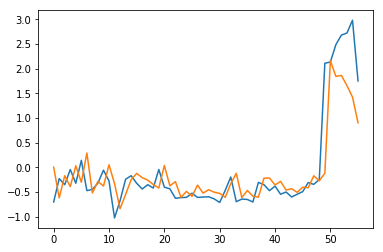

56 B27 Inventory
for these parameters -  (1, 0, 0) c (0, 1, 0, 9)  this -  9.124413003862287 is MAPE ERROR calculated for last five available forecasting values


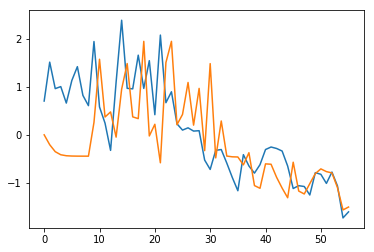

24 C01 Inventory
for these parameters -  (0, 0, 1) n (1, 0, 1, 4)  this -  13.256973156470469 is MAPE ERROR calculated for last five available forecasting values


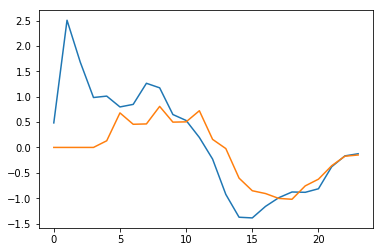

56 C04 Inventory
for these parameters -  (0, 0, 1) c (2, 1, 0, 6)  this -  50.04106707869516 is MAPE ERROR calculated for last five available forecasting values


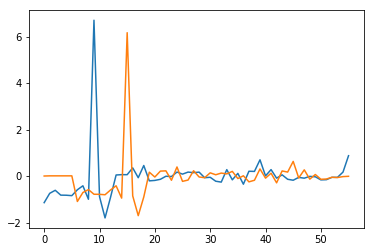

24 C05 Inventory
for these parameters -  (1, 1, 1) t (2, 1, 0, 2)  this -  11.917266074240223 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


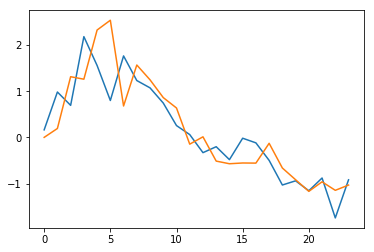

56 C09 Inventory
for these parameters -  (1, 0, 1) t (2, 1, 1, 2)  this -  7.542918124611439 is MAPE ERROR calculated for last five available forecasting values


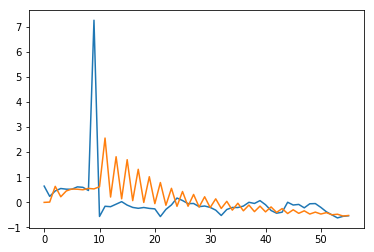

24 D03 Inventory
for these parameters -  (0, 1, 1) c (0, 1, 1, 3)  this -  12.375838415532636 is MAPE ERROR calculated for last five available forecasting values


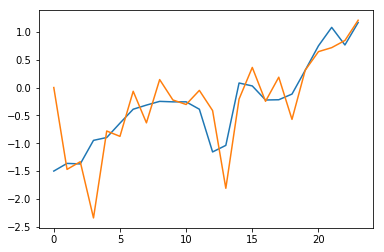

56 D06 Inventory
for these parameters -  (2, 1, 0) c (2, 1, 0, 1)  this -  120.91530954920013 is MAPE ERROR calculated for last five available forecasting values


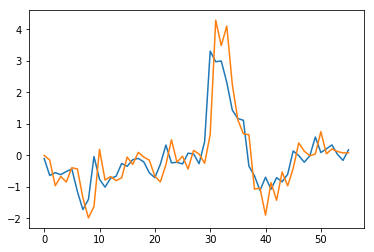

56 D10 Inventory
for these parameters -  (1, 1, 1) c (2, 0, 1, 4)  this -  49.89875857756936 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


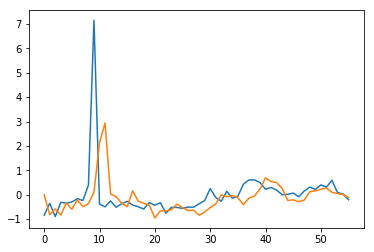

12 E01 Inventory
for these parameters -  (0, 1, 0) c (1, 0, 0, 5)  this -  44.25574073384262 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


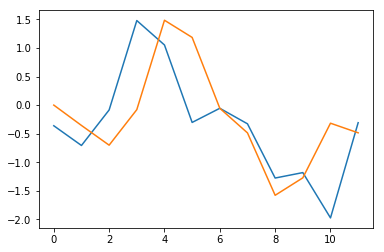

43 E04 Inventory
for these parameters -  (0, 1, 0) n (0, 1, 0, 1)  this -  2.771719371904746 is MAPE ERROR calculated for last five available forecasting values


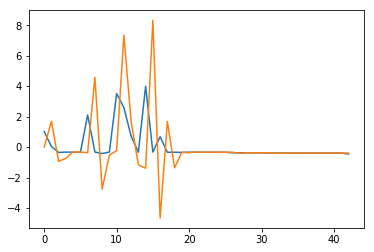

56 E11 Inventory
for these parameters -  (0, 0, 0) c (2, 0, 0, 8)  this -  13.871529353485348 is MAPE ERROR calculated for last five available forecasting values


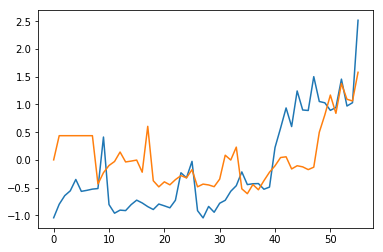

24 E15 Inventory
for these parameters -  (0, 0, 0) n (0, 1, 0, 6)  this -  46.77030530421298 is MAPE ERROR calculated for last five available forecasting values


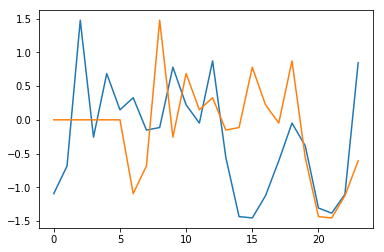

38 E16 Inventory
for these parameters -  (0, 1, 0) n (1, 1, 0, 1)  this -  0.2153262800915357 is MAPE ERROR calculated for last five available forecasting values


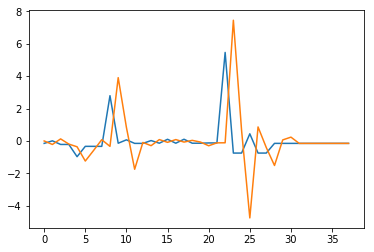

56 E18 Inventory
for these parameters -  (0, 0, 0) n (2, 0, 1, 9)  this -  52.90801563410948 is MAPE ERROR calculated for last five available forecasting values


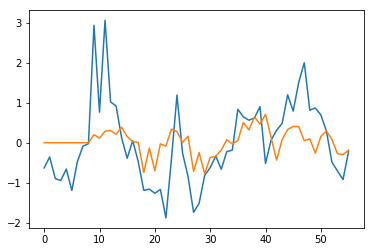

56 F02 Inventory
for these parameters -  (0, 1, 1) c (2, 0, 1, 6)  this -  13.927434328931357 is MAPE ERROR calculated for last five available forecasting values


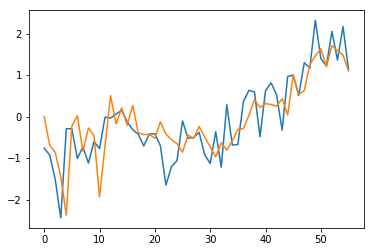

56 F04 Inventory
for these parameters -  (0, 0, 1) n (2, 0, 1, 1)  this -  79.54855905412626 is MAPE ERROR calculated for last five available forecasting values


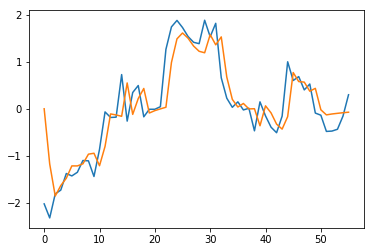

56 F05 Inventory
for these parameters -  (1, 0, 0) n (0, 1, 0, 5)  this -  30.53003093087322 is MAPE ERROR calculated for last five available forecasting values


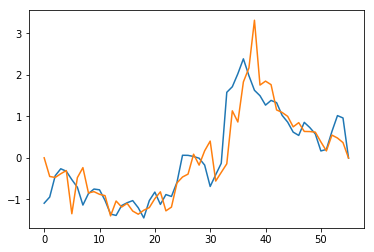

56 G01 Inventory
for these parameters -  (1, 0, 0) ct (2, 1, 1, 1)  this -  234.9535209298118 is MAPE ERROR calculated for last five available forecasting values


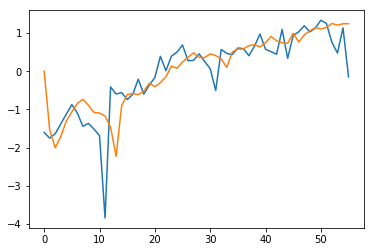

7 G03 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


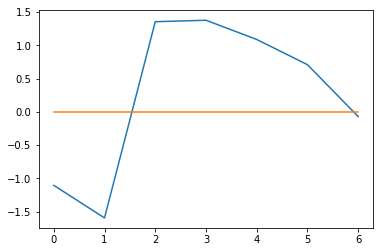

56 G05 Inventory
for these parameters -  (0, 1, 0) c (1, 1, 0, 3)  this -  7.913702064417628 is MAPE ERROR calculated for last five available forecasting values


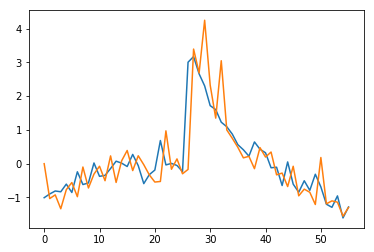

34 G08 Inventory
for these parameters -  (0, 0, 0) t (0, 0, 1, 8)  this -  11.25433365830705 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


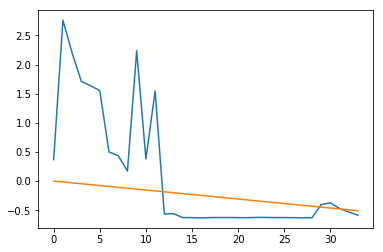

56 G10 Inventory
for these parameters -  (0, 0, 0) n (0, 1, 0, 7)  this -  38.46645671031904 is MAPE ERROR calculated for last five available forecasting values


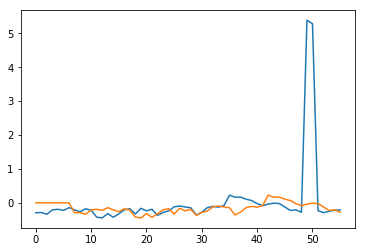

56 G12 Inventory
for these parameters -  (2, 0, 1) ct (0, 0, 1, 1)  this -  165.3730196859294 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


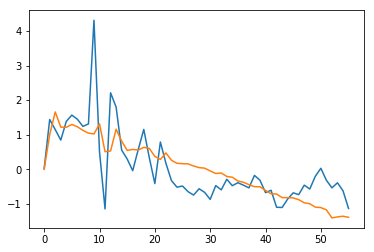

56 A01 Payables and Accruals
for these parameters -  (2, 0, 1) c (2, 1, 1, 6)  this -  24.25386252860296 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


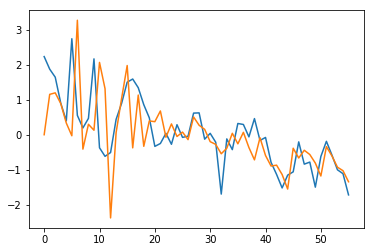

45 A02 Payables and Accruals
for these parameters -  (1, 1, 0) ct (2, 1, 1, 7)  this -  51.296707626798174 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


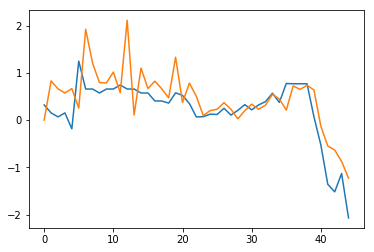

56 A03 Payables and Accruals
for these parameters -  (2, 1, 0) n (1, 0, 1, 1)  this -  289.5459719480807 is MAPE ERROR calculated for last five available forecasting values


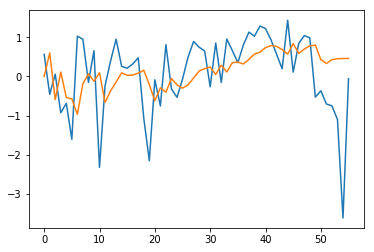

56 B01 Payables and Accruals
for these parameters -  (0, 1, 0) ct (2, 1, 0, 7)  this -  19.707033542291043 is MAPE ERROR calculated for last five available forecasting values


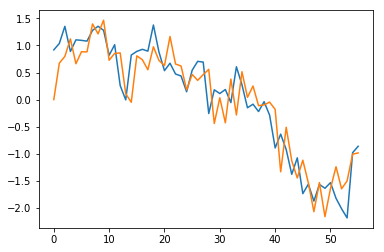

34 B02 Payables and Accruals
for these parameters -  (2, 0, 0) n (0, 1, 0, 4)  this -  52.80147609463446 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


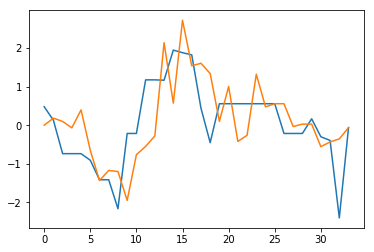

56 B03 Payables and Accruals
for these parameters -  (0, 0, 0) c (0, 1, 1, 4)  this -  40.38158410742664 is MAPE ERROR calculated for last five available forecasting values


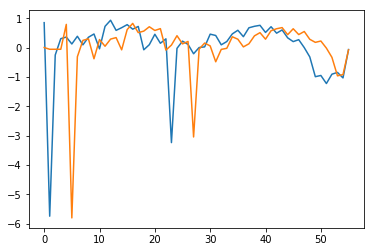

37 B04 Payables and Accruals
for these parameters -  (0, 1, 1) t (1, 0, 1, 5)  this -  9.08608772908141 is MAPE ERROR calculated for last five available forecasting values


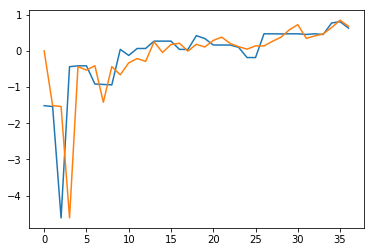

56 B05 Payables and Accruals
for these parameters -  (0, 1, 1) n (2, 0, 0, 4)  this -  43.078090418821375 is MAPE ERROR calculated for last five available forecasting values


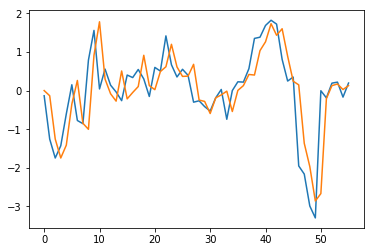

47 B07 Payables and Accruals
for these parameters -  (0, 0, 0) t (2, 1, 0, 4)  this -  11.186679730482574 is MAPE ERROR calculated for last five available forecasting values


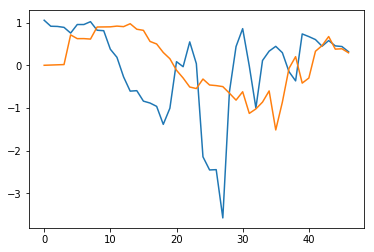

56 B08 Payables and Accruals
for these parameters -  (1, 0, 1) ct (0, 1, 1, 1)  this -  7.908801920132367 is MAPE ERROR calculated for last five available forecasting values


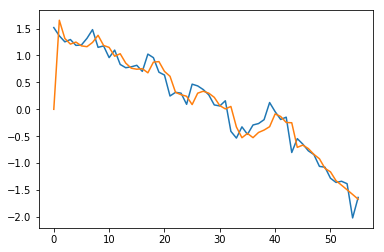

45 B09 Payables and Accruals
for these parameters -  (1, 0, 1) n (2, 1, 0, 9)  this -  30.718631262881914 is MAPE ERROR calculated for last five available forecasting values


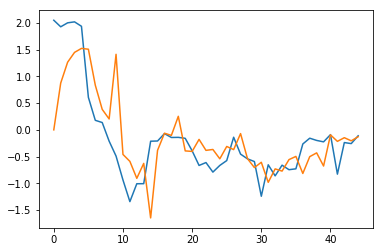

5 B11 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


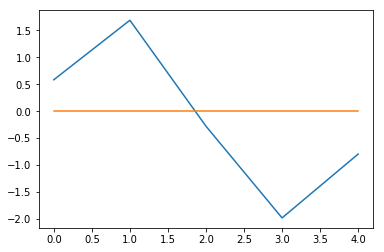

4 B12 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


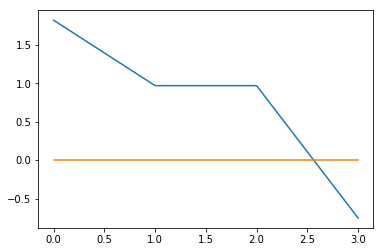

56 B13 Payables and Accruals
for these parameters -  (1, 0, 1) n (2, 0, 1, 1)  this -  52.09925370594715 is MAPE ERROR calculated for last five available forecasting values


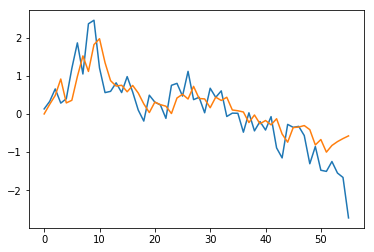

56 B15 Payables and Accruals
for these parameters -  (2, 0, 1) n (1, 0, 0, 1)  this -  107.87657547881922 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


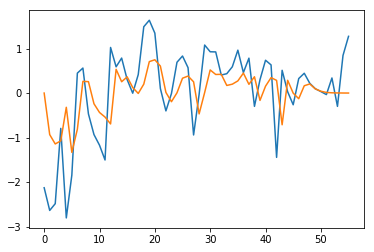

56 B16 Payables and Accruals
for these parameters -  (2, 1, 0) ct (2, 1, 0, 8)  this -  35.03931676160372 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


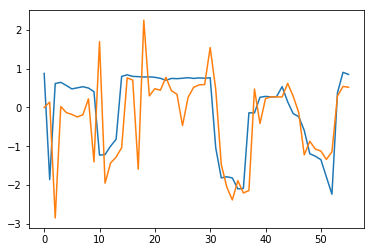

56 B17 Payables and Accruals
for these parameters -  (0, 0, 1) t (2, 1, 1, 3)  this -  8.199893468344314 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


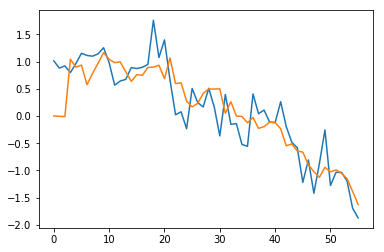

10 B18 Payables and Accruals
for these parameters -  (0, 0, 1) n (2, 0, 0, 0)  this -  0.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


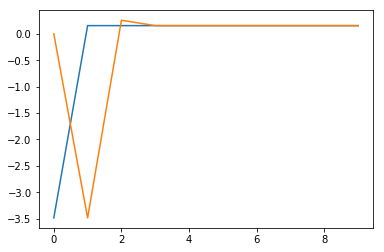

56 B19 Payables and Accruals
for these parameters -  (2, 1, 1) t (2, 0, 1, 9)  this -  4.794349619618386 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


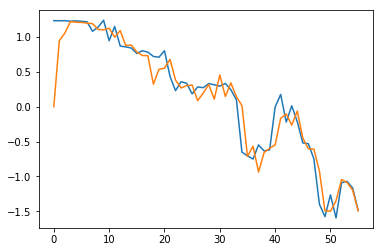

45 B20 Payables and Accruals
for these parameters -  (2, 1, 1) ct (2, 0, 1, 8)  this -  4.453946540530575 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


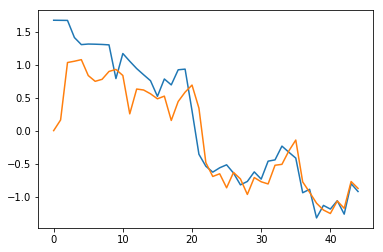

37 B21 Payables and Accruals
for these parameters -  (1, 0, 1) n (0, 1, 1, 6)  this -  24.796123200933113 is MAPE ERROR calculated for last five available forecasting values


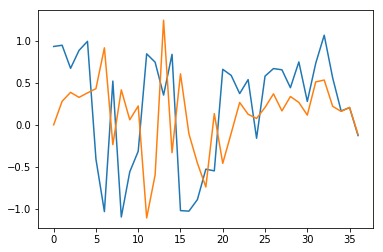

56 B22 Payables and Accruals
for these parameters -  (2, 1, 1) ct (0, 0, 1, 9)  this -  4.687529742702353 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


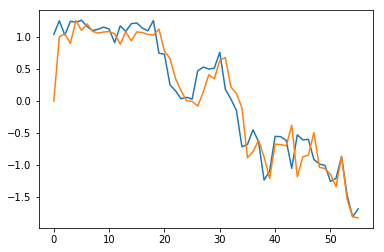

56 B23 Payables and Accruals
for these parameters -  (2, 1, 1) c (2, 0, 1, 1)  this -  31.583128801013505 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


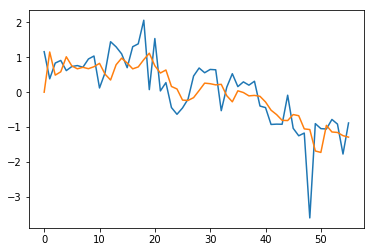

35 B24 Payables and Accruals
for these parameters -  (1, 0, 0) t (2, 0, 0, 2)  this -  16.555833661050993 is MAPE ERROR calculated for last five available forecasting values


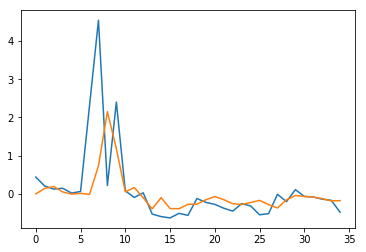

56 B25 Payables and Accruals
for these parameters -  (2, 1, 0) ct (1, 0, 1, 0)  this -  7.763440608780161 is MAPE ERROR calculated for last five available forecasting values


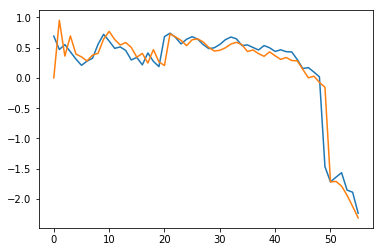

56 B27 Payables and Accruals
for these parameters -  (0, 1, 0) ct (0, 1, 0, 6)  this -  8.63702179225196 is MAPE ERROR calculated for last five available forecasting values


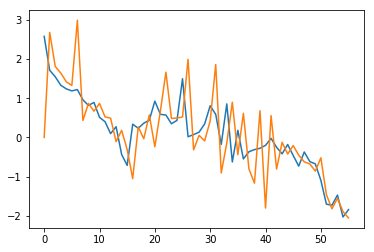

45 B28 Payables and Accruals
for these parameters -  (0, 1, 0) ct (0, 1, 0, 1)  this -  157.9152070088979 is MAPE ERROR calculated for last five available forecasting values


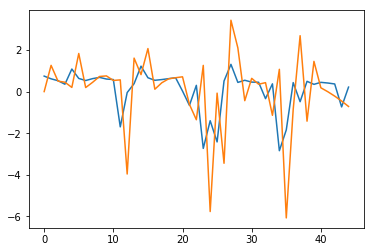

56 C02 Payables and Accruals
for these parameters -  (0, 1, 0) t (1, 1, 0, 6)  this -  41.64740150311982 is MAPE ERROR calculated for last five available forecasting values


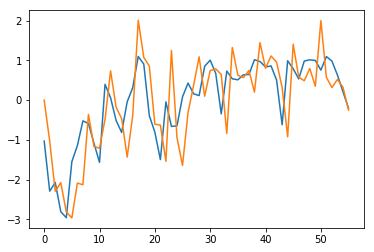

45 C03 Payables and Accruals
for these parameters -  (1, 0, 0) t (2, 0, 1, 7)  this -  9.533529710313285 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


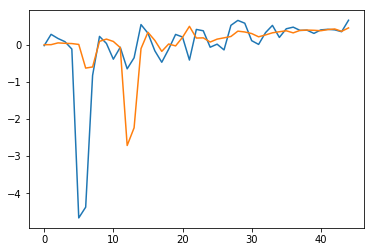

56 C04 Payables and Accruals
for these parameters -  (2, 1, 1) ct (2, 1, 1, 2)  this -  61.78485749250816 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


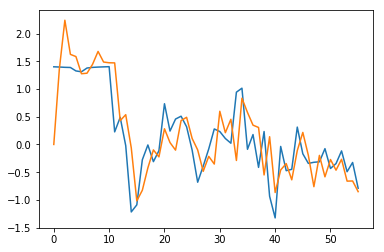

56 C06 Payables and Accruals
for these parameters -  (1, 0, 1) c (0, 1, 0, 6)  this -  9.39645589433564 is MAPE ERROR calculated for last five available forecasting values


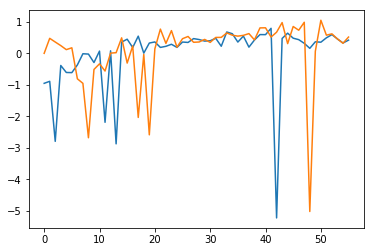

33 C08 Payables and Accruals
for these parameters -  (2, 1, 0) n (1, 1, 1, 6)  this -  32.51139301294268 is MAPE ERROR calculated for last five available forecasting values


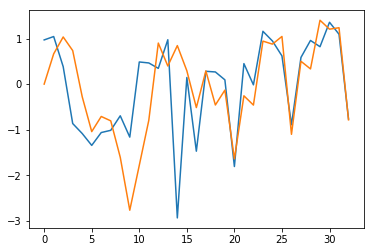

56 C09 Payables and Accruals
for these parameters -  (1, 0, 0) n (2, 0, 0, 0)  this -  79.76943937821342 is MAPE ERROR calculated for last five available forecasting values


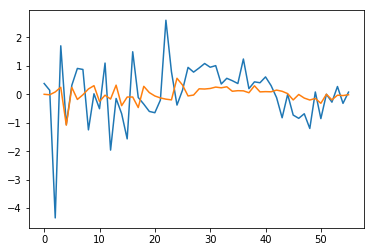

56 D04 Payables and Accruals
for these parameters -  (2, 0, 1) n (0, 1, 0, 6)  this -  6.715228544368849 is MAPE ERROR calculated for last five available forecasting values


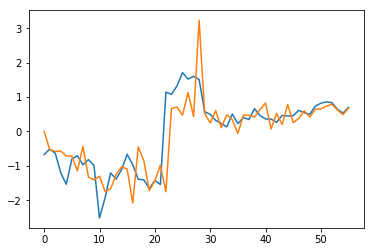

21 D05 Payables and Accruals
for these parameters -  (0, 0, 0) c (0, 0, 1, 3)  this -  42.14491170010867 is MAPE ERROR calculated for last five available forecasting values


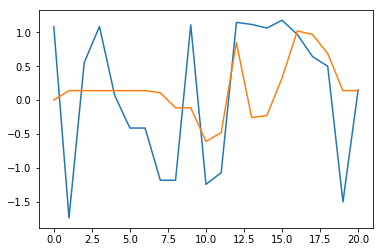

56 D06 Payables and Accruals
for these parameters -  (1, 1, 0) t (0, 1, 1, 6)  this -  23.597870053866274 is MAPE ERROR calculated for last five available forecasting values


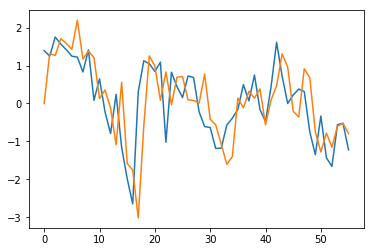

38 D07 Payables and Accruals
for these parameters -  (2, 1, 1) t (2, 1, 1, 6)  this -  36.5168663763013 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


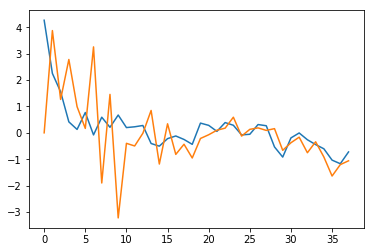

56 D10 Payables and Accruals
for these parameters -  (0, 1, 1) ct (0, 1, 0, 5)  this -  4.615739396223029 is MAPE ERROR calculated for last five available forecasting values


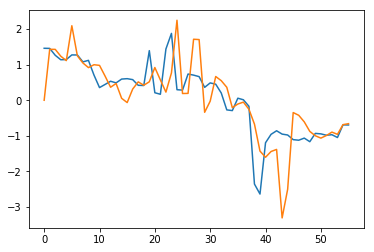

56 E09 Payables and Accruals
for these parameters -  (0, 0, 1) n (1, 1, 1, 9)  this -  22.483561338386394 is MAPE ERROR calculated for last five available forecasting values


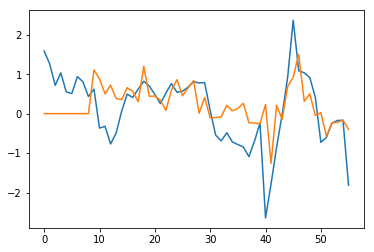

17 E10 Payables and Accruals
for these parameters -  (1, 1, 1) c (2, 0, 0, 4)  this -  45.785982106785745 is MAPE ERROR calculated for last five available forecasting values


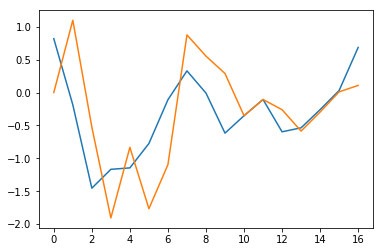

18 E11 Payables and Accruals
for these parameters -  (0, 0, 1) n (1, 0, 0, 5)  this -  73.12859040821036 is MAPE ERROR calculated for last five available forecasting values


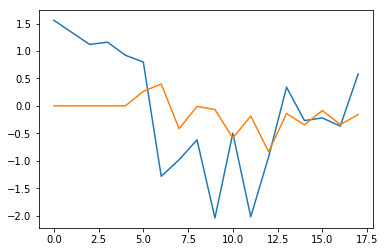

56 E12 Payables and Accruals
for these parameters -  (2, 0, 0) c (1, 1, 0, 5)  this -  41.470206861553486 is MAPE ERROR calculated for last five available forecasting values


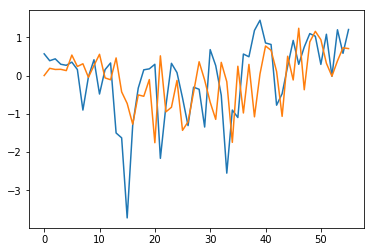

17 E13 Payables and Accruals
for these parameters -  (0, 0, 1) ct (0, 0, 1, 3)  this -  39.469438406556066 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


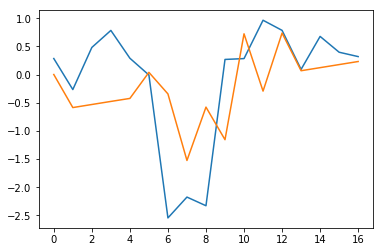

10 E15 Payables and Accruals
for these parameters -  (0, 0, 0) n (0, 1, 0, 6)  this -  62.483170109568796 is MAPE ERROR calculated for last five available forecasting values


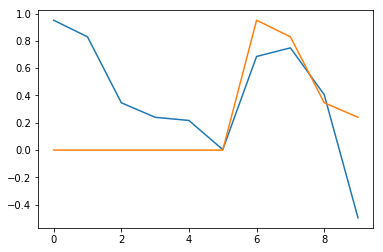

56 E16 Payables and Accruals
for these parameters -  (1, 1, 0) n (1, 1, 1, 9)  this -  21.878447186516148 is MAPE ERROR calculated for last five available forecasting values


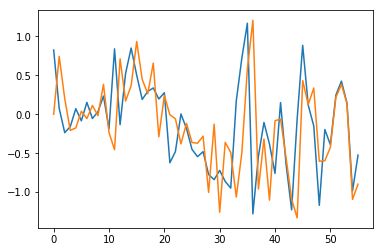

19 E17 Payables and Accruals
for these parameters -  (1, 1, 0) t (0, 1, 0, 2)  this -  42.612695694337724 is MAPE ERROR calculated for last five available forecasting values


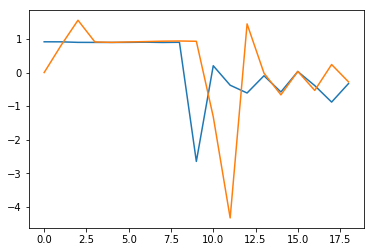

56 E18 Payables and Accruals
for these parameters -  (0, 0, 1) c (1, 1, 1, 8)  this -  16.054479381914856 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


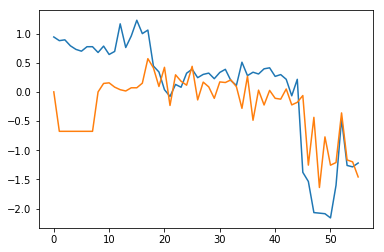

56 F02 Payables and Accruals
for these parameters -  (1, 0, 1) t (0, 1, 1, 9)  this -  238.76121539272418 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


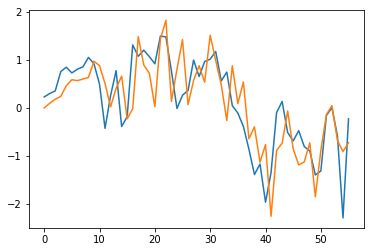

39 F03 Payables and Accruals
for these parameters -  (2, 0, 1) ct (0, 0, 1, 4)  this -  16.727175881492734 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


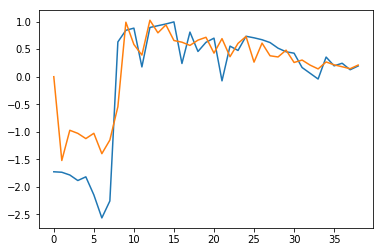

56 F04 Payables and Accruals
for these parameters -  (1, 0, 0) n (2, 0, 0, 4)  this -  36.168965335278216 is MAPE ERROR calculated for last five available forecasting values


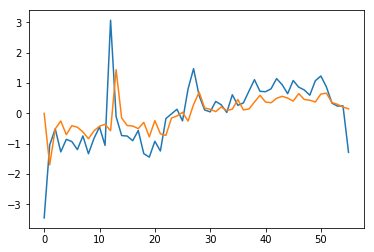

56 F05 Payables and Accruals
for these parameters -  (2, 0, 1) c (2, 0, 1, 1)  this -  84.30570863927878 is MAPE ERROR calculated for last five available forecasting values


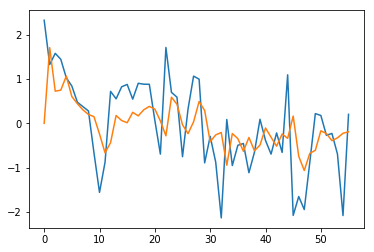

56 G01 Payables and Accruals
for these parameters -  (2, 0, 1) n (2, 0, 0, 2)  this -  73.60509573464556 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


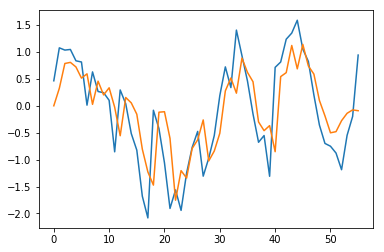

0 G02 Payables and Accruals
-1
7 G03 Payables and Accruals


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


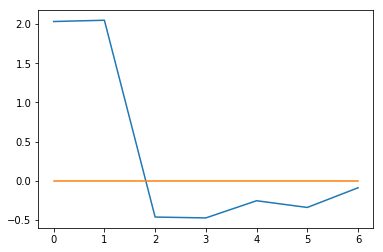

35 G04 Payables and Accruals
for these parameters -  (0, 0, 0) n (2, 0, 1, 8)  this -  20.346956026412766 is MAPE ERROR calculated for last five available forecasting values


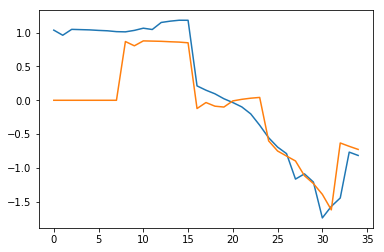

56 G05 Payables and Accruals
for these parameters -  (0, 0, 1) t (0, 1, 1, 7)  this -  14.218568358170975 is MAPE ERROR calculated for last five available forecasting values


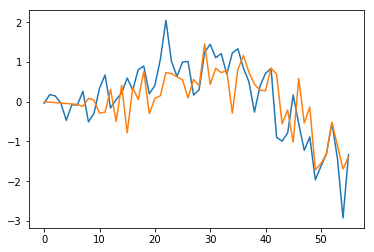

48 G06 Payables and Accruals
for these parameters -  (0, 1, 1) t (2, 1, 0, 9)  this -  9.80461137086249 is MAPE ERROR calculated for last five available forecasting values


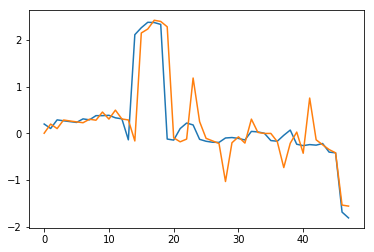

56 G08 Payables and Accruals
for these parameters -  (0, 0, 0) c (1, 0, 1, 7)  this -  81.76162620065155 is MAPE ERROR calculated for last five available forecasting values


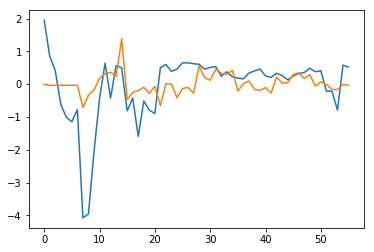

56 G10 Payables and Accruals
for these parameters -  (0, 0, 0) c (1, 1, 0, 9)  this -  64.66441947359878 is MAPE ERROR calculated for last five available forecasting values


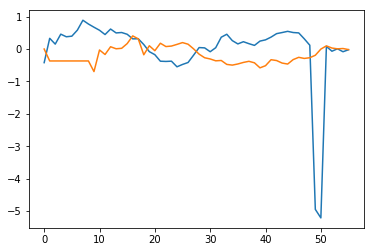

37 G11 Payables and Accruals
for these parameters -  (2, 0, 1) t (2, 0, 0, 9)  this -  23.354474515893482 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


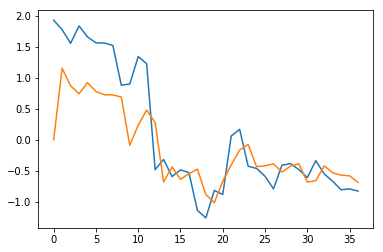

56 G12 Payables and Accruals
for these parameters -  (1, 0, 0) n (0, 1, 0, 8)  this -  18.11707549914757 is MAPE ERROR calculated for last five available forecasting values


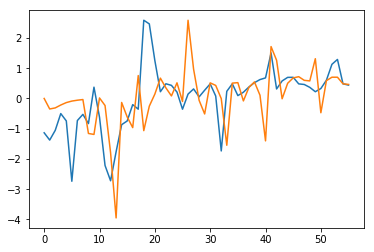

37 G13 Payables and Accruals
for these parameters -  (2, 1, 1) ct (0, 0, 1, 7)  this -  9.671145009401874 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


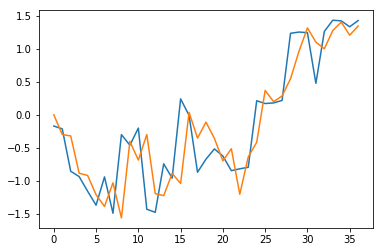

56 A01 Payables and Accruals
for these parameters -  (2, 0, 1) c (2, 1, 1, 6)  this -  24.25386252860296 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


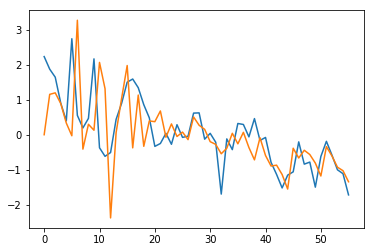

45 A02 Payables and Accruals
for these parameters -  (1, 1, 0) ct (2, 1, 1, 7)  this -  51.296707626798174 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


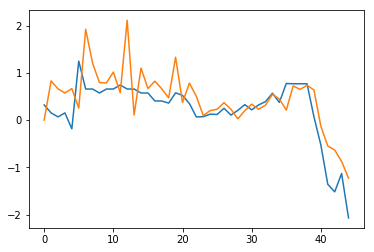

56 A03 Payables and Accruals
for these parameters -  (2, 1, 0) n (1, 0, 1, 1)  this -  289.5459719480807 is MAPE ERROR calculated for last five available forecasting values


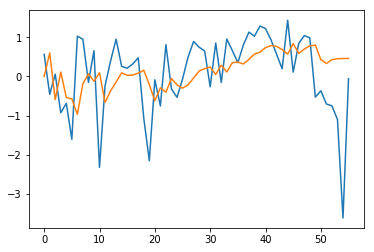

56 B01 Payables and Accruals
for these parameters -  (0, 1, 0) ct (2, 1, 0, 7)  this -  19.707033542291043 is MAPE ERROR calculated for last five available forecasting values


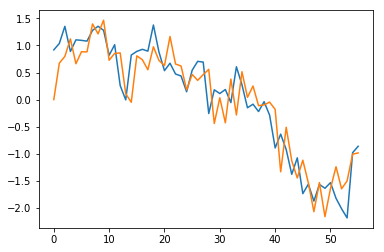

34 B02 Payables and Accruals
for these parameters -  (2, 0, 0) n (0, 1, 0, 4)  this -  52.80147609463446 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


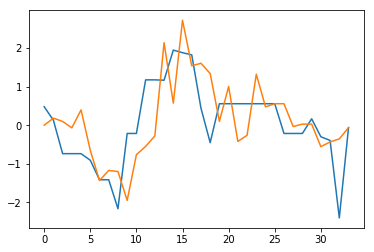

56 B03 Payables and Accruals
for these parameters -  (0, 0, 0) c (0, 1, 1, 4)  this -  40.38158410742664 is MAPE ERROR calculated for last five available forecasting values


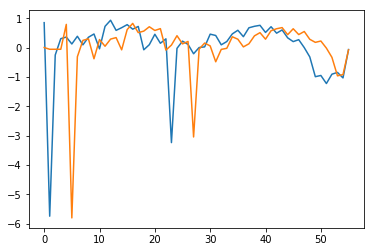

37 B04 Payables and Accruals
for these parameters -  (0, 1, 1) t (1, 0, 1, 5)  this -  9.08608772908141 is MAPE ERROR calculated for last five available forecasting values


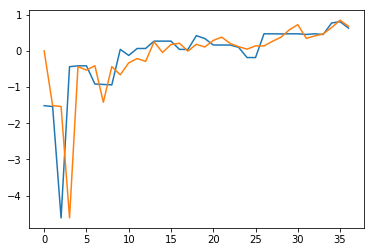

56 B05 Payables and Accruals
for these parameters -  (0, 1, 1) n (2, 0, 0, 4)  this -  43.078090418821375 is MAPE ERROR calculated for last five available forecasting values


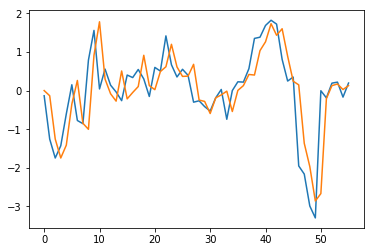

47 B07 Payables and Accruals
for these parameters -  (0, 0, 0) t (2, 1, 0, 4)  this -  11.186679730482574 is MAPE ERROR calculated for last five available forecasting values


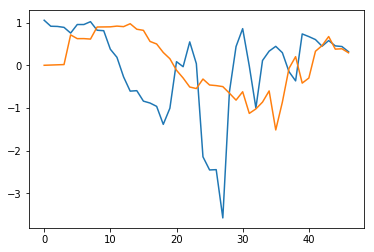

56 B08 Payables and Accruals
for these parameters -  (1, 0, 1) ct (0, 1, 1, 1)  this -  7.908801920132367 is MAPE ERROR calculated for last five available forecasting values


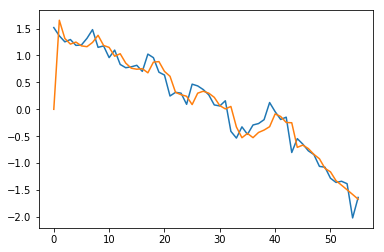

45 B09 Payables and Accruals
for these parameters -  (1, 0, 1) n (2, 1, 0, 9)  this -  30.718631262881914 is MAPE ERROR calculated for last five available forecasting values


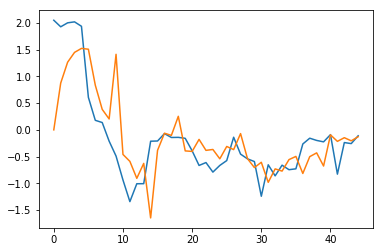

5 B11 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


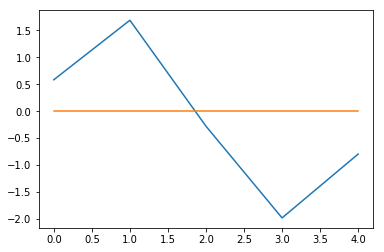

4 B12 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


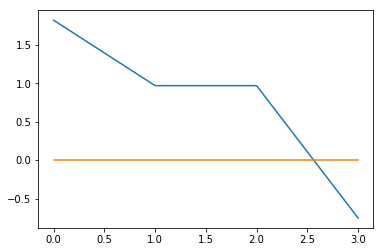

56 B13 Payables and Accruals
for these parameters -  (1, 0, 1) n (2, 0, 1, 1)  this -  52.09925370594715 is MAPE ERROR calculated for last five available forecasting values


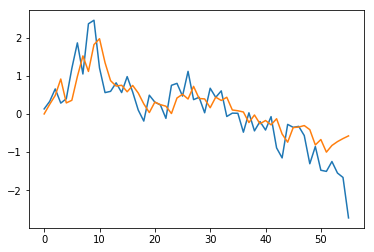

56 B15 Payables and Accruals
for these parameters -  (2, 0, 1) n (1, 0, 0, 1)  this -  107.87657547881922 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


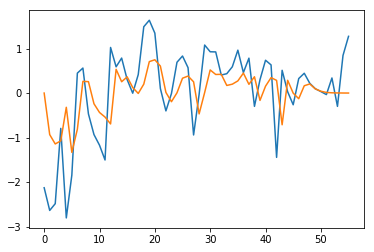

56 B16 Payables and Accruals
for these parameters -  (2, 1, 0) ct (2, 1, 0, 8)  this -  35.03931676160372 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


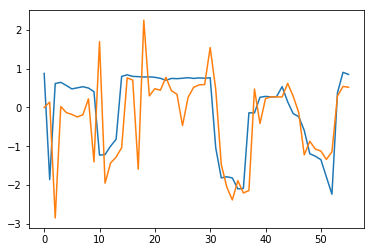

56 B17 Payables and Accruals
for these parameters -  (0, 0, 1) t (2, 1, 1, 3)  this -  8.199893468344314 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


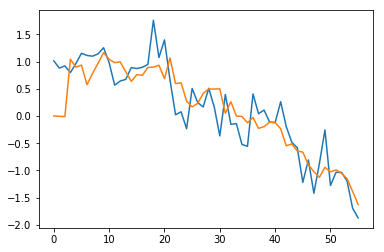

10 B18 Payables and Accruals
for these parameters -  (0, 0, 1) n (2, 0, 0, 0)  this -  0.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


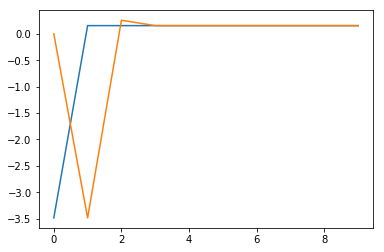

56 B19 Payables and Accruals
for these parameters -  (2, 1, 1) t (2, 0, 1, 9)  this -  4.794349619618386 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


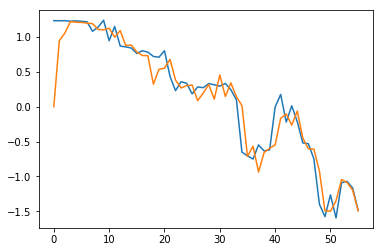

45 B20 Payables and Accruals
for these parameters -  (2, 1, 1) ct (2, 0, 1, 8)  this -  4.453946540530575 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


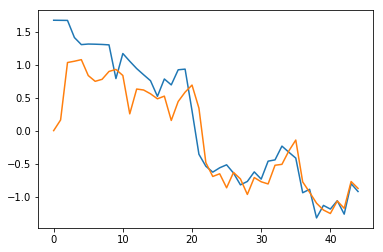

37 B21 Payables and Accruals
for these parameters -  (1, 0, 1) n (0, 1, 1, 6)  this -  24.796123200933113 is MAPE ERROR calculated for last five available forecasting values


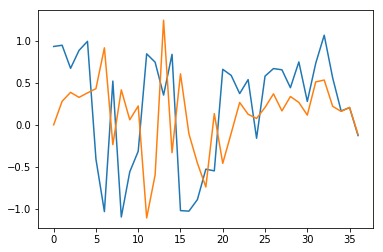

56 B22 Payables and Accruals
for these parameters -  (2, 1, 1) ct (0, 0, 1, 9)  this -  4.687529742702353 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


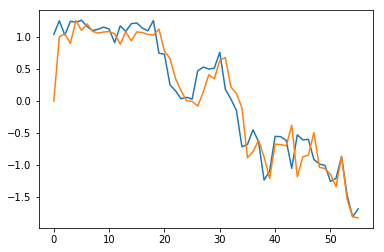

56 B23 Payables and Accruals
for these parameters -  (2, 1, 1) c (2, 0, 1, 1)  this -  31.583128801013505 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


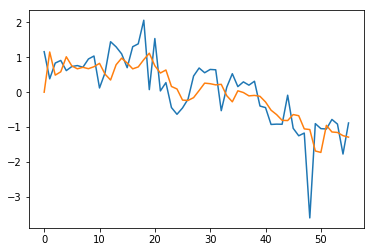

35 B24 Payables and Accruals
for these parameters -  (1, 0, 0) t (2, 0, 0, 2)  this -  16.555833661050993 is MAPE ERROR calculated for last five available forecasting values


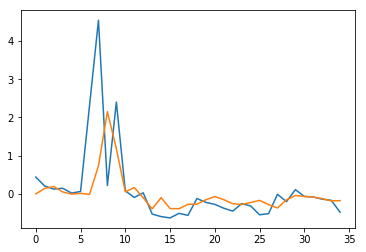

56 B25 Payables and Accruals
for these parameters -  (2, 1, 0) ct (1, 0, 1, 0)  this -  7.763440608780161 is MAPE ERROR calculated for last five available forecasting values


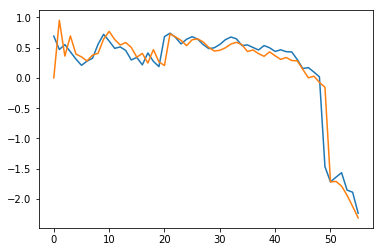

56 B27 Payables and Accruals
for these parameters -  (0, 1, 0) ct (0, 1, 0, 6)  this -  8.63702179225196 is MAPE ERROR calculated for last five available forecasting values


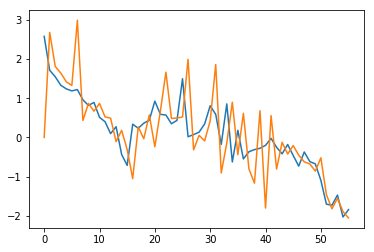

45 B28 Payables and Accruals
for these parameters -  (0, 1, 0) ct (0, 1, 0, 1)  this -  157.9152070088979 is MAPE ERROR calculated for last five available forecasting values


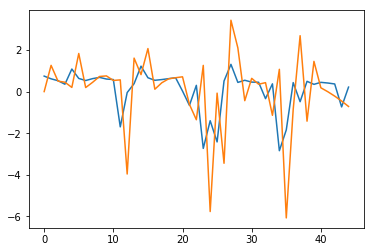

56 C02 Payables and Accruals
for these parameters -  (0, 1, 0) t (1, 1, 0, 6)  this -  41.64740150311982 is MAPE ERROR calculated for last five available forecasting values


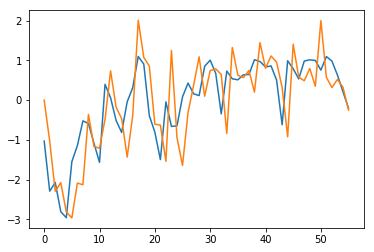

45 C03 Payables and Accruals
for these parameters -  (1, 0, 0) t (2, 0, 1, 7)  this -  9.533529710313285 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


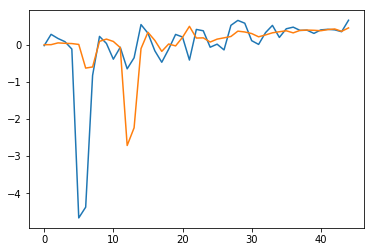

56 C04 Payables and Accruals
for these parameters -  (2, 1, 1) ct (2, 1, 1, 2)  this -  61.78485749250816 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


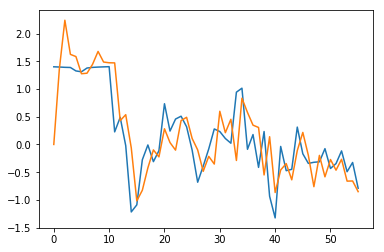

56 C06 Payables and Accruals
for these parameters -  (1, 0, 1) c (0, 1, 0, 6)  this -  9.39645589433564 is MAPE ERROR calculated for last five available forecasting values


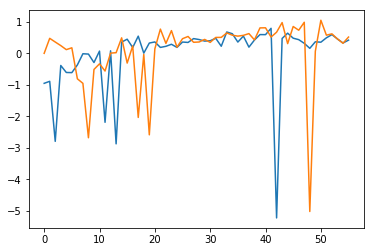

33 C08 Payables and Accruals
for these parameters -  (2, 1, 0) n (1, 1, 1, 6)  this -  32.51139301294268 is MAPE ERROR calculated for last five available forecasting values


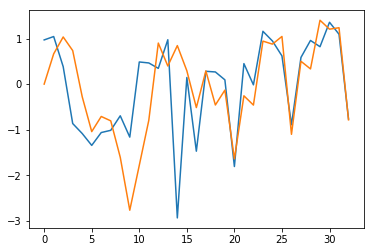

56 C09 Payables and Accruals
for these parameters -  (1, 0, 0) n (2, 0, 0, 0)  this -  79.76943937821342 is MAPE ERROR calculated for last five available forecasting values


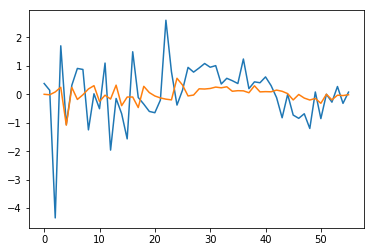

56 D04 Payables and Accruals
for these parameters -  (2, 0, 1) n (0, 1, 0, 6)  this -  6.715228544368849 is MAPE ERROR calculated for last five available forecasting values


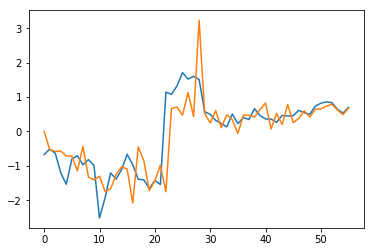

21 D05 Payables and Accruals
for these parameters -  (0, 0, 0) c (0, 0, 1, 3)  this -  42.14491170010867 is MAPE ERROR calculated for last five available forecasting values


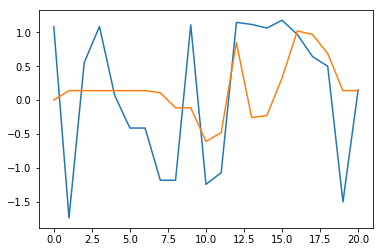

56 D06 Payables and Accruals
for these parameters -  (1, 1, 0) t (0, 1, 1, 6)  this -  23.597870053866274 is MAPE ERROR calculated for last five available forecasting values


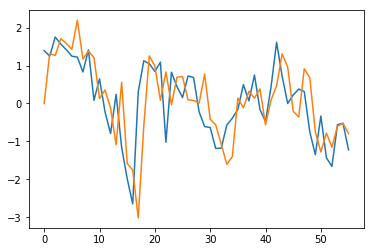

38 D07 Payables and Accruals
for these parameters -  (2, 1, 1) t (2, 1, 1, 6)  this -  36.5168663763013 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


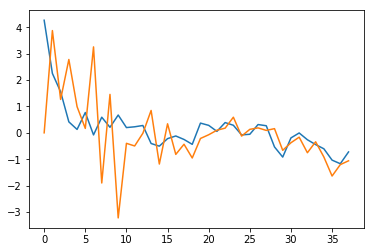

56 D10 Payables and Accruals
for these parameters -  (0, 1, 1) ct (0, 1, 0, 5)  this -  4.615739396223029 is MAPE ERROR calculated for last five available forecasting values


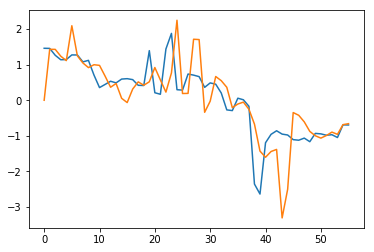

56 E09 Payables and Accruals
for these parameters -  (0, 0, 1) n (1, 1, 1, 9)  this -  22.483561338386394 is MAPE ERROR calculated for last five available forecasting values


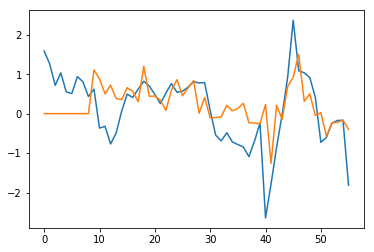

17 E10 Payables and Accruals
for these parameters -  (1, 1, 1) c (2, 0, 0, 4)  this -  45.785982106785745 is MAPE ERROR calculated for last five available forecasting values


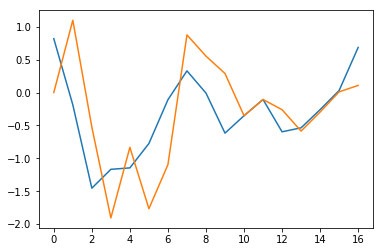

18 E11 Payables and Accruals
for these parameters -  (0, 0, 1) n (1, 0, 0, 5)  this -  73.12859040821036 is MAPE ERROR calculated for last five available forecasting values


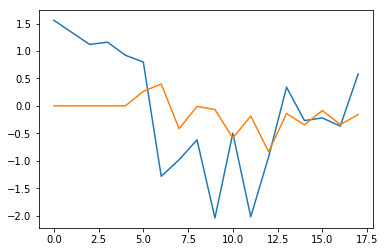

56 E12 Payables and Accruals
for these parameters -  (2, 0, 0) c (1, 1, 0, 5)  this -  41.470206861553486 is MAPE ERROR calculated for last five available forecasting values


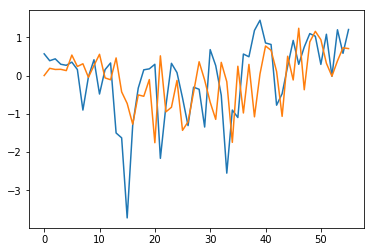

17 E13 Payables and Accruals
for these parameters -  (0, 0, 1) ct (0, 0, 1, 3)  this -  39.469438406556066 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


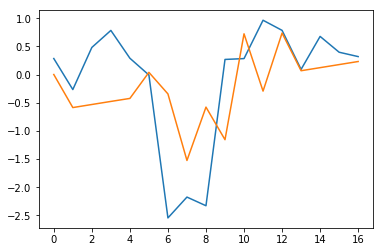

10 E15 Payables and Accruals
for these parameters -  (0, 0, 0) n (0, 1, 0, 6)  this -  62.483170109568796 is MAPE ERROR calculated for last five available forecasting values


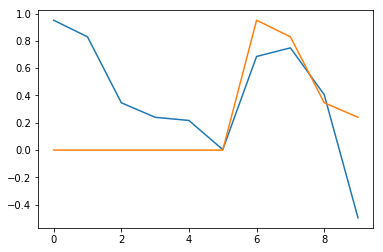

56 E16 Payables and Accruals
for these parameters -  (1, 1, 0) n (1, 1, 1, 9)  this -  21.878447186516148 is MAPE ERROR calculated for last five available forecasting values


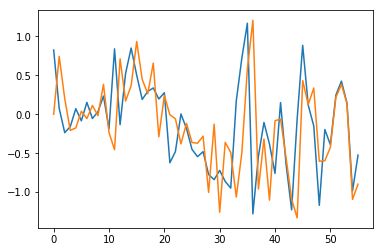

19 E17 Payables and Accruals
for these parameters -  (1, 1, 0) t (0, 1, 0, 2)  this -  42.612695694337724 is MAPE ERROR calculated for last five available forecasting values


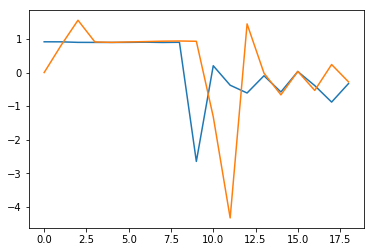

56 E18 Payables and Accruals
for these parameters -  (0, 0, 1) c (1, 1, 1, 8)  this -  16.054479381914856 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


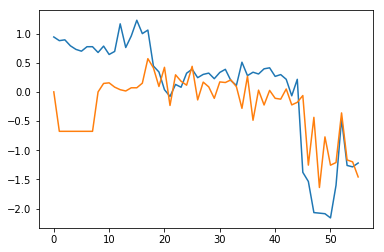

56 F02 Payables and Accruals
for these parameters -  (1, 0, 1) t (0, 1, 1, 9)  this -  238.76121539272418 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


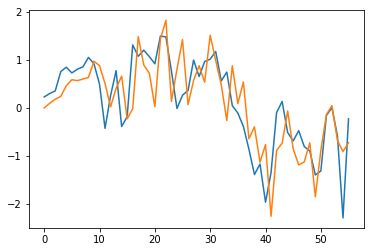

39 F03 Payables and Accruals
for these parameters -  (2, 0, 1) ct (0, 0, 1, 4)  this -  16.727175881492734 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


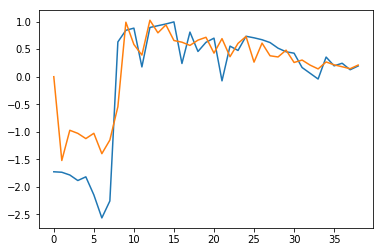

56 F04 Payables and Accruals
for these parameters -  (1, 0, 0) n (2, 0, 0, 4)  this -  36.168965335278216 is MAPE ERROR calculated for last five available forecasting values


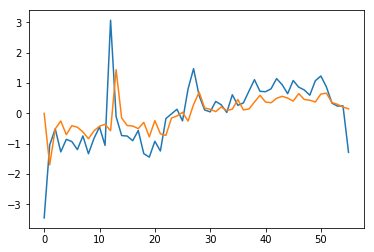

56 F05 Payables and Accruals
for these parameters -  (2, 0, 1) c (2, 0, 1, 1)  this -  84.30570863927878 is MAPE ERROR calculated for last five available forecasting values


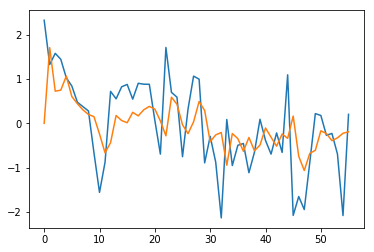

56 G01 Payables and Accruals
for these parameters -  (2, 0, 1) n (2, 0, 0, 2)  this -  73.60509573464556 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


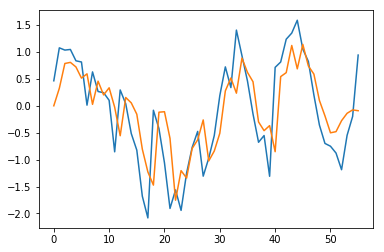

7 G03 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


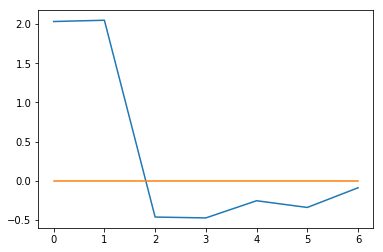

35 G04 Payables and Accruals
for these parameters -  (0, 0, 0) n (2, 0, 1, 8)  this -  20.346956026412766 is MAPE ERROR calculated for last five available forecasting values


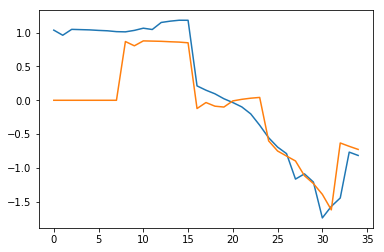

56 G05 Payables and Accruals
for these parameters -  (0, 0, 1) t (0, 1, 1, 7)  this -  14.218568358170975 is MAPE ERROR calculated for last five available forecasting values


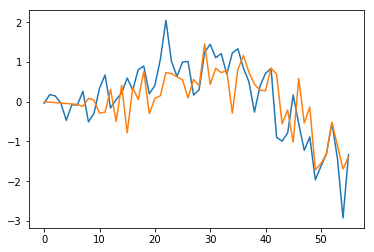

48 G06 Payables and Accruals
for these parameters -  (0, 1, 1) t (2, 1, 0, 9)  this -  9.80461137086249 is MAPE ERROR calculated for last five available forecasting values


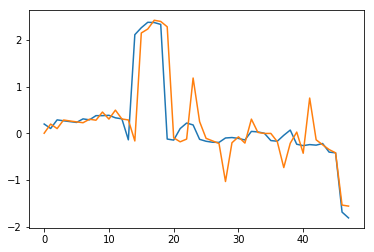

56 G08 Payables and Accruals
for these parameters -  (0, 0, 0) c (1, 0, 1, 7)  this -  81.76162620065155 is MAPE ERROR calculated for last five available forecasting values


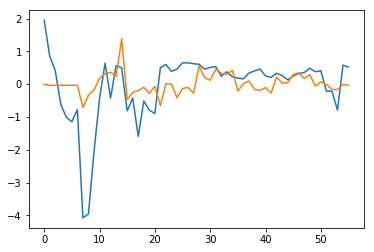

56 G10 Payables and Accruals
for these parameters -  (0, 0, 0) c (1, 1, 0, 9)  this -  64.66441947359878 is MAPE ERROR calculated for last five available forecasting values


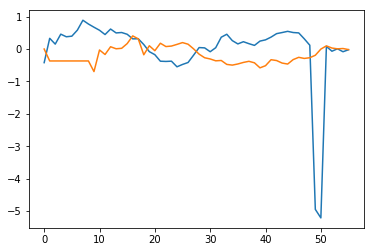

37 G11 Payables and Accruals
for these parameters -  (2, 0, 1) t (2, 0, 0, 9)  this -  23.354474515893482 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


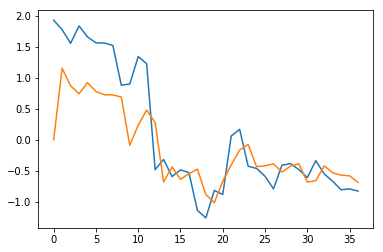

56 G12 Payables and Accruals
for these parameters -  (1, 0, 0) n (0, 1, 0, 8)  this -  18.11707549914757 is MAPE ERROR calculated for last five available forecasting values


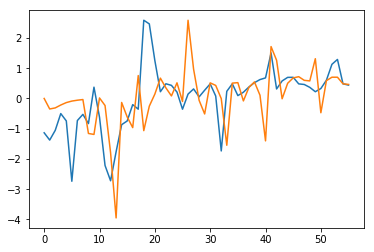

37 G13 Payables and Accruals
for these parameters -  (2, 1, 1) ct (0, 0, 1, 7)  this -  9.671145009401874 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


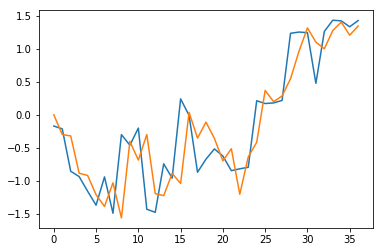

56 A01 Payables and Accruals
for these parameters -  (2, 0, 1) c (2, 1, 1, 6)  this -  24.25386252860296 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


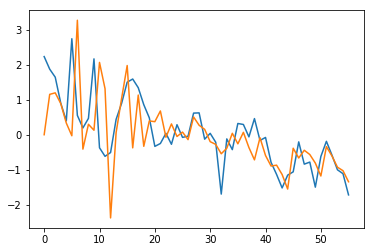

45 A02 Payables and Accruals
for these parameters -  (1, 1, 0) ct (2, 1, 1, 7)  this -  51.296707626798174 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


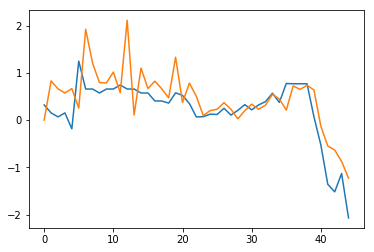

56 A03 Payables and Accruals
for these parameters -  (2, 1, 0) n (1, 0, 1, 1)  this -  289.5459719480807 is MAPE ERROR calculated for last five available forecasting values


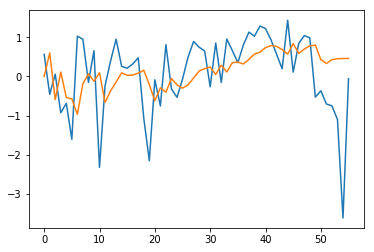

56 B01 Payables and Accruals
for these parameters -  (0, 1, 0) ct (2, 1, 0, 7)  this -  19.707033542291043 is MAPE ERROR calculated for last five available forecasting values


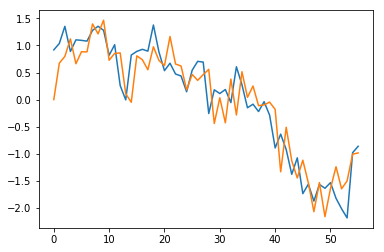

34 B02 Payables and Accruals
for these parameters -  (2, 0, 0) n (0, 1, 0, 4)  this -  52.80147609463446 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


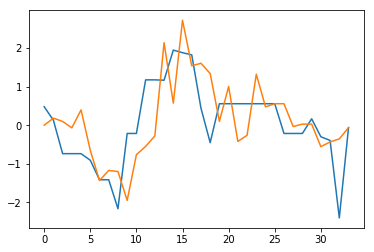

56 B03 Payables and Accruals
for these parameters -  (0, 0, 0) c (0, 1, 1, 4)  this -  40.38158410742664 is MAPE ERROR calculated for last five available forecasting values


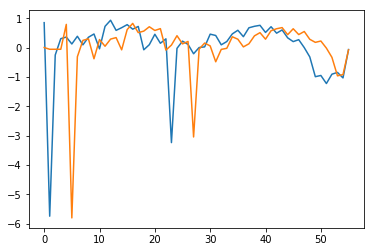

37 B04 Payables and Accruals
for these parameters -  (0, 1, 1) t (1, 0, 1, 5)  this -  9.08608772908141 is MAPE ERROR calculated for last five available forecasting values


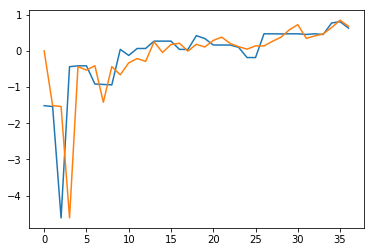

56 B05 Payables and Accruals
for these parameters -  (0, 1, 1) n (2, 0, 0, 4)  this -  43.078090418821375 is MAPE ERROR calculated for last five available forecasting values


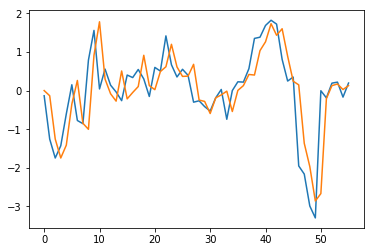

47 B07 Payables and Accruals
for these parameters -  (0, 0, 0) t (2, 1, 0, 4)  this -  11.186679730482574 is MAPE ERROR calculated for last five available forecasting values


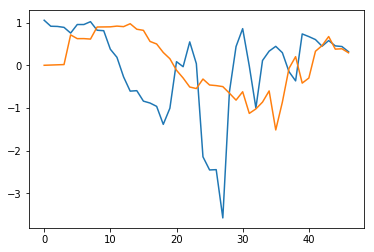

56 B08 Payables and Accruals
for these parameters -  (1, 0, 1) ct (0, 1, 1, 1)  this -  7.908801920132367 is MAPE ERROR calculated for last five available forecasting values


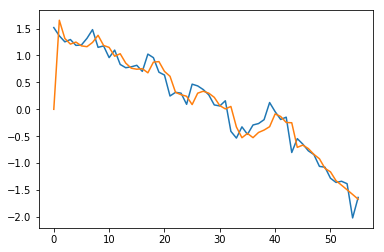

45 B09 Payables and Accruals
for these parameters -  (1, 0, 1) n (2, 1, 0, 9)  this -  30.718631262881914 is MAPE ERROR calculated for last five available forecasting values


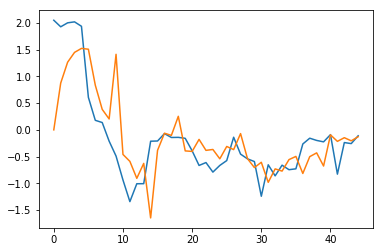

5 B11 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


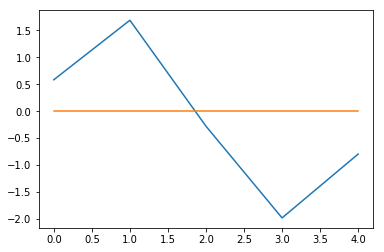

4 B12 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


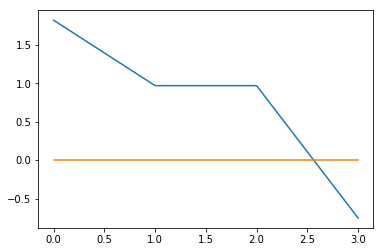

56 B13 Payables and Accruals
for these parameters -  (1, 0, 1) n (2, 0, 1, 1)  this -  52.09925370594715 is MAPE ERROR calculated for last five available forecasting values


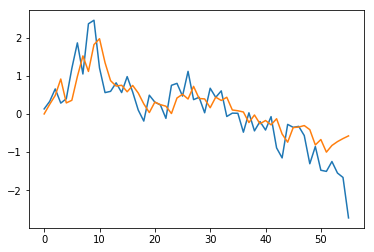

56 B15 Payables and Accruals
for these parameters -  (2, 0, 1) n (1, 0, 0, 1)  this -  107.87657547881922 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


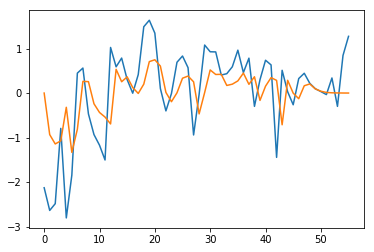

56 B16 Payables and Accruals
for these parameters -  (2, 1, 0) ct (2, 1, 0, 8)  this -  35.03931676160372 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


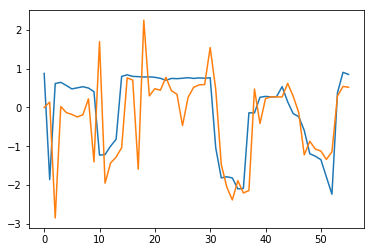

56 B17 Payables and Accruals
for these parameters -  (0, 0, 1) t (2, 1, 1, 3)  this -  8.199893468344314 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


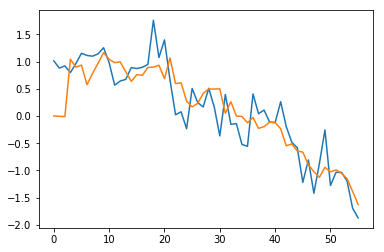

10 B18 Payables and Accruals
for these parameters -  (0, 0, 1) n (2, 0, 0, 0)  this -  0.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


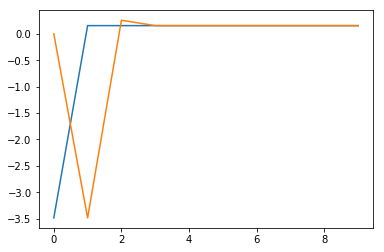

56 B19 Payables and Accruals
for these parameters -  (2, 1, 1) t (2, 0, 1, 9)  this -  4.794349619618386 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


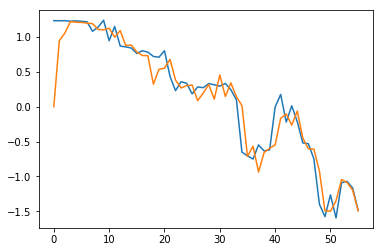

45 B20 Payables and Accruals
for these parameters -  (2, 1, 1) ct (2, 0, 1, 8)  this -  4.453946540530575 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


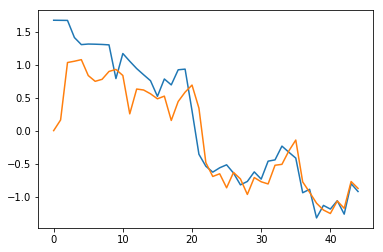

37 B21 Payables and Accruals
for these parameters -  (1, 0, 1) n (0, 1, 1, 6)  this -  24.796123200933113 is MAPE ERROR calculated for last five available forecasting values


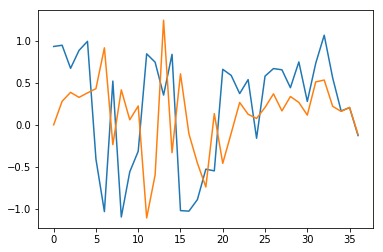

56 B22 Payables and Accruals
for these parameters -  (2, 1, 1) ct (0, 0, 1, 9)  this -  4.687529742702353 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


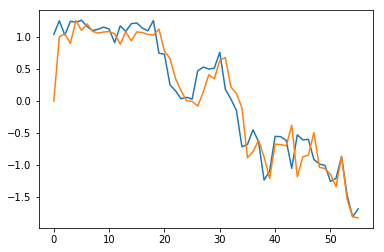

56 B23 Payables and Accruals
for these parameters -  (2, 1, 1) c (2, 0, 1, 1)  this -  31.583128801013505 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


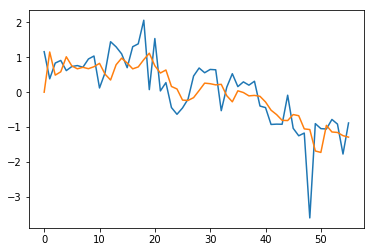

35 B24 Payables and Accruals
for these parameters -  (1, 0, 0) t (2, 0, 0, 2)  this -  16.555833661050993 is MAPE ERROR calculated for last five available forecasting values


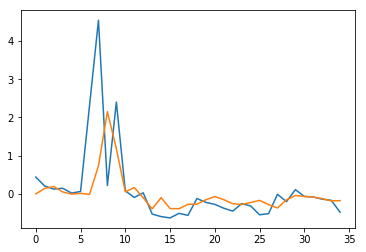

56 B25 Payables and Accruals
for these parameters -  (2, 1, 0) ct (1, 0, 1, 0)  this -  7.763440608780161 is MAPE ERROR calculated for last five available forecasting values


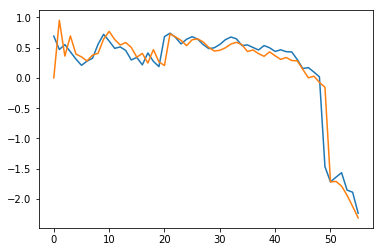

56 B27 Payables and Accruals
for these parameters -  (0, 1, 0) ct (0, 1, 0, 6)  this -  8.63702179225196 is MAPE ERROR calculated for last five available forecasting values


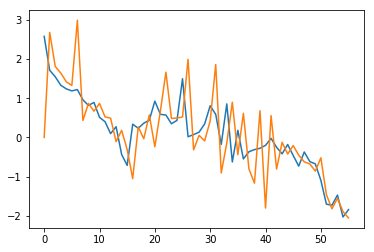

45 B28 Payables and Accruals
for these parameters -  (0, 1, 0) ct (0, 1, 0, 1)  this -  157.9152070088979 is MAPE ERROR calculated for last five available forecasting values


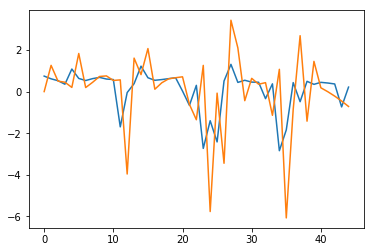

56 C02 Payables and Accruals
for these parameters -  (0, 1, 0) t (1, 1, 0, 6)  this -  41.64740150311982 is MAPE ERROR calculated for last five available forecasting values


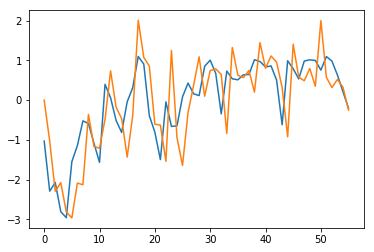

45 C03 Payables and Accruals
for these parameters -  (1, 0, 0) t (2, 0, 1, 7)  this -  9.533529710313285 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


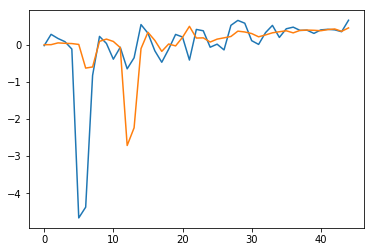

56 C04 Payables and Accruals
for these parameters -  (2, 1, 1) ct (2, 1, 1, 2)  this -  61.78485749250816 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


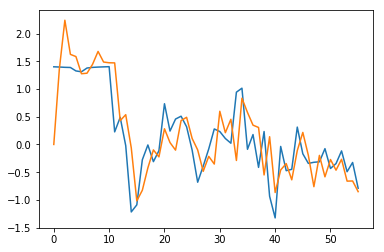

56 C06 Payables and Accruals
for these parameters -  (1, 0, 1) c (0, 1, 0, 6)  this -  9.39645589433564 is MAPE ERROR calculated for last five available forecasting values


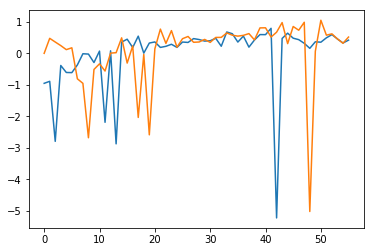

33 C08 Payables and Accruals
for these parameters -  (2, 1, 0) n (1, 1, 1, 6)  this -  32.51139301294268 is MAPE ERROR calculated for last five available forecasting values


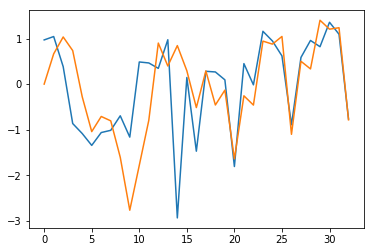

56 C09 Payables and Accruals
for these parameters -  (1, 0, 0) n (2, 0, 0, 0)  this -  79.76943937821342 is MAPE ERROR calculated for last five available forecasting values


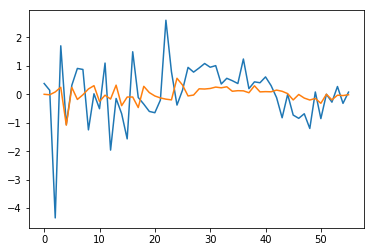

56 D04 Payables and Accruals
for these parameters -  (2, 0, 1) n (0, 1, 0, 6)  this -  6.715228544368849 is MAPE ERROR calculated for last five available forecasting values


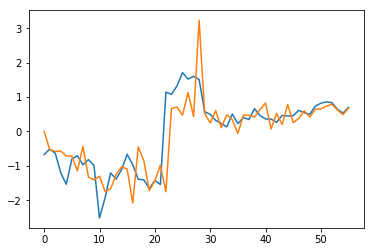

21 D05 Payables and Accruals
for these parameters -  (0, 0, 0) c (0, 0, 1, 3)  this -  42.14491170010867 is MAPE ERROR calculated for last five available forecasting values


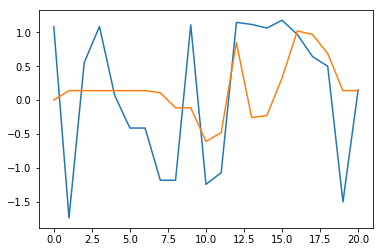

56 D06 Payables and Accruals
for these parameters -  (1, 1, 0) t (0, 1, 1, 6)  this -  23.597870053866274 is MAPE ERROR calculated for last five available forecasting values


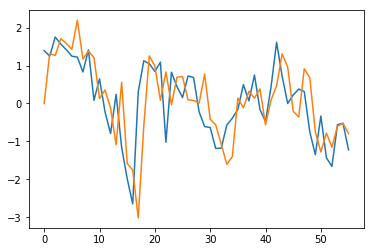

38 D07 Payables and Accruals
for these parameters -  (2, 1, 1) t (2, 1, 1, 6)  this -  36.5168663763013 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


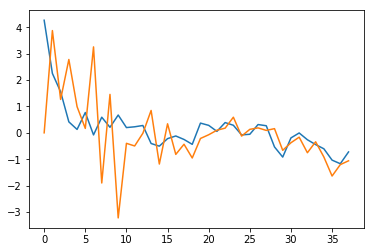

56 D10 Payables and Accruals
for these parameters -  (0, 1, 1) ct (0, 1, 0, 5)  this -  4.615739396223029 is MAPE ERROR calculated for last five available forecasting values


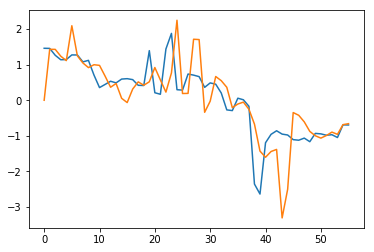

56 E09 Payables and Accruals
for these parameters -  (0, 0, 1) n (1, 1, 1, 9)  this -  22.483561338386394 is MAPE ERROR calculated for last five available forecasting values


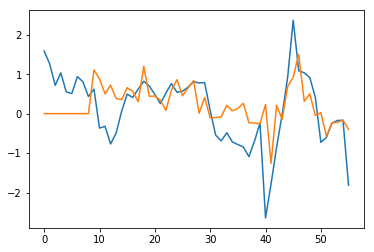

17 E10 Payables and Accruals
for these parameters -  (1, 1, 1) c (2, 0, 0, 4)  this -  45.785982106785745 is MAPE ERROR calculated for last five available forecasting values


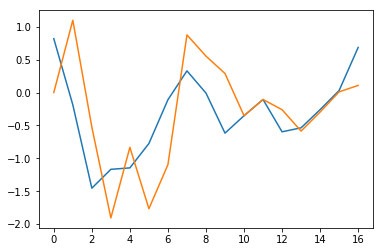

18 E11 Payables and Accruals
for these parameters -  (0, 0, 1) n (1, 0, 0, 5)  this -  73.12859040821036 is MAPE ERROR calculated for last five available forecasting values


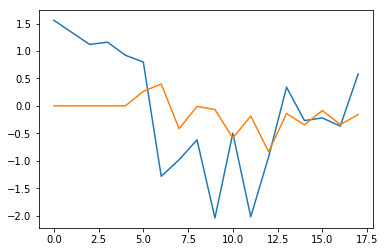

56 E12 Payables and Accruals
for these parameters -  (2, 0, 0) c (1, 1, 0, 5)  this -  41.470206861553486 is MAPE ERROR calculated for last five available forecasting values


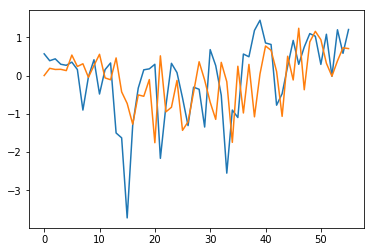

17 E13 Payables and Accruals
for these parameters -  (0, 0, 1) ct (0, 0, 1, 3)  this -  39.469438406556066 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


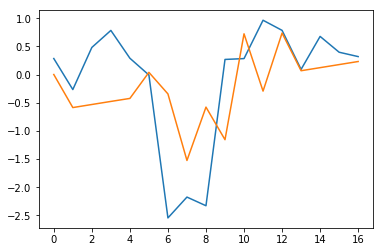

10 E15 Payables and Accruals
for these parameters -  (0, 0, 0) n (0, 1, 0, 6)  this -  62.483170109568796 is MAPE ERROR calculated for last five available forecasting values


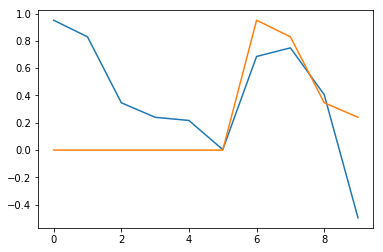

56 E16 Payables and Accruals
for these parameters -  (1, 1, 0) n (1, 1, 1, 9)  this -  21.878447186516148 is MAPE ERROR calculated for last five available forecasting values


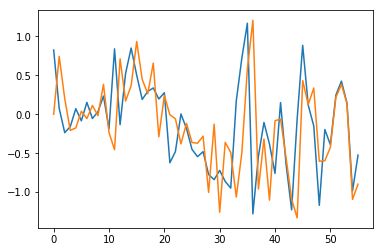

19 E17 Payables and Accruals
for these parameters -  (1, 1, 0) t (0, 1, 0, 2)  this -  42.612695694337724 is MAPE ERROR calculated for last five available forecasting values


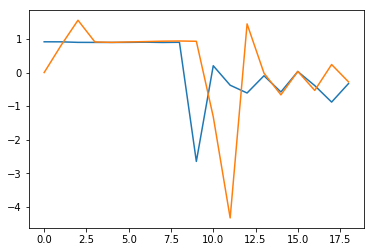

56 E18 Payables and Accruals
for these parameters -  (0, 0, 1) c (1, 1, 1, 8)  this -  16.054479381914856 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


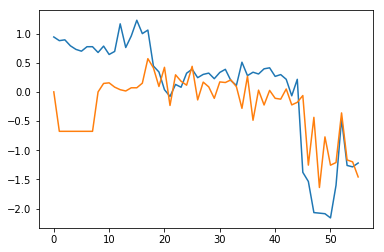

56 F02 Payables and Accruals
for these parameters -  (1, 0, 1) t (0, 1, 1, 9)  this -  238.76121539272418 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


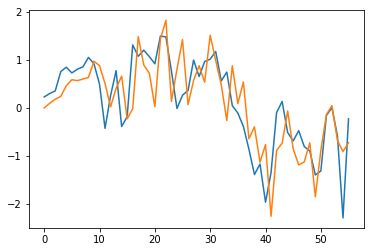

39 F03 Payables and Accruals
for these parameters -  (2, 0, 1) ct (0, 0, 1, 4)  this -  16.727175881492734 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


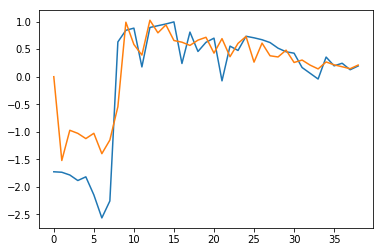

56 F04 Payables and Accruals
for these parameters -  (1, 0, 0) n (2, 0, 0, 4)  this -  36.168965335278216 is MAPE ERROR calculated for last five available forecasting values


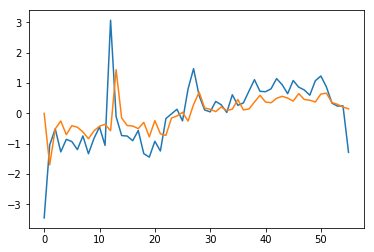

56 F05 Payables and Accruals
for these parameters -  (2, 0, 1) c (2, 0, 1, 1)  this -  84.30570863927878 is MAPE ERROR calculated for last five available forecasting values


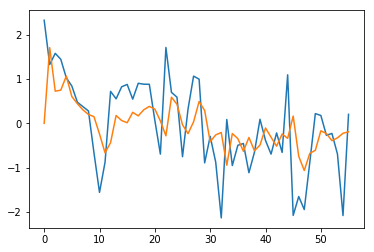

56 G01 Payables and Accruals
for these parameters -  (2, 0, 1) n (2, 0, 0, 2)  this -  73.60509573464556 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


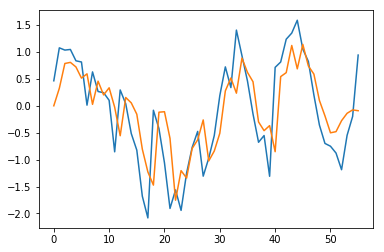

0 G02 Payables and Accruals
-1
7 G03 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


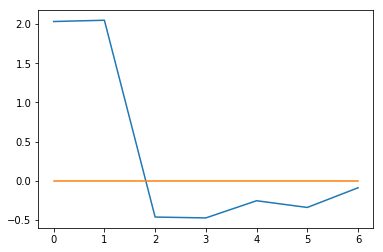

35 G04 Payables and Accruals
for these parameters -  (0, 0, 0) n (2, 0, 1, 8)  this -  20.346956026412766 is MAPE ERROR calculated for last five available forecasting values


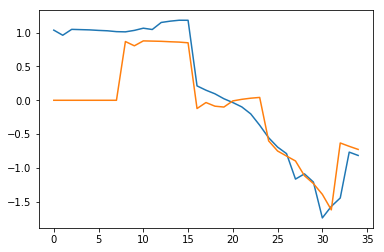

56 G05 Payables and Accruals
for these parameters -  (0, 0, 1) t (0, 1, 1, 7)  this -  14.218568358170975 is MAPE ERROR calculated for last five available forecasting values


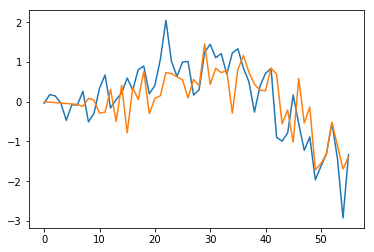

48 G06 Payables and Accruals
for these parameters -  (0, 1, 1) t (2, 1, 0, 9)  this -  9.80461137086249 is MAPE ERROR calculated for last five available forecasting values


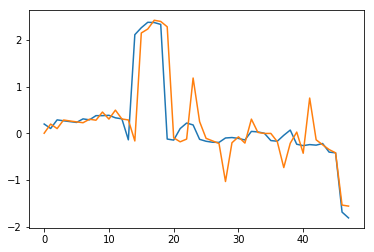

56 G08 Payables and Accruals
for these parameters -  (0, 0, 0) c (1, 0, 1, 7)  this -  81.76162620065155 is MAPE ERROR calculated for last five available forecasting values


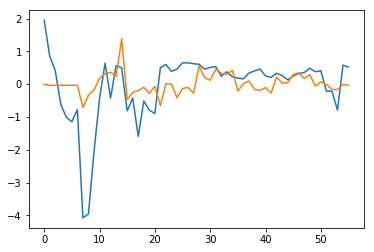

56 G10 Payables and Accruals
for these parameters -  (0, 0, 0) c (1, 1, 0, 9)  this -  64.66441947359878 is MAPE ERROR calculated for last five available forecasting values


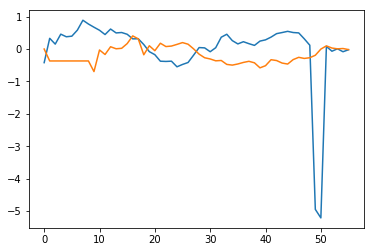

37 G11 Payables and Accruals
for these parameters -  (2, 0, 1) t (2, 0, 0, 9)  this -  23.354474515893482 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


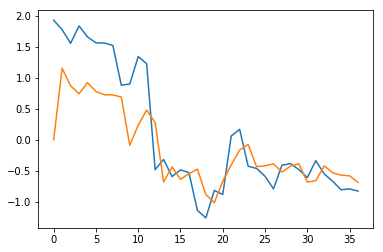

56 G12 Payables and Accruals
for these parameters -  (1, 0, 0) n (0, 1, 0, 8)  this -  18.11707549914757 is MAPE ERROR calculated for last five available forecasting values


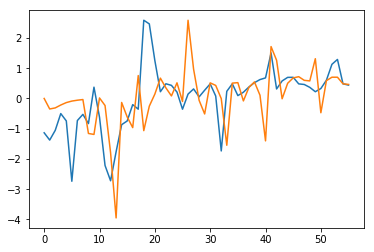

37 G13 Payables and Accruals
for these parameters -  (2, 1, 1) ct (0, 0, 1, 7)  this -  9.671145009401874 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


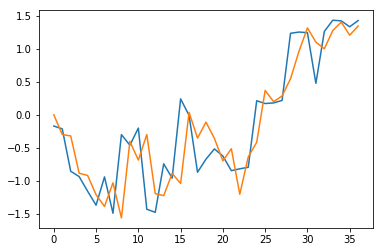

56 A01 Payables and Accruals
for these parameters -  (2, 0, 1) c (2, 1, 1, 6)  this -  24.25386252860296 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


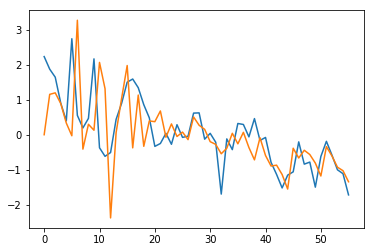

45 A02 Payables and Accruals
for these parameters -  (1, 1, 0) ct (2, 1, 1, 7)  this -  51.296707626798174 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


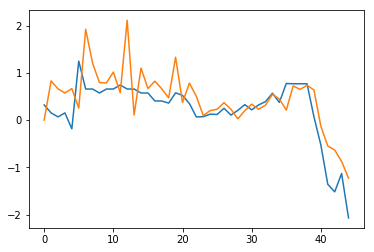

56 A03 Payables and Accruals
for these parameters -  (2, 1, 0) n (1, 0, 1, 1)  this -  289.5459719480807 is MAPE ERROR calculated for last five available forecasting values


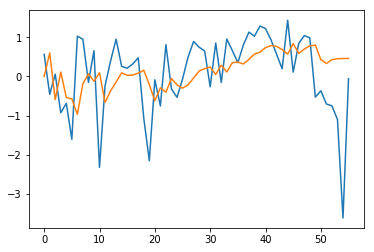

56 B01 Payables and Accruals
for these parameters -  (0, 1, 0) ct (2, 1, 0, 7)  this -  19.707033542291043 is MAPE ERROR calculated for last five available forecasting values


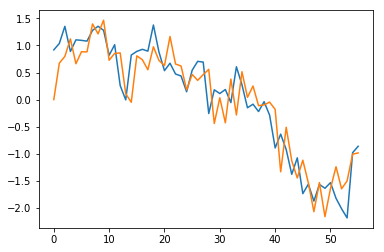

34 B02 Payables and Accruals
for these parameters -  (2, 0, 0) n (0, 1, 0, 4)  this -  52.80147609463446 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


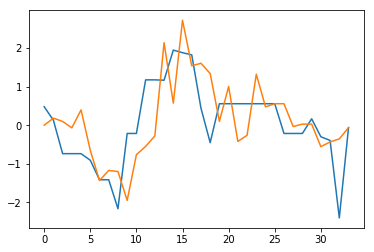

56 B03 Payables and Accruals
for these parameters -  (0, 0, 0) c (0, 1, 1, 4)  this -  40.38158410742664 is MAPE ERROR calculated for last five available forecasting values


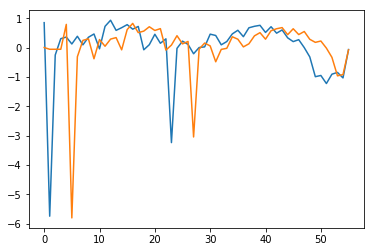

37 B04 Payables and Accruals
for these parameters -  (0, 1, 1) t (1, 0, 1, 5)  this -  9.08608772908141 is MAPE ERROR calculated for last five available forecasting values


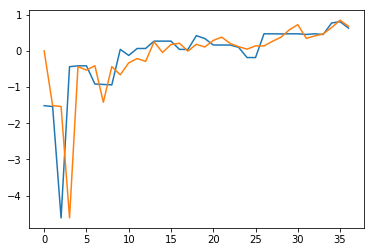

56 B05 Payables and Accruals
for these parameters -  (0, 1, 1) n (2, 0, 0, 4)  this -  43.078090418821375 is MAPE ERROR calculated for last five available forecasting values


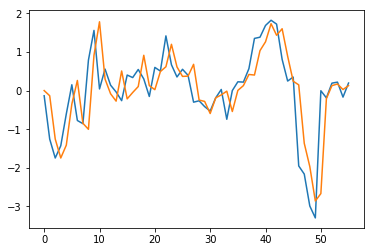

47 B07 Payables and Accruals
for these parameters -  (0, 0, 0) t (2, 1, 0, 4)  this -  11.186679730482574 is MAPE ERROR calculated for last five available forecasting values


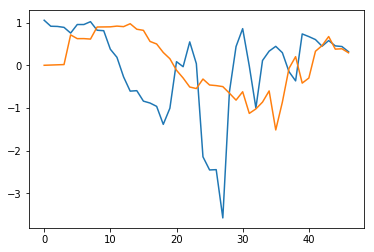

56 B08 Payables and Accruals
for these parameters -  (1, 0, 1) ct (0, 1, 1, 1)  this -  7.908801920132367 is MAPE ERROR calculated for last five available forecasting values


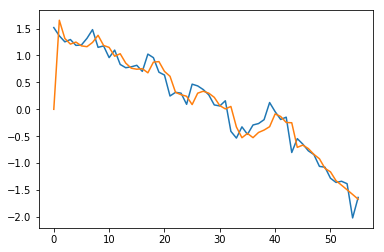

45 B09 Payables and Accruals
for these parameters -  (1, 0, 1) n (2, 1, 0, 9)  this -  30.718631262881914 is MAPE ERROR calculated for last five available forecasting values


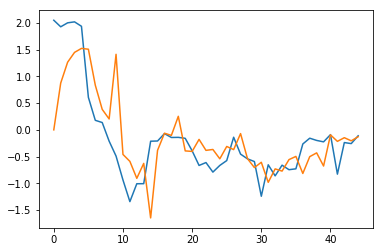

5 B11 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


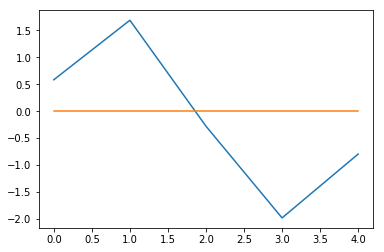

4 B12 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


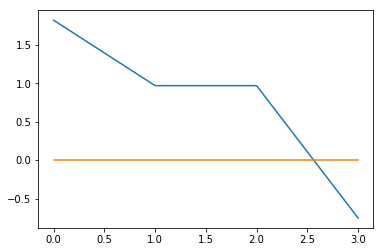

56 B13 Payables and Accruals
for these parameters -  (1, 0, 1) n (2, 0, 1, 1)  this -  52.09925370594715 is MAPE ERROR calculated for last five available forecasting values


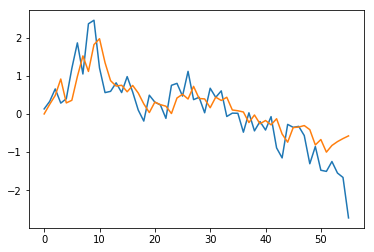

56 B15 Payables and Accruals
for these parameters -  (2, 0, 1) n (1, 0, 0, 1)  this -  107.87657547881922 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


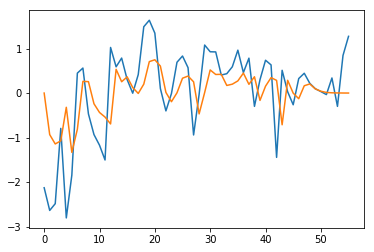

56 B16 Payables and Accruals
for these parameters -  (2, 1, 0) ct (2, 1, 0, 8)  this -  35.03931676160372 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


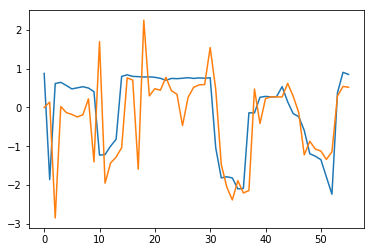

56 B17 Payables and Accruals
for these parameters -  (0, 0, 1) t (2, 1, 1, 3)  this -  8.199893468344314 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


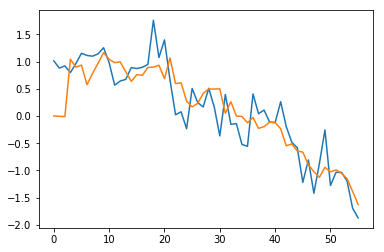

10 B18 Payables and Accruals
for these parameters -  (0, 0, 1) n (2, 0, 0, 0)  this -  0.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


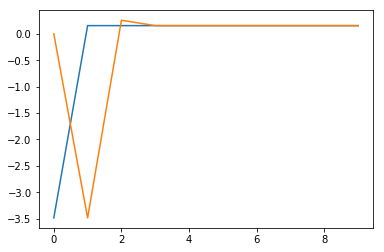

56 B19 Payables and Accruals
for these parameters -  (2, 1, 1) t (2, 0, 1, 9)  this -  4.794349619618386 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


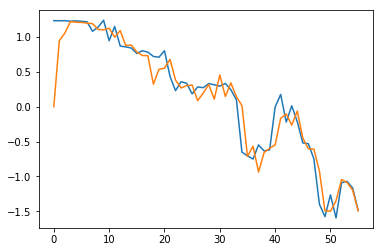

45 B20 Payables and Accruals
for these parameters -  (2, 1, 1) ct (2, 0, 1, 8)  this -  4.453946540530575 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


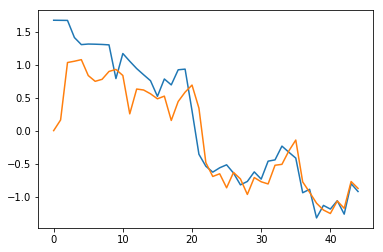

37 B21 Payables and Accruals
for these parameters -  (1, 0, 1) n (0, 1, 1, 6)  this -  24.796123200933113 is MAPE ERROR calculated for last five available forecasting values


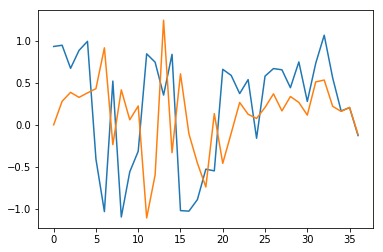

56 B22 Payables and Accruals
for these parameters -  (2, 1, 1) ct (0, 0, 1, 9)  this -  4.687529742702353 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


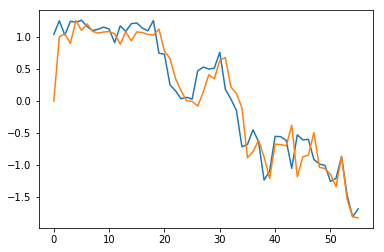

56 B23 Payables and Accruals
for these parameters -  (2, 1, 1) c (2, 0, 1, 1)  this -  31.583128801013505 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


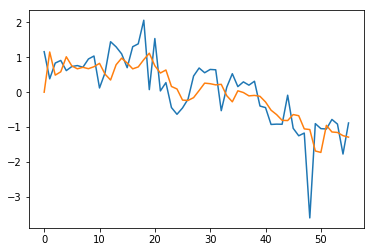

35 B24 Payables and Accruals
for these parameters -  (1, 0, 0) t (2, 0, 0, 2)  this -  16.555833661050993 is MAPE ERROR calculated for last five available forecasting values


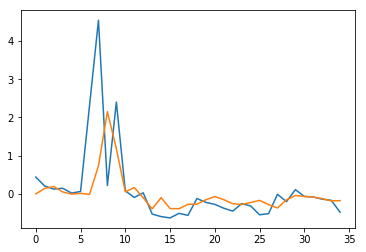

56 B25 Payables and Accruals
for these parameters -  (2, 1, 0) ct (1, 0, 1, 0)  this -  7.763440608780161 is MAPE ERROR calculated for last five available forecasting values


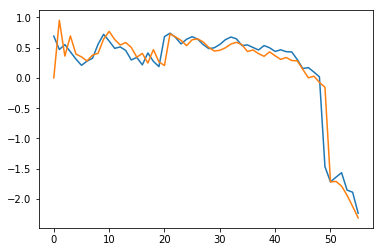

56 B27 Payables and Accruals
for these parameters -  (0, 1, 0) ct (0, 1, 0, 6)  this -  8.63702179225196 is MAPE ERROR calculated for last five available forecasting values


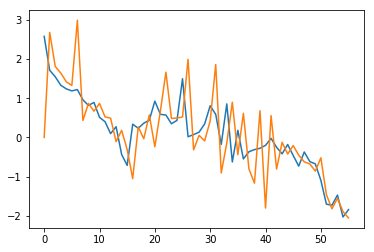

45 B28 Payables and Accruals
for these parameters -  (0, 1, 0) ct (0, 1, 0, 1)  this -  157.9152070088979 is MAPE ERROR calculated for last five available forecasting values


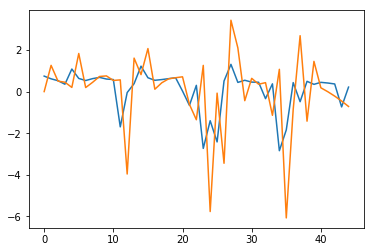

56 C02 Payables and Accruals
for these parameters -  (0, 1, 0) t (1, 1, 0, 6)  this -  41.64740150311982 is MAPE ERROR calculated for last five available forecasting values


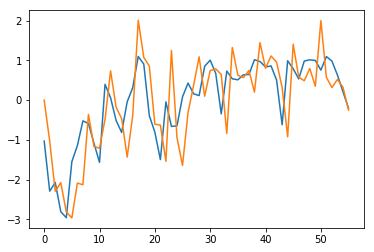

45 C03 Payables and Accruals
for these parameters -  (1, 0, 0) t (2, 0, 1, 7)  this -  9.533529710313285 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


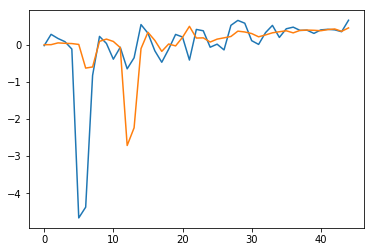

56 C04 Payables and Accruals
for these parameters -  (2, 1, 1) ct (2, 1, 1, 2)  this -  61.78485749250816 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


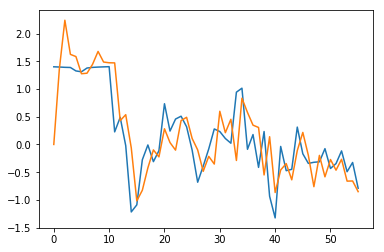

56 C06 Payables and Accruals
for these parameters -  (1, 0, 1) c (0, 1, 0, 6)  this -  9.39645589433564 is MAPE ERROR calculated for last five available forecasting values


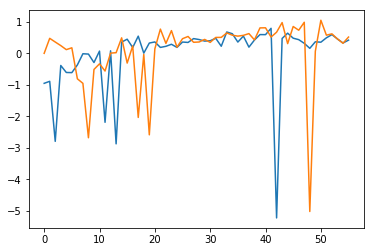

33 C08 Payables and Accruals
for these parameters -  (2, 1, 0) n (1, 1, 1, 6)  this -  32.51139301294268 is MAPE ERROR calculated for last five available forecasting values


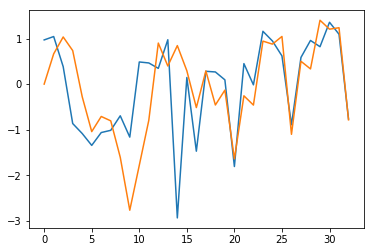

56 C09 Payables and Accruals
for these parameters -  (1, 0, 0) n (2, 0, 0, 0)  this -  79.76943937821342 is MAPE ERROR calculated for last five available forecasting values


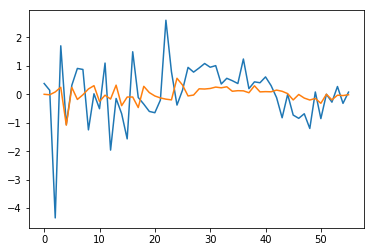

56 D04 Payables and Accruals
for these parameters -  (2, 0, 1) n (0, 1, 0, 6)  this -  6.715228544368849 is MAPE ERROR calculated for last five available forecasting values


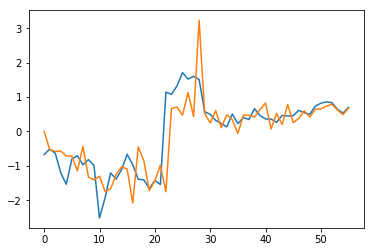

21 D05 Payables and Accruals
for these parameters -  (0, 0, 0) c (0, 0, 1, 3)  this -  42.14491170010867 is MAPE ERROR calculated for last five available forecasting values


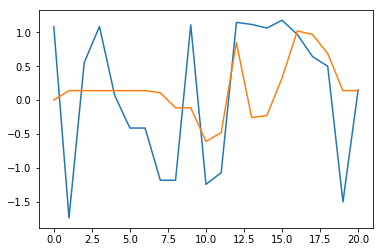

56 D06 Payables and Accruals
for these parameters -  (1, 1, 0) t (0, 1, 1, 6)  this -  23.597870053866274 is MAPE ERROR calculated for last five available forecasting values


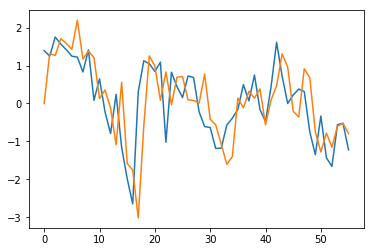

38 D07 Payables and Accruals
for these parameters -  (2, 1, 1) t (2, 1, 1, 6)  this -  36.5168663763013 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


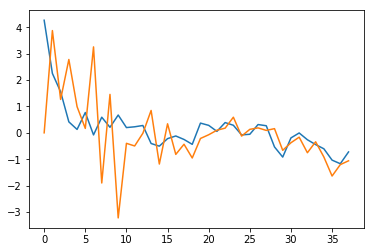

56 D10 Payables and Accruals
for these parameters -  (0, 1, 1) ct (0, 1, 0, 5)  this -  4.615739396223029 is MAPE ERROR calculated for last five available forecasting values


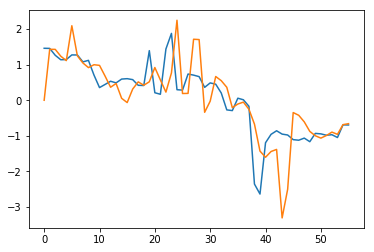

56 E09 Payables and Accruals
for these parameters -  (0, 0, 1) n (1, 1, 1, 9)  this -  22.483561338386394 is MAPE ERROR calculated for last five available forecasting values


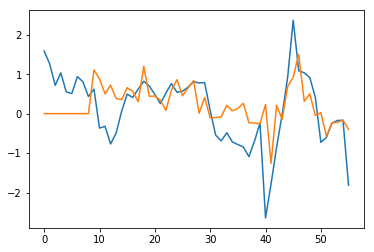

17 E10 Payables and Accruals
for these parameters -  (1, 1, 1) c (2, 0, 0, 4)  this -  45.785982106785745 is MAPE ERROR calculated for last five available forecasting values


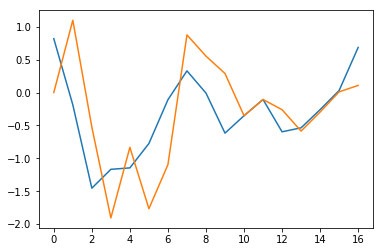

18 E11 Payables and Accruals
for these parameters -  (0, 0, 1) n (1, 0, 0, 5)  this -  73.12859040821036 is MAPE ERROR calculated for last five available forecasting values


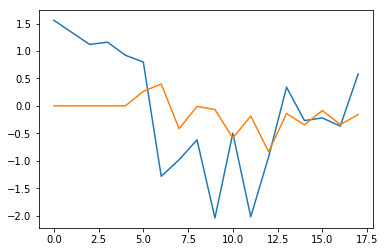

56 E12 Payables and Accruals
for these parameters -  (2, 0, 0) c (1, 1, 0, 5)  this -  41.470206861553486 is MAPE ERROR calculated for last five available forecasting values


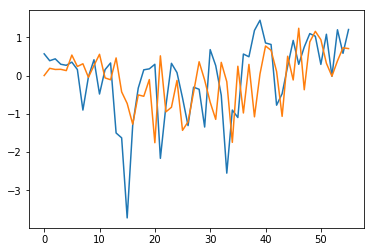

17 E13 Payables and Accruals
for these parameters -  (0, 0, 1) ct (0, 0, 1, 3)  this -  39.469438406556066 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


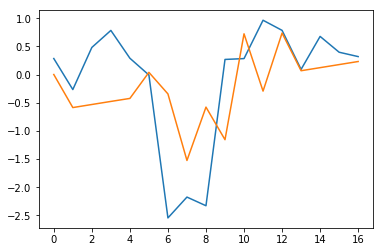

10 E15 Payables and Accruals
for these parameters -  (0, 0, 0) n (0, 1, 0, 6)  this -  62.483170109568796 is MAPE ERROR calculated for last five available forecasting values


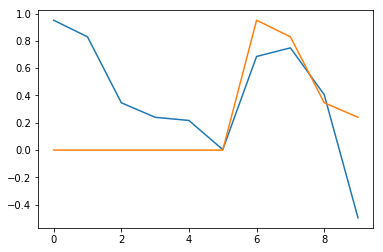

56 E16 Payables and Accruals
for these parameters -  (1, 1, 0) n (1, 1, 1, 9)  this -  21.878447186516148 is MAPE ERROR calculated for last five available forecasting values


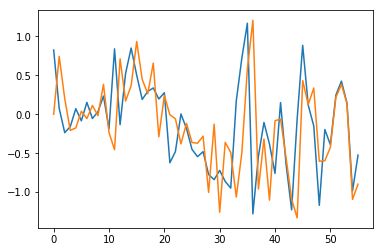

19 E17 Payables and Accruals
for these parameters -  (1, 1, 0) t (0, 1, 0, 2)  this -  42.612695694337724 is MAPE ERROR calculated for last five available forecasting values


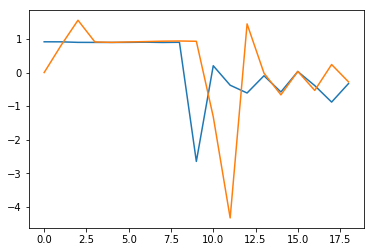

56 E18 Payables and Accruals
for these parameters -  (0, 0, 1) c (1, 1, 1, 8)  this -  16.054479381914856 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


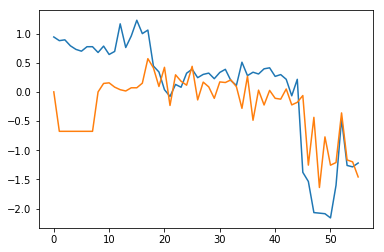

56 F02 Payables and Accruals
for these parameters -  (1, 0, 1) t (0, 1, 1, 9)  this -  238.76121539272418 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


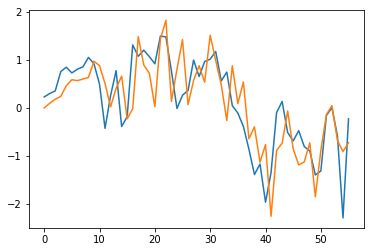

39 F03 Payables and Accruals
for these parameters -  (2, 0, 1) ct (0, 0, 1, 4)  this -  16.727175881492734 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


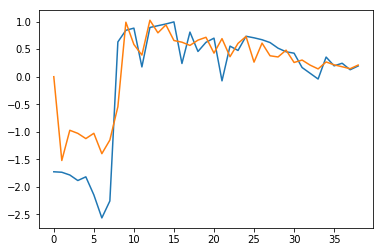

56 F04 Payables and Accruals
for these parameters -  (1, 0, 0) n (2, 0, 0, 4)  this -  36.168965335278216 is MAPE ERROR calculated for last five available forecasting values


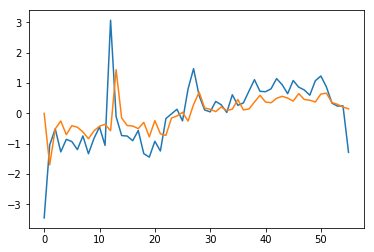

56 F05 Payables and Accruals
for these parameters -  (2, 0, 1) c (2, 0, 1, 1)  this -  84.30570863927878 is MAPE ERROR calculated for last five available forecasting values


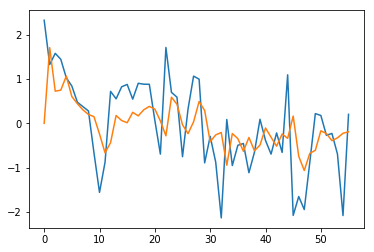

56 G01 Payables and Accruals
for these parameters -  (2, 0, 1) n (2, 0, 0, 2)  this -  73.60509573464556 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


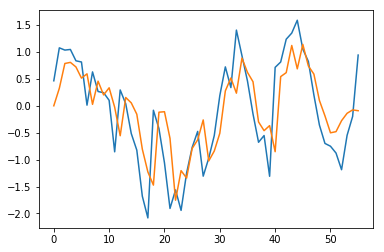

0 G02 Payables and Accruals
-1
7 G03 Payables and Accruals
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)

C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)
C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


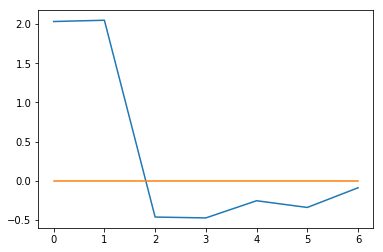

35 G04 Payables and Accruals
for these parameters -  (0, 0, 0) n (2, 0, 1, 8)  this -  20.346956026412766 is MAPE ERROR calculated for last five available forecasting values


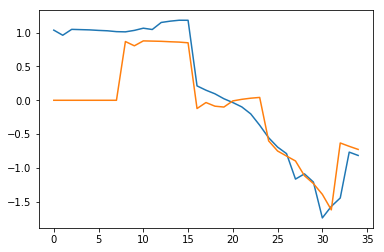

56 G05 Payables and Accruals
for these parameters -  (0, 0, 1) t (0, 1, 1, 7)  this -  14.218568358170975 is MAPE ERROR calculated for last five available forecasting values


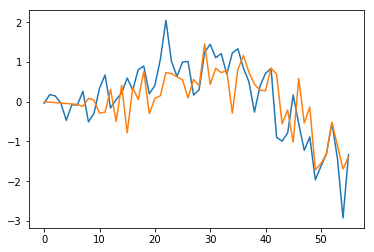

48 G06 Payables and Accruals
for these parameters -  (0, 1, 1) t (2, 1, 0, 9)  this -  9.80461137086249 is MAPE ERROR calculated for last five available forecasting values


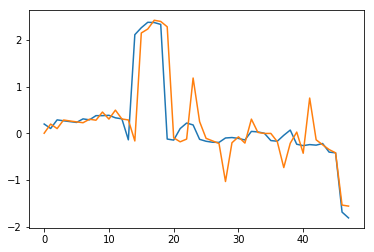

56 G08 Payables and Accruals
for these parameters -  (0, 0, 0) c (1, 0, 1, 7)  this -  81.76162620065155 is MAPE ERROR calculated for last five available forecasting values


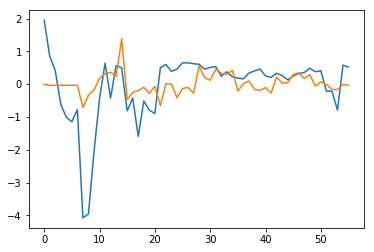

56 G10 Payables and Accruals
for these parameters -  (0, 0, 0) c (1, 1, 0, 9)  this -  64.66441947359878 is MAPE ERROR calculated for last five available forecasting values


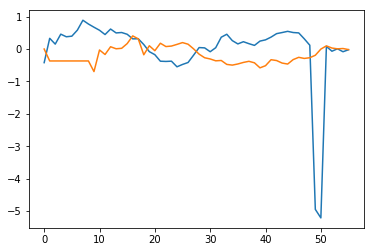

37 G11 Payables and Accruals
for these parameters -  (2, 0, 1) t (2, 0, 0, 9)  this -  23.354474515893482 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


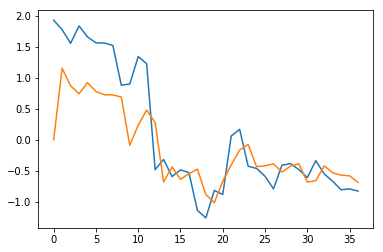

56 G12 Payables and Accruals
for these parameters -  (1, 0, 0) n (0, 1, 0, 8)  this -  18.11707549914757 is MAPE ERROR calculated for last five available forecasting values


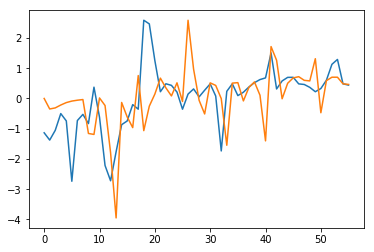

37 G13 Payables and Accruals
for these parameters -  (2, 1, 1) ct (0, 0, 1, 7)  this -  9.671145009401874 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


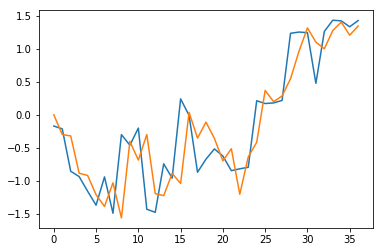

56 A01 Receivables
for these parameters -  (2, 1, 0) t (1, 0, 1, 1)  this -  1169.1179266970087 is MAPE ERROR calculated for last five available forecasting values


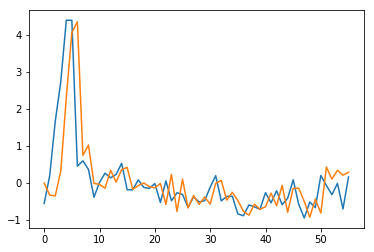

56 A03 Receivables
for these parameters -  (0, 1, 0) t (0, 1, 1, 1)  this -  23.814784994978844 is MAPE ERROR calculated for last five available forecasting values


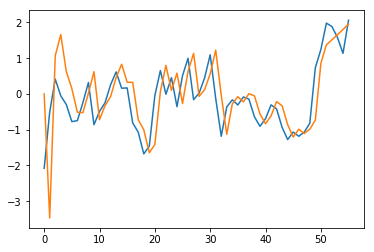

56 B01 Receivables
for these parameters -  (0, 1, 1) ct (1, 1, 1, 9)  this -  29.754372769733706 is MAPE ERROR calculated for last five available forecasting values


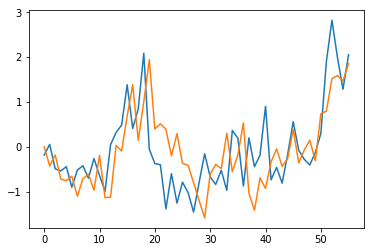

35 B03 Receivables
for these parameters -  (1, 0, 1) c (2, 1, 0, 8)  this -  732.8989929656077 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


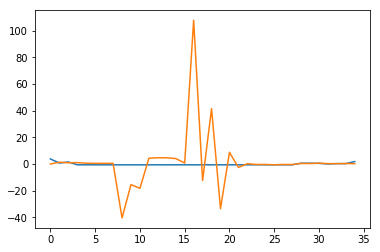

56 B05 Receivables
for these parameters -  (1, 1, 1) ct (0, 0, 1, 3)  this -  9.089264519973776 is MAPE ERROR calculated for last five available forecasting values


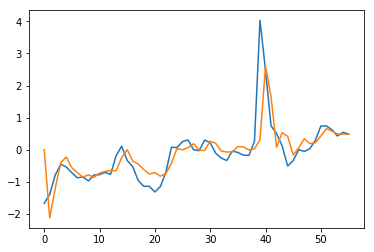

49 B07 Receivables
for these parameters -  (2, 1, 1) ct (2, 1, 0, 2)  this -  51.62333224730303 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


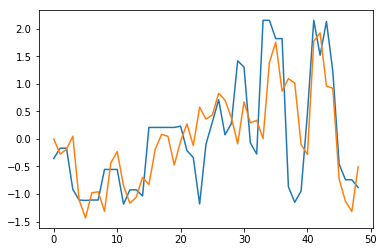

56 B08 Receivables
for these parameters -  (2, 0, 1) t (1, 0, 0, 1)  this -  101.38451577262866 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


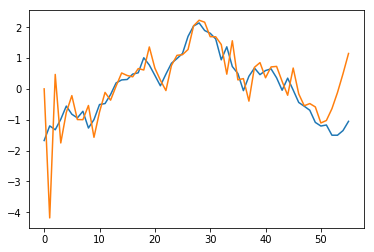

5 B11 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


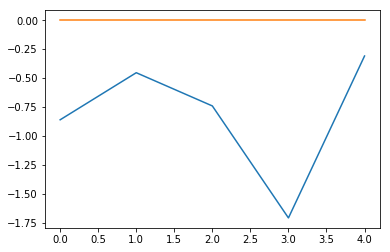

47 B13 Receivables
for these parameters -  (1, 1, 0) ct (2, 1, 0, 7)  this -  85.8345652321837 is MAPE ERROR calculated for last five available forecasting values


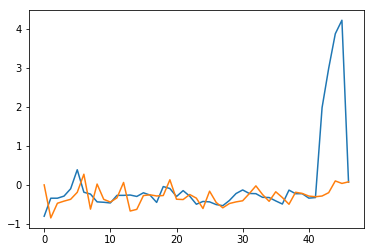

56 B15 Receivables
for these parameters -  (0, 1, 0) c (2, 0, 1, 7)  this -  2.751354525820358 is MAPE ERROR calculated for last five available forecasting values


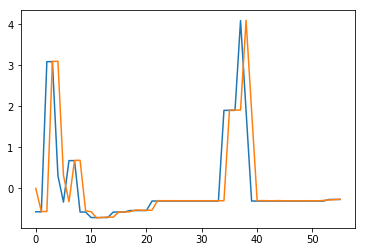

27 B17 Receivables
for these parameters -  (0, 0, 0) n (0, 1, 0, 5)  this -  53.19563398740937 is MAPE ERROR calculated for last five available forecasting values


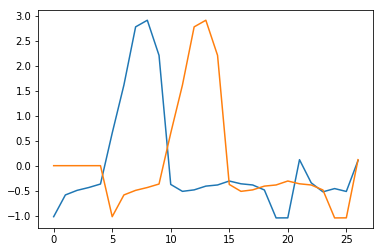

1 B19 Receivables
-1
56 B23 Receivables


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


for these parameters -  (2, 0, 0) ct (2, 1, 1, 1)  this -  257.0547722622633 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


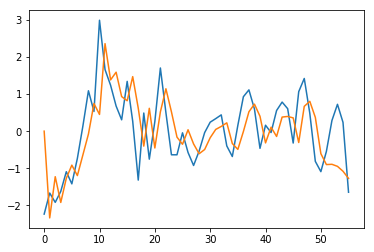

56 B25 Receivables
for these parameters -  (0, 1, 1) n (0, 1, 1, 6)  this -  8.289151453777608 is MAPE ERROR calculated for last five available forecasting values


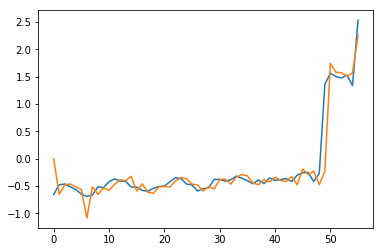

56 B27 Receivables
for these parameters -  (0, 1, 0) c (0, 1, 1, 1)  this -  22.801373764524996 is MAPE ERROR calculated for last five available forecasting values


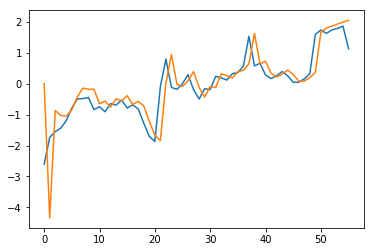

56 C02 Receivables
for these parameters -  (1, 0, 1) c (2, 1, 0, 6)  this -  20.575617121483646 is MAPE ERROR calculated for last five available forecasting values


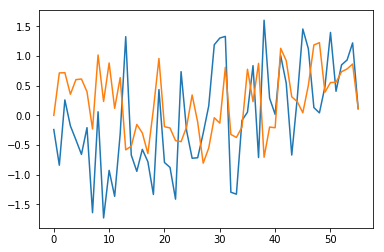

8 C04 Receivables
for these parameters -  (0, 0, 0) c (0, 0, 0, 0)  this -  76.59725324237326 is MAPE ERROR calculated for last five available forecasting values


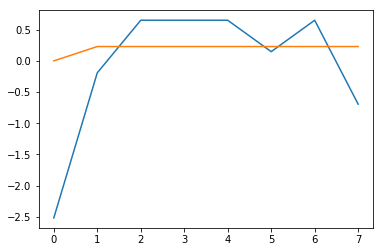

56 C06 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 1, 4)  this -  6.519461344001839 is MAPE ERROR calculated for last five available forecasting values


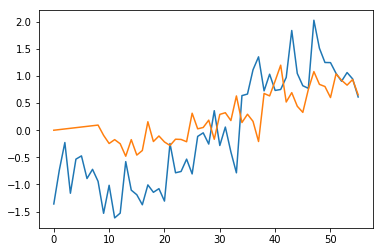

56 D04 Receivables
for these parameters -  (0, 1, 1) ct (2, 1, 1, 1)  this -  132.85685741018136 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


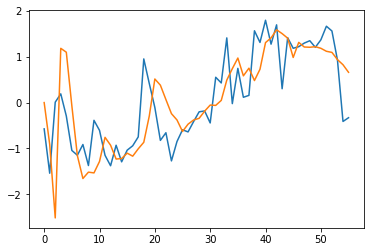

34 E02 Receivables
for these parameters -  (1, 1, 0) ct (0, 1, 0, 2)  this -  24.54128053781958 is MAPE ERROR calculated for last five available forecasting values


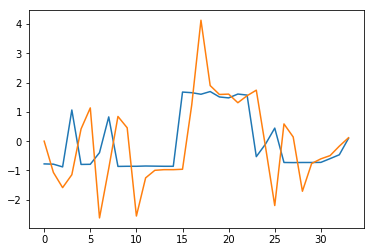

56 E09 Receivables
for these parameters -  (0, 1, 1) t (2, 0, 0, 3)  this -  5.183272019299466 is MAPE ERROR calculated for last five available forecasting values


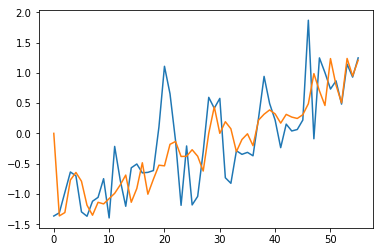

56 E12 Receivables
for these parameters -  (0, 1, 0) ct (2, 1, 0, 6)  this -  5.489010341842328 is MAPE ERROR calculated for last five available forecasting values


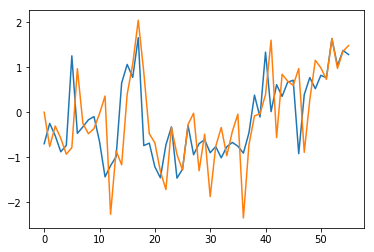

56 E16 Receivables
for these parameters -  (2, 1, 0) ct (0, 1, 1, 5)  this -  50.4297641207747 is MAPE ERROR calculated for last five available forecasting values


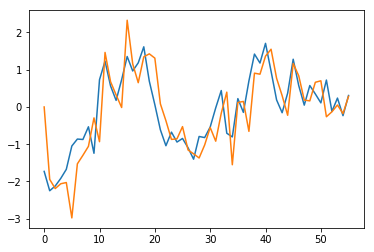

56 F02 Receivables
for these parameters -  (1, 1, 0) c (0, 0, 1, 6)  this -  2.0936052672021104 is MAPE ERROR calculated for last five available forecasting values


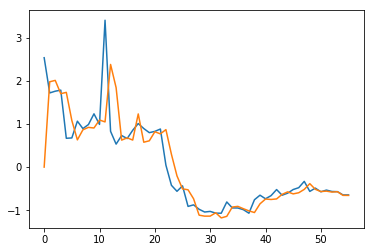

18 F04 Receivables
for these parameters -  (1, 0, 0) c (1, 0, 0, 1)  this -  165.64869366228874 is MAPE ERROR calculated for last five available forecasting values


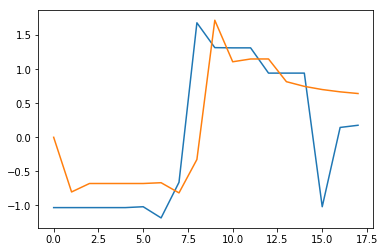

56 G01 Receivables
for these parameters -  (2, 1, 1) t (1, 1, 0, 1)  this -  95.64395552223175 is MAPE ERROR calculated for last five available forecasting values


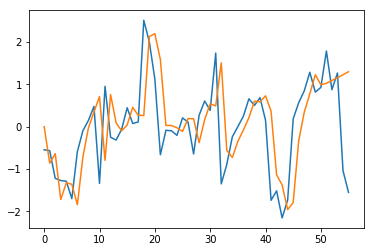

5 G03 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


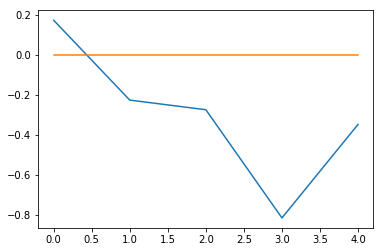

1 G05 Receivables
-1
48 G08 Receivables


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


for these parameters -  (1, 1, 1) ct (2, 0, 0, 4)  this -  30.942022897949013 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


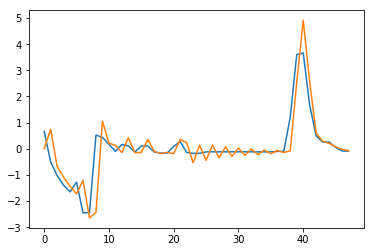

56 G10 Receivables
for these parameters -  (0, 0, 0) n (0, 0, 1, 5)  this -  74.1977803240207 is MAPE ERROR calculated for last five available forecasting values


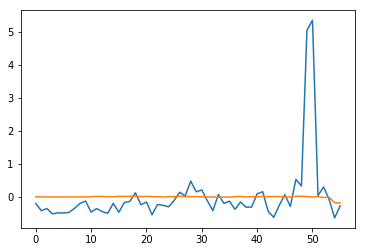

56 G12 Receivables
for these parameters -  (2, 1, 0) ct (1, 1, 0, 7)  this -  51.765466825280804 is MAPE ERROR calculated for last five available forecasting values


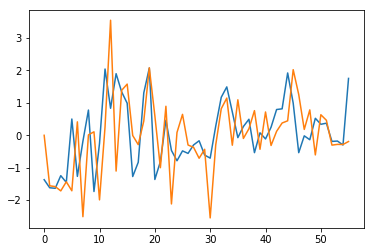

56 A01 Receivables
for these parameters -  (2, 1, 0) t (1, 0, 1, 1)  this -  1169.1179266970087 is MAPE ERROR calculated for last five available forecasting values


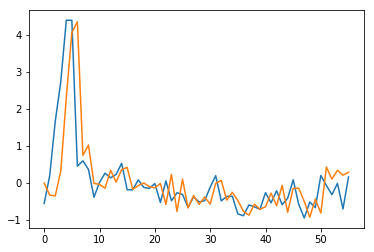

56 A03 Receivables
for these parameters -  (0, 1, 0) t (0, 1, 1, 1)  this -  23.814784994978844 is MAPE ERROR calculated for last five available forecasting values


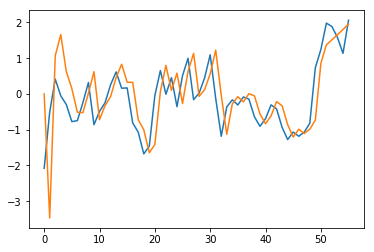

56 B01 Receivables
for these parameters -  (0, 1, 1) ct (1, 1, 1, 9)  this -  29.754372769733706 is MAPE ERROR calculated for last five available forecasting values


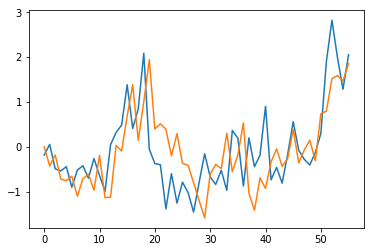

35 B03 Receivables
for these parameters -  (1, 0, 1) c (2, 1, 0, 8)  this -  732.8989929656077 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


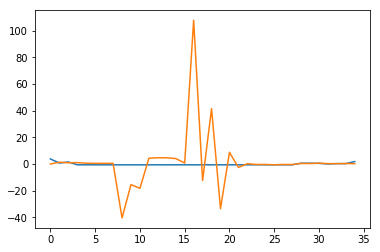

56 B05 Receivables
for these parameters -  (1, 1, 1) ct (0, 0, 1, 3)  this -  9.089264519973776 is MAPE ERROR calculated for last five available forecasting values


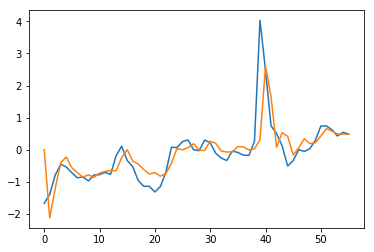

49 B07 Receivables
for these parameters -  (2, 1, 1) ct (2, 1, 0, 2)  this -  51.62333224730303 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


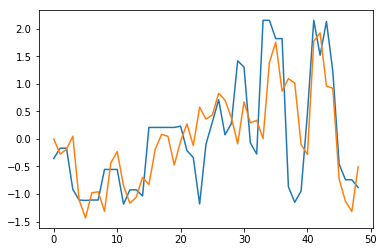

56 B08 Receivables
for these parameters -  (2, 0, 1) t (1, 0, 0, 1)  this -  101.38451577262866 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


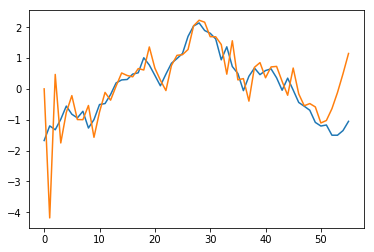

5 B11 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


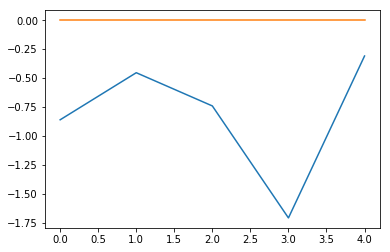

47 B13 Receivables
for these parameters -  (1, 1, 0) ct (2, 1, 0, 7)  this -  85.8345652321837 is MAPE ERROR calculated for last five available forecasting values


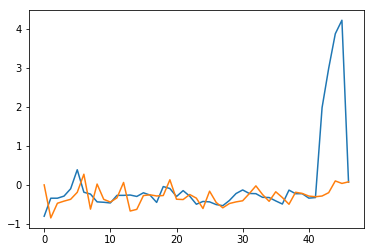

56 B15 Receivables
for these parameters -  (0, 1, 0) c (2, 0, 1, 7)  this -  2.751354525820358 is MAPE ERROR calculated for last five available forecasting values


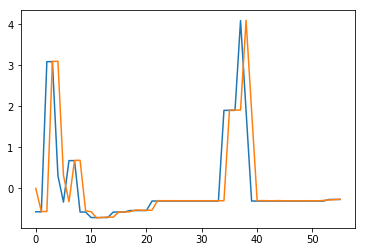

27 B17 Receivables
for these parameters -  (0, 0, 0) n (0, 1, 0, 5)  this -  53.19563398740937 is MAPE ERROR calculated for last five available forecasting values


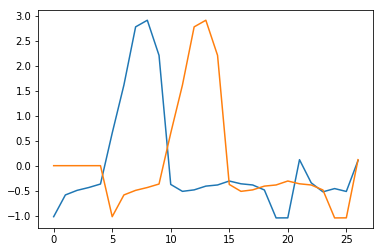

56 B23 Receivables
for these parameters -  (2, 0, 0) ct (2, 1, 1, 1)  this -  257.0547722622633 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


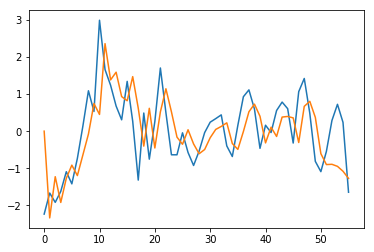

56 B25 Receivables
for these parameters -  (0, 1, 1) n (0, 1, 1, 6)  this -  8.289151453777608 is MAPE ERROR calculated for last five available forecasting values


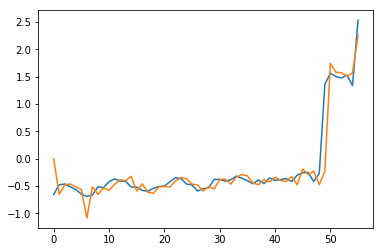

56 B27 Receivables
for these parameters -  (0, 1, 0) c (0, 1, 1, 1)  this -  22.801373764524996 is MAPE ERROR calculated for last five available forecasting values


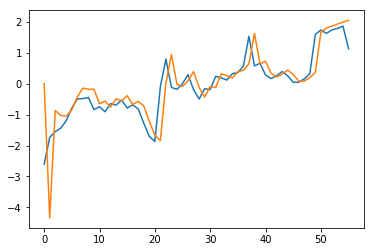

56 C02 Receivables
for these parameters -  (1, 0, 1) c (2, 1, 0, 6)  this -  20.575617121483646 is MAPE ERROR calculated for last five available forecasting values


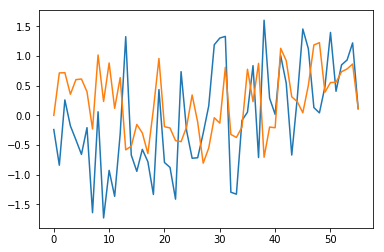

56 C06 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 1, 4)  this -  6.519461344001839 is MAPE ERROR calculated for last five available forecasting values


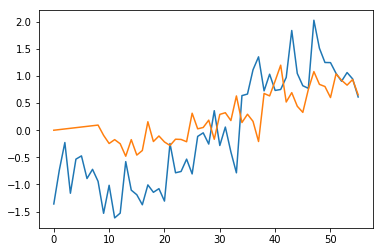

56 D04 Receivables
for these parameters -  (0, 1, 1) ct (2, 1, 1, 1)  this -  132.85685741018136 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


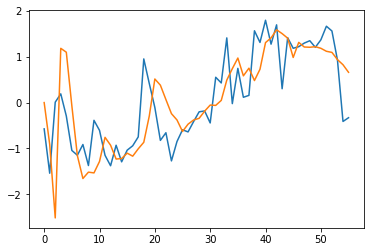

34 E02 Receivables
for these parameters -  (1, 1, 0) ct (0, 1, 0, 2)  this -  24.54128053781958 is MAPE ERROR calculated for last five available forecasting values


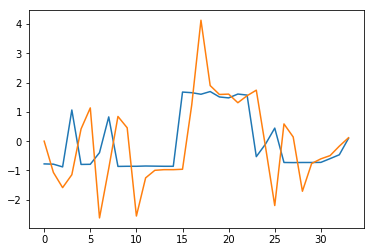

30 E03 Receivables
for these parameters -  (2, 0, 0) n (1, 0, 0, 3)  this -  70.57298400688374 is MAPE ERROR calculated for last five available forecasting values


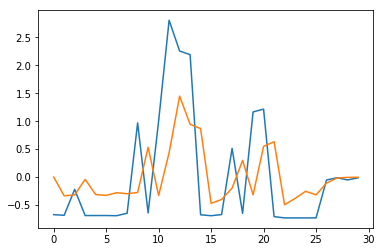

56 E09 Receivables
for these parameters -  (0, 1, 1) t (2, 0, 0, 3)  this -  5.183272019299466 is MAPE ERROR calculated for last five available forecasting values


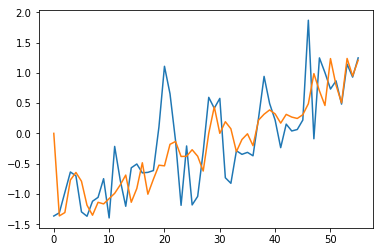

56 E12 Receivables
for these parameters -  (0, 1, 0) ct (2, 1, 0, 6)  this -  5.489010341842328 is MAPE ERROR calculated for last five available forecasting values


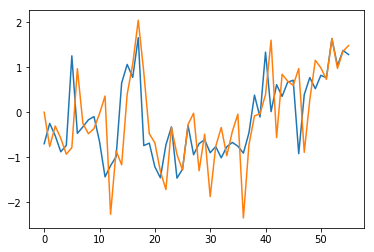

56 E16 Receivables
for these parameters -  (2, 1, 0) ct (0, 1, 1, 5)  this -  50.4297641207747 is MAPE ERROR calculated for last five available forecasting values


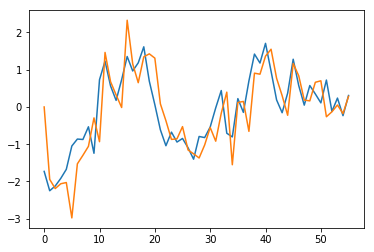

56 F02 Receivables
for these parameters -  (1, 1, 0) c (0, 0, 1, 6)  this -  2.0936052672021104 is MAPE ERROR calculated for last five available forecasting values


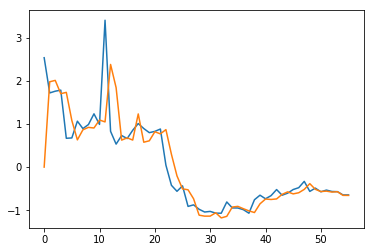

18 F04 Receivables
for these parameters -  (1, 0, 0) c (1, 0, 0, 1)  this -  165.64869366228874 is MAPE ERROR calculated for last five available forecasting values


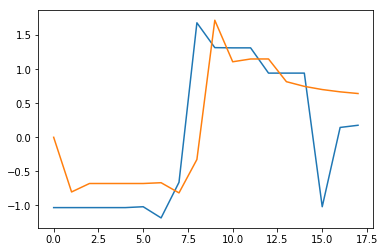

56 G01 Receivables
for these parameters -  (2, 1, 1) t (1, 1, 0, 1)  this -  95.64395552223175 is MAPE ERROR calculated for last five available forecasting values


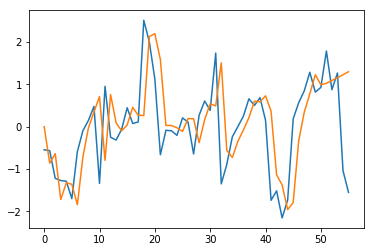

5 G03 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


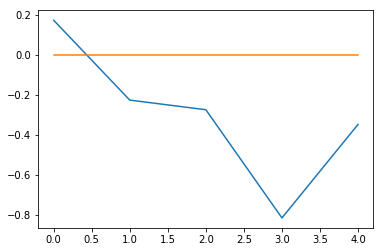

48 G08 Receivables
for these parameters -  (1, 1, 1) ct (2, 0, 0, 4)  this -  30.942022897949013 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


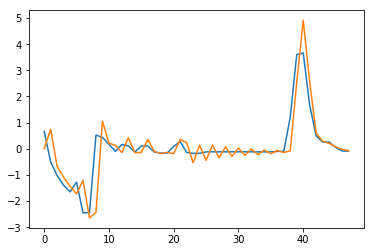

56 G10 Receivables
for these parameters -  (0, 0, 0) n (0, 0, 1, 5)  this -  74.1977803240207 is MAPE ERROR calculated for last five available forecasting values


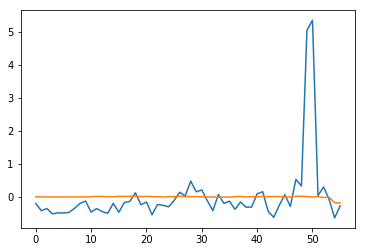

56 G12 Receivables
for these parameters -  (2, 1, 0) ct (1, 1, 0, 7)  this -  51.765466825280804 is MAPE ERROR calculated for last five available forecasting values


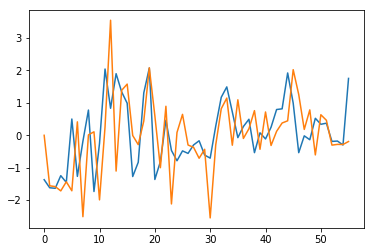

56 A01 Receivables
for these parameters -  (2, 1, 0) t (1, 0, 1, 1)  this -  1169.1179266970087 is MAPE ERROR calculated for last five available forecasting values


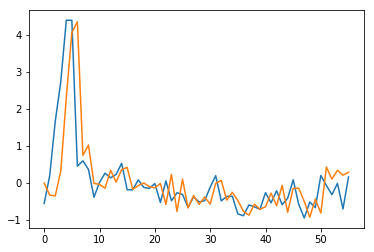

56 A03 Receivables
for these parameters -  (0, 1, 0) t (0, 1, 1, 1)  this -  23.814784994978844 is MAPE ERROR calculated for last five available forecasting values


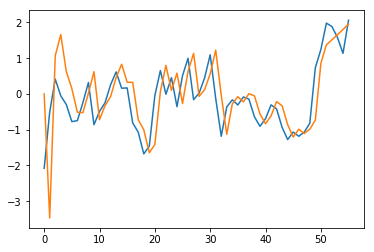

56 B01 Receivables
for these parameters -  (0, 1, 1) ct (1, 1, 1, 9)  this -  29.754372769733706 is MAPE ERROR calculated for last five available forecasting values


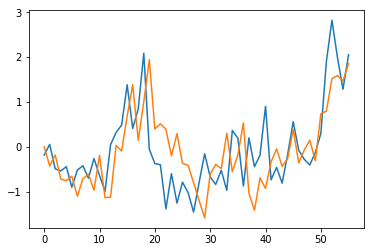

35 B03 Receivables
for these parameters -  (1, 0, 1) c (2, 1, 0, 8)  this -  732.8989929656077 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


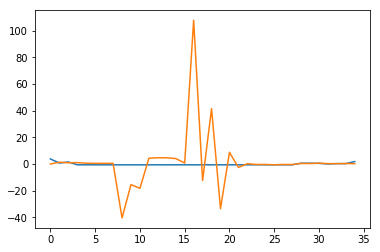

56 B05 Receivables
for these parameters -  (1, 1, 1) ct (0, 0, 1, 3)  this -  9.089264519973776 is MAPE ERROR calculated for last five available forecasting values


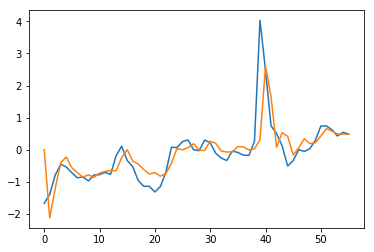

49 B07 Receivables
for these parameters -  (2, 1, 1) ct (2, 1, 0, 2)  this -  51.62333224730303 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


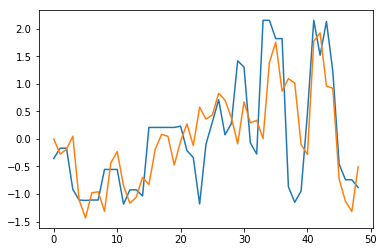

56 B08 Receivables
for these parameters -  (2, 0, 1) t (1, 0, 0, 1)  this -  101.38451577262866 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


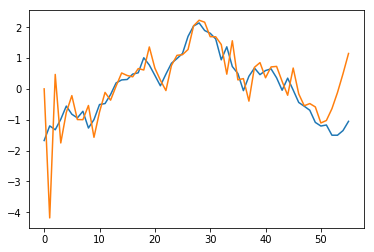

5 B11 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


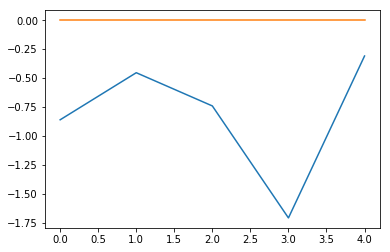

47 B13 Receivables
for these parameters -  (1, 1, 0) ct (2, 1, 0, 7)  this -  85.8345652321837 is MAPE ERROR calculated for last five available forecasting values


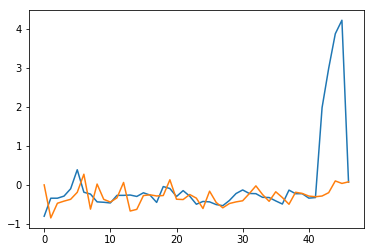

56 B15 Receivables
for these parameters -  (0, 1, 0) c (2, 0, 1, 7)  this -  2.751354525820358 is MAPE ERROR calculated for last five available forecasting values


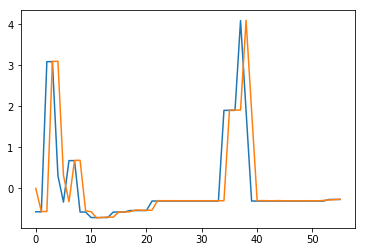

27 B17 Receivables
for these parameters -  (0, 0, 0) n (0, 1, 0, 5)  this -  53.19563398740937 is MAPE ERROR calculated for last five available forecasting values


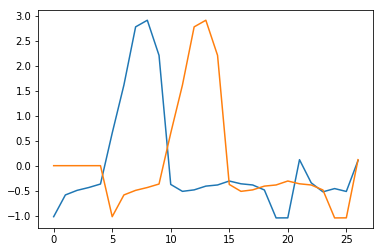

56 B23 Receivables
for these parameters -  (2, 0, 0) ct (2, 1, 1, 1)  this -  257.0547722622633 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


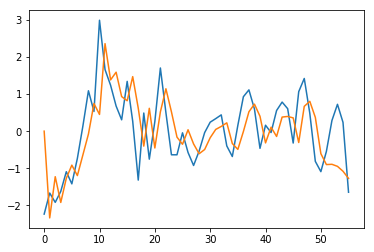

56 B25 Receivables
for these parameters -  (0, 1, 1) n (0, 1, 1, 6)  this -  8.289151453777608 is MAPE ERROR calculated for last five available forecasting values


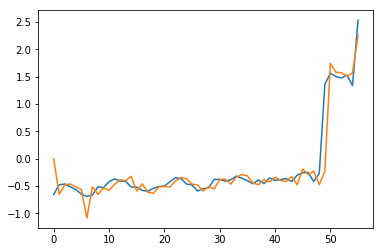

56 B27 Receivables
for these parameters -  (0, 1, 0) c (0, 1, 1, 1)  this -  22.801373764524996 is MAPE ERROR calculated for last five available forecasting values


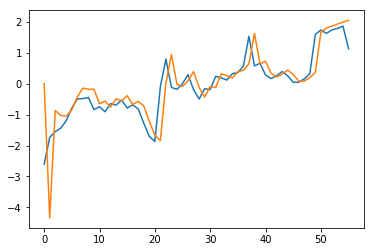

56 C02 Receivables
for these parameters -  (1, 0, 1) c (2, 1, 0, 6)  this -  20.575617121483646 is MAPE ERROR calculated for last five available forecasting values


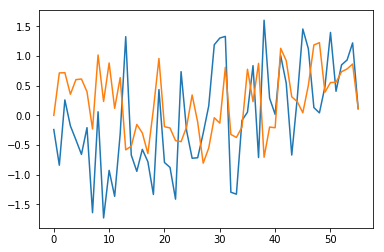

56 C06 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 1, 4)  this -  6.519461344001839 is MAPE ERROR calculated for last five available forecasting values


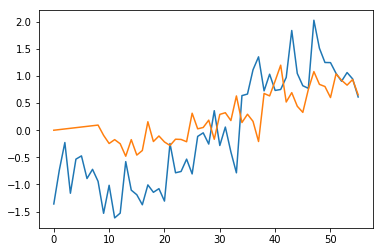

56 D04 Receivables
for these parameters -  (0, 1, 1) ct (2, 1, 1, 1)  this -  132.85685741018136 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


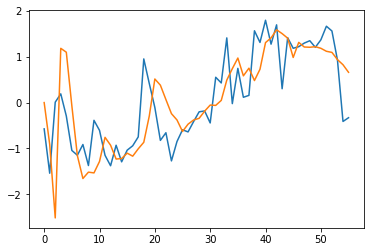

34 E02 Receivables
for these parameters -  (1, 1, 0) ct (0, 1, 0, 2)  this -  24.54128053781958 is MAPE ERROR calculated for last five available forecasting values


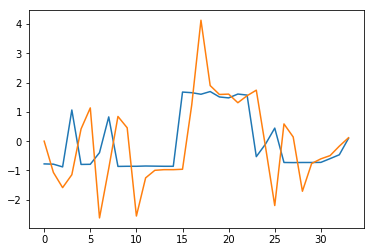

56 E09 Receivables
for these parameters -  (0, 1, 1) t (2, 0, 0, 3)  this -  5.183272019299466 is MAPE ERROR calculated for last five available forecasting values


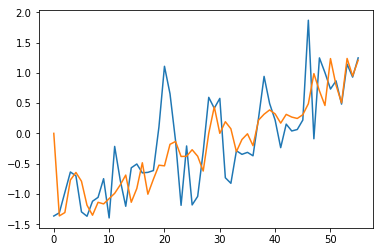

56 E12 Receivables
for these parameters -  (0, 1, 0) ct (2, 1, 0, 6)  this -  5.489010341842328 is MAPE ERROR calculated for last five available forecasting values


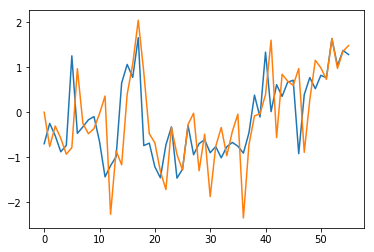

56 E16 Receivables
for these parameters -  (2, 1, 0) ct (0, 1, 1, 5)  this -  50.4297641207747 is MAPE ERROR calculated for last five available forecasting values


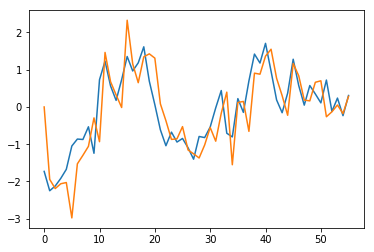

56 F02 Receivables
for these parameters -  (1, 1, 0) c (0, 0, 1, 6)  this -  2.0936052672021104 is MAPE ERROR calculated for last five available forecasting values


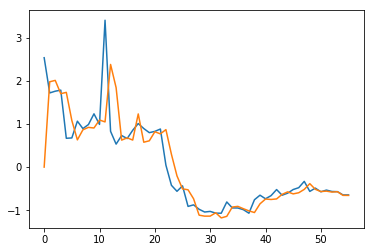

56 G01 Receivables
for these parameters -  (2, 1, 1) t (1, 1, 0, 1)  this -  95.64395552223175 is MAPE ERROR calculated for last five available forecasting values


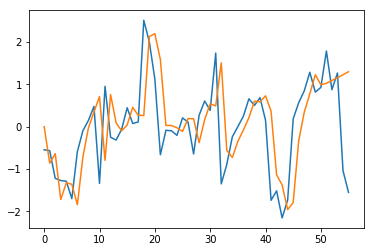

5 G03 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


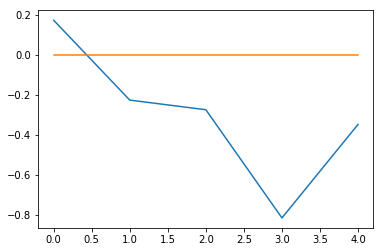

48 G08 Receivables
for these parameters -  (1, 1, 1) ct (2, 0, 0, 4)  this -  30.942022897949013 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


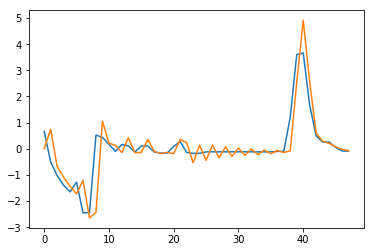

56 G10 Receivables
for these parameters -  (0, 0, 0) n (0, 0, 1, 5)  this -  74.1977803240207 is MAPE ERROR calculated for last five available forecasting values


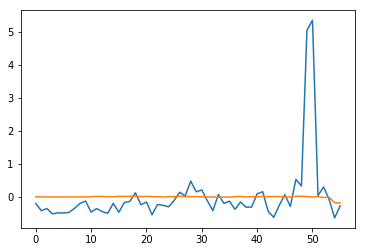

56 G12 Receivables
for these parameters -  (2, 1, 0) ct (1, 1, 0, 7)  this -  51.765466825280804 is MAPE ERROR calculated for last five available forecasting values


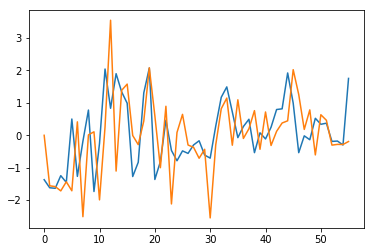

56 A01 Receivables
for these parameters -  (2, 1, 0) t (1, 0, 1, 1)  this -  1169.1179266970087 is MAPE ERROR calculated for last five available forecasting values


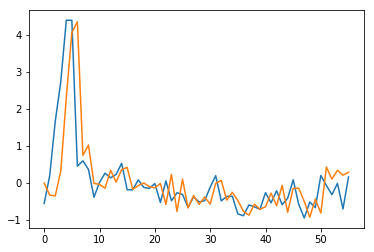

56 A03 Receivables
for these parameters -  (0, 1, 0) t (0, 1, 1, 1)  this -  23.814784994978844 is MAPE ERROR calculated for last five available forecasting values


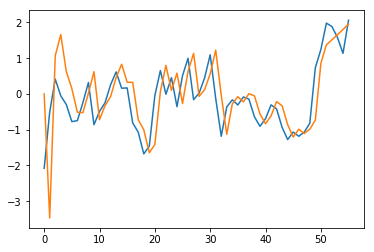

56 B01 Receivables
for these parameters -  (0, 1, 1) ct (1, 1, 1, 9)  this -  29.754372769733706 is MAPE ERROR calculated for last five available forecasting values


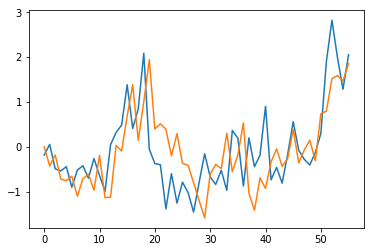

35 B03 Receivables
for these parameters -  (1, 0, 1) c (2, 1, 0, 8)  this -  732.8989929656077 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


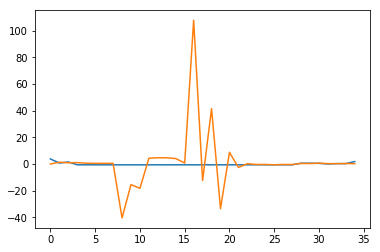

56 B05 Receivables
for these parameters -  (1, 1, 1) ct (0, 0, 1, 3)  this -  9.089264519973776 is MAPE ERROR calculated for last five available forecasting values


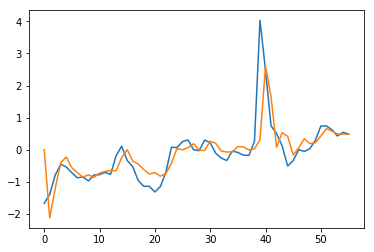

49 B07 Receivables
for these parameters -  (2, 1, 1) ct (2, 1, 0, 2)  this -  51.62333224730303 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


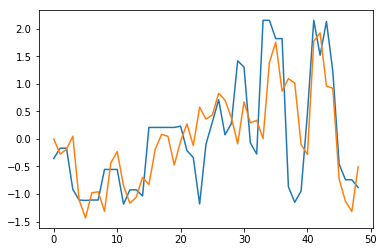

56 B08 Receivables
for these parameters -  (2, 0, 1) t (1, 0, 0, 1)  this -  101.38451577262866 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


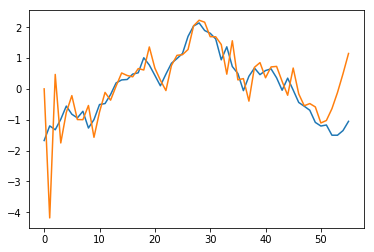

5 B11 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


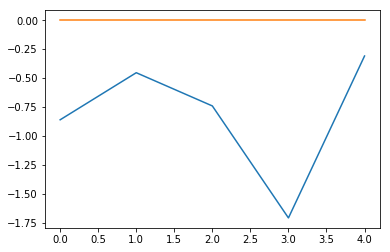

47 B13 Receivables
for these parameters -  (1, 1, 0) ct (2, 1, 0, 7)  this -  85.8345652321837 is MAPE ERROR calculated for last five available forecasting values


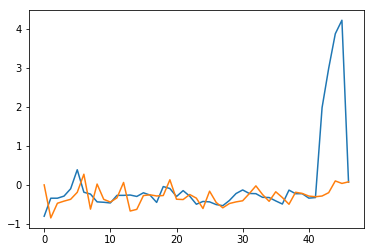

56 B15 Receivables
for these parameters -  (0, 1, 0) c (2, 0, 1, 7)  this -  2.751354525820358 is MAPE ERROR calculated for last five available forecasting values


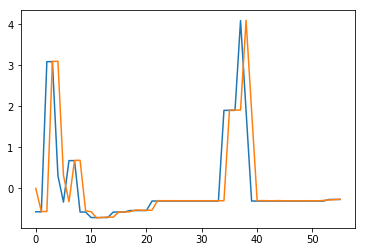

27 B17 Receivables
for these parameters -  (0, 0, 0) n (0, 1, 0, 5)  this -  53.19563398740937 is MAPE ERROR calculated for last five available forecasting values


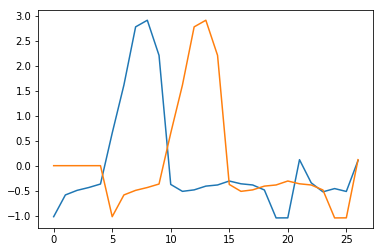

1 B19 Receivables
-1
56 B23 Receivables


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


for these parameters -  (2, 0, 0) ct (2, 1, 1, 1)  this -  257.0547722622633 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


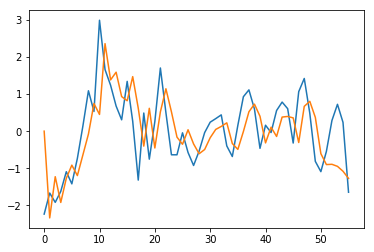

56 B25 Receivables
for these parameters -  (0, 1, 1) n (0, 1, 1, 6)  this -  8.289151453777608 is MAPE ERROR calculated for last five available forecasting values


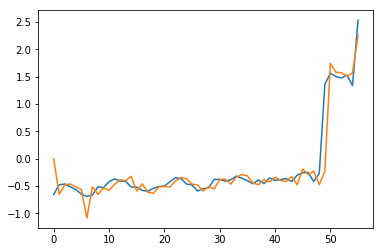

56 B27 Receivables
for these parameters -  (0, 1, 0) c (0, 1, 1, 1)  this -  22.801373764524996 is MAPE ERROR calculated for last five available forecasting values


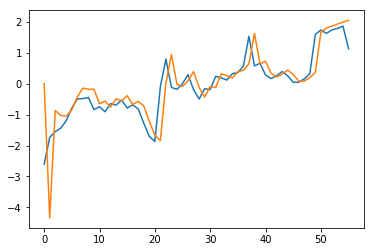

56 C02 Receivables
for these parameters -  (1, 0, 1) c (2, 1, 0, 6)  this -  20.575617121483646 is MAPE ERROR calculated for last five available forecasting values


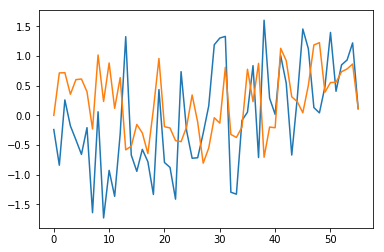

56 C06 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 1, 4)  this -  6.519461344001839 is MAPE ERROR calculated for last five available forecasting values


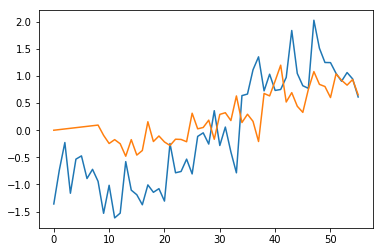

35 C09 Receivables
for these parameters -  (1, 1, 0) c (0, 0, 1, 8)  this -  1.7330549192665787 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


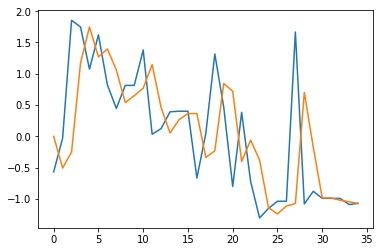

56 D04 Receivables
for these parameters -  (0, 1, 1) ct (2, 1, 1, 1)  this -  132.85685741018136 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


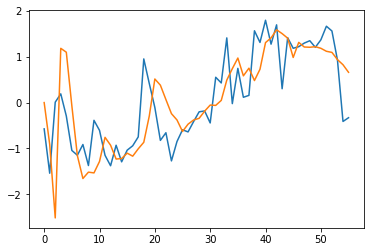

34 E02 Receivables
for these parameters -  (1, 1, 0) ct (0, 1, 0, 2)  this -  24.54128053781958 is MAPE ERROR calculated for last five available forecasting values


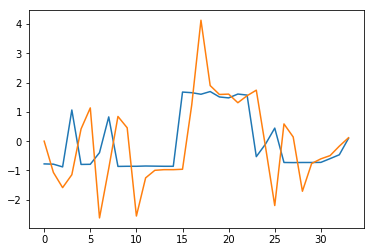

56 E09 Receivables
for these parameters -  (0, 1, 1) t (2, 0, 0, 3)  this -  5.183272019299466 is MAPE ERROR calculated for last five available forecasting values


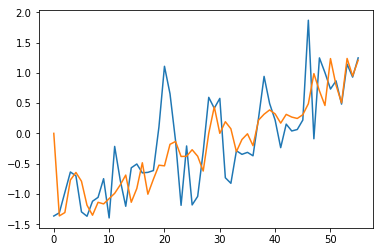

56 E12 Receivables
for these parameters -  (0, 1, 0) ct (2, 1, 0, 6)  this -  5.489010341842328 is MAPE ERROR calculated for last five available forecasting values


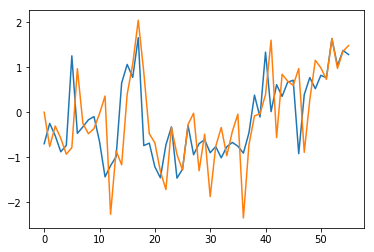

56 E16 Receivables
for these parameters -  (2, 1, 0) ct (0, 1, 1, 5)  this -  50.4297641207747 is MAPE ERROR calculated for last five available forecasting values


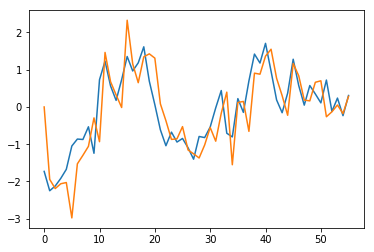

56 F02 Receivables
for these parameters -  (1, 1, 0) c (0, 0, 1, 6)  this -  2.0936052672021104 is MAPE ERROR calculated for last five available forecasting values


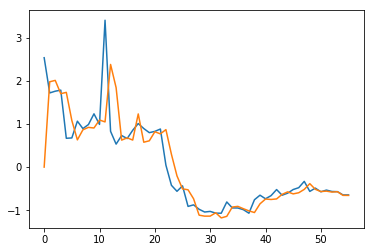

56 G01 Receivables
for these parameters -  (2, 1, 1) t (1, 1, 0, 1)  this -  95.64395552223175 is MAPE ERROR calculated for last five available forecasting values


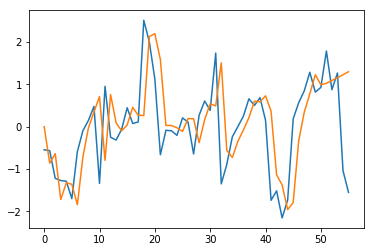

5 G03 Receivables
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


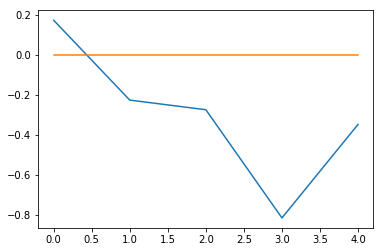

48 G08 Receivables
for these parameters -  (1, 1, 1) ct (2, 0, 0, 4)  this -  30.942022897949013 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


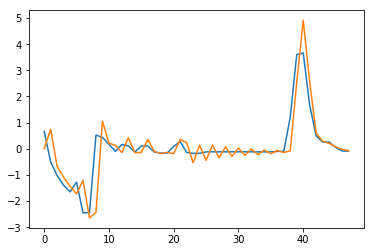

56 G10 Receivables
for these parameters -  (0, 0, 0) n (0, 0, 1, 5)  this -  74.1977803240207 is MAPE ERROR calculated for last five available forecasting values


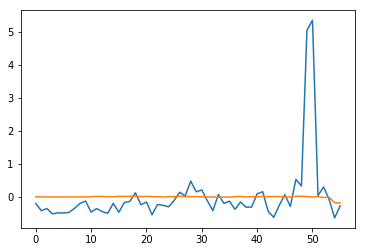

56 G12 Receivables
for these parameters -  (2, 1, 0) ct (1, 1, 0, 7)  this -  51.765466825280804 is MAPE ERROR calculated for last five available forecasting values


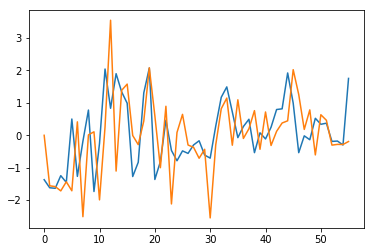

56 A01 Returns and Rebates
for these parameters -  (1, 0, 1) t (2, 0, 1, 1)  this -  167.65116320475684 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


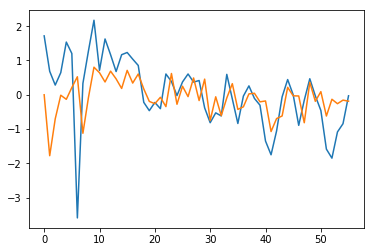

56 A03 Returns and Rebates
for these parameters -  (2, 1, 1) ct (0, 1, 1, 9)  this -  21.135137633464225 is MAPE ERROR calculated for last five available forecasting values


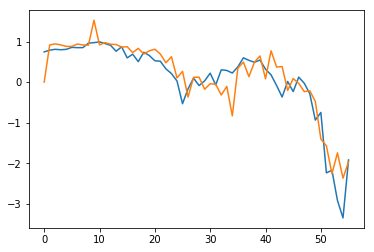

44 B01 Returns and Rebates
for these parameters -  (2, 1, 0) c (2, 0, 0, 8)  this -  2.468876663335363 is MAPE ERROR calculated for last five available forecasting values


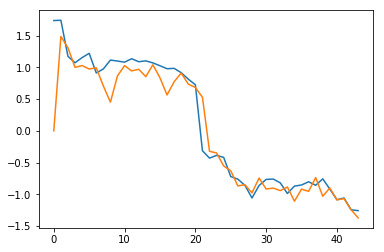

56 B03 Returns and Rebates
for these parameters -  (0, 0, 0) c (1, 1, 1, 4)  this -  1.2674471950675272 is MAPE ERROR calculated for last five available forecasting values


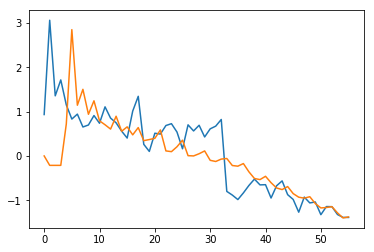

56 B05 Returns and Rebates
for these parameters -  (0, 1, 1) n (0, 1, 0, 9)  this -  3.4046372007219534 is MAPE ERROR calculated for last five available forecasting values


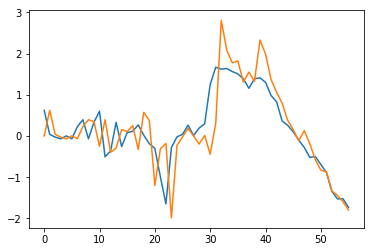

49 B07 Returns and Rebates
for these parameters -  (2, 1, 1) ct (1, 0, 1, 5)  this -  47.62544093396889 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


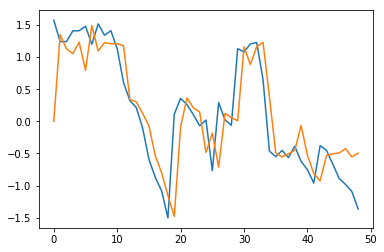

56 B08 Returns and Rebates
for these parameters -  (0, 0, 1) c (2, 1, 0, 5)  this -  3.1321760758454014 is MAPE ERROR calculated for last five available forecasting values


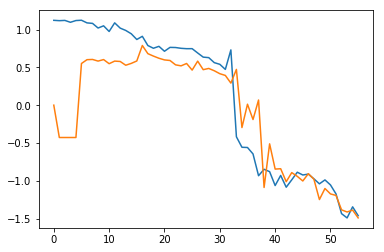

5 B11 Returns and Rebates
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


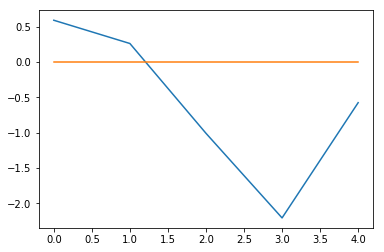

56 B17 Returns and Rebates
for these parameters -  (0, 0, 0) ct (0, 0, 1, 4)  this -  8.340598132210625 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


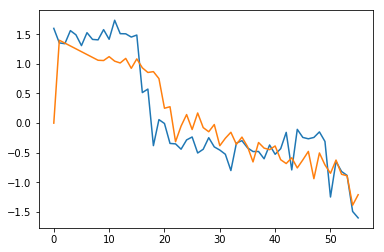

53 B23 Returns and Rebates
for these parameters -  (1, 1, 0) ct (2, 0, 1, 4)  this -  3.7832150831465814 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


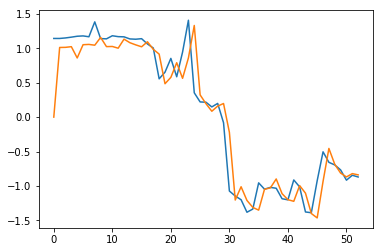

56 B25 Returns and Rebates
for these parameters -  (1, 0, 0) t (2, 1, 0, 3)  this -  1.5294026310727558 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


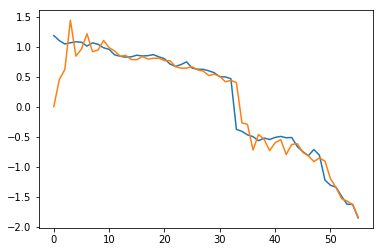

56 B27 Returns and Rebates
for these parameters -  (2, 0, 1) n (2, 1, 0, 5)  this -  3.2605218565550755 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


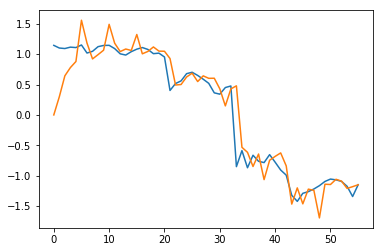

56 C02 Returns and Rebates
for these parameters -  (0, 0, 0) ct (0, 1, 0, 1)  this -  58.50588709601523 is MAPE ERROR calculated for last five available forecasting values


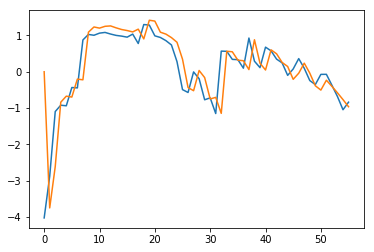

56 C06 Returns and Rebates
for these parameters -  (1, 1, 0) ct (0, 1, 0, 9)  this -  83.03947249133712 is MAPE ERROR calculated for last five available forecasting values


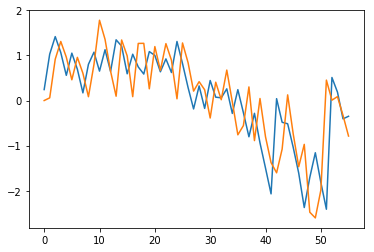

56 D04 Returns and Rebates
for these parameters -  (2, 0, 1) c (2, 1, 1, 8)  this -  25.187410341493553 is MAPE ERROR calculated for last five available forecasting values


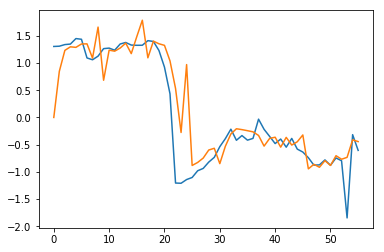

8 E09 Returns and Rebates
for these parameters -  (0, 0, 0) n (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


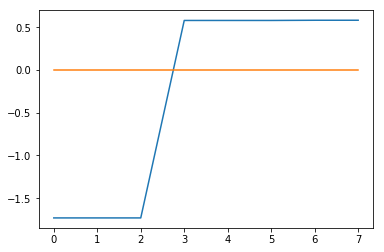

56 G01 Returns and Rebates
for these parameters -  (2, 0, 1) n (2, 1, 0, 1)  this -  18.190160797579217 is MAPE ERROR calculated for last five available forecasting values


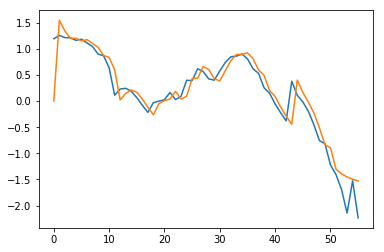

5 G03 Returns and Rebates
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


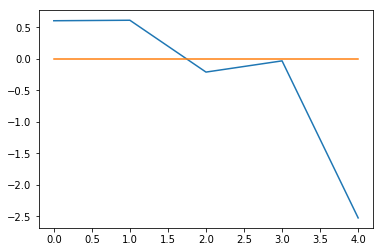

56 G08 Returns and Rebates
for these parameters -  (1, 0, 1) ct (1, 1, 1, 8)  this -  4.895904057635833 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


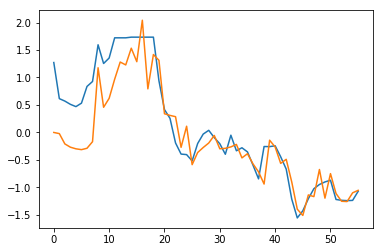

56 G10 Returns and Rebates
for these parameters -  (0, 0, 0) c (2, 0, 0, 1)  this -  4043.9087739963197 is MAPE ERROR calculated for last five available forecasting values


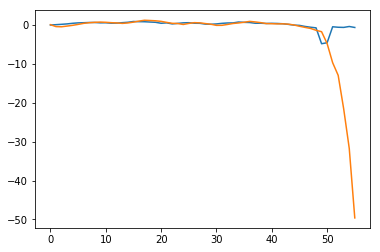

36 G12 Returns and Rebates
for these parameters -  (0, 1, 0) n (0, 1, 0, 6)  this -  4.696760631857111 is MAPE ERROR calculated for last five available forecasting values


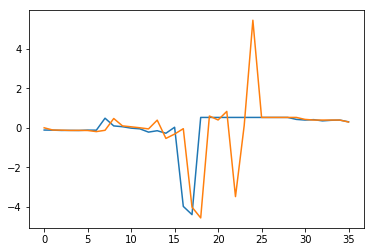

56 A01 Returns and Rebates
for these parameters -  (1, 0, 1) t (2, 0, 1, 1)  this -  167.65116320475684 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


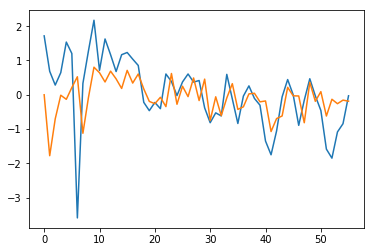

56 A03 Returns and Rebates
for these parameters -  (2, 1, 1) ct (0, 1, 1, 9)  this -  21.135137633464225 is MAPE ERROR calculated for last five available forecasting values


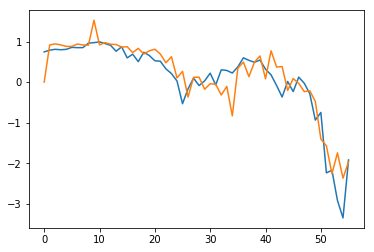

44 B01 Returns and Rebates
for these parameters -  (2, 1, 0) c (2, 0, 0, 8)  this -  2.468876663335363 is MAPE ERROR calculated for last five available forecasting values


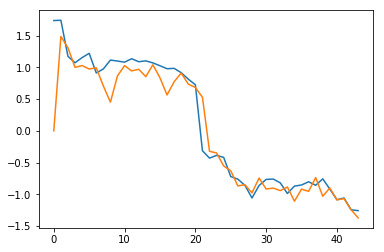

56 B03 Returns and Rebates
for these parameters -  (0, 0, 0) c (1, 1, 1, 4)  this -  1.2674471950675272 is MAPE ERROR calculated for last five available forecasting values


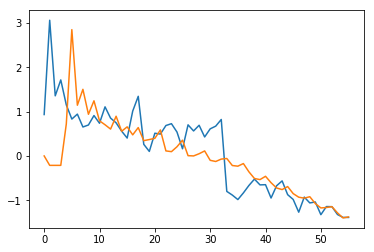

56 B05 Returns and Rebates
for these parameters -  (0, 1, 1) n (0, 1, 0, 9)  this -  3.4046372007219534 is MAPE ERROR calculated for last five available forecasting values


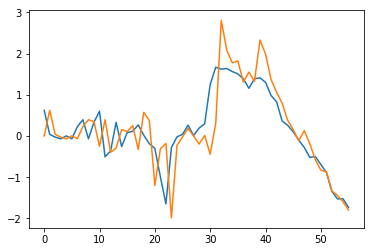

49 B07 Returns and Rebates
for these parameters -  (2, 1, 1) ct (1, 0, 1, 5)  this -  47.62544093396889 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


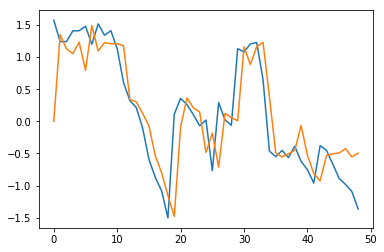

56 B08 Returns and Rebates
for these parameters -  (0, 0, 1) c (2, 1, 0, 5)  this -  3.1321760758454014 is MAPE ERROR calculated for last five available forecasting values


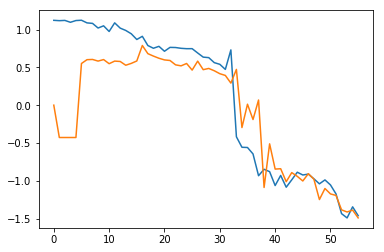

5 B11 Returns and Rebates
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


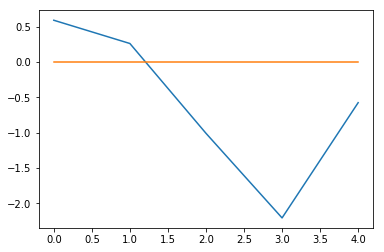

56 B17 Returns and Rebates
for these parameters -  (0, 0, 0) ct (0, 0, 1, 4)  this -  8.340598132210625 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


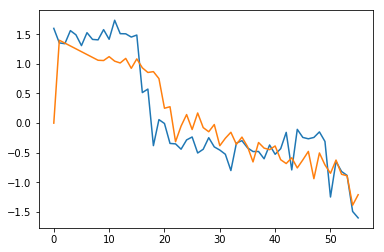

53 B23 Returns and Rebates
for these parameters -  (1, 1, 0) ct (2, 0, 1, 4)  this -  3.7832150831465814 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


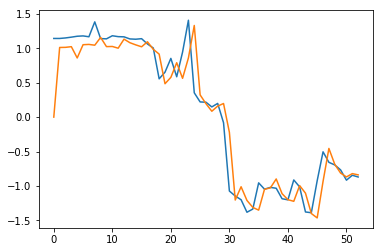

56 B25 Returns and Rebates
for these parameters -  (1, 0, 0) t (2, 1, 0, 3)  this -  1.5294026310727558 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


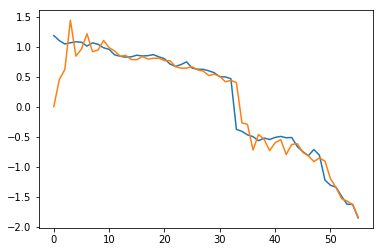

56 B27 Returns and Rebates
for these parameters -  (2, 0, 1) n (2, 1, 0, 5)  this -  3.2605218565550755 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


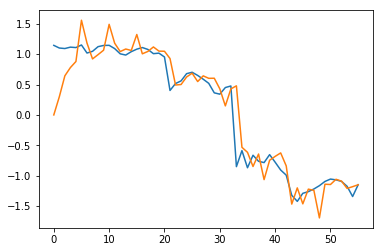

56 C02 Returns and Rebates
for these parameters -  (0, 0, 0) ct (0, 1, 0, 1)  this -  58.50588709601523 is MAPE ERROR calculated for last five available forecasting values


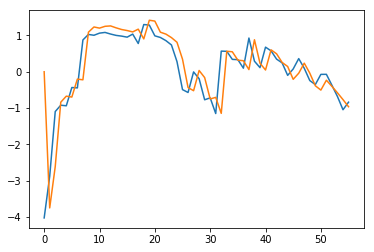

56 C06 Returns and Rebates
for these parameters -  (1, 1, 0) ct (0, 1, 0, 9)  this -  83.03947249133712 is MAPE ERROR calculated for last five available forecasting values


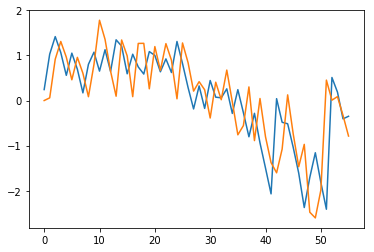

56 D04 Returns and Rebates
for these parameters -  (2, 0, 1) c (2, 1, 1, 8)  this -  25.187410341493553 is MAPE ERROR calculated for last five available forecasting values


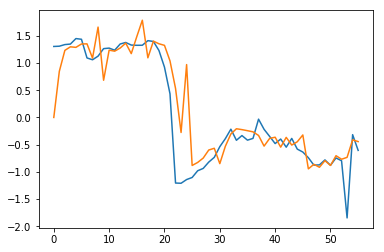

8 E09 Returns and Rebates
for these parameters -  (0, 0, 0) n (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


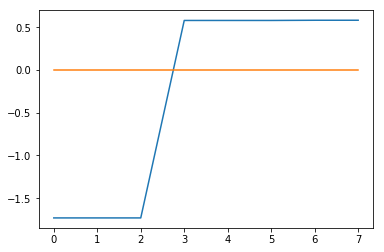

56 G01 Returns and Rebates
for these parameters -  (2, 0, 1) n (2, 1, 0, 1)  this -  18.190160797579217 is MAPE ERROR calculated for last five available forecasting values


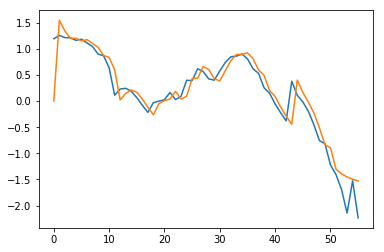

5 G03 Returns and Rebates
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


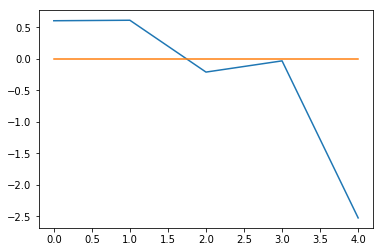

56 G08 Returns and Rebates
for these parameters -  (1, 0, 1) ct (1, 1, 1, 8)  this -  4.895904057635833 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


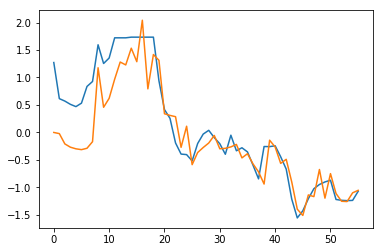

56 G10 Returns and Rebates
for these parameters -  (0, 0, 0) c (2, 0, 0, 1)  this -  4043.9087739963197 is MAPE ERROR calculated for last five available forecasting values


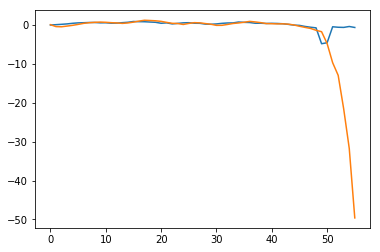

36 G12 Returns and Rebates
for these parameters -  (0, 1, 0) n (0, 1, 0, 6)  this -  4.696760631857111 is MAPE ERROR calculated for last five available forecasting values


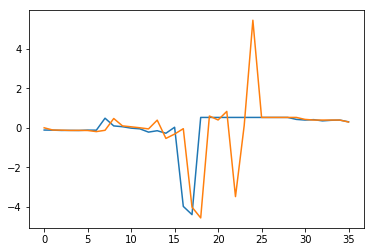

56 A01 Returns and Rebates
for these parameters -  (1, 0, 1) t (2, 0, 1, 1)  this -  167.65116320475684 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


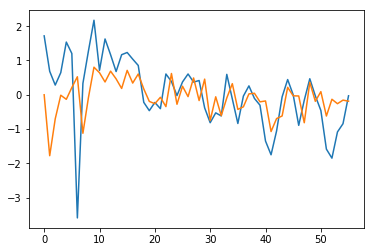

56 A03 Returns and Rebates
for these parameters -  (2, 1, 1) ct (0, 1, 1, 9)  this -  21.135137633464225 is MAPE ERROR calculated for last five available forecasting values


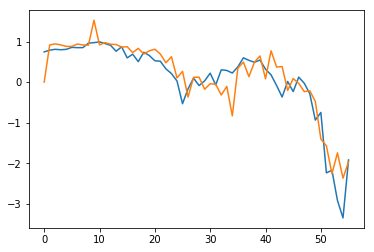

44 B01 Returns and Rebates
for these parameters -  (2, 1, 0) c (2, 0, 0, 8)  this -  2.468876663335363 is MAPE ERROR calculated for last five available forecasting values


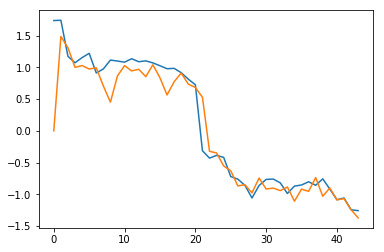

56 B03 Returns and Rebates
for these parameters -  (0, 0, 0) c (1, 1, 1, 4)  this -  1.2674471950675272 is MAPE ERROR calculated for last five available forecasting values


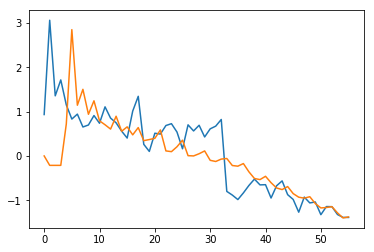

56 B05 Returns and Rebates
for these parameters -  (0, 1, 1) n (0, 1, 0, 9)  this -  3.4046372007219534 is MAPE ERROR calculated for last five available forecasting values


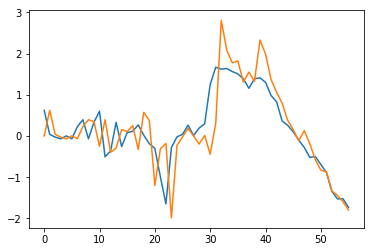

49 B07 Returns and Rebates
for these parameters -  (2, 1, 1) ct (1, 0, 1, 5)  this -  47.62544093396889 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


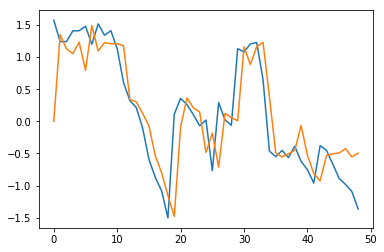

56 B08 Returns and Rebates
for these parameters -  (0, 0, 1) c (2, 1, 0, 5)  this -  3.1321760758454014 is MAPE ERROR calculated for last five available forecasting values


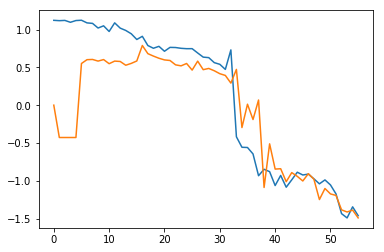

5 B11 Returns and Rebates
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


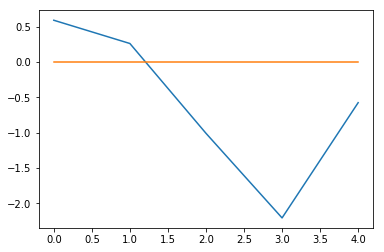

56 B17 Returns and Rebates
for these parameters -  (0, 0, 0) ct (0, 0, 1, 4)  this -  8.340598132210625 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


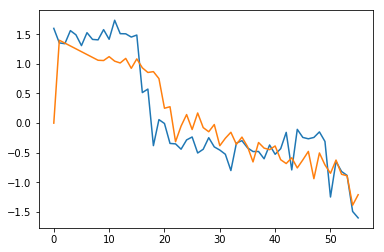

53 B23 Returns and Rebates
for these parameters -  (1, 1, 0) ct (2, 0, 1, 4)  this -  3.7832150831465814 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


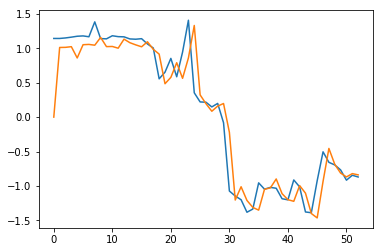

56 B25 Returns and Rebates
for these parameters -  (1, 0, 0) t (2, 1, 0, 3)  this -  1.5294026310727558 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


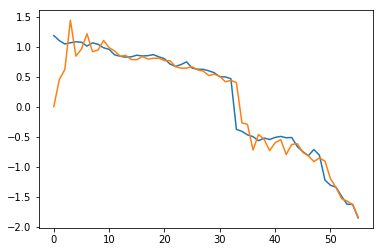

56 B27 Returns and Rebates
for these parameters -  (2, 0, 1) n (2, 1, 0, 5)  this -  3.2605218565550755 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


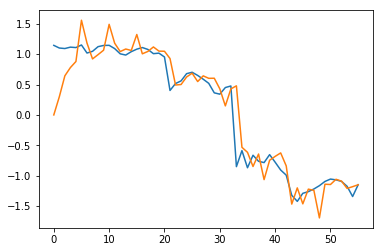

56 C02 Returns and Rebates
for these parameters -  (0, 0, 0) ct (0, 1, 0, 1)  this -  58.50588709601523 is MAPE ERROR calculated for last five available forecasting values


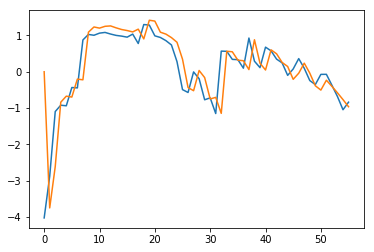

56 C06 Returns and Rebates
for these parameters -  (1, 1, 0) ct (0, 1, 0, 9)  this -  83.03947249133712 is MAPE ERROR calculated for last five available forecasting values


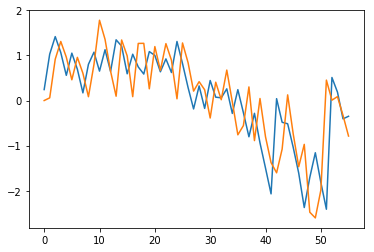

56 D04 Returns and Rebates
for these parameters -  (2, 0, 1) c (2, 1, 1, 8)  this -  25.187410341493553 is MAPE ERROR calculated for last five available forecasting values


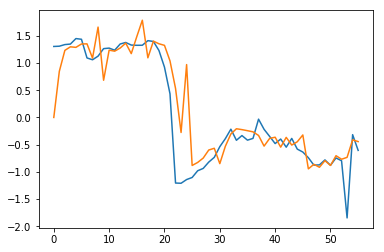

8 E09 Returns and Rebates
for these parameters -  (0, 0, 0) n (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


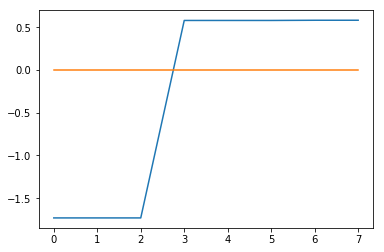

56 G01 Returns and Rebates
for these parameters -  (2, 0, 1) n (2, 1, 0, 1)  this -  18.190160797579217 is MAPE ERROR calculated for last five available forecasting values


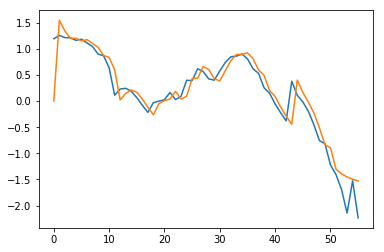

5 G03 Returns and Rebates
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


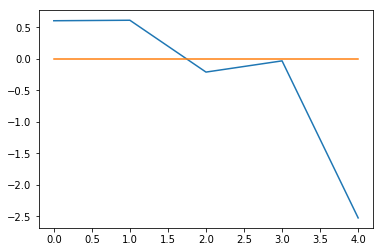

56 G08 Returns and Rebates
for these parameters -  (1, 0, 1) ct (1, 1, 1, 8)  this -  4.895904057635833 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


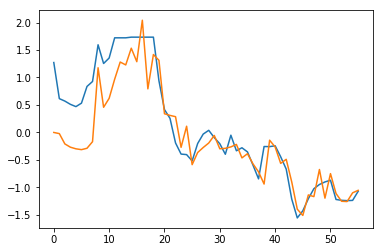

56 G10 Returns and Rebates
for these parameters -  (0, 0, 0) c (2, 0, 0, 1)  this -  4043.9087739963197 is MAPE ERROR calculated for last five available forecasting values


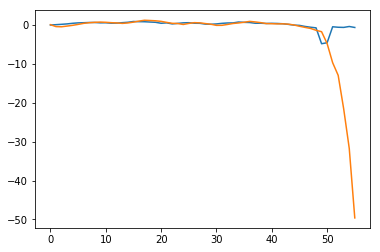

36 G12 Returns and Rebates
for these parameters -  (0, 1, 0) n (0, 1, 0, 6)  this -  4.696760631857111 is MAPE ERROR calculated for last five available forecasting values


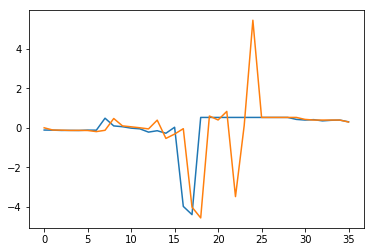

56 A01 Returns and Rebates
for these parameters -  (1, 0, 1) t (2, 0, 1, 1)  this -  167.65116320475684 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


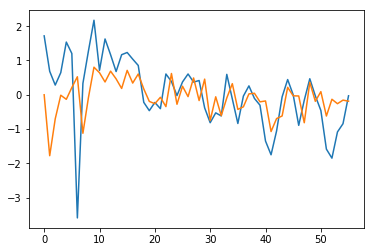

56 A03 Returns and Rebates
for these parameters -  (2, 1, 1) ct (0, 1, 1, 9)  this -  21.135137633464225 is MAPE ERROR calculated for last five available forecasting values


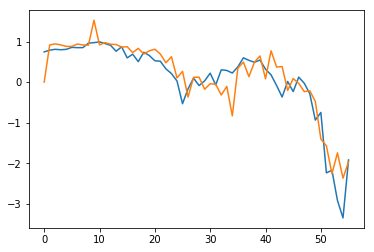

44 B01 Returns and Rebates
for these parameters -  (2, 1, 0) c (2, 0, 0, 8)  this -  2.468876663335363 is MAPE ERROR calculated for last five available forecasting values


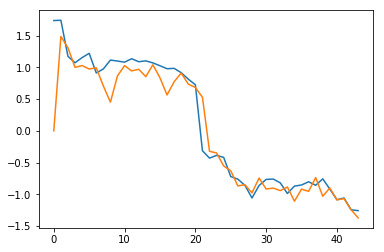

56 B03 Returns and Rebates
for these parameters -  (0, 0, 0) c (1, 1, 1, 4)  this -  1.2674471950675272 is MAPE ERROR calculated for last five available forecasting values


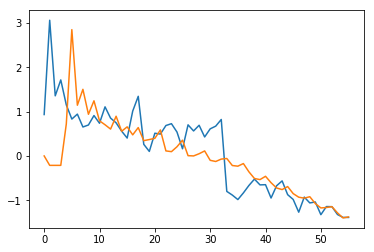

56 B05 Returns and Rebates
for these parameters -  (0, 1, 1) n (0, 1, 0, 9)  this -  3.4046372007219534 is MAPE ERROR calculated for last five available forecasting values


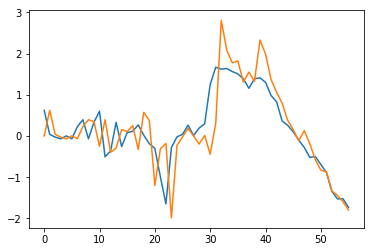

49 B07 Returns and Rebates
for these parameters -  (2, 1, 1) ct (1, 0, 1, 5)  this -  47.62544093396889 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


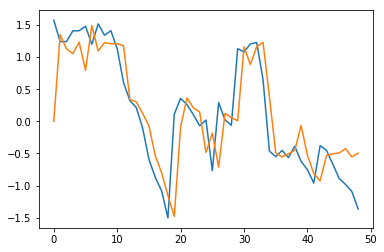

56 B08 Returns and Rebates
for these parameters -  (0, 0, 1) c (2, 1, 0, 5)  this -  3.1321760758454014 is MAPE ERROR calculated for last five available forecasting values


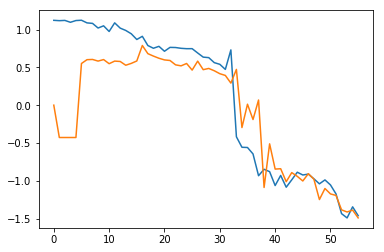

5 B11 Returns and Rebates
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


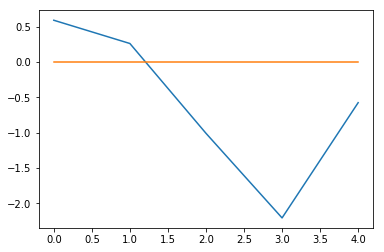

56 B17 Returns and Rebates
for these parameters -  (0, 0, 0) ct (0, 0, 1, 4)  this -  8.340598132210625 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


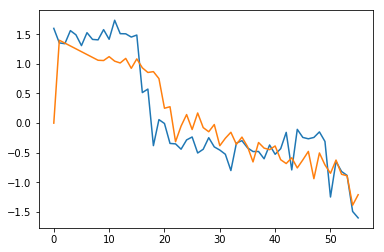

53 B23 Returns and Rebates
for these parameters -  (1, 1, 0) ct (2, 0, 1, 4)  this -  3.7832150831465814 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


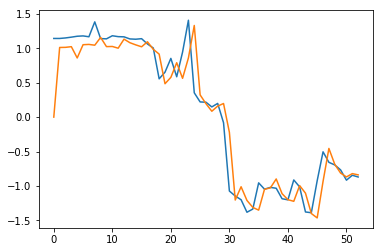

56 B25 Returns and Rebates
for these parameters -  (1, 0, 0) t (2, 1, 0, 3)  this -  1.5294026310727558 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


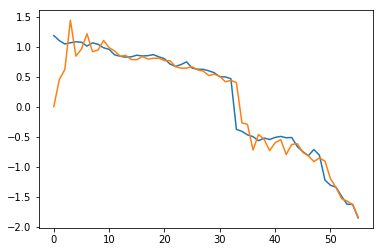

56 B27 Returns and Rebates
for these parameters -  (2, 0, 1) n (2, 1, 0, 5)  this -  3.2605218565550755 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


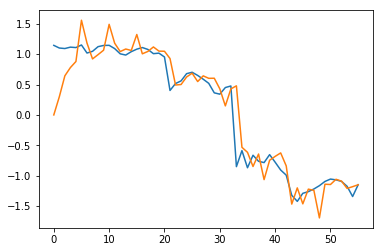

56 C02 Returns and Rebates
for these parameters -  (0, 0, 0) ct (0, 1, 0, 1)  this -  58.50588709601523 is MAPE ERROR calculated for last five available forecasting values


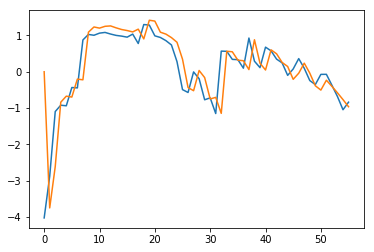

56 C06 Returns and Rebates
for these parameters -  (1, 1, 0) ct (0, 1, 0, 9)  this -  83.03947249133712 is MAPE ERROR calculated for last five available forecasting values


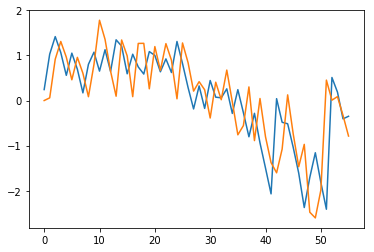

56 D04 Returns and Rebates
for these parameters -  (2, 0, 1) c (2, 1, 1, 8)  this -  25.187410341493553 is MAPE ERROR calculated for last five available forecasting values


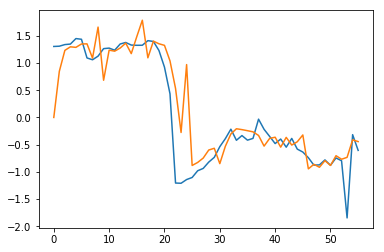

8 E09 Returns and Rebates
for these parameters -  (0, 0, 0) n (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


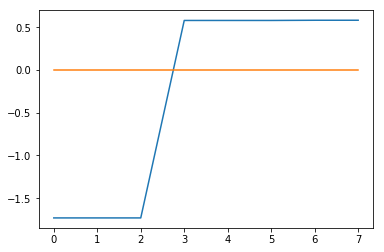

56 G01 Returns and Rebates
for these parameters -  (2, 0, 1) n (2, 1, 0, 1)  this -  18.190160797579217 is MAPE ERROR calculated for last five available forecasting values


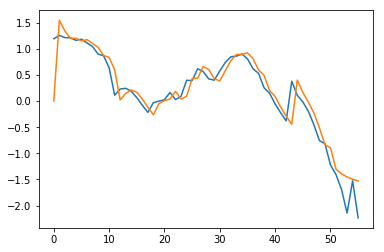

5 G03 Returns and Rebates
for these parameters -  (0, 0, 0) t (0, 0, 0, 0)  this -  100.0 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


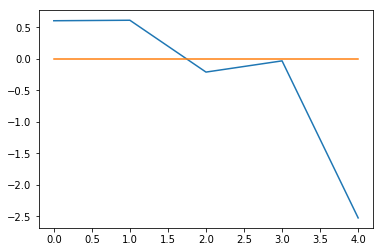

56 G08 Returns and Rebates
for these parameters -  (1, 0, 1) ct (1, 1, 1, 8)  this -  4.895904057635833 is MAPE ERROR calculated for last five available forecasting values


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


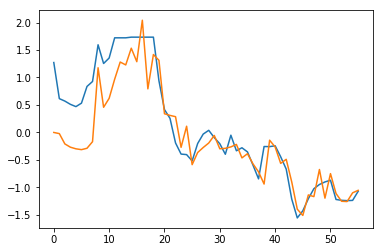

56 G10 Returns and Rebates
for these parameters -  (0, 0, 0) c (2, 0, 0, 1)  this -  4043.9087739963197 is MAPE ERROR calculated for last five available forecasting values


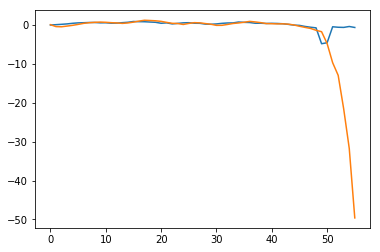

36 G12 Returns and Rebates
for these parameters -  (0, 1, 0) n (0, 1, 0, 6)  this -  4.696760631857111 is MAPE ERROR calculated for last five available forecasting values


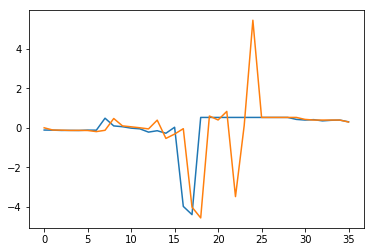

In [7]:
#This is used for training and validating the accuracy of the model and selecting the parameters
#Below I have also calculated the MAPE error of all the different parameters and Printed their values.

market_map = df_test[a[6]].unique()
save_res = []
mar=[]
final_values=[]
j_val = []
account_map = ['Inventory', 'Payables and Accruals', 'Receivables', 'Returns and Rebates']

for i in range (0,len(df_test)):
    
    for j in range (0,len(combine_parameter)):
        
        if(df_test['Account-Mapping'][i] == combine_parameter['account_map_m'][j] and df_test['Market-Mapping'][i] == combine_parameter['market_map_m'][j]):
        
        #    if(combine_parameter.iloc[wq,3] ==  market   and  combine_parameter.iloc[wq,4] == account):
        
                param = combine_parameter.iloc[j,0]
                param_seasonal = combine_parameter.iloc[j,1]
                trend = combine_parameter.iloc[j,2]
                                    #break
                    
                filename = 'training_data.csv'
                transpos=[]
                account = df_test['Account-Mapping'][i]
                market = df_test['Market-Mapping'][i]
                
                with open(filename) as csvfile:
                    
                    reader = csv.DictReader(csvfile)
        
                    ret = {}
                    data = []
    
                    for row in reader:
            
                        if 'Version' in row and row['Version'] != 'ACT':
                            continue
                    
                        if 'Account-Mapping' in row and row['Account-Mapping'] != account:
                            continue
                
                        if 'Acc2-Mapping' in row and row['Acc2-Mapping'] != 'Working Capital':
                            continue
                
                        if 'Market-Mapping' in row and row['Market-Mapping'] != market:
                            continue
    
                        element = row['Account-Mapping']
                        market = row['Market-Mapping']
                        date = row['Year-mapping'] + '-' + row['Month-mapping']
                        month_map = row['Month-mapping']
                        year_map = row['Year-mapping']
                
                        try:
                        
                            value = float(row['Adj_Value_Sum'])
                            
                        except:
                            
                            cast_failed += 1
                            value = 0
                            
                        ret[(element, market, date)] = value
                        transpos.append(value)                    #storing data of given unique variable
                        
           #     data.append((element, market, date, value))
                        data.append((element, market, date,value,month_map,year_map))
            
                    print(len(data),market,account)
                
                if(len(transpos)>7):
                    xx=-5
                        
                else:
                    xx = 0
                        
                try:
                    
                    #fitting the model
                    
                    param_seasonal = (int(param_seasonal[1]),int(param_seasonal[4]),int(param_seasonal[7]),int(param_seasonal[10]))
                    param = (int(param[1]),int(param[4]),int(param[7]))
                    mod = sm.tsa.statespace.SARIMAX(transpos[:xx],
                                                        order=param,
                                                        trend=trend,
                                                        seasonal_order=param_seasonal,
                                                        enforce_stationarity=False,
                                                        enforce_invertibility=False)
                #    print(3)
                    
                    
                    results = mod.fit()       
                    
                    #model prediction
                    
                    hh = results.predict(start=0,end=len(transpos)-1,dynamic=False)
              #      print(hh[len(hh)-4:],'$')
                
             
            #calculating the error and plotting their curves                
                
                    if(xx<0):
                                    
                        minimum2 = mean_absolute_percentage_error(np.array(transpos[len(transpos)+xx:]), np.array(hh[len(transpos)+xx:]))
                        print('for these parameters - ', param,trend,param_seasonal,' this - ', minimum2,'is MAPE ERROR calculated for last five available forecasting values')
                                  
                    else:
                        minimum2 = mean_absolute_percentage_error(np.array(transpos[:]), np.array(hh[:]))
                        print('for these parameters - ', param,trend,param_seasonal,' this - ', minimum2,'is MAPE ERROR calculated for last five available forecasting values')
                    
                    plt.plot(transpos)
                    plt.plot(hh)
                    plt.show()
        #            save_res = save_res.append((hh))
                    
                    
                                        
                except:
                    
      #              final_values.append(0)
                    print(-1)
                    continue
    
    

56 A01 Inventory
[-0.38671084 -0.37070456 -0.43805104 -0.44294185] $


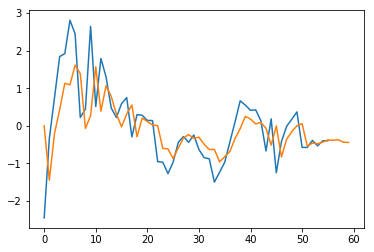

56 A03 Inventory
[0.02787727 0.08995624 0.04297894 0.05460074] $


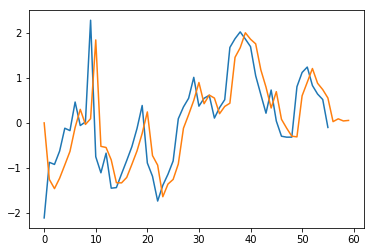

56 B01 Inventory
[-0.92722602 -1.04249331 -1.2765808  -0.99648008] $


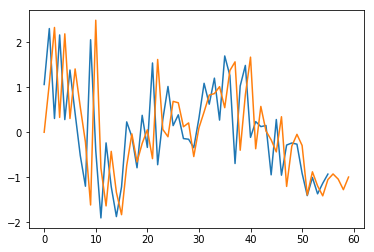

56 B03 Inventory
[-1.62023115 -2.21590243 -1.44152591 -1.42627073] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


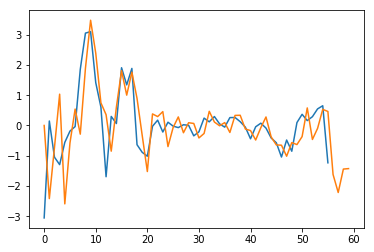

48 B05 Inventory
[0.43694961 0.99432247 0.78522966 0.75033688] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


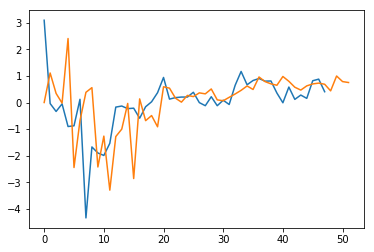

23 B07 Inventory
[-0.22238348 -0.13119707 -0.03476695  0.08929467] $


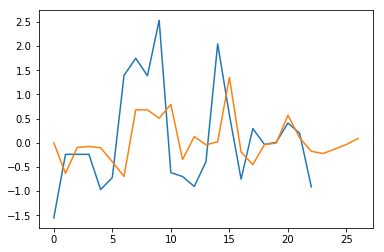

56 B08 Inventory
[1.21031084 1.25789719 1.30175881 1.13992003] $


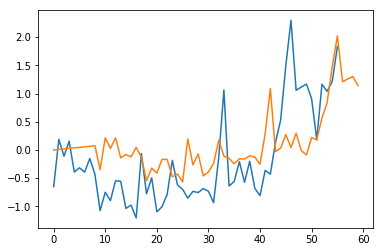

5 B11 Inventory
[0.52986795 0.63584154 0.74181513 0.84778872] $


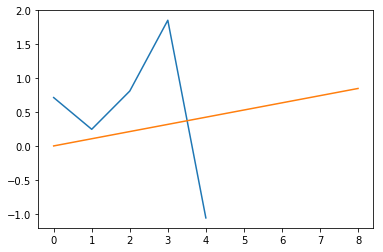

56 B13 Inventory
[-0.52076115 -0.17264348 -0.53936041 -0.49984895] $


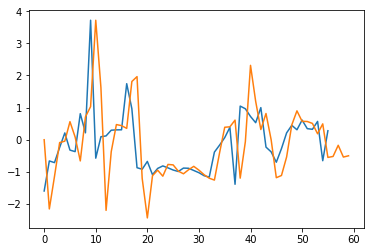

56 B15 Inventory
[1.35920385 0.68014709 0.79754047 0.06708865] $


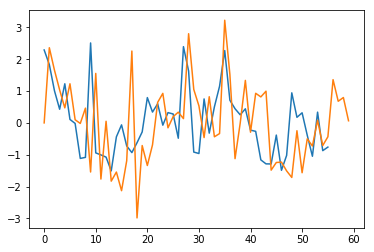

56 B17 Inventory
[0.48232848 0.51892205 0.54809022 0.57659275] $


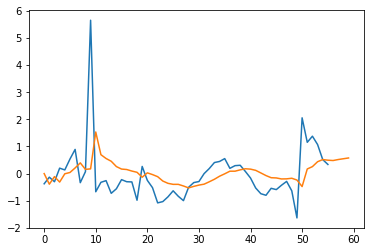

56 B22 Inventory
[2.06985525 1.16273179 2.5114502  2.07048707] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


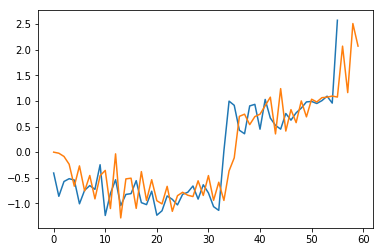

56 B23 Inventory
[-1.0076567  -1.09642589 -0.89442097 -1.14030101] $


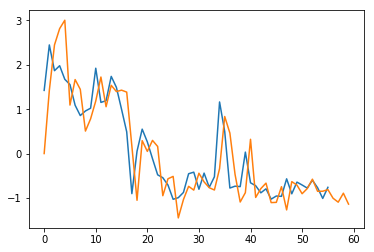

56 B25 Inventory
[1.8533218  1.8307841  1.84387766 1.95049927] $


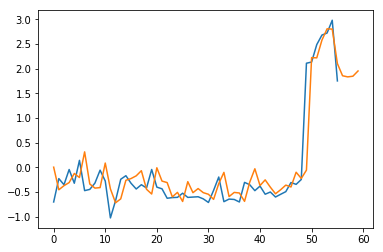

56 B27 Inventory
[-1.55909527 -1.71696432 -1.24560697 -1.27889542] $


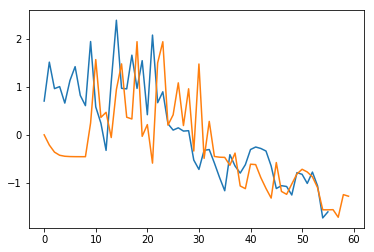

24 C01 Inventory
[-0.16352517 -0.13769236 -0.1035515  -0.00401346] $


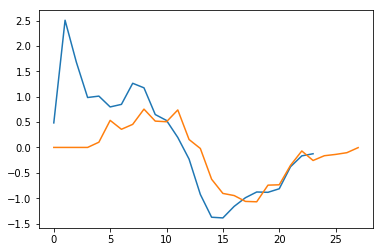

56 C04 Inventory
[ 0.02483152 -0.07768874 -0.01318756 -0.0033524 ] $


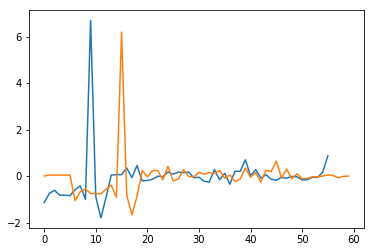

24 C05 Inventory
[-1.6063736  -1.04789358 -1.65228252 -1.03249387] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


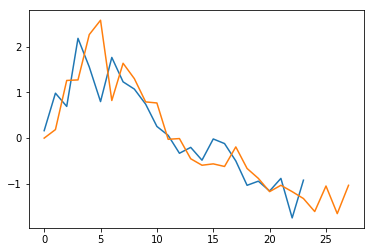

26 C06 Inventory
[3.40757511 1.93684737 1.7755041  2.13004365] $


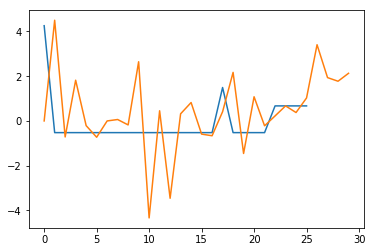

56 C09 Inventory
[-0.67093591 -0.60680795 -0.74152093 -0.68275802] $


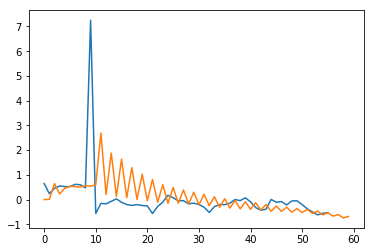

24 D03 Inventory
[1.90559288 2.05348883 2.53410847 2.87299555] $


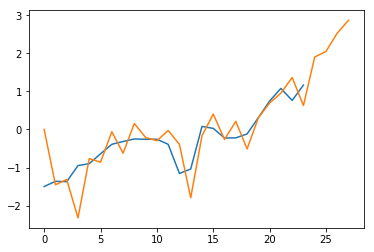

56 D06 Inventory
[0.16594568 0.11104824 0.18898625 0.22629974] $


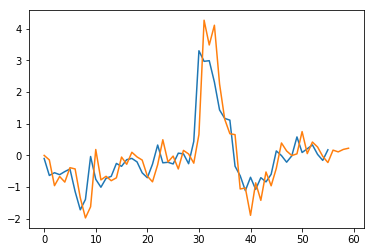

56 D10 Inventory
[ 0.27072372 -0.06293497 -0.0605076  -0.1373398 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


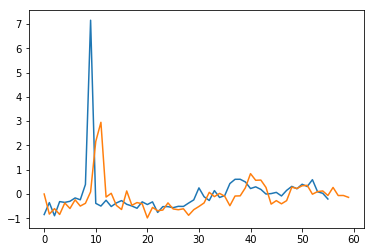

12 E01 Inventory
[-0.29046109 -0.23305932 -0.2364599  -0.18812138] $


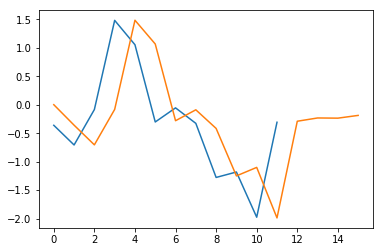

43 E04 Inventory
[-0.52022565 -0.58354628 -0.64686691 -0.71018753] $


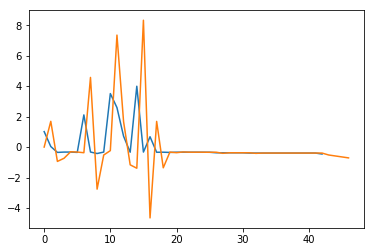

56 E11 Inventory
[1.5143516  1.56557873 1.51533319 1.49224361] $


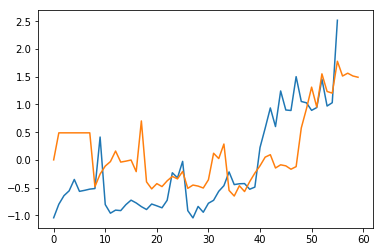

24 E15 Inventory
[-0.04842614 -0.38322691 -1.30634311 -1.38210403] $


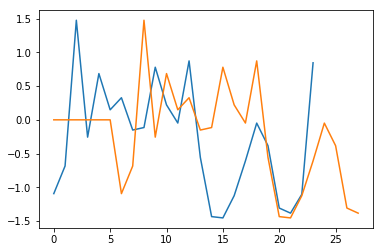

38 E16 Inventory
[-0.14931351 -0.14932979 -0.14934042 -0.1493547 ] $


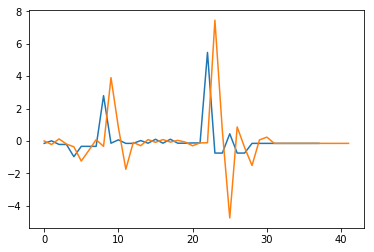

56 E18 Inventory
[-0.18231818 -0.32635281  0.28559541 -0.06729071] $


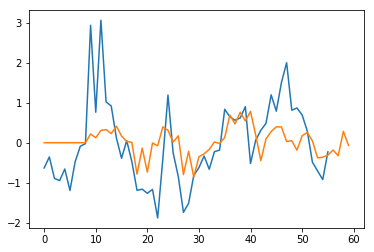

56 F02 Inventory
[1.7993083  2.02500277 1.64164461 2.03392046] $


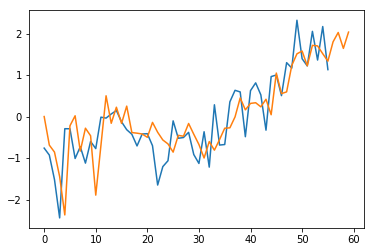

56 F04 Inventory
[0.23390667 0.21882747 0.18313808 0.16044223] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


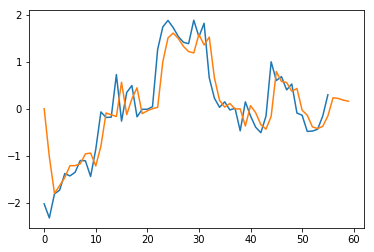

56 F05 Inventory
[0.06167183 0.52006747 0.92315938 0.88384054] $


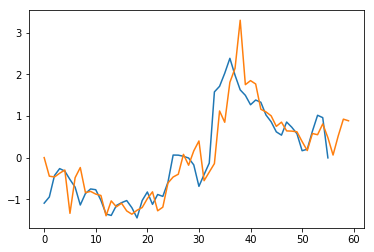

56 G01 Inventory
[0.692275   0.55331628 0.64316737 0.62106254] $


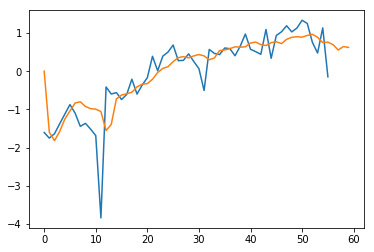

7 G03 Inventory
[0.97832322 1.11808368 1.25784414 1.3976046 ] $


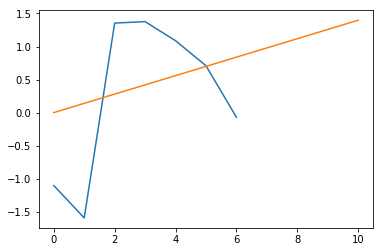

56 G05 Inventory
[-1.33909274 -1.94208648 -1.85918753 -1.7345885 ] $


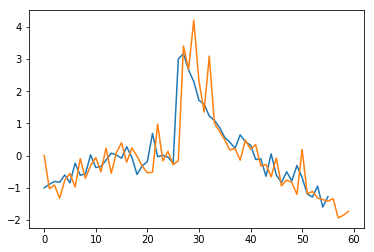

34 G08 Inventory
[-0.67839233 -0.69510396 -0.71532459 -0.70955978] $


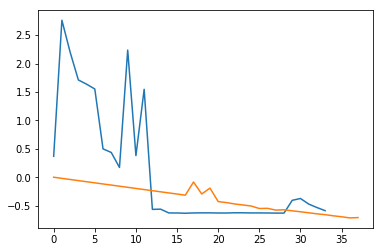

56 G10 Inventory
[ 5.38385603  5.27988545 -0.23283426 -0.28957223] $


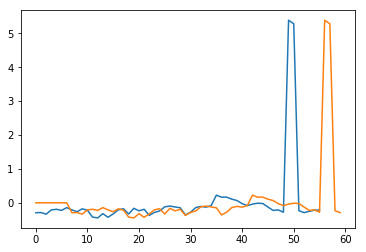

56 G12 Inventory
[-1.17763049 -1.22534742 -1.2676768  -1.31017571] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


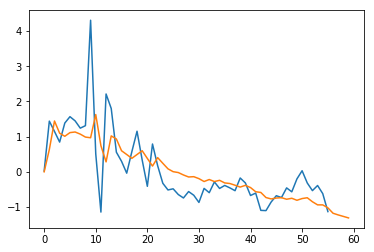

56 A01 Inventory
[-0.38671084 -0.37070456 -0.43805104 -0.44294185] $


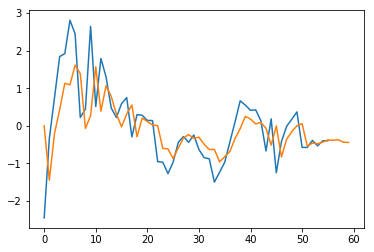

56 A03 Inventory
[0.02787727 0.08995624 0.04297894 0.05460074] $


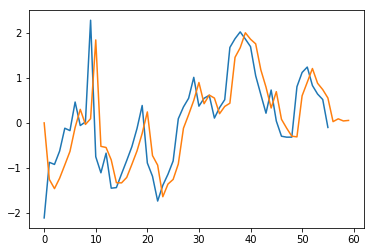

56 B01 Inventory
[-0.92722602 -1.04249331 -1.2765808  -0.99648008] $


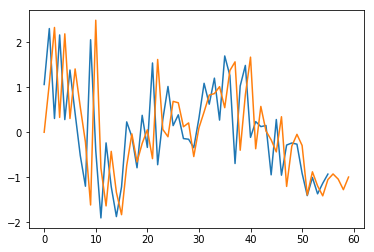

56 B03 Inventory
[-1.62023115 -2.21590243 -1.44152591 -1.42627073] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


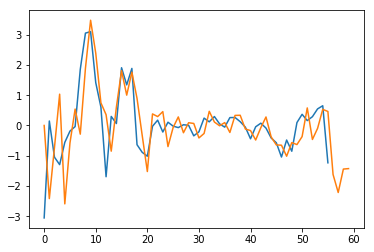

48 B05 Inventory
[0.43694961 0.99432247 0.78522966 0.75033688] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


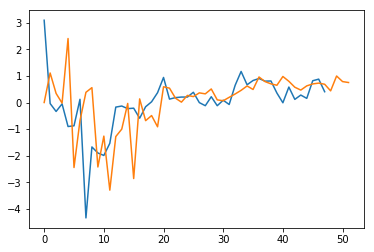

23 B07 Inventory
[-0.22238348 -0.13119707 -0.03476695  0.08929467] $


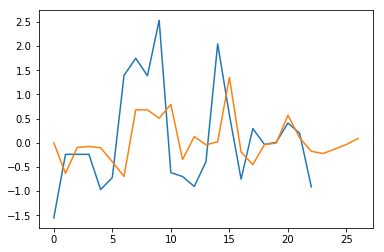

56 B08 Inventory
[1.21031084 1.25789719 1.30175881 1.13992003] $


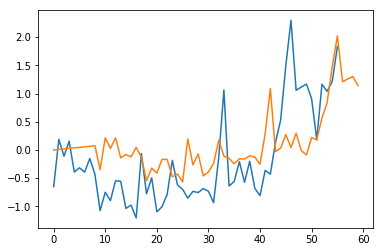

5 B11 Inventory
[0.52986795 0.63584154 0.74181513 0.84778872] $


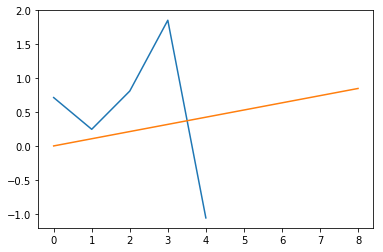

56 B13 Inventory
[-0.52076115 -0.17264348 -0.53936041 -0.49984895] $


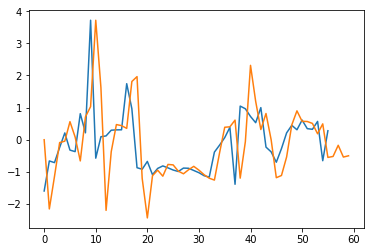

56 B15 Inventory
[1.35920385 0.68014709 0.79754047 0.06708865] $


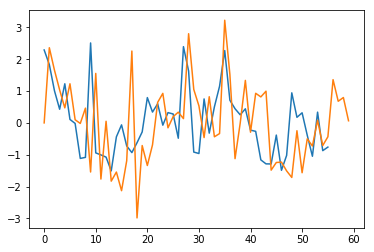

56 B17 Inventory
[0.48232848 0.51892205 0.54809022 0.57659275] $


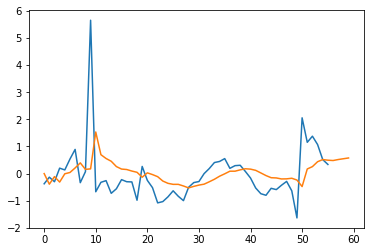

56 B22 Inventory
[2.06985525 1.16273179 2.5114502  2.07048707] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


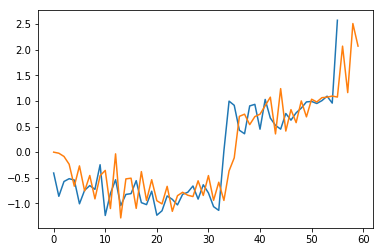

56 B23 Inventory
[-1.0076567  -1.09642589 -0.89442097 -1.14030101] $


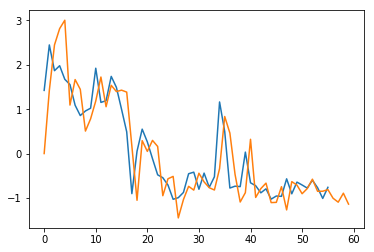

56 B25 Inventory
[1.8533218  1.8307841  1.84387766 1.95049927] $


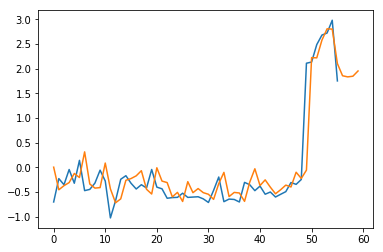

56 B27 Inventory
[-1.55909527 -1.71696432 -1.24560697 -1.27889542] $


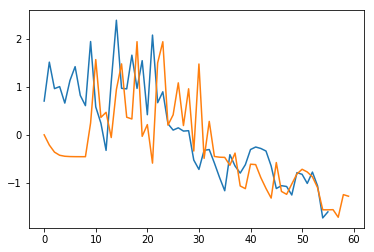

24 C01 Inventory
[-0.16352517 -0.13769236 -0.1035515  -0.00401346] $


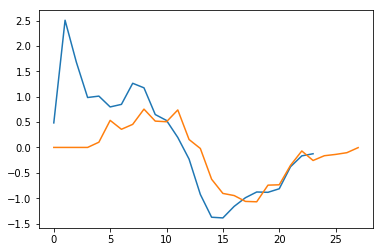

56 C04 Inventory
[ 0.02483152 -0.07768874 -0.01318756 -0.0033524 ] $


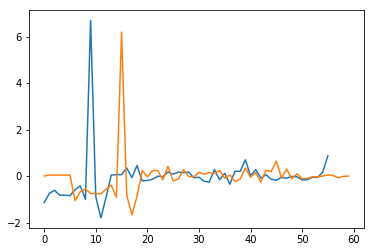

24 C05 Inventory
[-1.6063736  -1.04789358 -1.65228252 -1.03249387] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


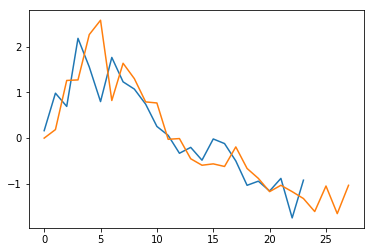

26 C06 Inventory
[3.40757511 1.93684737 1.7755041  2.13004365] $


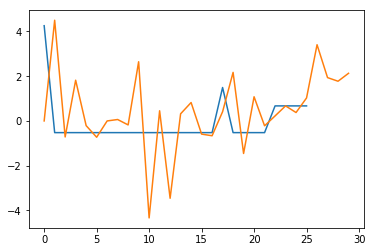

56 C09 Inventory
[-0.67093591 -0.60680795 -0.74152093 -0.68275802] $


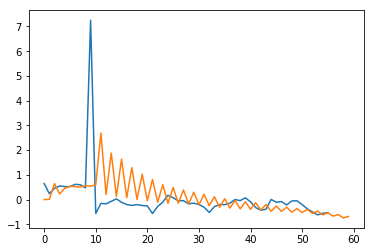

24 D03 Inventory
[1.90559288 2.05348883 2.53410847 2.87299555] $


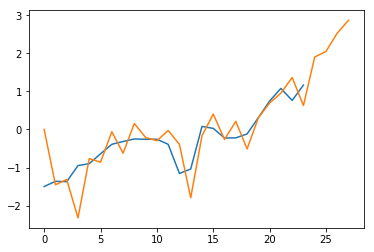

56 D06 Inventory
[0.16594568 0.11104824 0.18898625 0.22629974] $


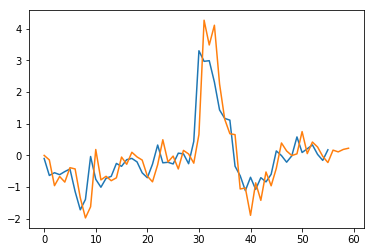

56 D10 Inventory
[ 0.27072372 -0.06293497 -0.0605076  -0.1373398 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


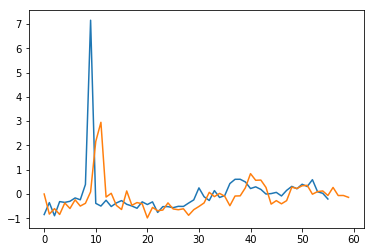

12 E01 Inventory
[-0.29046109 -0.23305932 -0.2364599  -0.18812138] $


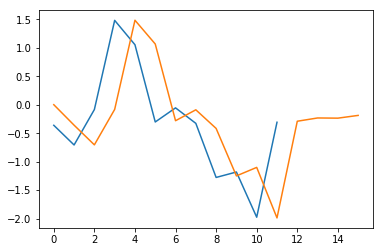

43 E04 Inventory
[-0.52022565 -0.58354628 -0.64686691 -0.71018753] $


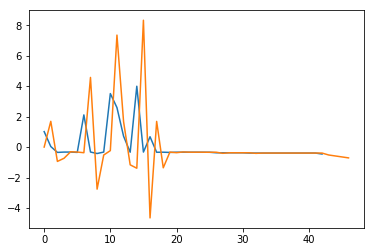

36 E09 Inventory
[-0.16416409 -0.12623662 -0.08336328 -0.03553668] $


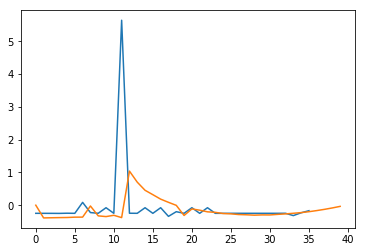

56 E11 Inventory
[1.5143516  1.56557873 1.51533319 1.49224361] $


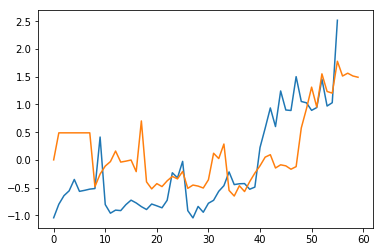

24 E15 Inventory
[-0.04842614 -0.38322691 -1.30634311 -1.38210403] $


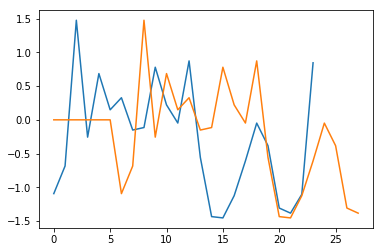

38 E16 Inventory
[-0.14931351 -0.14932979 -0.14934042 -0.1493547 ] $


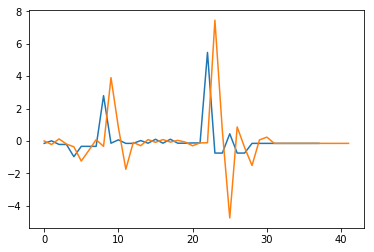

56 E18 Inventory
[-0.18231818 -0.32635281  0.28559541 -0.06729071] $


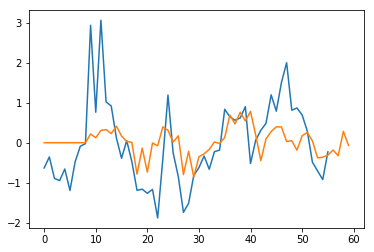

56 F02 Inventory
[1.7993083  2.02500277 1.64164461 2.03392046] $


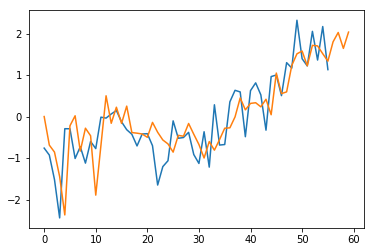

56 F04 Inventory
[0.23390667 0.21882747 0.18313808 0.16044223] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


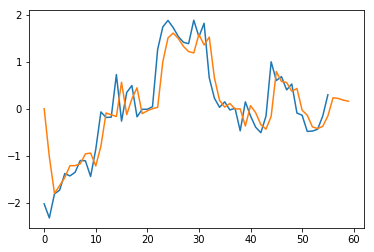

56 F05 Inventory
[0.06167183 0.52006747 0.92315938 0.88384054] $


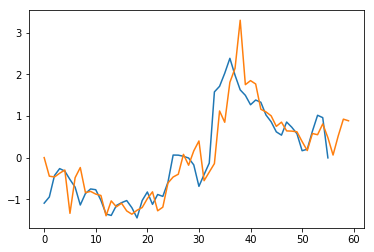

56 G01 Inventory
[0.692275   0.55331628 0.64316737 0.62106254] $


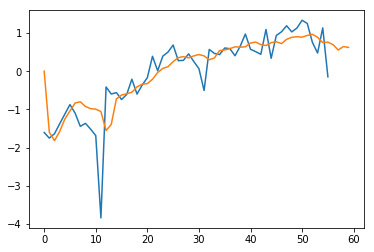

7 G03 Inventory
[0.97832322 1.11808368 1.25784414 1.3976046 ] $


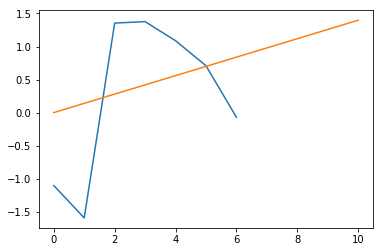

56 G05 Inventory
[-1.33909274 -1.94208648 -1.85918753 -1.7345885 ] $


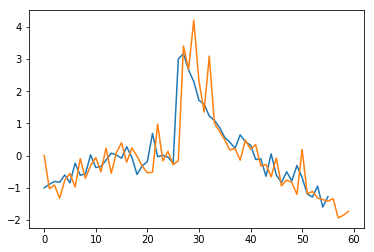

34 G08 Inventory
[-0.67839233 -0.69510396 -0.71532459 -0.70955978] $


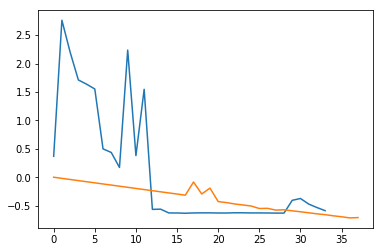

56 G10 Inventory
[ 5.38385603  5.27988545 -0.23283426 -0.28957223] $


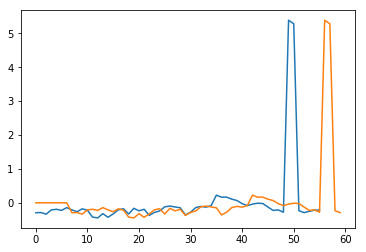

56 G12 Inventory
[-1.17763049 -1.22534742 -1.2676768  -1.31017571] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


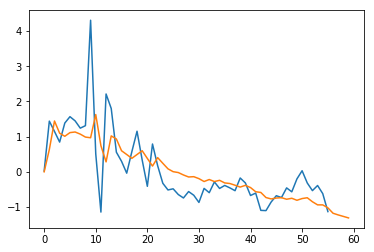

56 A01 Inventory
[-0.38671084 -0.37070456 -0.43805104 -0.44294185] $


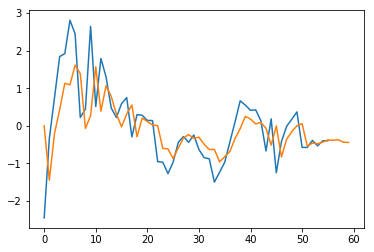

56 A03 Inventory
[0.02787727 0.08995624 0.04297894 0.05460074] $


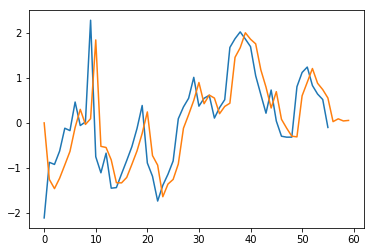

56 B01 Inventory
[-0.92722602 -1.04249331 -1.2765808  -0.99648008] $


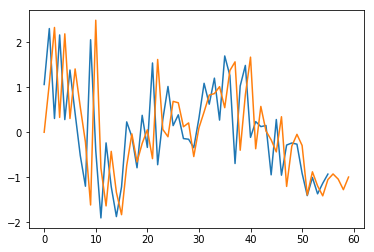

56 B03 Inventory
[-1.62023115 -2.21590243 -1.44152591 -1.42627073] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


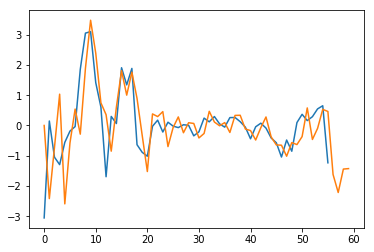

48 B05 Inventory
[0.43694961 0.99432247 0.78522966 0.75033688] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


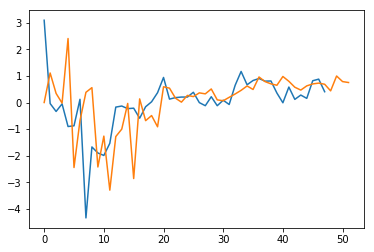

23 B07 Inventory
[-0.22238348 -0.13119707 -0.03476695  0.08929467] $


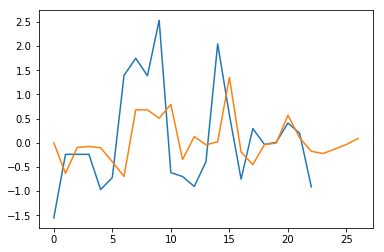

56 B08 Inventory
[1.21031084 1.25789719 1.30175881 1.13992003] $


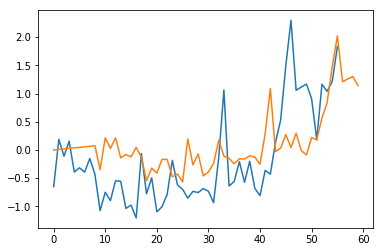

5 B11 Inventory
[0.52986795 0.63584154 0.74181513 0.84778872] $


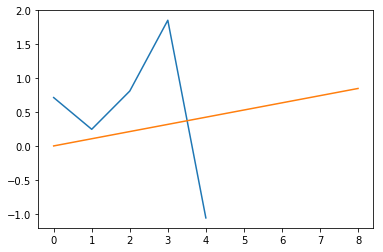

56 B13 Inventory
[-0.52076115 -0.17264348 -0.53936041 -0.49984895] $


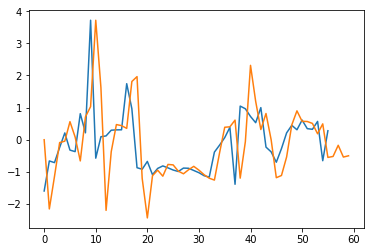

56 B15 Inventory
[1.35920385 0.68014709 0.79754047 0.06708865] $


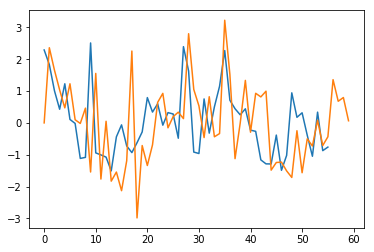

56 B17 Inventory
[0.48232848 0.51892205 0.54809022 0.57659275] $


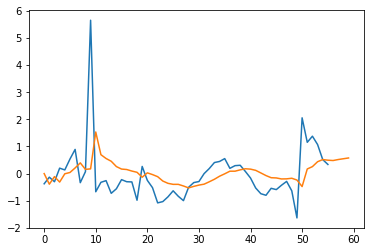

9 B19 Inventory
[-0.02050399 -0.02050399 -0.02050399 -0.02050399] $


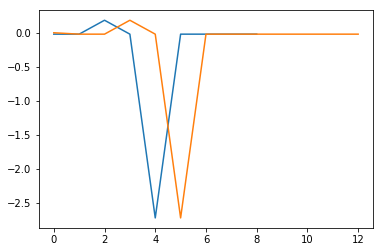

56 B22 Inventory
[2.06985525 1.16273179 2.5114502  2.07048707] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


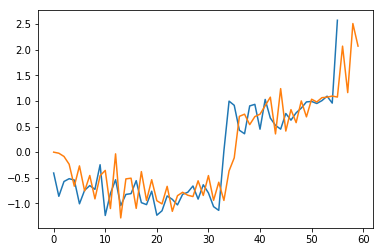

56 B23 Inventory
[-1.0076567  -1.09642589 -0.89442097 -1.14030101] $


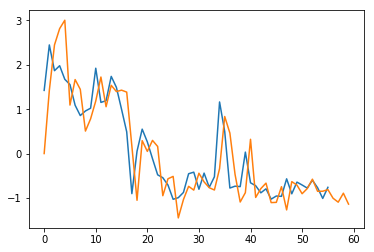

56 B25 Inventory
[1.8533218  1.8307841  1.84387766 1.95049927] $


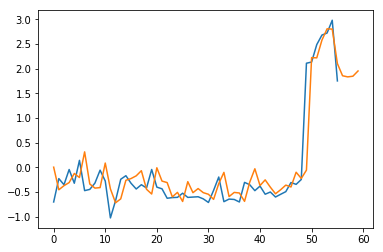

56 B27 Inventory
[-1.55909527 -1.71696432 -1.24560697 -1.27889542] $


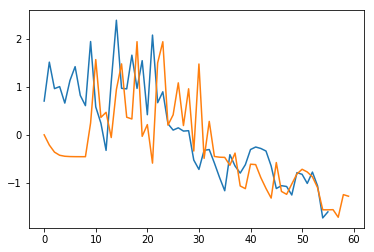

24 C01 Inventory
[-0.16352517 -0.13769236 -0.1035515  -0.00401346] $


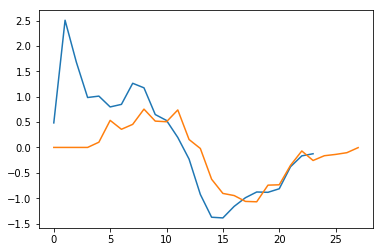

56 C04 Inventory
[ 0.02483152 -0.07768874 -0.01318756 -0.0033524 ] $


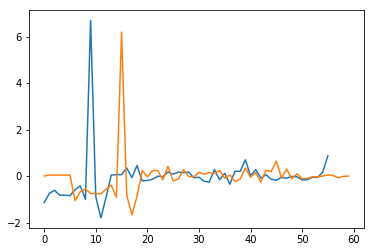

24 C05 Inventory
[-1.6063736  -1.04789358 -1.65228252 -1.03249387] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


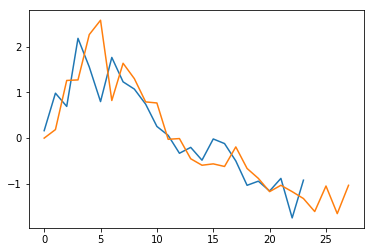

26 C06 Inventory
[3.40757511 1.93684737 1.7755041  2.13004365] $


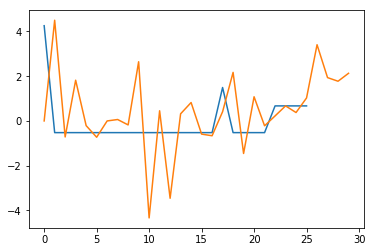

56 C09 Inventory
[-0.67093591 -0.60680795 -0.74152093 -0.68275802] $


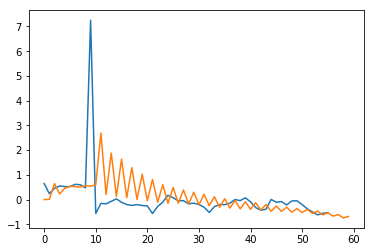

24 D03 Inventory
[1.90559288 2.05348883 2.53410847 2.87299555] $


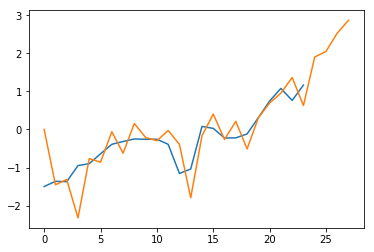

56 D06 Inventory
[0.16594568 0.11104824 0.18898625 0.22629974] $


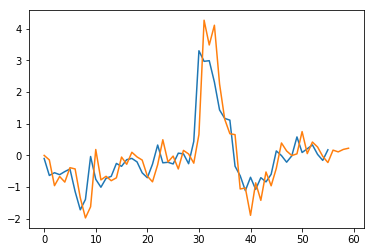

56 D10 Inventory
[ 0.27072372 -0.06293497 -0.0605076  -0.1373398 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


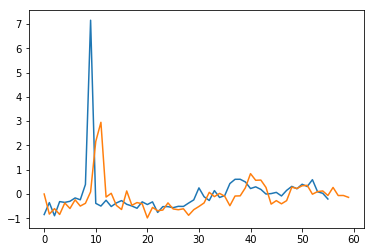

12 E01 Inventory
[-0.29046109 -0.23305932 -0.2364599  -0.18812138] $


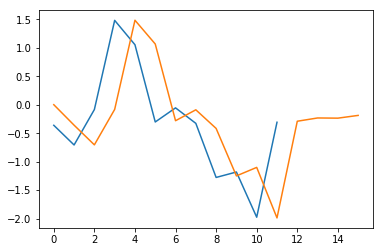

43 E04 Inventory
[-0.52022565 -0.58354628 -0.64686691 -0.71018753] $


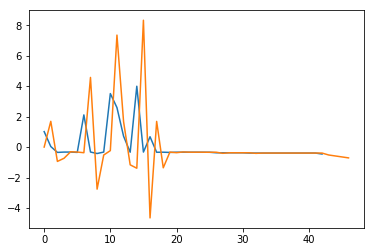

56 E11 Inventory
[1.5143516  1.56557873 1.51533319 1.49224361] $


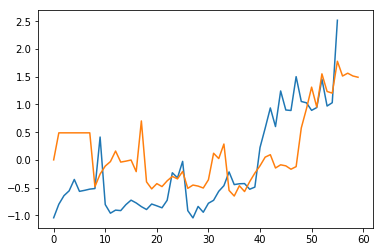

24 E15 Inventory
[-0.04842614 -0.38322691 -1.30634311 -1.38210403] $


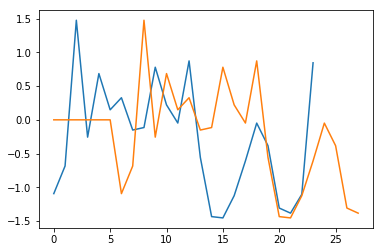

38 E16 Inventory
[-0.14931351 -0.14932979 -0.14934042 -0.1493547 ] $


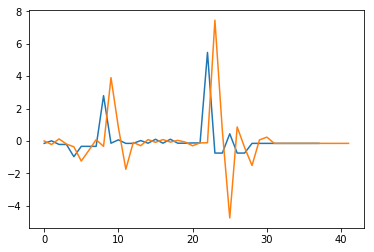

56 E18 Inventory
[-0.18231818 -0.32635281  0.28559541 -0.06729071] $


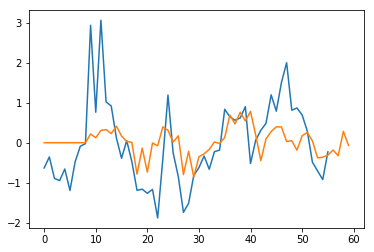

56 F02 Inventory
[1.7993083  2.02500277 1.64164461 2.03392046] $


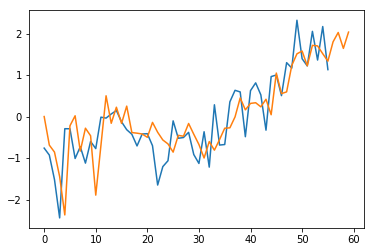

56 F04 Inventory
[0.23390667 0.21882747 0.18313808 0.16044223] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


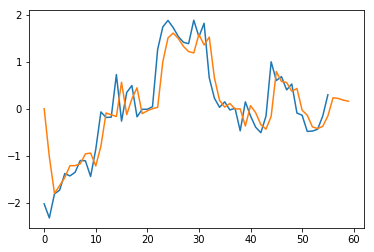

56 F05 Inventory
[0.06167183 0.52006747 0.92315938 0.88384054] $


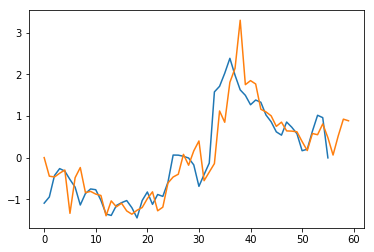

56 G01 Inventory
[0.692275   0.55331628 0.64316737 0.62106254] $


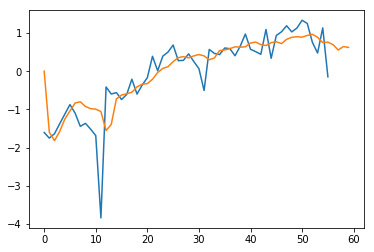

7 G03 Inventory
[0.97832322 1.11808368 1.25784414 1.3976046 ] $


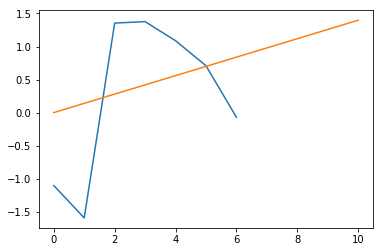

56 G05 Inventory
[-1.33909274 -1.94208648 -1.85918753 -1.7345885 ] $


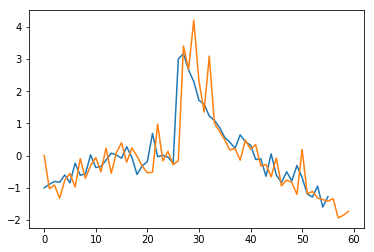

34 G08 Inventory
[-0.67839233 -0.69510396 -0.71532459 -0.70955978] $


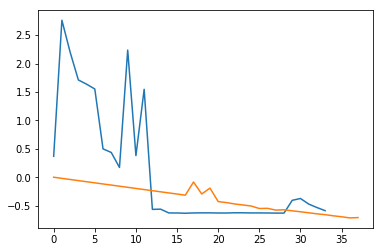

56 G10 Inventory
[ 5.38385603  5.27988545 -0.23283426 -0.28957223] $


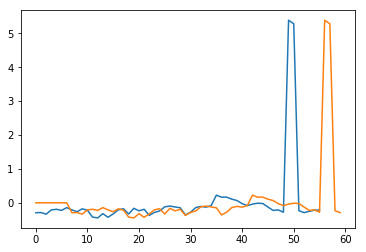

56 G12 Inventory
[-1.17763049 -1.22534742 -1.2676768  -1.31017571] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


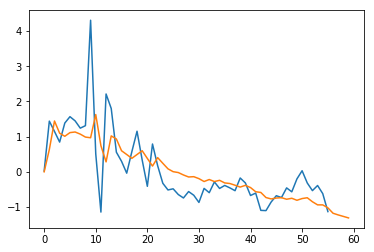

56 A01 Inventory
[-0.38671084 -0.37070456 -0.43805104 -0.44294185] $


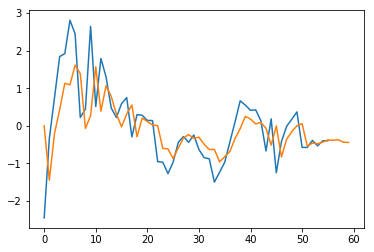

56 A03 Inventory
[0.02787727 0.08995624 0.04297894 0.05460074] $


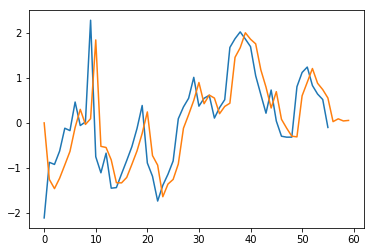

56 B01 Inventory
[-0.92722602 -1.04249331 -1.2765808  -0.99648008] $


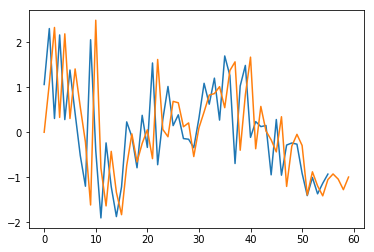

56 B03 Inventory
[-1.62023115 -2.21590243 -1.44152591 -1.42627073] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


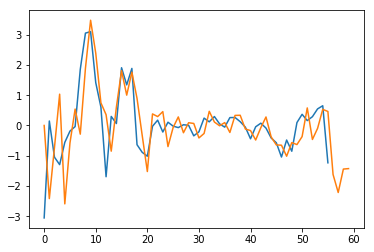

48 B05 Inventory
[0.43694961 0.99432247 0.78522966 0.75033688] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


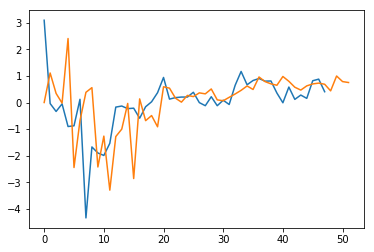

23 B07 Inventory
[-0.22238348 -0.13119707 -0.03476695  0.08929467] $


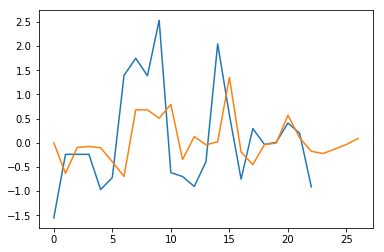

56 B08 Inventory
[1.21031084 1.25789719 1.30175881 1.13992003] $


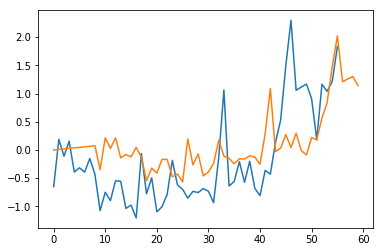

5 B11 Inventory
[0.52986795 0.63584154 0.74181513 0.84778872] $


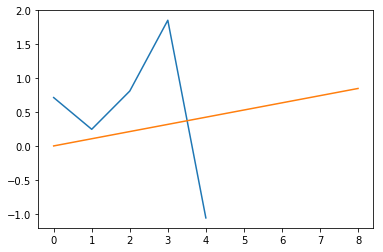

56 B13 Inventory
[-0.52076115 -0.17264348 -0.53936041 -0.49984895] $


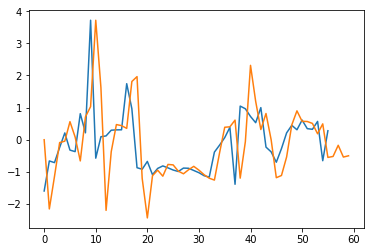

56 B15 Inventory
[1.35920385 0.68014709 0.79754047 0.06708865] $


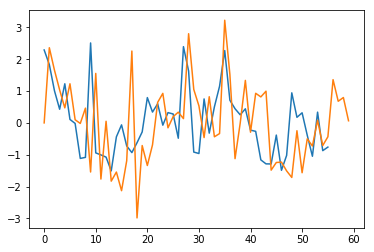

56 B17 Inventory
[0.48232848 0.51892205 0.54809022 0.57659275] $


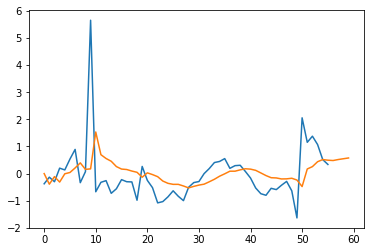

9 B19 Inventory
[-0.02050399 -0.02050399 -0.02050399 -0.02050399] $


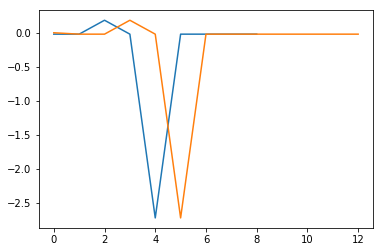

56 B22 Inventory
[2.06985525 1.16273179 2.5114502  2.07048707] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


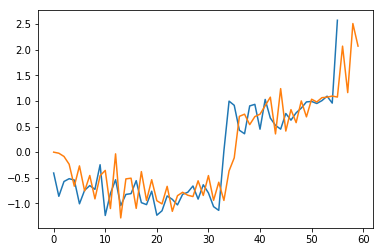

56 B23 Inventory
[-1.0076567  -1.09642589 -0.89442097 -1.14030101] $


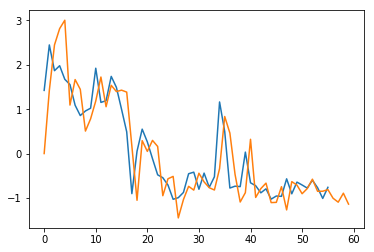

56 B25 Inventory
[1.8533218  1.8307841  1.84387766 1.95049927] $


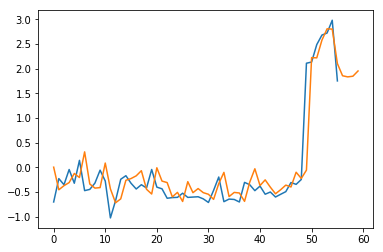

56 B27 Inventory
[-1.55909527 -1.71696432 -1.24560697 -1.27889542] $


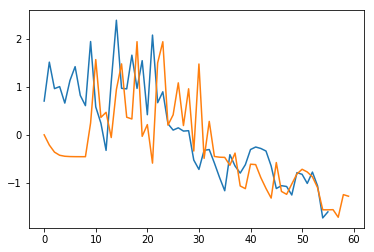

24 C01 Inventory
[-0.16352517 -0.13769236 -0.1035515  -0.00401346] $


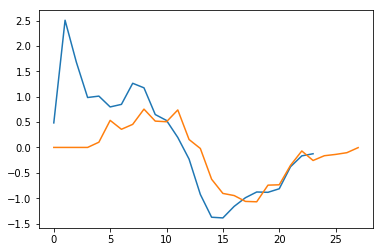

56 C04 Inventory
[ 0.02483152 -0.07768874 -0.01318756 -0.0033524 ] $


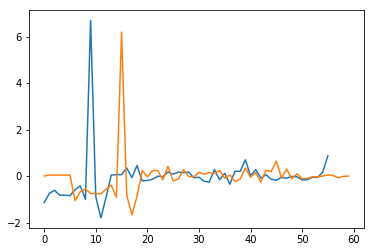

24 C05 Inventory
[-1.6063736  -1.04789358 -1.65228252 -1.03249387] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


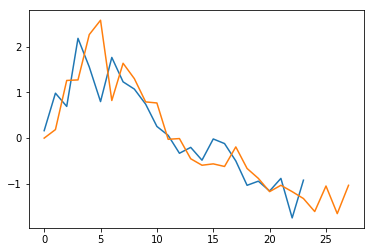

56 C09 Inventory
[-0.67093591 -0.60680795 -0.74152093 -0.68275802] $


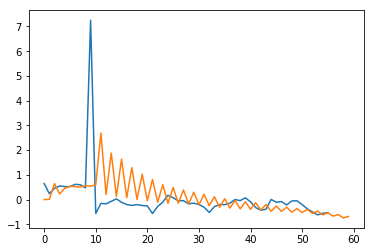

24 D03 Inventory
[1.90559288 2.05348883 2.53410847 2.87299555] $


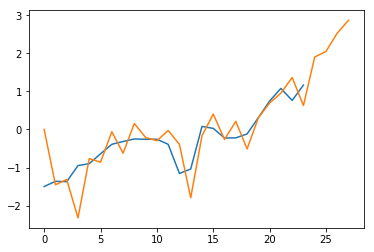

56 D06 Inventory
[0.16594568 0.11104824 0.18898625 0.22629974] $


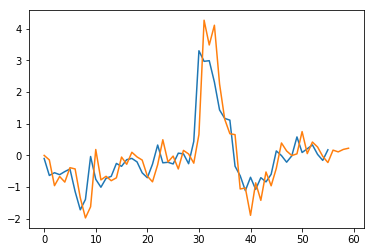

56 D10 Inventory
[ 0.27072372 -0.06293497 -0.0605076  -0.1373398 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


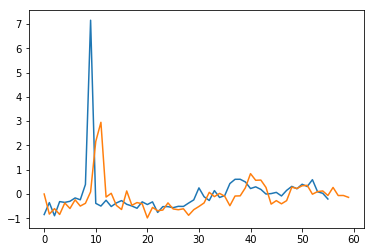

12 E01 Inventory
[-0.29046109 -0.23305932 -0.2364599  -0.18812138] $


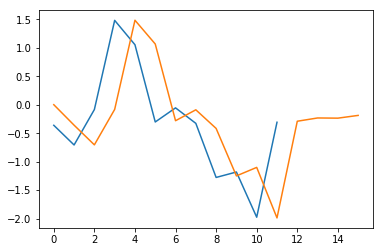

43 E04 Inventory
[-0.52022565 -0.58354628 -0.64686691 -0.71018753] $


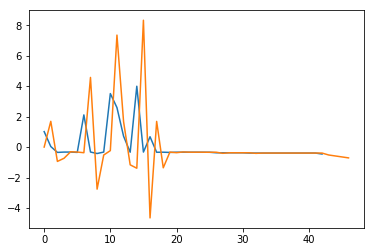

56 E11 Inventory
[1.5143516  1.56557873 1.51533319 1.49224361] $


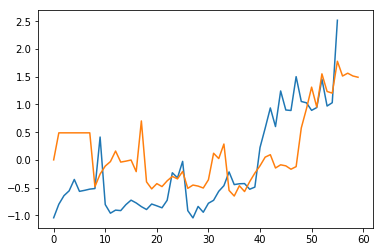

24 E15 Inventory
[-0.04842614 -0.38322691 -1.30634311 -1.38210403] $


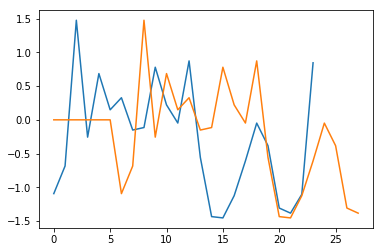

38 E16 Inventory
[-0.14931351 -0.14932979 -0.14934042 -0.1493547 ] $


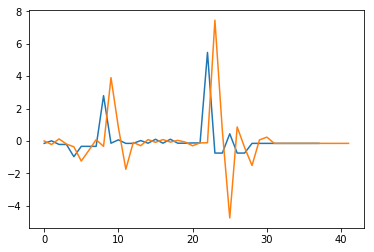

56 E18 Inventory
[-0.18231818 -0.32635281  0.28559541 -0.06729071] $


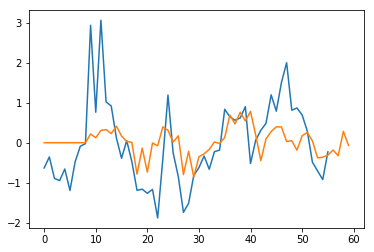

56 F02 Inventory
[1.7993083  2.02500277 1.64164461 2.03392046] $


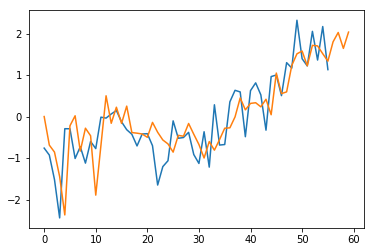

56 F04 Inventory
[0.23390667 0.21882747 0.18313808 0.16044223] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


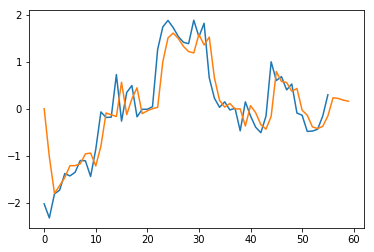

56 F05 Inventory
[0.06167183 0.52006747 0.92315938 0.88384054] $


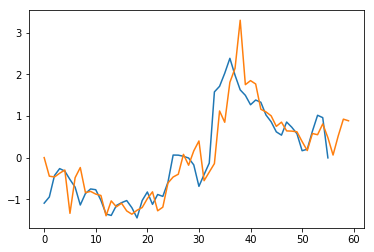

56 G01 Inventory
[0.692275   0.55331628 0.64316737 0.62106254] $


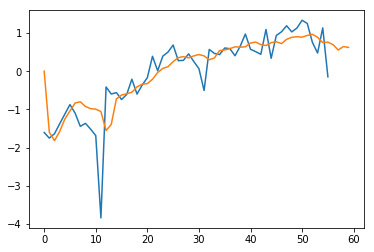

7 G03 Inventory
[0.97832322 1.11808368 1.25784414 1.3976046 ] $


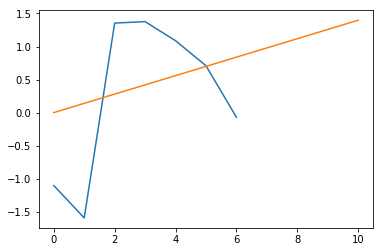

56 G05 Inventory
[-1.33909274 -1.94208648 -1.85918753 -1.7345885 ] $


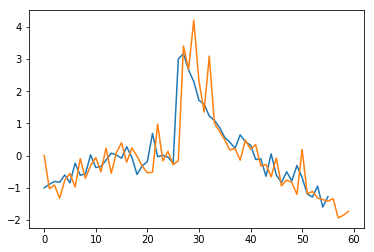

34 G08 Inventory
[-0.67839233 -0.69510396 -0.71532459 -0.70955978] $


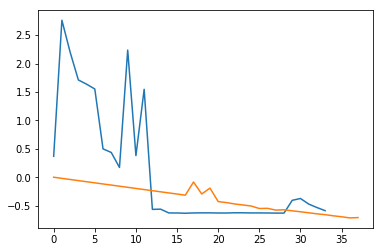

56 G10 Inventory
[ 5.38385603  5.27988545 -0.23283426 -0.28957223] $


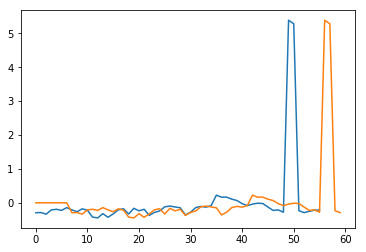

56 G12 Inventory
[-1.17763049 -1.22534742 -1.2676768  -1.31017571] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


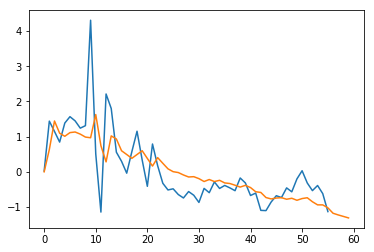

56 A01 Payables and Accruals
[-1.40493826 -1.21793139 -0.86108039 -1.3328222 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


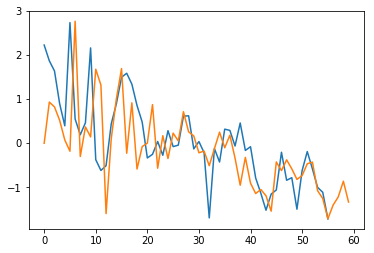

45 A02 Payables and Accruals
[-2.55314191 -3.1684805  -3.60891817 -4.42800165] $


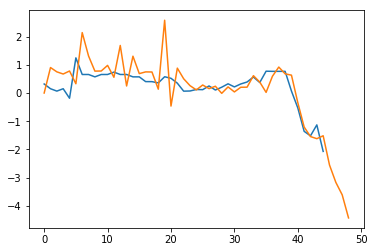

56 A03 Payables and Accruals
[-1.1053108  -0.86989142 -0.94375269 -0.92843394] $


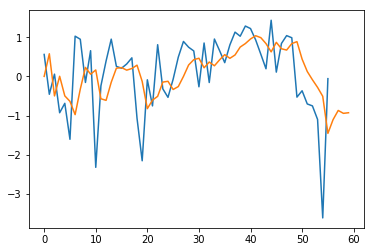

56 B01 Payables and Accruals
[-0.99217575 -0.57076396 -0.84108524 -0.43068088] $


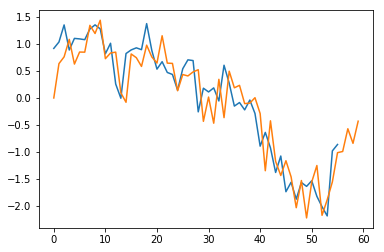

34 B02 Payables and Accruals
[-0.42855856 -0.47726239 -2.45415559 -0.09567749] $


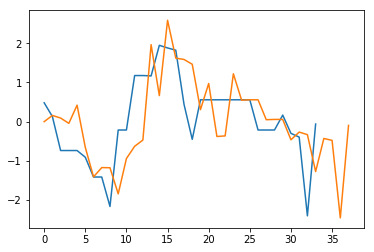

56 B03 Payables and Accruals
[-0.93257903 -0.92833877 -1.09752032 -0.23114142] $


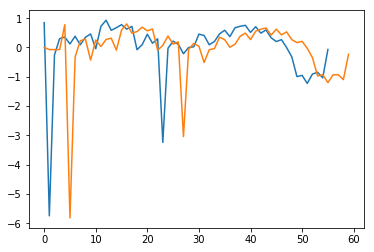

37 B04 Payables and Accruals
[0.70430099 0.80976131 0.78468994 0.97372169] $


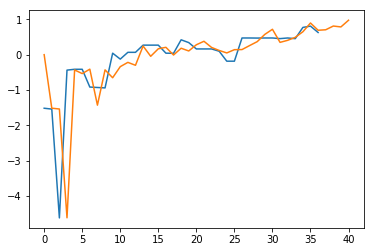

56 B05 Payables and Accruals
[ 0.2616209   0.33203907 -0.3910931  -0.43585631] $


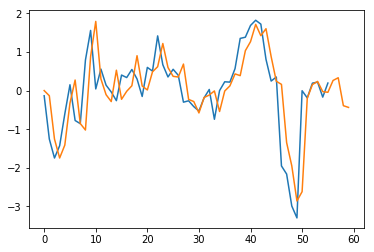

47 B07 Payables and Accruals
[0.88835096 0.79407421 0.66740823 0.51509578] $


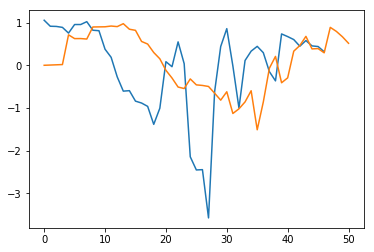

56 B08 Payables and Accruals
[-1.83275063 -1.93135764 -2.02943037 -2.12847295] $


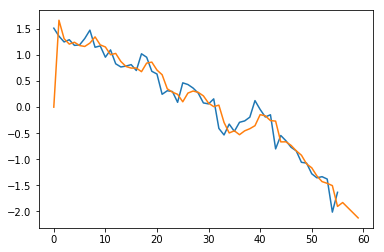

45 B09 Payables and Accruals
[-0.06726225 -0.09254865 -0.18420531 -0.48089589] $


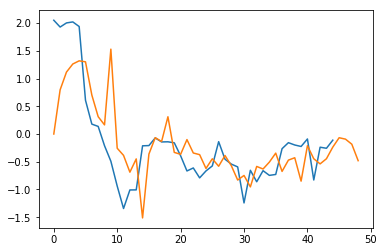

5 B11 Payables and Accruals
[-1.33190485 -1.59828581 -1.86466678 -2.13104775] $


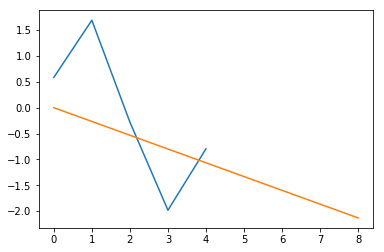

4 B12 Payables and Accruals
[0.18625091 0.23281364 0.27937637 0.3259391 ] $


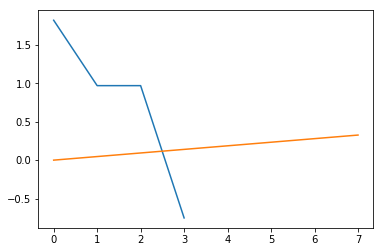

56 B13 Payables and Accruals
[-2.24649686 -2.14964652 -2.10756344 -2.07166264] $


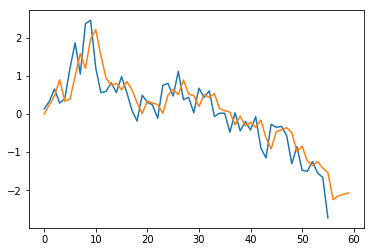

56 B15 Payables and Accruals
[0.4678497  0.21052278 0.23511099 0.15150889] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


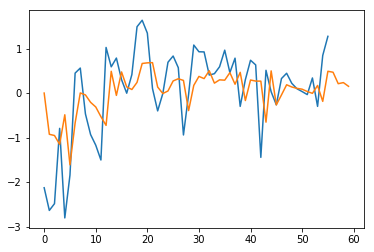

56 B16 Payables and Accruals
[0.96413192 1.33004724 1.72458023 2.28293504] $


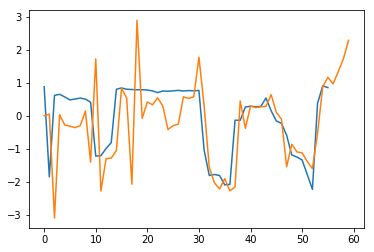

56 B17 Payables and Accruals
[-1.59489837 -1.79486716 -1.84513872 -1.98015086] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


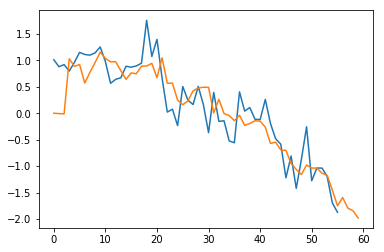

10 B18 Payables and Accruals
[0.15617376 0.15617376 0.15617376 0.15617376] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


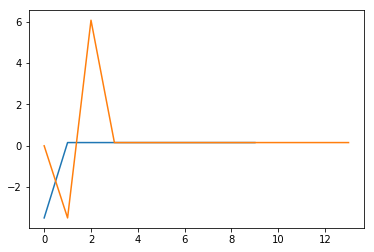

56 B19 Payables and Accruals
[-1.57609495 -1.82058536 -2.55144092 -2.92895623] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


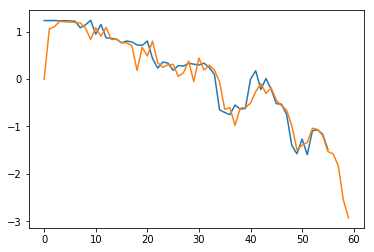

45 B20 Payables and Accruals
[-0.54174799 -0.63087808 -0.14411895 -0.17878574] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


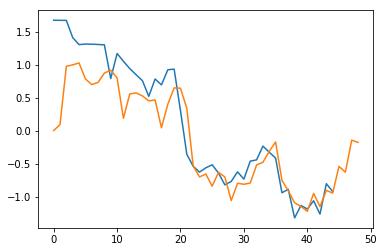

37 B21 Payables and Accruals
[0.33853882 0.41078392 0.14842489 0.08264658] $


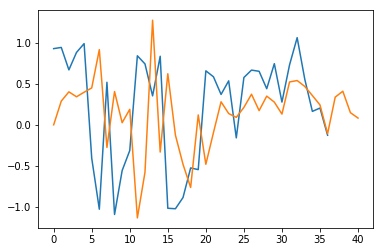

56 B22 Payables and Accruals
[-1.65031778 -1.7113003  -1.79735681 -1.82429885] $


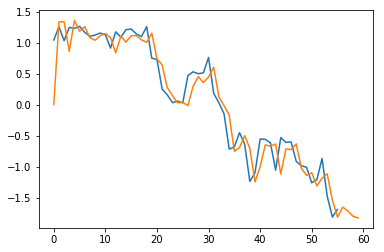

56 B23 Payables and Accruals
[-1.36503663 -1.25747348 -1.42493543 -1.4222728 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


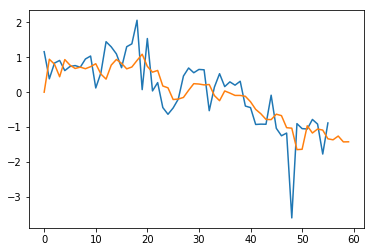

35 B24 Payables and Accruals
[-0.31690233 -0.35146931 -0.28436029 -0.25046406] $


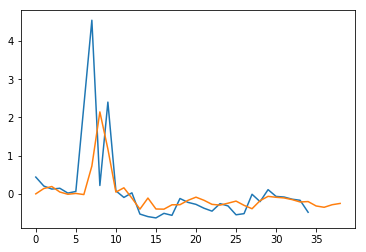

56 B25 Payables and Accruals
[-2.43911448 -2.61630588 -2.78908125 -2.98019095] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


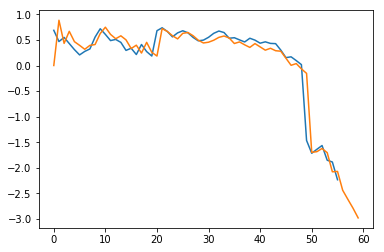

56 B27 Payables and Accruals
[-2.34465912 -3.04168566 -3.16353269 -2.99900061] $


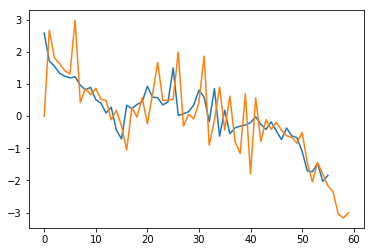

45 B28 Payables and Accruals
[1.2573505  2.39272437 3.62462643 4.95610926] $


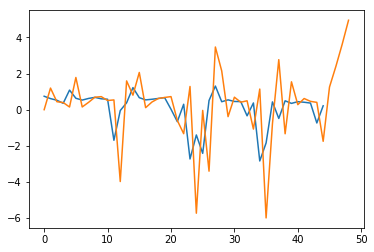

56 C02 Payables and Accruals
[0.3460002  0.38180832 0.14522438 0.10048454] $


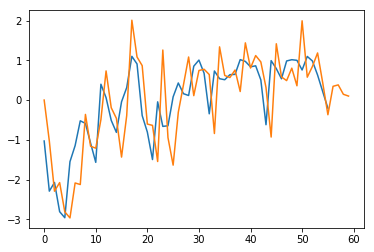

45 C03 Payables and Accruals
[0.5044365  0.52041212 0.49088864 0.53958038] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


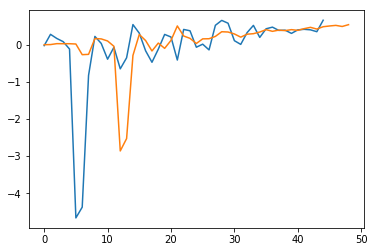

56 C04 Payables and Accruals
[-0.75763768 -0.86956651 -1.0698647  -1.05407973] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


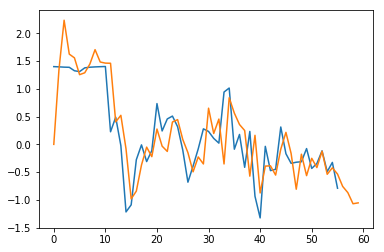

56 C06 Payables and Accruals
[0.51612733 0.63715311 0.74789564 0.60441593] $


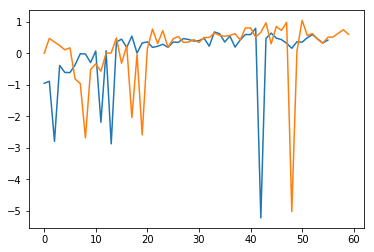

33 C08 Payables and Accruals
[0.9500894  0.738019   1.55641128 1.63436659] $


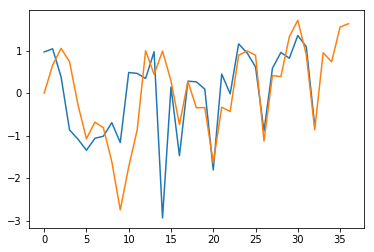

56 C09 Payables and Accruals
[-0.06549245  0.00585326 -0.01200105 -0.00118128] $


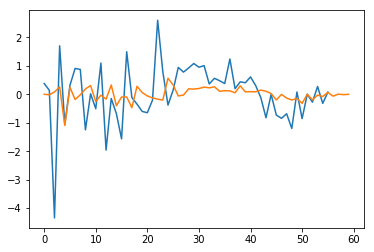

56 D04 Payables and Accruals
[0.73730393 0.75491581 0.7304676  0.54683899] $


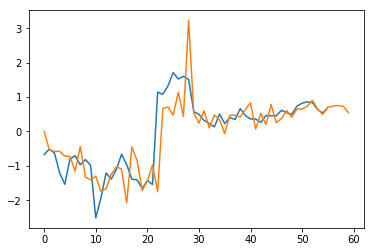

21 D05 Payables and Accruals
[-0.1928205  -1.1330081   0.32772922 -0.0427835 ] $


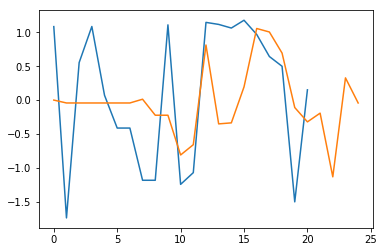

56 D06 Payables and Accruals
[-1.05380682 -1.46293461 -1.87280142 -1.28607813] $


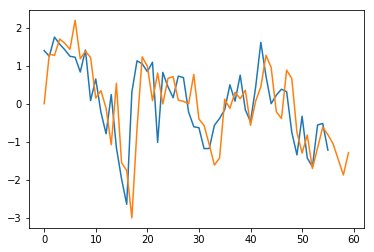

38 D07 Payables and Accruals
[-0.88772229 -1.1865699  -1.38891521 -1.76404252] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


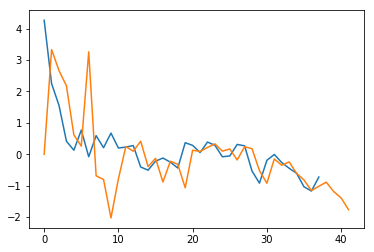

56 D10 Payables and Accruals
[-0.69633734 -0.64167921 -0.67833725 -0.28014753] $


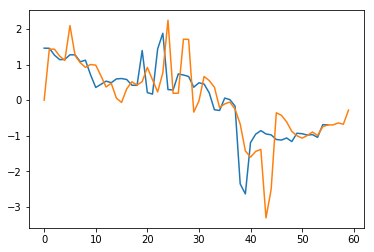

56 E09 Payables and Accruals
[-1.08507098 -0.10790237 -1.88712044 -1.34373982] $


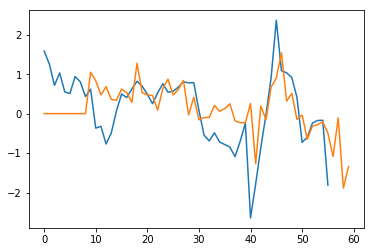

17 E10 Payables and Accruals
[1.08508787 1.28828053 1.57246591 1.87139427] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


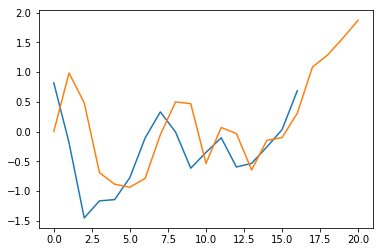

18 E11 Payables and Accruals
[ 0.37739188 -0.0510128  -0.0418602  -0.07024408] $


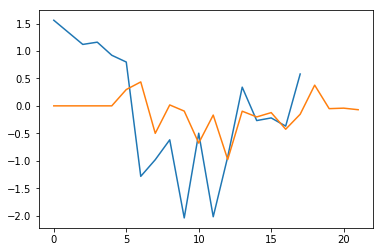

56 E12 Payables and Accruals
[1.01734964 0.57777486 1.29207694 0.95489379] $


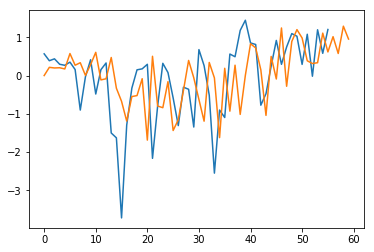

17 E13 Payables and Accruals
[0.39942081 0.94824103 1.87953787 1.72776794] $


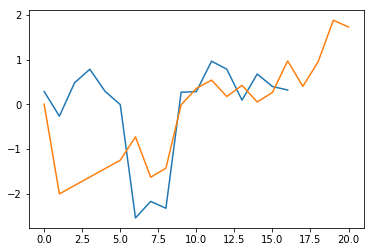

10 E15 Payables and Accruals
[0.21688611 0.00374561 0.68548122 0.74836509] $


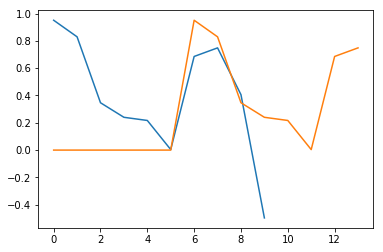

56 E16 Payables and Accruals
[-0.05087515 -0.24627725 -0.54390044  0.05073766] $


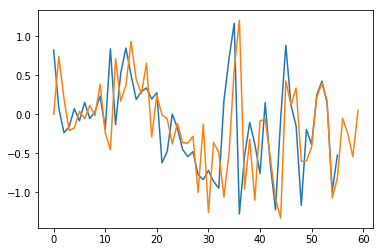

19 E17 Payables and Accruals
[-1.1948568  -0.51079952 -1.43870217 -0.74354891] $


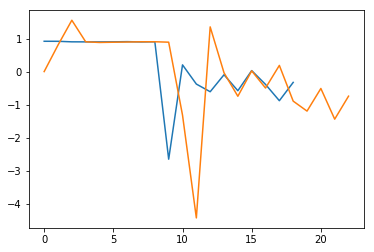

56 E18 Payables and Accruals
[-1.39139654 -1.50689645 -1.59412477 -1.46436927] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


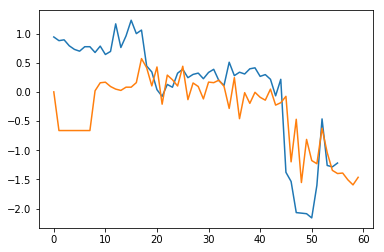

56 F02 Payables and Accruals
[-0.85882065 -1.0529724  -1.67587987 -1.70982239] $


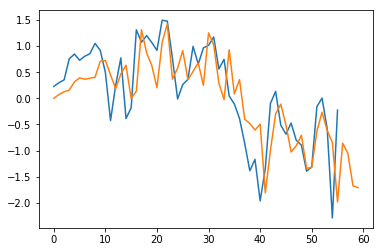

39 F03 Payables and Accruals
[0.16780151 0.18617419 0.11619149 0.06305238] $


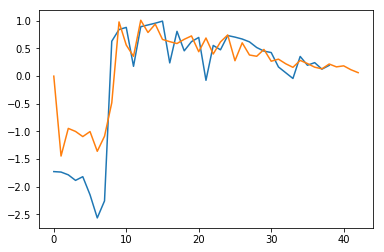

56 F04 Payables and Accruals
[-0.61472693 -0.21279215 -0.02193188  0.00750564] $


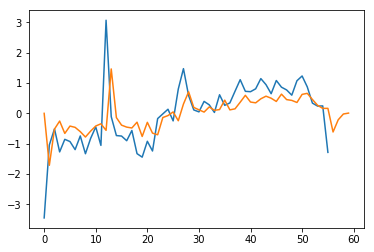

56 F05 Payables and Accruals
[-0.22242074 -0.08015987 -0.40939458 -0.35874887] $


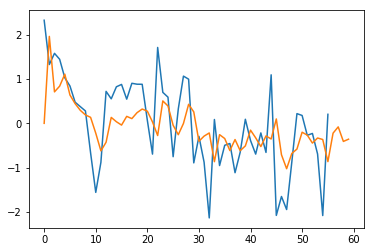

56 G01 Payables and Accruals
[0.79627101 0.73038103 0.4666375  0.2736961 ] $


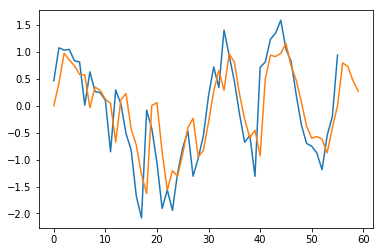

0 G02 Payables and Accruals
[0. 0. 0. 0.] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


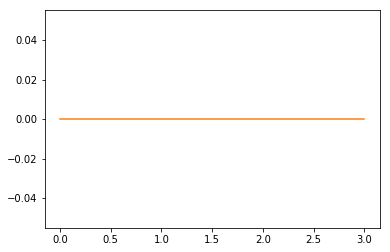

7 G03 Payables and Accruals
[-0.27171324 -0.31052942 -0.3493456  -0.38816177] $


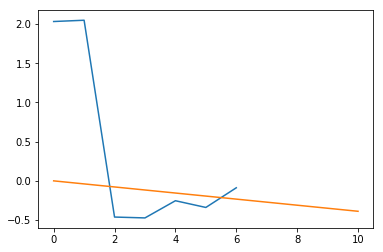

35 G04 Payables and Accruals
[-1.15094145 -0.98655327 -1.04033504 -1.49275258] $


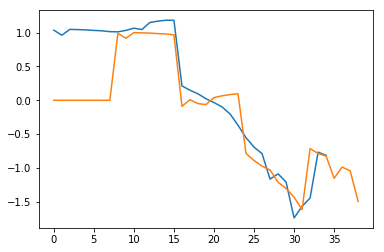

56 G05 Payables and Accruals
[-2.22372446 -2.33846763 -2.04641931 -1.26994449] $


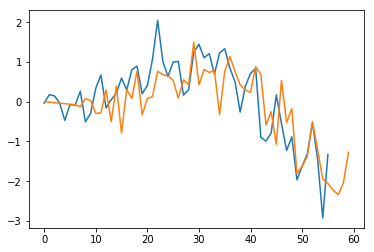

48 G06 Payables and Accruals
[-1.84072765 -1.8699595  -1.91604115 -2.14713942] $


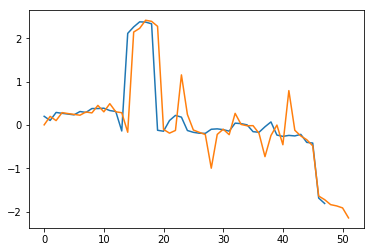

56 G08 Payables and Accruals
[ 0.2109835   0.12160609 -0.13731614 -0.0019127 ] $


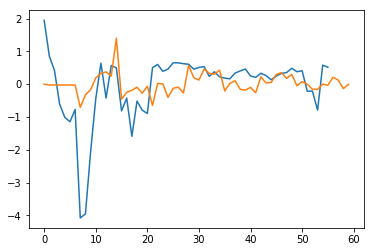

56 G10 Payables and Accruals
[-0.14980937 -0.20044753 -2.99103613 -3.09917431] $


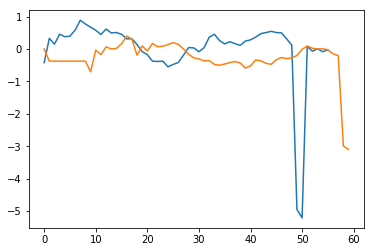

37 G11 Payables and Accruals
[-0.79455633 -0.80329369 -0.76307339 -0.81171811] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


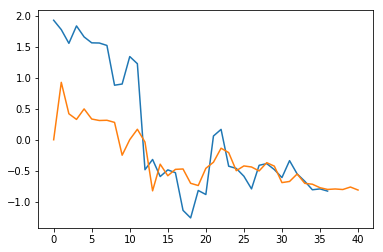

56 G12 Payables and Accruals
[0.35433705 0.21522249 0.32397115 0.59891014] $


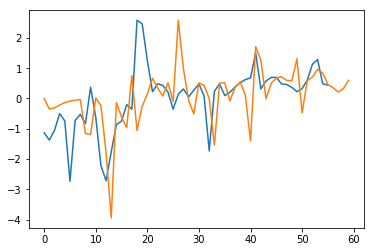

37 G13 Payables and Accruals


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


[1.7674257  1.92506588 2.14864893 2.37423989] $


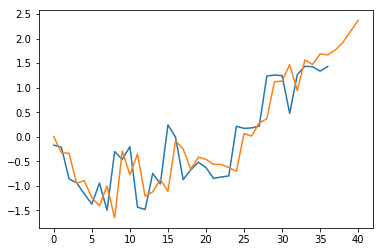

56 A01 Payables and Accruals
[-1.40493826 -1.21793139 -0.86108039 -1.3328222 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


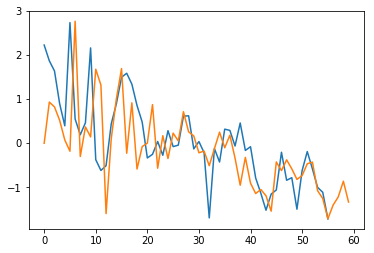

45 A02 Payables and Accruals
[-2.55314191 -3.1684805  -3.60891817 -4.42800165] $


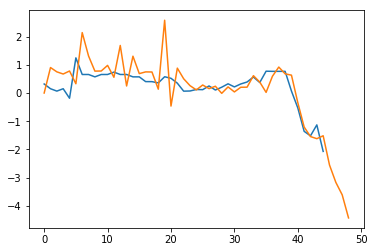

56 A03 Payables and Accruals
[-1.1053108  -0.86989142 -0.94375269 -0.92843394] $


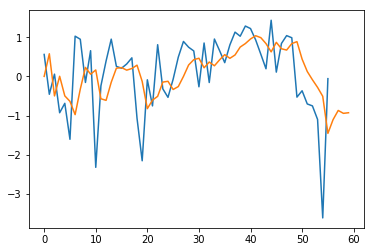

56 B01 Payables and Accruals
[-0.99217575 -0.57076396 -0.84108524 -0.43068088] $


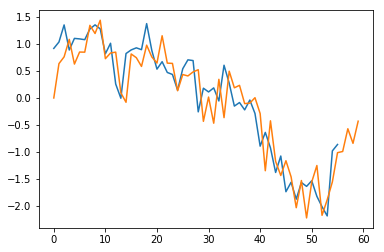

34 B02 Payables and Accruals
[-0.42855856 -0.47726239 -2.45415559 -0.09567749] $


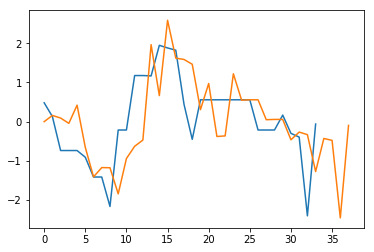

56 B03 Payables and Accruals
[-0.93257903 -0.92833877 -1.09752032 -0.23114142] $


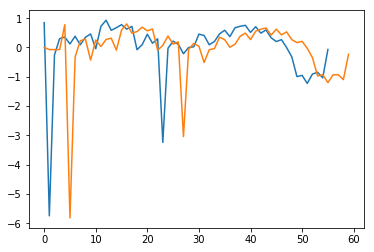

37 B04 Payables and Accruals
[0.70430099 0.80976131 0.78468994 0.97372169] $


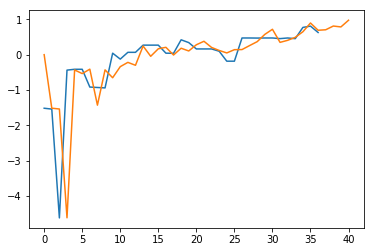

56 B05 Payables and Accruals
[ 0.2616209   0.33203907 -0.3910931  -0.43585631] $


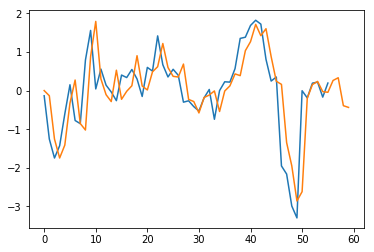

47 B07 Payables and Accruals
[0.88835096 0.79407421 0.66740823 0.51509578] $


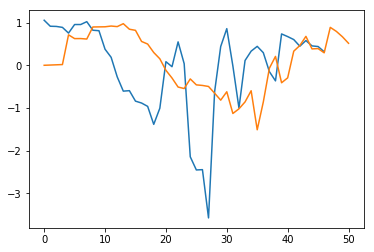

56 B08 Payables and Accruals
[-1.83275063 -1.93135764 -2.02943037 -2.12847295] $


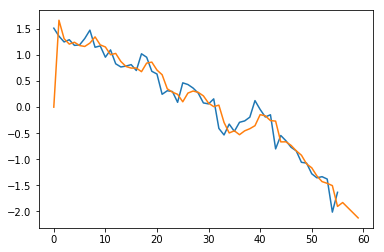

45 B09 Payables and Accruals
[-0.06726225 -0.09254865 -0.18420531 -0.48089589] $


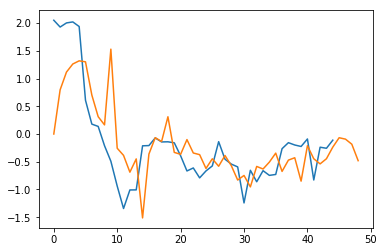

5 B11 Payables and Accruals
[-1.33190485 -1.59828581 -1.86466678 -2.13104775] $


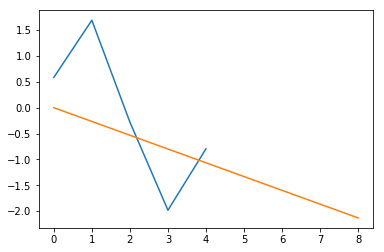

4 B12 Payables and Accruals
[0.18625091 0.23281364 0.27937637 0.3259391 ] $


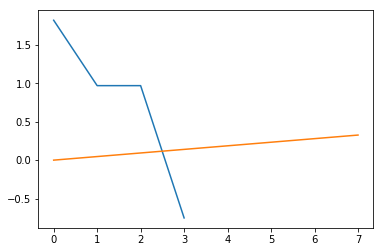

56 B13 Payables and Accruals
[-2.24649686 -2.14964652 -2.10756344 -2.07166264] $


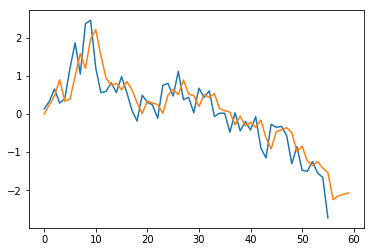

56 B15 Payables and Accruals
[0.4678497  0.21052278 0.23511099 0.15150889] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


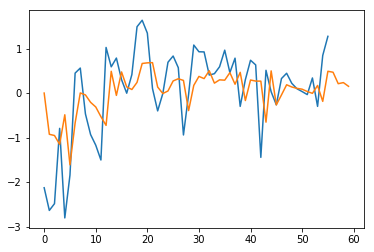

56 B16 Payables and Accruals
[0.96413192 1.33004724 1.72458023 2.28293504] $


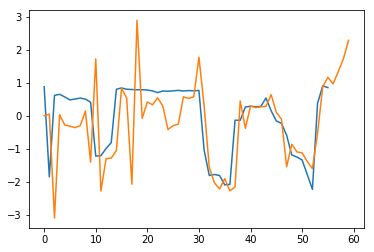

56 B17 Payables and Accruals
[-1.59489837 -1.79486716 -1.84513872 -1.98015086] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


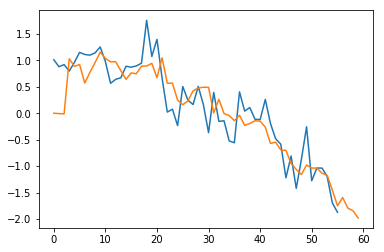

10 B18 Payables and Accruals
[0.15617376 0.15617376 0.15617376 0.15617376] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


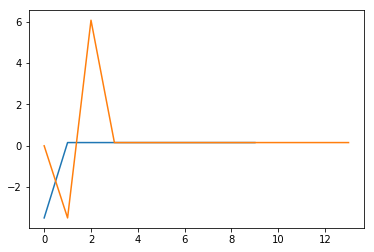

56 B19 Payables and Accruals
[-1.57609495 -1.82058536 -2.55144092 -2.92895623] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


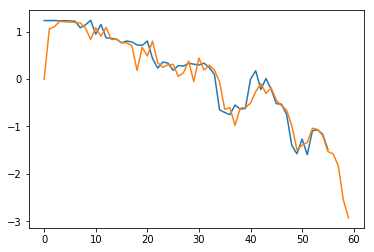

45 B20 Payables and Accruals
[-0.54174799 -0.63087808 -0.14411895 -0.17878574] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


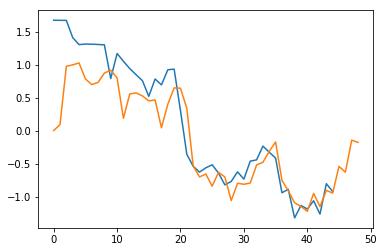

37 B21 Payables and Accruals
[0.33853882 0.41078392 0.14842489 0.08264658] $


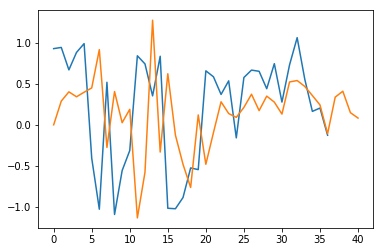

56 B22 Payables and Accruals
[-1.65031778 -1.7113003  -1.79735681 -1.82429885] $


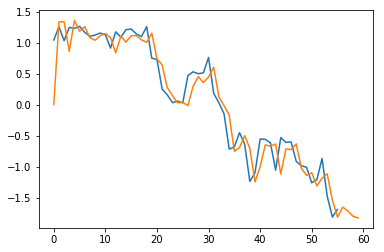

56 B23 Payables and Accruals
[-1.36503663 -1.25747348 -1.42493543 -1.4222728 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


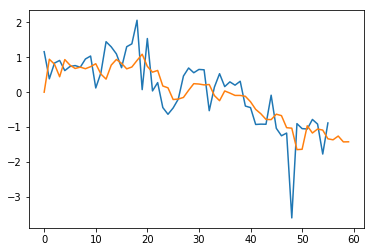

35 B24 Payables and Accruals
[-0.31690233 -0.35146931 -0.28436029 -0.25046406] $


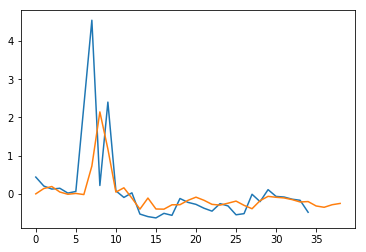

56 B25 Payables and Accruals
[-2.43911448 -2.61630588 -2.78908125 -2.98019095] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


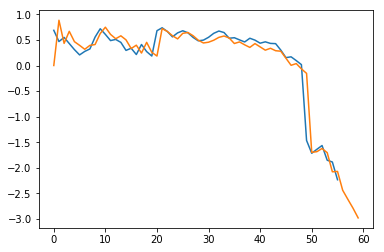

56 B27 Payables and Accruals
[-2.34465912 -3.04168566 -3.16353269 -2.99900061] $


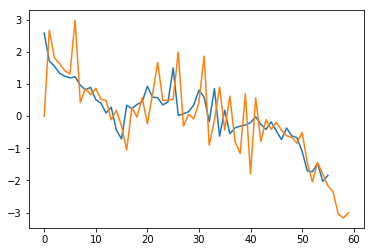

45 B28 Payables and Accruals
[1.2573505  2.39272437 3.62462643 4.95610926] $


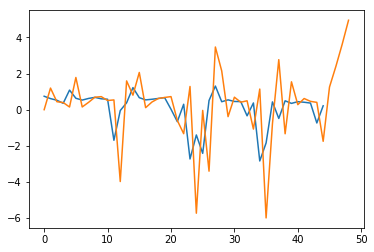

56 C02 Payables and Accruals
[0.3460002  0.38180832 0.14522438 0.10048454] $


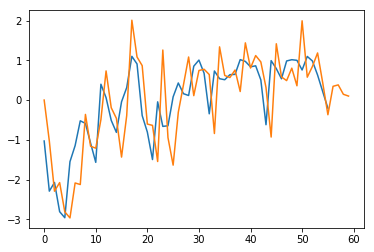

45 C03 Payables and Accruals
[0.5044365  0.52041212 0.49088864 0.53958038] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


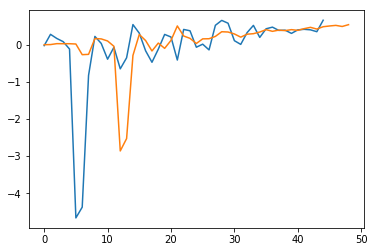

56 C04 Payables and Accruals
[-0.75763768 -0.86956651 -1.0698647  -1.05407973] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


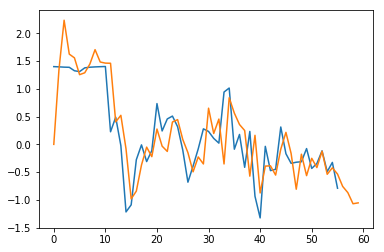

56 C06 Payables and Accruals
[0.51612733 0.63715311 0.74789564 0.60441593] $


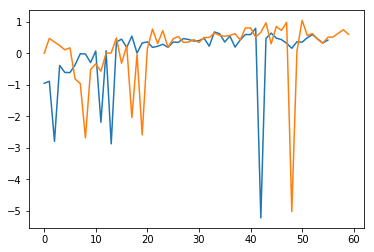

33 C08 Payables and Accruals
[0.9500894  0.738019   1.55641128 1.63436659] $


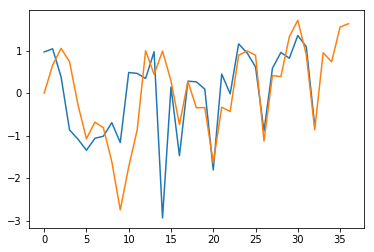

56 C09 Payables and Accruals
[-0.06549245  0.00585326 -0.01200105 -0.00118128] $


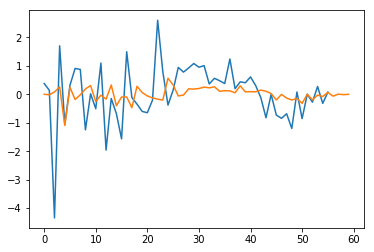

56 D04 Payables and Accruals
[0.73730393 0.75491581 0.7304676  0.54683899] $


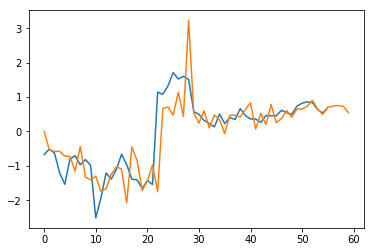

21 D05 Payables and Accruals
[-0.1928205  -1.1330081   0.32772922 -0.0427835 ] $


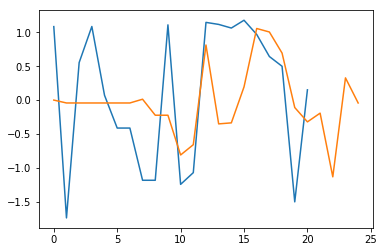

56 D06 Payables and Accruals
[-1.05380682 -1.46293461 -1.87280142 -1.28607813] $


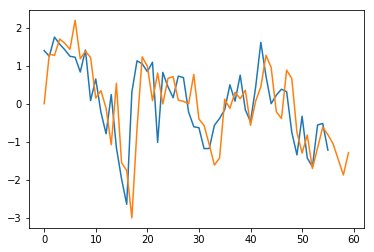

38 D07 Payables and Accruals
[-0.88772229 -1.1865699  -1.38891521 -1.76404252] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


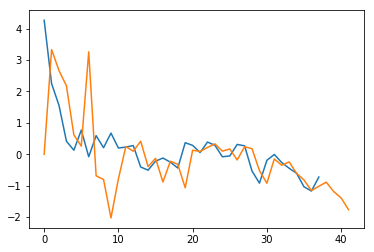

56 D10 Payables and Accruals
[-0.69633734 -0.64167921 -0.67833725 -0.28014753] $


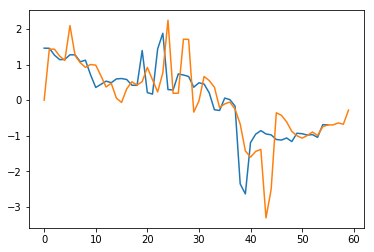

56 E09 Payables and Accruals
[-1.08507098 -0.10790237 -1.88712044 -1.34373982] $


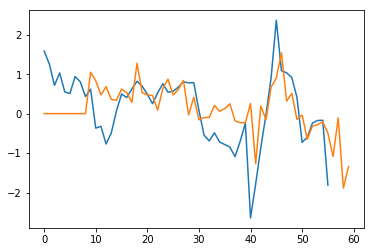

17 E10 Payables and Accruals
[1.08508787 1.28828053 1.57246591 1.87139427] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


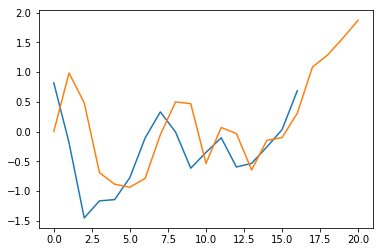

18 E11 Payables and Accruals
[ 0.37739188 -0.0510128  -0.0418602  -0.07024408] $


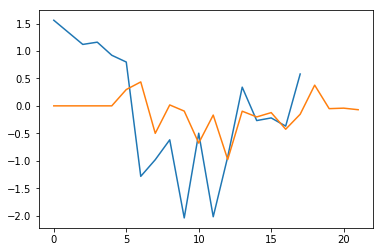

56 E12 Payables and Accruals
[1.01734964 0.57777486 1.29207694 0.95489379] $


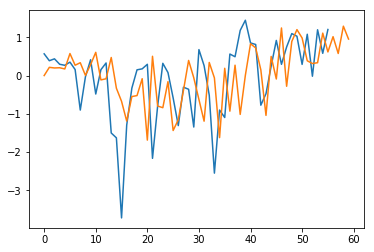

17 E13 Payables and Accruals
[0.39942081 0.94824103 1.87953787 1.72776794] $


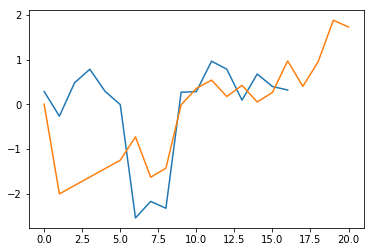

10 E15 Payables and Accruals
[0.21688611 0.00374561 0.68548122 0.74836509] $


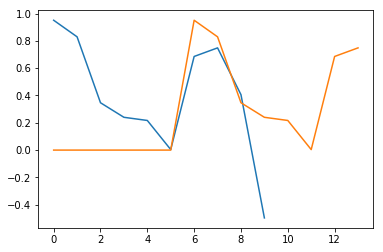

56 E16 Payables and Accruals
[-0.05087515 -0.24627725 -0.54390044  0.05073766] $


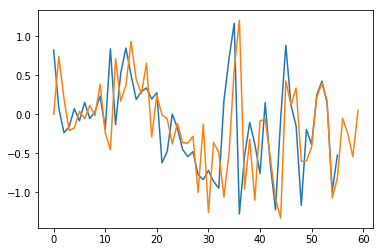

19 E17 Payables and Accruals
[-1.1948568  -0.51079952 -1.43870217 -0.74354891] $


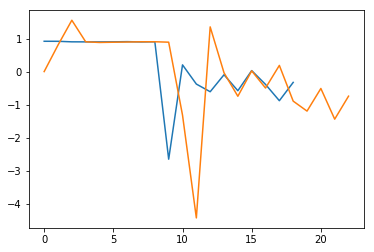

56 E18 Payables and Accruals
[-1.39139654 -1.50689645 -1.59412477 -1.46436927] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


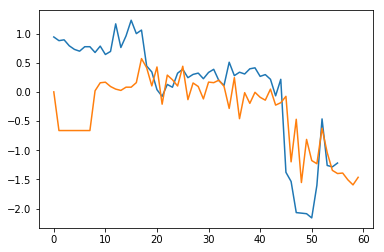

56 F02 Payables and Accruals
[-0.85882065 -1.0529724  -1.67587987 -1.70982239] $


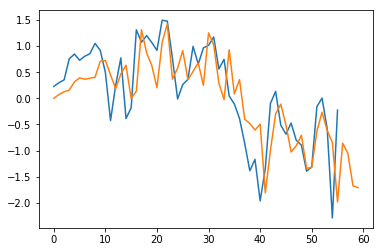

39 F03 Payables and Accruals
[0.16780151 0.18617419 0.11619149 0.06305238] $


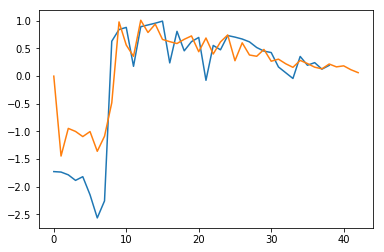

56 F04 Payables and Accruals
[-0.61472693 -0.21279215 -0.02193188  0.00750564] $


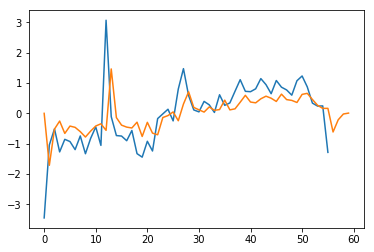

56 F05 Payables and Accruals
[-0.22242074 -0.08015987 -0.40939458 -0.35874887] $


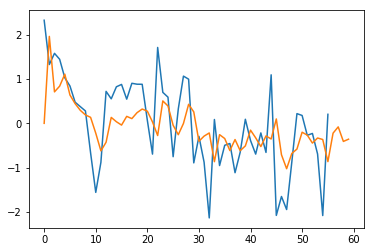

56 G01 Payables and Accruals
[0.79627101 0.73038103 0.4666375  0.2736961 ] $


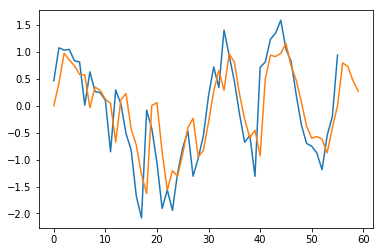

7 G03 Payables and Accruals
[-0.27171324 -0.31052942 -0.3493456  -0.38816177] $


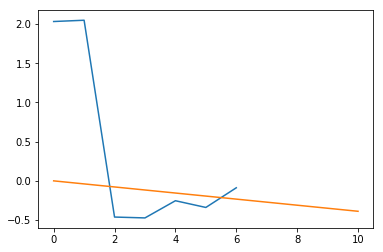

35 G04 Payables and Accruals
[-1.15094145 -0.98655327 -1.04033504 -1.49275258] $


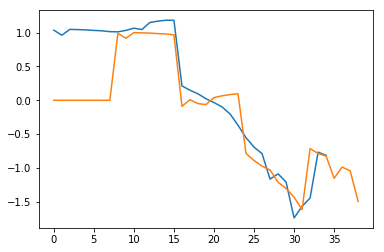

56 G05 Payables and Accruals
[-2.22372446 -2.33846763 -2.04641931 -1.26994449] $


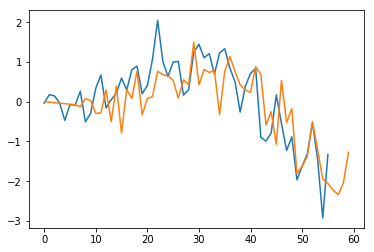

48 G06 Payables and Accruals
[-1.84072765 -1.8699595  -1.91604115 -2.14713942] $


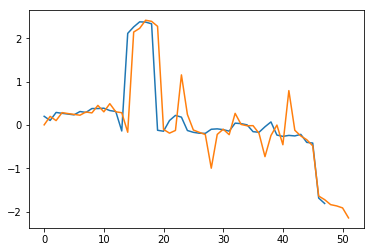

56 G08 Payables and Accruals
[ 0.2109835   0.12160609 -0.13731614 -0.0019127 ] $


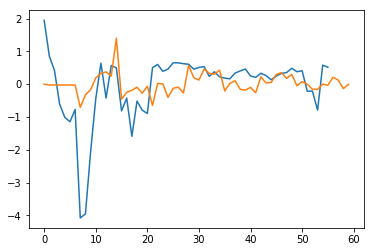

56 G10 Payables and Accruals
[-0.14980937 -0.20044753 -2.99103613 -3.09917431] $


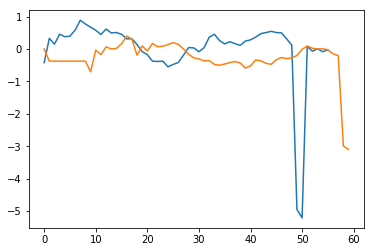

37 G11 Payables and Accruals
[-0.79455633 -0.80329369 -0.76307339 -0.81171811] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


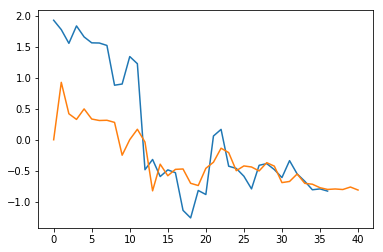

56 G12 Payables and Accruals
[0.35433705 0.21522249 0.32397115 0.59891014] $


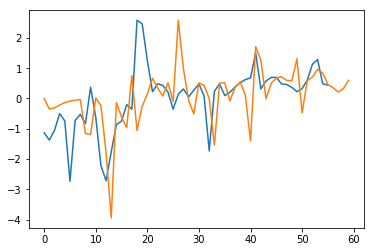

37 G13 Payables and Accruals
[1.7674257  1.92506588 2.14864893 2.37423989] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


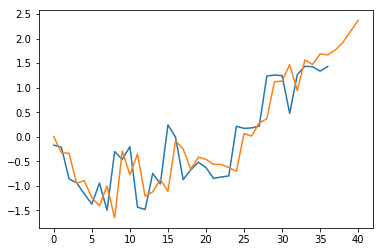

56 A01 Payables and Accruals
[-1.40493826 -1.21793139 -0.86108039 -1.3328222 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


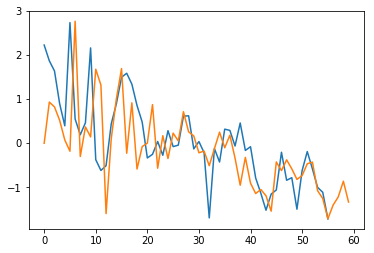

45 A02 Payables and Accruals
[-2.55314191 -3.1684805  -3.60891817 -4.42800165] $


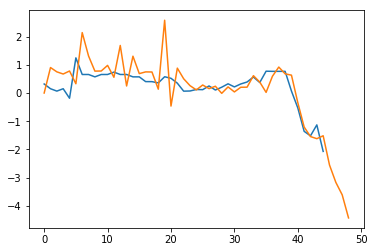

56 A03 Payables and Accruals
[-1.1053108  -0.86989142 -0.94375269 -0.92843394] $


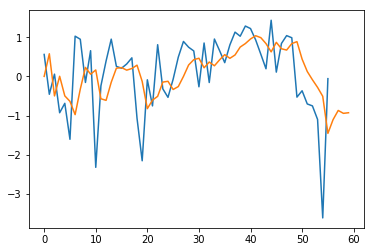

56 B01 Payables and Accruals
[-0.99217575 -0.57076396 -0.84108524 -0.43068088] $


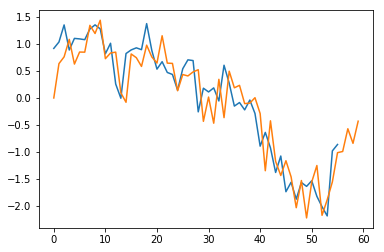

34 B02 Payables and Accruals
[-0.42855856 -0.47726239 -2.45415559 -0.09567749] $


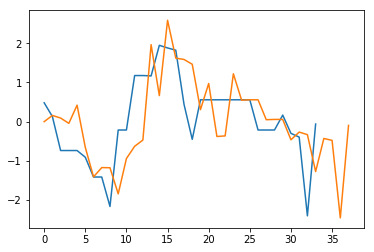

56 B03 Payables and Accruals
[-0.93257903 -0.92833877 -1.09752032 -0.23114142] $


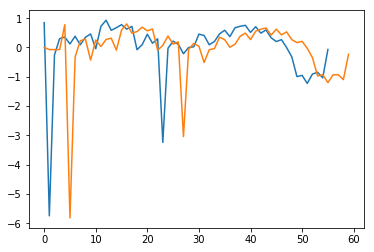

37 B04 Payables and Accruals
[0.70430099 0.80976131 0.78468994 0.97372169] $


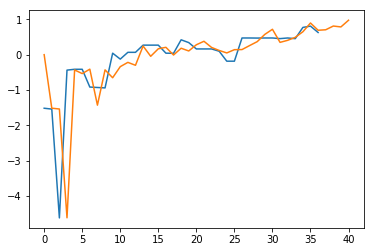

56 B05 Payables and Accruals
[ 0.2616209   0.33203907 -0.3910931  -0.43585631] $


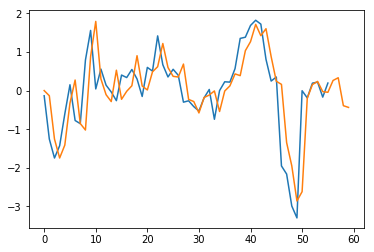

47 B07 Payables and Accruals
[0.88835096 0.79407421 0.66740823 0.51509578] $


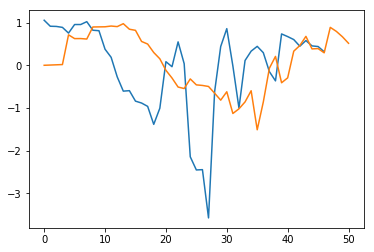

56 B08 Payables and Accruals
[-1.83275063 -1.93135764 -2.02943037 -2.12847295] $


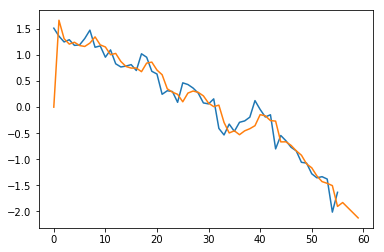

45 B09 Payables and Accruals
[-0.06726225 -0.09254865 -0.18420531 -0.48089589] $


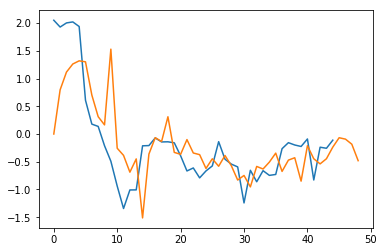

5 B11 Payables and Accruals
[-1.33190485 -1.59828581 -1.86466678 -2.13104775] $


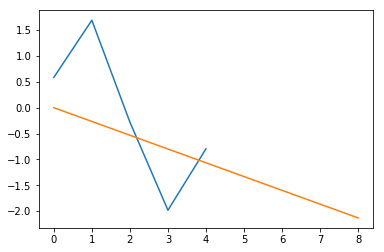

4 B12 Payables and Accruals
[0.18625091 0.23281364 0.27937637 0.3259391 ] $


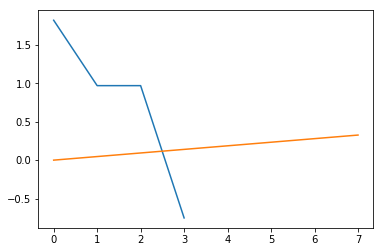

56 B13 Payables and Accruals
[-2.24649686 -2.14964652 -2.10756344 -2.07166264] $


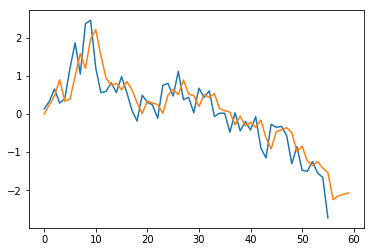

56 B15 Payables and Accruals
[0.4678497  0.21052278 0.23511099 0.15150889] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


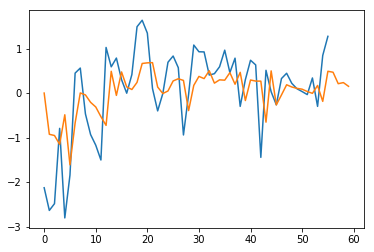

56 B16 Payables and Accruals
[0.96413192 1.33004724 1.72458023 2.28293504] $


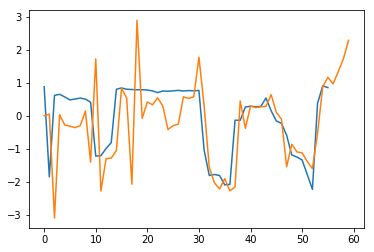

56 B17 Payables and Accruals
[-1.59489837 -1.79486716 -1.84513872 -1.98015086] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


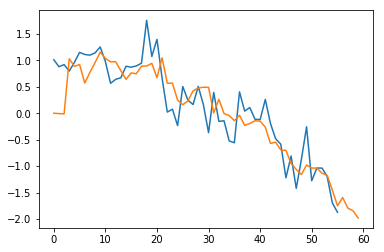

10 B18 Payables and Accruals
[0.15617376 0.15617376 0.15617376 0.15617376] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


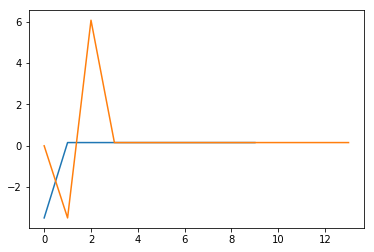

56 B19 Payables and Accruals
[-1.57609495 -1.82058536 -2.55144092 -2.92895623] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


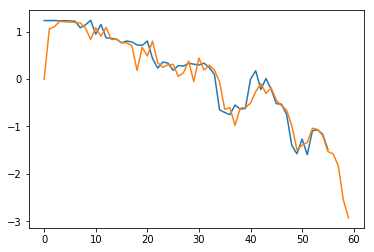

45 B20 Payables and Accruals
[-0.54174799 -0.63087808 -0.14411895 -0.17878574] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


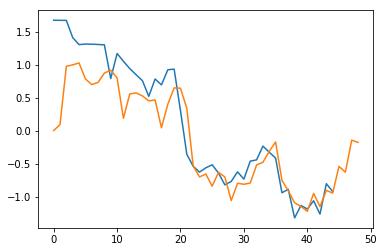

37 B21 Payables and Accruals
[0.33853882 0.41078392 0.14842489 0.08264658] $


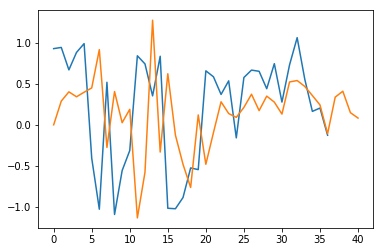

56 B22 Payables and Accruals
[-1.65031778 -1.7113003  -1.79735681 -1.82429885] $


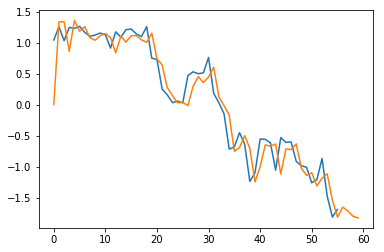

56 B23 Payables and Accruals
[-1.36503663 -1.25747348 -1.42493543 -1.4222728 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


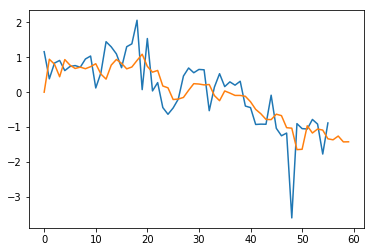

35 B24 Payables and Accruals
[-0.31690233 -0.35146931 -0.28436029 -0.25046406] $


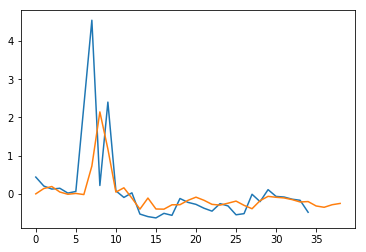

56 B25 Payables and Accruals
[-2.43911448 -2.61630588 -2.78908125 -2.98019095] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


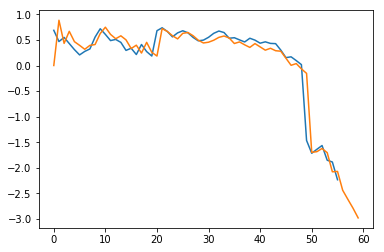

56 B27 Payables and Accruals
[-2.34465912 -3.04168566 -3.16353269 -2.99900061] $


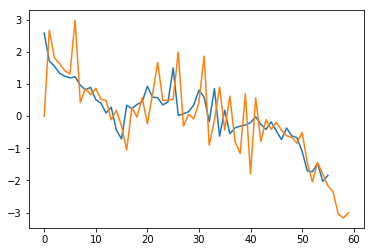

45 B28 Payables and Accruals
[1.2573505  2.39272437 3.62462643 4.95610926] $


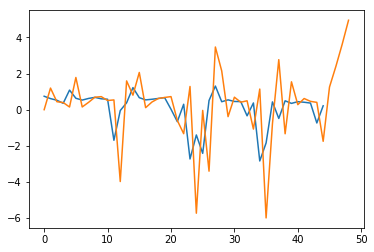

56 C02 Payables and Accruals
[0.3460002  0.38180832 0.14522438 0.10048454] $


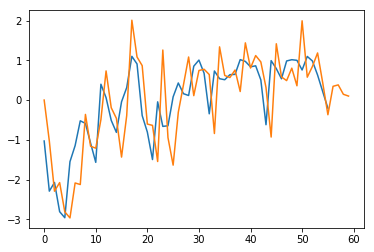

45 C03 Payables and Accruals
[0.5044365  0.52041212 0.49088864 0.53958038] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


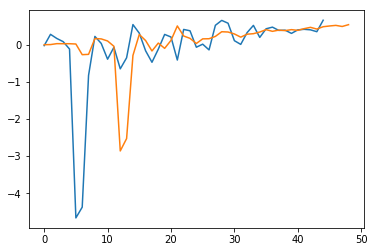

56 C04 Payables and Accruals
[-0.75763768 -0.86956651 -1.0698647  -1.05407973] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


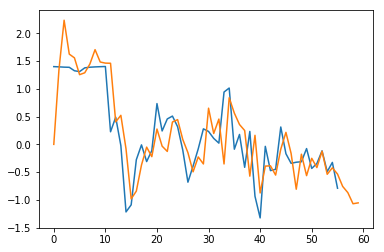

56 C06 Payables and Accruals
[0.51612733 0.63715311 0.74789564 0.60441593] $


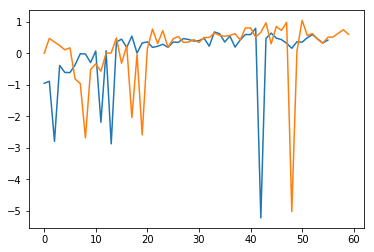

33 C08 Payables and Accruals
[0.9500894  0.738019   1.55641128 1.63436659] $


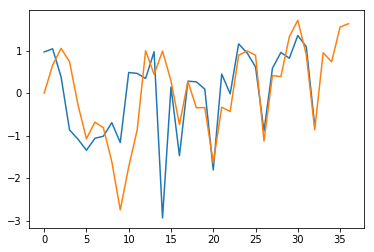

56 C09 Payables and Accruals
[-0.06549245  0.00585326 -0.01200105 -0.00118128] $


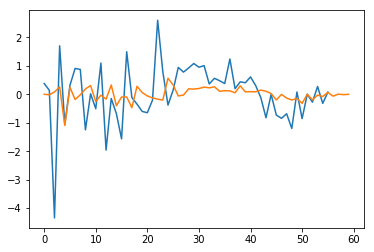

56 D04 Payables and Accruals
[0.73730393 0.75491581 0.7304676  0.54683899] $


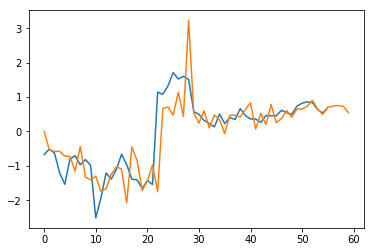

21 D05 Payables and Accruals
[-0.1928205  -1.1330081   0.32772922 -0.0427835 ] $


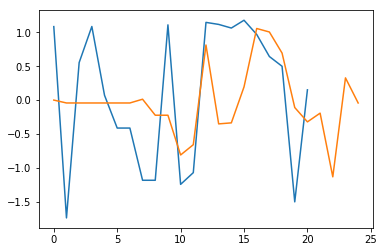

56 D06 Payables and Accruals
[-1.05380682 -1.46293461 -1.87280142 -1.28607813] $


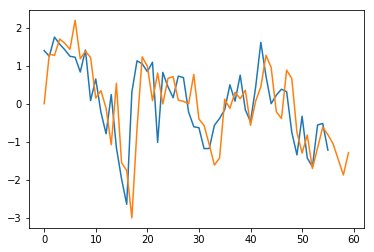

38 D07 Payables and Accruals
[-0.88772229 -1.1865699  -1.38891521 -1.76404252] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


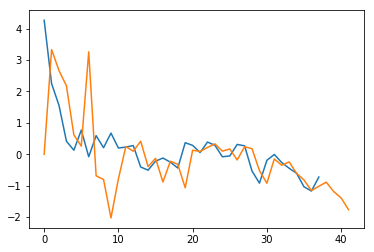

56 D10 Payables and Accruals
[-0.69633734 -0.64167921 -0.67833725 -0.28014753] $


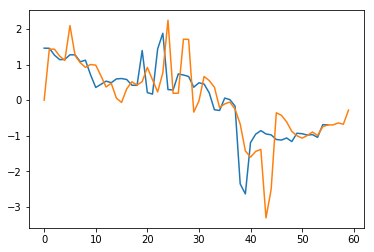

56 E09 Payables and Accruals
[-1.08507098 -0.10790237 -1.88712044 -1.34373982] $


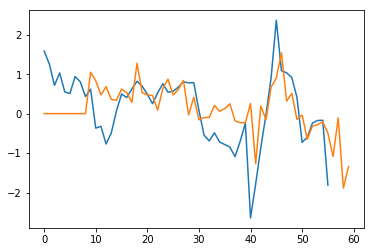

17 E10 Payables and Accruals
[1.08508787 1.28828053 1.57246591 1.87139427] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


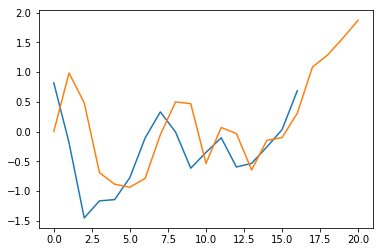

18 E11 Payables and Accruals
[ 0.37739188 -0.0510128  -0.0418602  -0.07024408] $


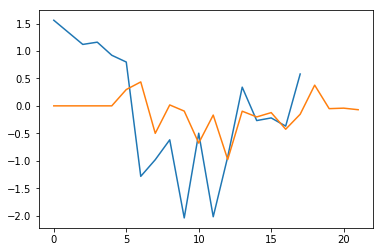

56 E12 Payables and Accruals
[1.01734964 0.57777486 1.29207694 0.95489379] $


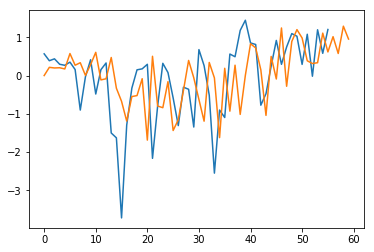

17 E13 Payables and Accruals
[0.39942081 0.94824103 1.87953787 1.72776794] $


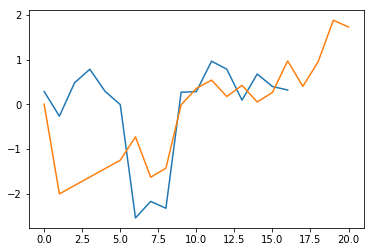

10 E15 Payables and Accruals
[0.21688611 0.00374561 0.68548122 0.74836509] $


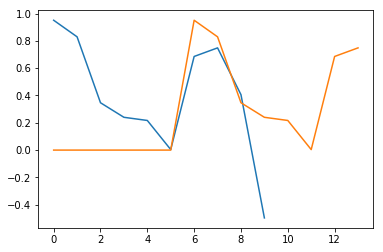

56 E16 Payables and Accruals
[-0.05087515 -0.24627725 -0.54390044  0.05073766] $


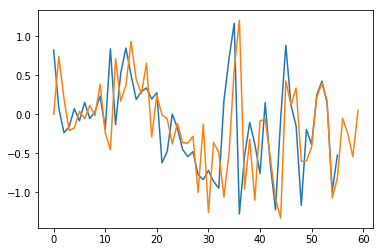

19 E17 Payables and Accruals
[-1.1948568  -0.51079952 -1.43870217 -0.74354891] $


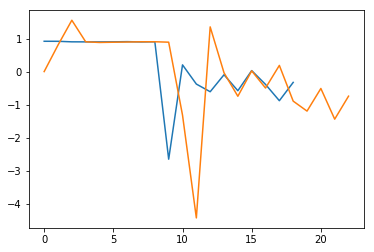

56 E18 Payables and Accruals
[-1.39139654 -1.50689645 -1.59412477 -1.46436927] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


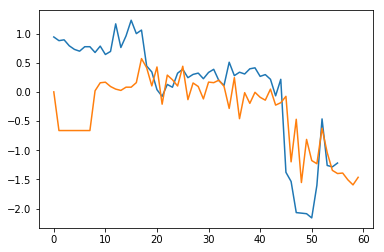

56 F02 Payables and Accruals
[-0.85882065 -1.0529724  -1.67587987 -1.70982239] $


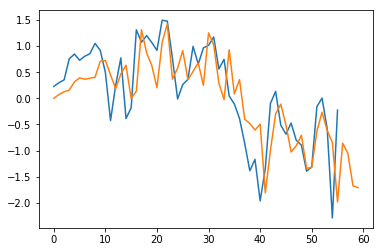

39 F03 Payables and Accruals
[0.16780151 0.18617419 0.11619149 0.06305238] $


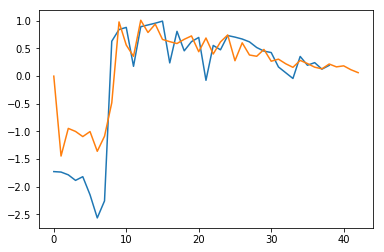

56 F04 Payables and Accruals
[-0.61472693 -0.21279215 -0.02193188  0.00750564] $


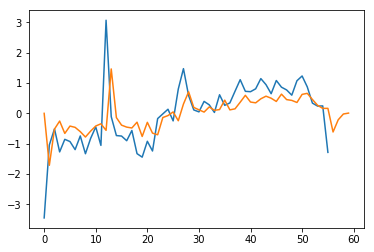

56 F05 Payables and Accruals
[-0.22242074 -0.08015987 -0.40939458 -0.35874887] $


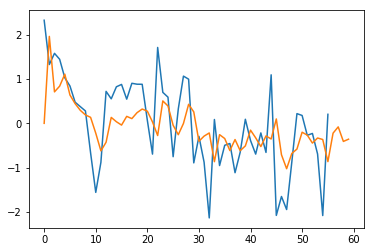

56 G01 Payables and Accruals
[0.79627101 0.73038103 0.4666375  0.2736961 ] $


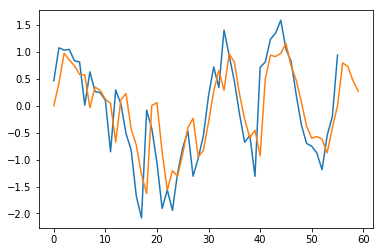

0 G02 Payables and Accruals
[0. 0. 0. 0.] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


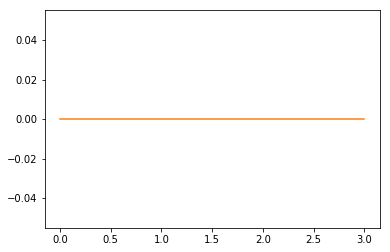

7 G03 Payables and Accruals
[-0.27171324 -0.31052942 -0.3493456  -0.38816177] $


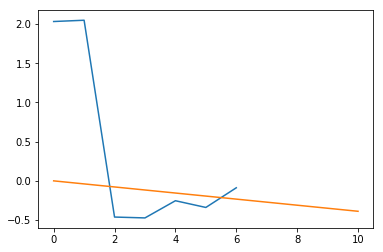

35 G04 Payables and Accruals
[-1.15094145 -0.98655327 -1.04033504 -1.49275258] $


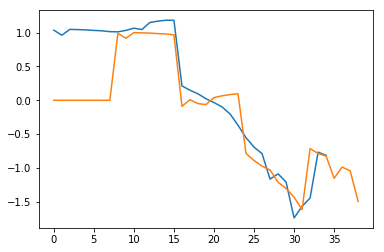

56 G05 Payables and Accruals
[-2.22372446 -2.33846763 -2.04641931 -1.26994449] $


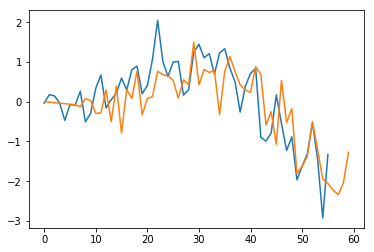

48 G06 Payables and Accruals
[-1.84072765 -1.8699595  -1.91604115 -2.14713942] $


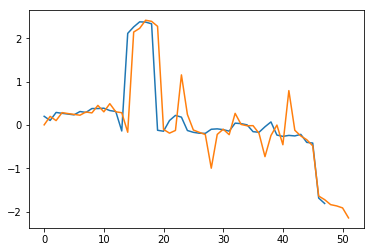

56 G08 Payables and Accruals
[ 0.2109835   0.12160609 -0.13731614 -0.0019127 ] $


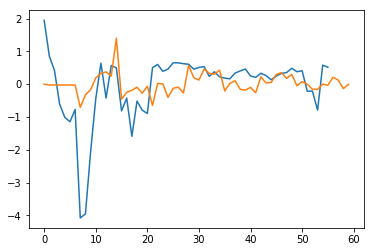

56 G10 Payables and Accruals
[-0.14980937 -0.20044753 -2.99103613 -3.09917431] $


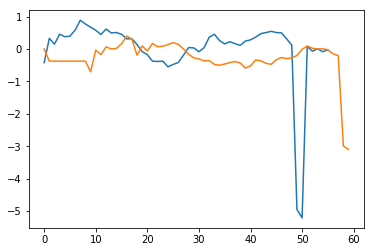

37 G11 Payables and Accruals


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


[-0.79455633 -0.80329369 -0.76307339 -0.81171811] $


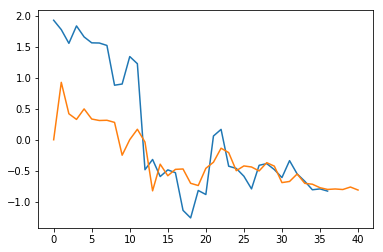

56 G12 Payables and Accruals
[0.35433705 0.21522249 0.32397115 0.59891014] $


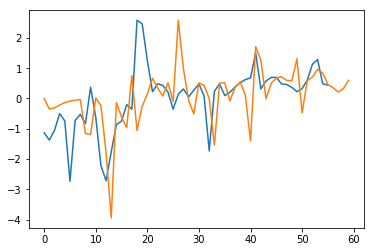

37 G13 Payables and Accruals
[1.7674257  1.92506588 2.14864893 2.37423989] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


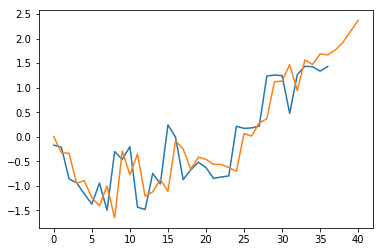

56 A01 Payables and Accruals
[-1.40493826 -1.21793139 -0.86108039 -1.3328222 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


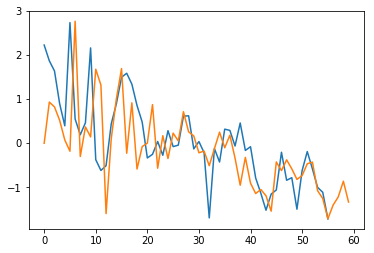

45 A02 Payables and Accruals
[-2.55314191 -3.1684805  -3.60891817 -4.42800165] $


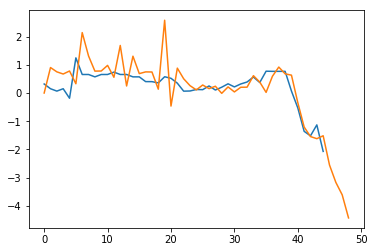

56 A03 Payables and Accruals
[-1.1053108  -0.86989142 -0.94375269 -0.92843394] $


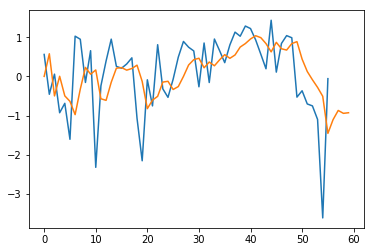

56 B01 Payables and Accruals
[-0.99217575 -0.57076396 -0.84108524 -0.43068088] $


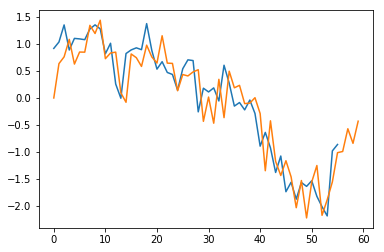

34 B02 Payables and Accruals
[-0.42855856 -0.47726239 -2.45415559 -0.09567749] $


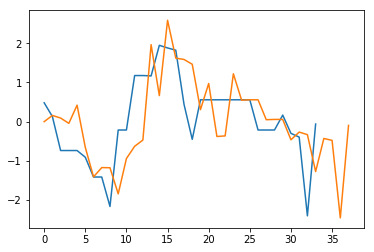

56 B03 Payables and Accruals
[-0.93257903 -0.92833877 -1.09752032 -0.23114142] $


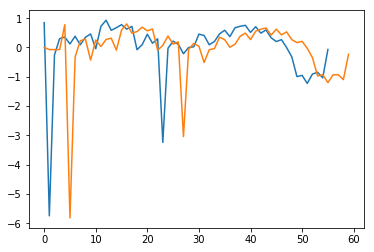

37 B04 Payables and Accruals
[0.70430099 0.80976131 0.78468994 0.97372169] $


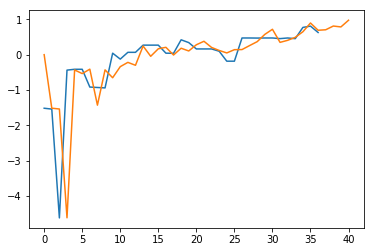

56 B05 Payables and Accruals
[ 0.2616209   0.33203907 -0.3910931  -0.43585631] $


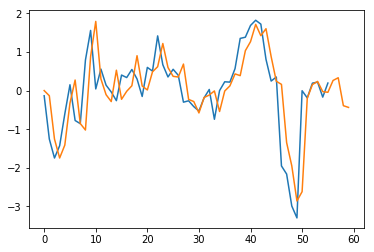

47 B07 Payables and Accruals
[0.88835096 0.79407421 0.66740823 0.51509578] $


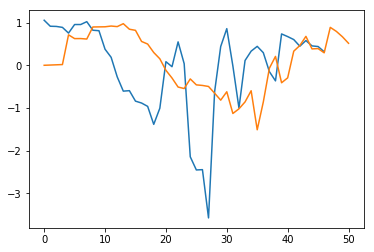

56 B08 Payables and Accruals
[-1.83275063 -1.93135764 -2.02943037 -2.12847295] $


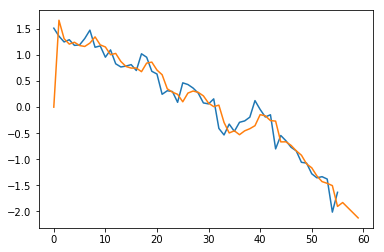

45 B09 Payables and Accruals
[-0.06726225 -0.09254865 -0.18420531 -0.48089589] $


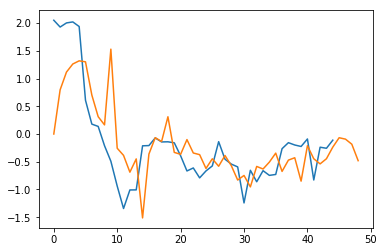

5 B11 Payables and Accruals
[-1.33190485 -1.59828581 -1.86466678 -2.13104775] $


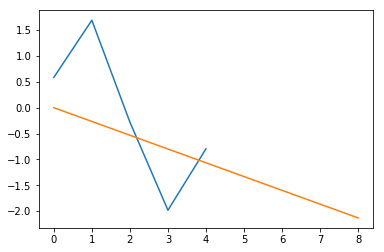

4 B12 Payables and Accruals
[0.18625091 0.23281364 0.27937637 0.3259391 ] $


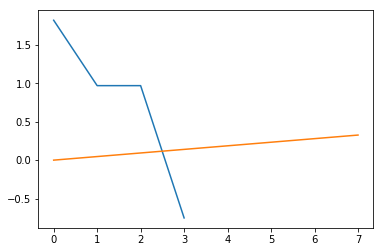

56 B13 Payables and Accruals
[-2.24649686 -2.14964652 -2.10756344 -2.07166264] $


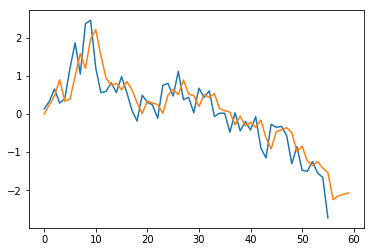

56 B15 Payables and Accruals
[0.4678497  0.21052278 0.23511099 0.15150889] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


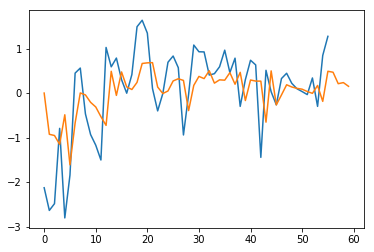

56 B16 Payables and Accruals
[0.96413192 1.33004724 1.72458023 2.28293504] $


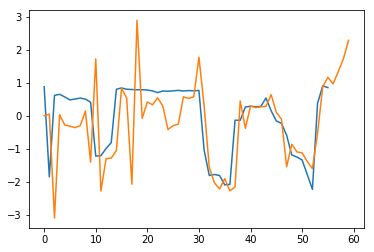

56 B17 Payables and Accruals
[-1.59489837 -1.79486716 -1.84513872 -1.98015086] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


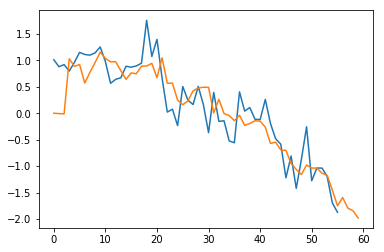

10 B18 Payables and Accruals
[0.15617376 0.15617376 0.15617376 0.15617376] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


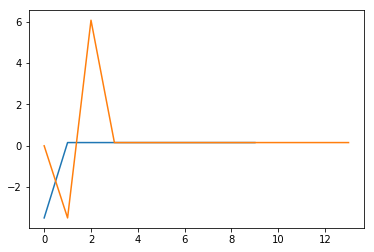

56 B19 Payables and Accruals
[-1.57609495 -1.82058536 -2.55144092 -2.92895623] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


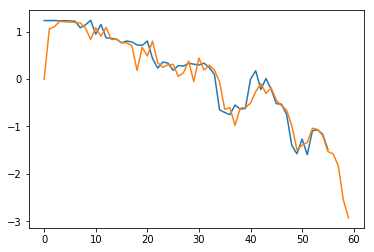

45 B20 Payables and Accruals
[-0.54174799 -0.63087808 -0.14411895 -0.17878574] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


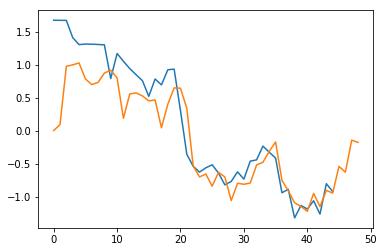

37 B21 Payables and Accruals
[0.33853882 0.41078392 0.14842489 0.08264658] $


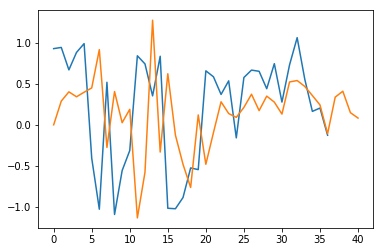

56 B22 Payables and Accruals
[-1.65031778 -1.7113003  -1.79735681 -1.82429885] $


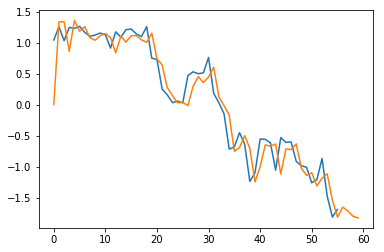

56 B23 Payables and Accruals
[-1.36503663 -1.25747348 -1.42493543 -1.4222728 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


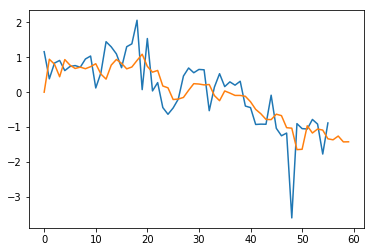

35 B24 Payables and Accruals
[-0.31690233 -0.35146931 -0.28436029 -0.25046406] $


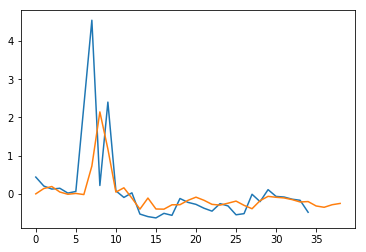

56 B25 Payables and Accruals
[-2.43911448 -2.61630588 -2.78908125 -2.98019095] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


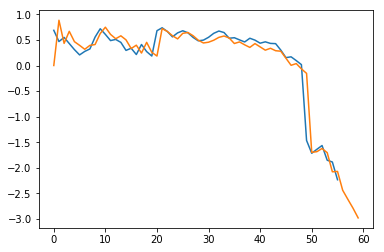

56 B27 Payables and Accruals
[-2.34465912 -3.04168566 -3.16353269 -2.99900061] $


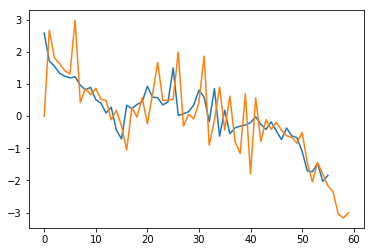

45 B28 Payables and Accruals
[1.2573505  2.39272437 3.62462643 4.95610926] $


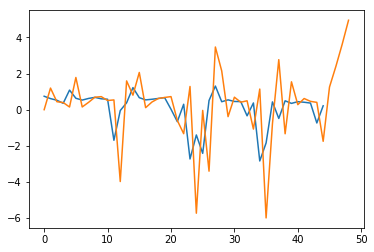

56 C02 Payables and Accruals
[0.3460002  0.38180832 0.14522438 0.10048454] $


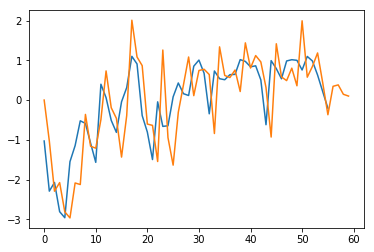

45 C03 Payables and Accruals
[0.5044365  0.52041212 0.49088864 0.53958038] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


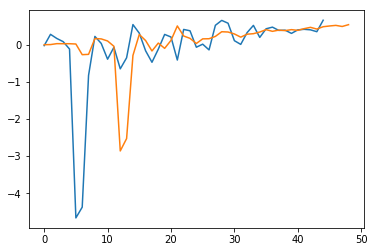

56 C04 Payables and Accruals
[-0.75763768 -0.86956651 -1.0698647  -1.05407973] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


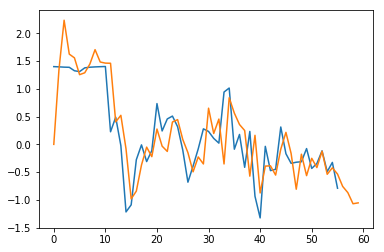

56 C06 Payables and Accruals
[0.51612733 0.63715311 0.74789564 0.60441593] $


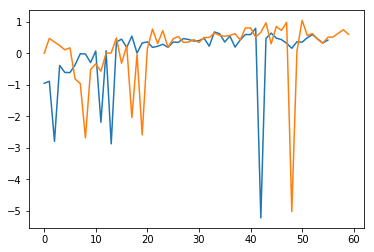

33 C08 Payables and Accruals
[0.9500894  0.738019   1.55641128 1.63436659] $


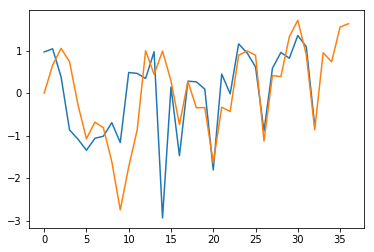

56 C09 Payables and Accruals
[-0.06549245  0.00585326 -0.01200105 -0.00118128] $


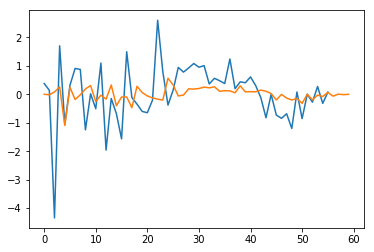

56 D04 Payables and Accruals
[0.73730393 0.75491581 0.7304676  0.54683899] $


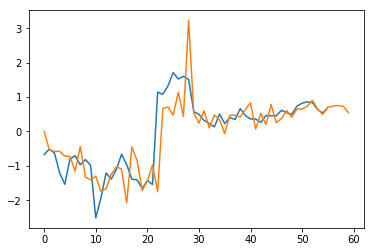

21 D05 Payables and Accruals
[-0.1928205  -1.1330081   0.32772922 -0.0427835 ] $


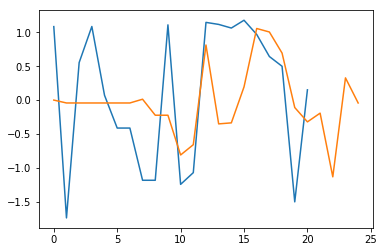

56 D06 Payables and Accruals
[-1.05380682 -1.46293461 -1.87280142 -1.28607813] $


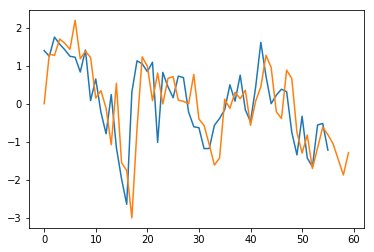

38 D07 Payables and Accruals
[-0.88772229 -1.1865699  -1.38891521 -1.76404252] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


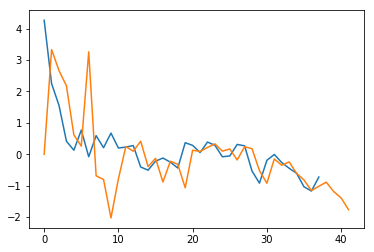

56 D10 Payables and Accruals
[-0.69633734 -0.64167921 -0.67833725 -0.28014753] $


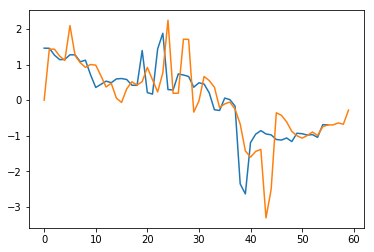

56 E09 Payables and Accruals
[-1.08507098 -0.10790237 -1.88712044 -1.34373982] $


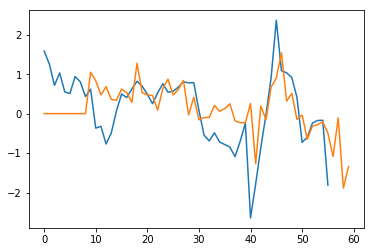

17 E10 Payables and Accruals
[1.08508787 1.28828053 1.57246591 1.87139427] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


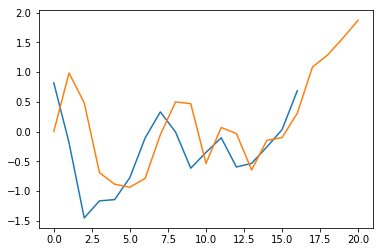

18 E11 Payables and Accruals
[ 0.37739188 -0.0510128  -0.0418602  -0.07024408] $


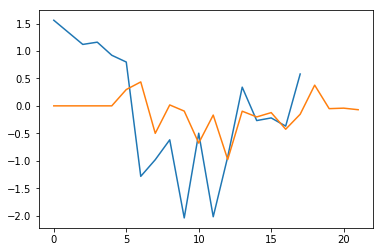

56 E12 Payables and Accruals
[1.01734964 0.57777486 1.29207694 0.95489379] $


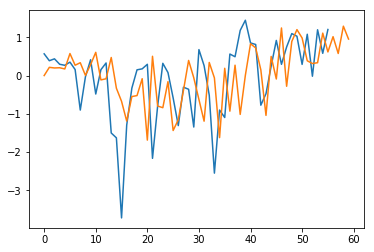

17 E13 Payables and Accruals
[0.39942081 0.94824103 1.87953787 1.72776794] $


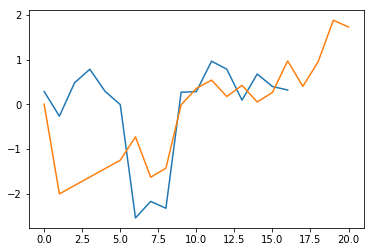

10 E15 Payables and Accruals
[0.21688611 0.00374561 0.68548122 0.74836509] $


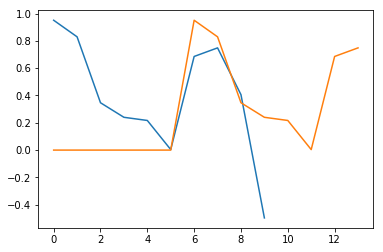

56 E16 Payables and Accruals
[-0.05087515 -0.24627725 -0.54390044  0.05073766] $


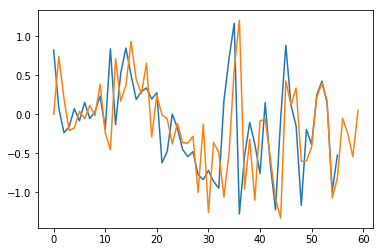

19 E17 Payables and Accruals
[-1.1948568  -0.51079952 -1.43870217 -0.74354891] $


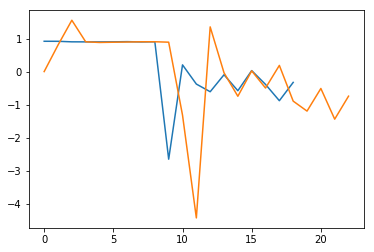

56 E18 Payables and Accruals
[-1.39139654 -1.50689645 -1.59412477 -1.46436927] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


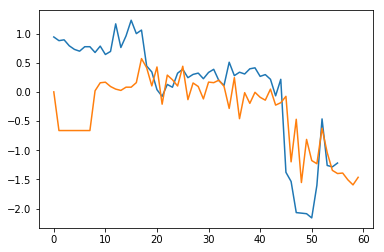

56 F02 Payables and Accruals
[-0.85882065 -1.0529724  -1.67587987 -1.70982239] $


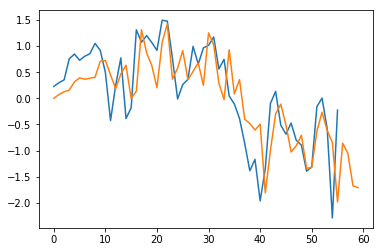

39 F03 Payables and Accruals
[0.16780151 0.18617419 0.11619149 0.06305238] $


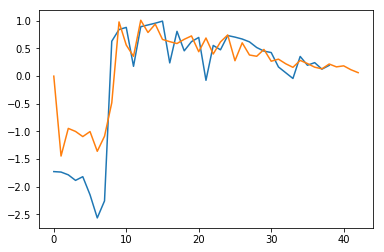

56 F04 Payables and Accruals
[-0.61472693 -0.21279215 -0.02193188  0.00750564] $


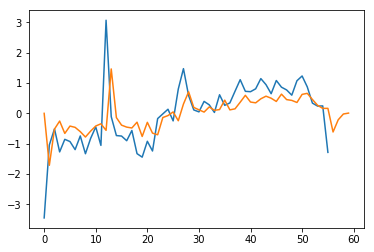

56 F05 Payables and Accruals
[-0.22242074 -0.08015987 -0.40939458 -0.35874887] $


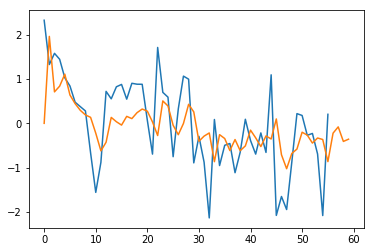

56 G01 Payables and Accruals
[0.79627101 0.73038103 0.4666375  0.2736961 ] $


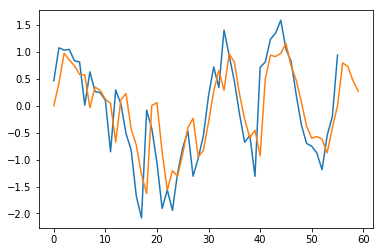

0 G02 Payables and Accruals
[0. 0. 0. 0.] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


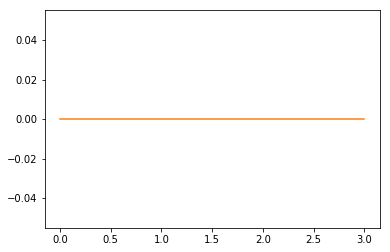

7 G03 Payables and Accruals
[-0.27171324 -0.31052942 -0.3493456  -0.38816177] $


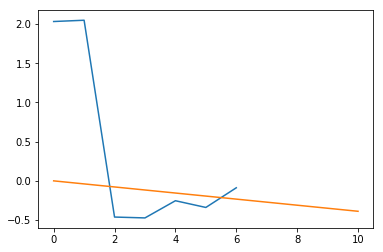

35 G04 Payables and Accruals
[-1.15094145 -0.98655327 -1.04033504 -1.49275258] $


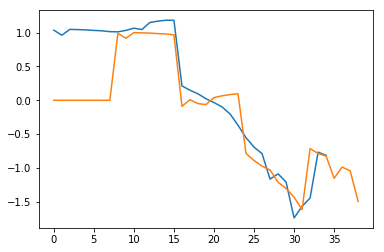

56 G05 Payables and Accruals
[-2.22372446 -2.33846763 -2.04641931 -1.26994449] $


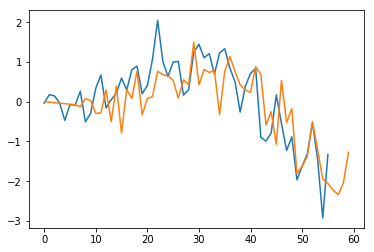

48 G06 Payables and Accruals
[-1.84072765 -1.8699595  -1.91604115 -2.14713942] $


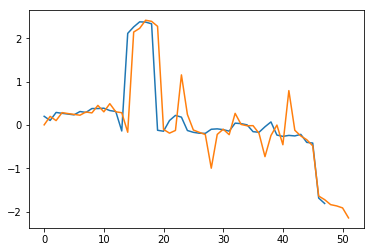

56 G08 Payables and Accruals
[ 0.2109835   0.12160609 -0.13731614 -0.0019127 ] $


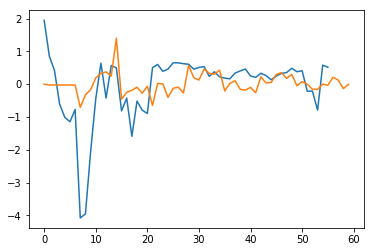

56 G10 Payables and Accruals
[-0.14980937 -0.20044753 -2.99103613 -3.09917431] $


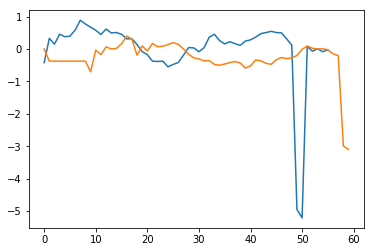

37 G11 Payables and Accruals
[-0.79455633 -0.80329369 -0.76307339 -0.81171811] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


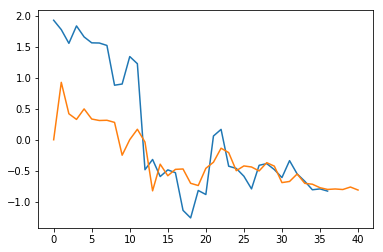

56 G12 Payables and Accruals
[0.35433705 0.21522249 0.32397115 0.59891014] $


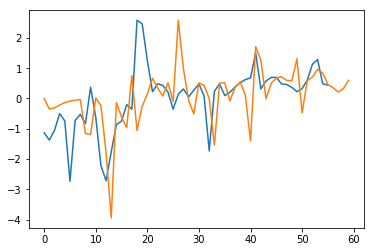

37 G13 Payables and Accruals
[1.7674257  1.92506588 2.14864893 2.37423989] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


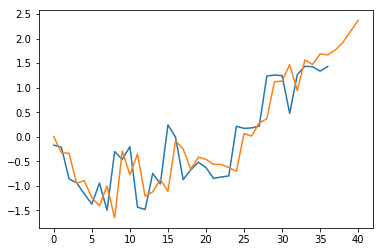

56 A01 Receivables
[ 0.26191372 -0.02752054  0.10676913  0.07430298] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


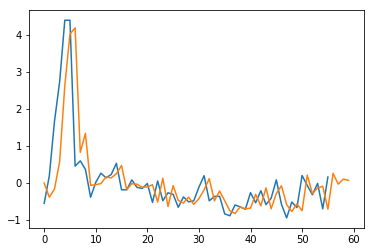

56 A03 Receivables
[2.22285468 2.38906717 2.559983   2.73568326] $


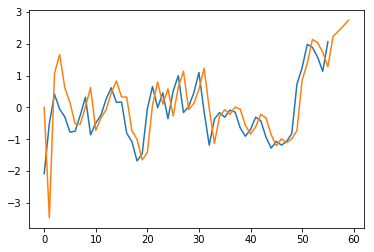

56 B01 Receivables
[2.3800498  3.0066198  3.44320259 3.45680816] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


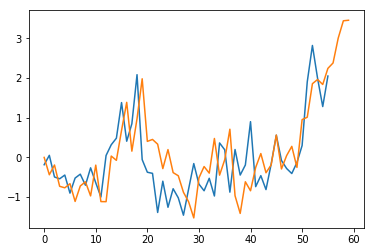

35 B03 Receivables
[  0.65116573 -21.15658784 -20.54547229 -19.10869022] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


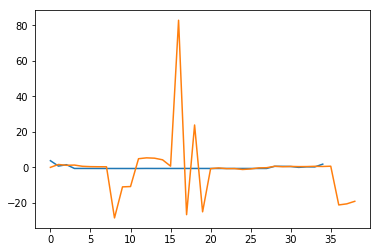

56 B05 Receivables
[0.49455054 0.49626835 0.4942119  0.49029848] $


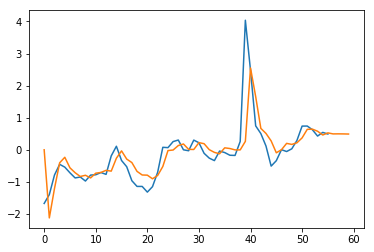

49 B07 Receivables
[ 1.07996799  0.40375605  0.63735743 -0.24685165] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


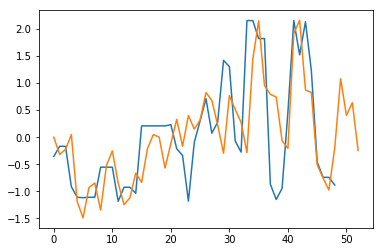

56 B08 Receivables
[-0.99662994 -0.97187217 -0.95272553 -0.93622436] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


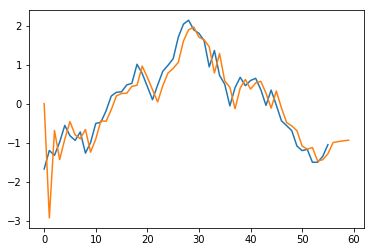

5 B11 Receivables
[-1.38354378 -1.66025254 -1.9369613  -2.21367005] $


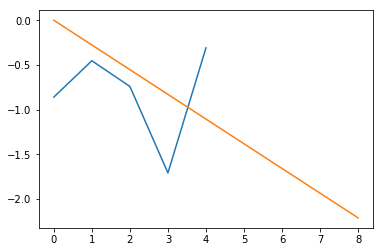

47 B13 Receivables
[-2.95428499 -5.25394387 -7.39573896 -9.14623765] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


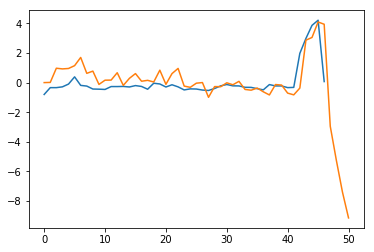

56 B15 Receivables
[-0.26095039 -0.25324386 -0.24556788 -0.23783051] $


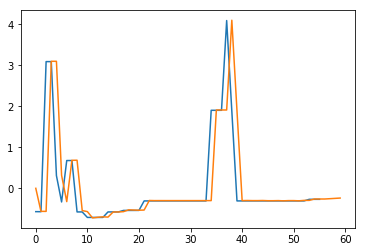

27 B17 Receivables
[-0.34404943 -0.52450923 -0.45954825 -0.51725245] $


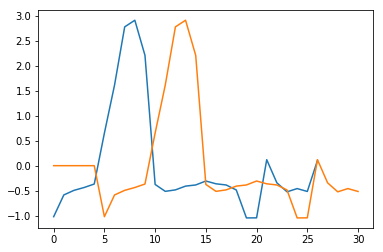

1 B19 Receivables
-1
56 B23 Receivables
[-1.34734788 -0.96828585 -0.70136081 -0.62037309] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


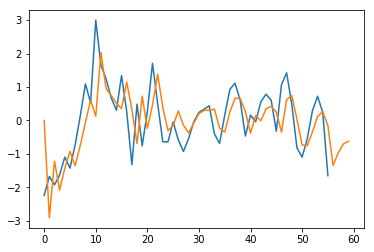

56 B25 Receivables
[2.71334889 2.69297584 2.67370476 2.67186547] $


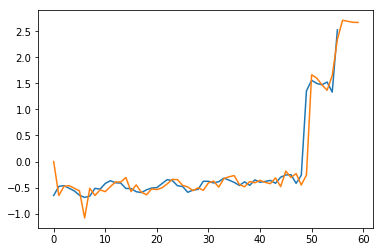

56 B27 Receivables
[1.12465114 1.1173393  1.10743523 1.09493893] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


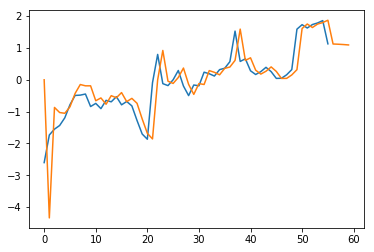

56 C02 Receivables
[1.53370429 1.11628063 1.03829534 1.13724421] $


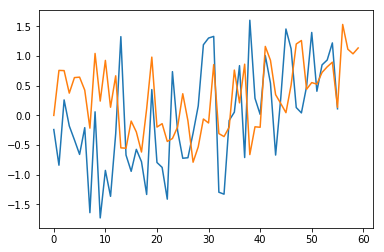

8 C04 Receivables
[0.26663171 0.26663171 0.26663171 0.26663171] $


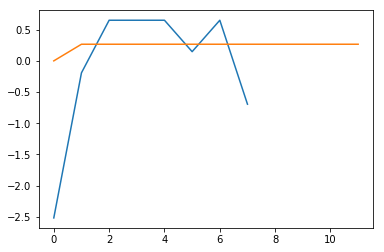

56 C06 Receivables
[0.66676714 0.79374076 0.70395452 0.69077838] $


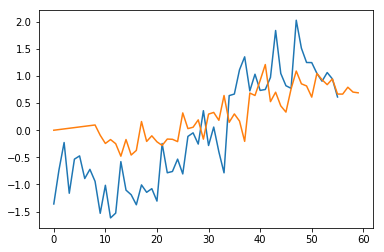

56 D04 Receivables
[-0.5589263  -0.8117217  -1.17317691 -1.56719597] $


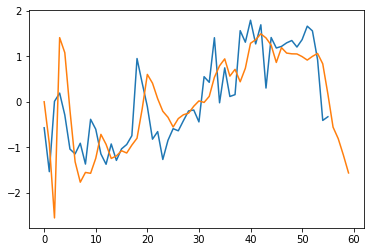

34 E02 Receivables
[0.39613859 1.18022598 1.71008084 2.74090733] $


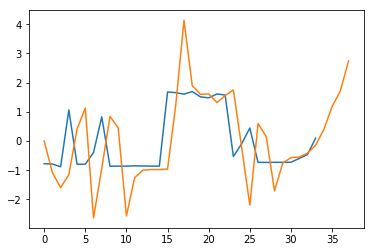

56 E09 Receivables
[1.20172241 1.33694535 1.4613121  1.40732728] $


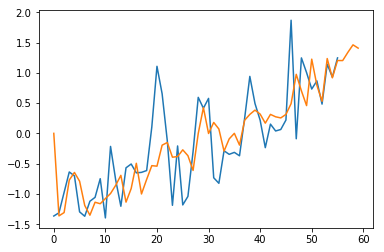

56 E12 Receivables
[1.88335166 1.7876055  1.55349418 1.82336356] $


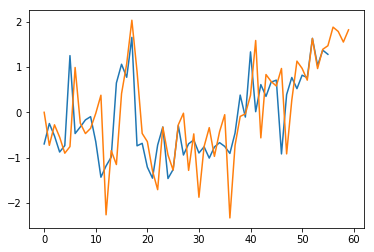

56 E16 Receivables
[0.26377522 0.07073068 0.19465608 0.07001732] $


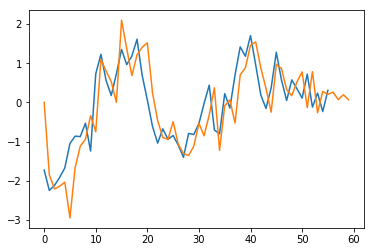

56 F02 Receivables
[-0.68816425 -0.70669483 -0.74075016 -0.77236831] $


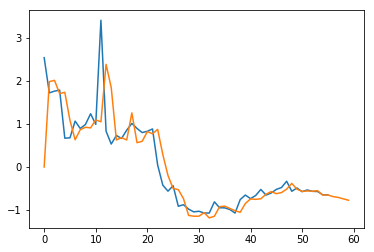

18 F04 Receivables
[0.20919996 0.23144851 0.24703814 0.25793683] $


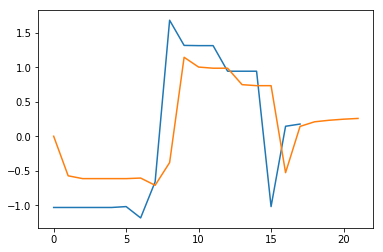

56 G01 Receivables
[-1.69940111 -1.93810579 -2.16796555 -2.41415592] $


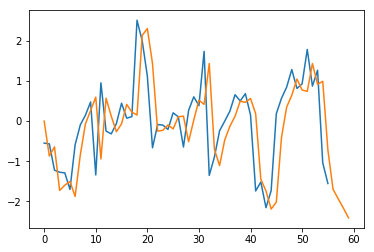

5 G03 Receivables
[-0.76952328 -0.92342794 -1.0773326  -1.23123725] $


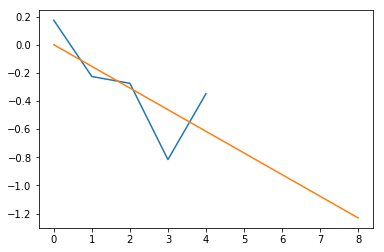

1 G05 Receivables
-1
48 G08 Receivables
[-0.14838505 -0.19147816 -0.23443739 -0.27620954] $


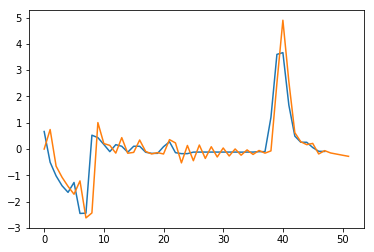

56 G10 Receivables
[-0.00143663 -0.02639577  0.00395697  0.01914351] $


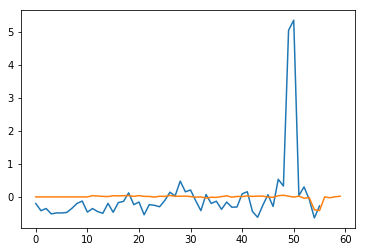

56 G12 Receivables
[2.61886838 1.88827487 2.75588206 2.56144307] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


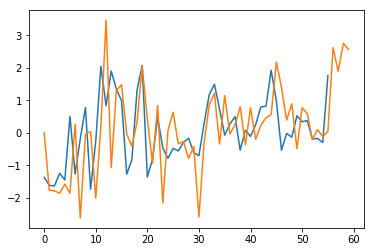

56 A01 Receivables
[ 0.26191372 -0.02752054  0.10676913  0.07430298] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


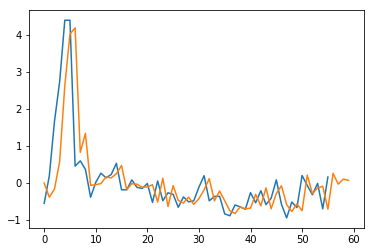

56 A03 Receivables
[2.22285468 2.38906717 2.559983   2.73568326] $


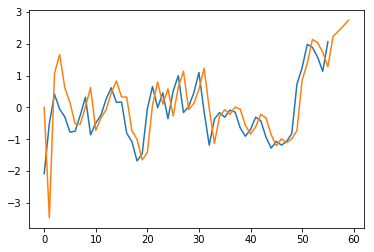

56 B01 Receivables
[2.3800498  3.0066198  3.44320259 3.45680816] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


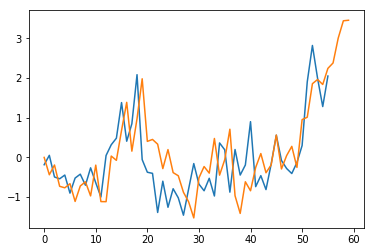

35 B03 Receivables
[  0.65116573 -21.15658784 -20.54547229 -19.10869022] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


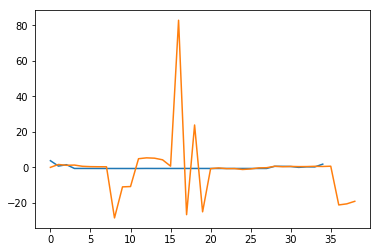

56 B05 Receivables
[0.49455054 0.49626835 0.4942119  0.49029848] $


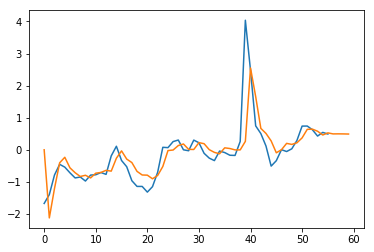

49 B07 Receivables
[ 1.07996799  0.40375605  0.63735743 -0.24685165] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


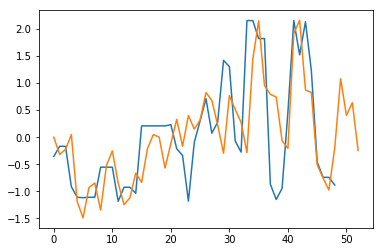

56 B08 Receivables
[-0.99662994 -0.97187217 -0.95272553 -0.93622436] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


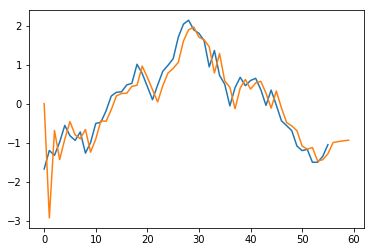

5 B11 Receivables
[-1.38354378 -1.66025254 -1.9369613  -2.21367005] $


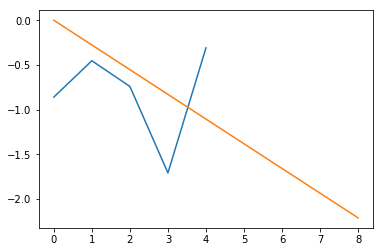

47 B13 Receivables
[-2.95428499 -5.25394387 -7.39573896 -9.14623765] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


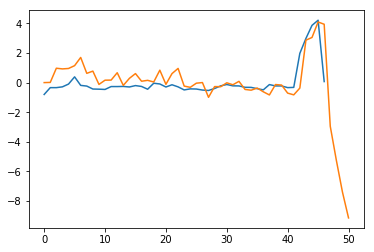

56 B15 Receivables
[-0.26095039 -0.25324386 -0.24556788 -0.23783051] $


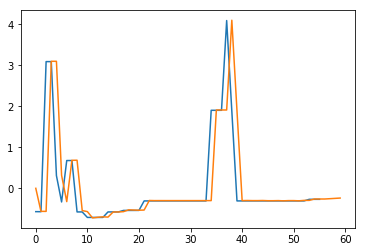

27 B17 Receivables
[-0.34404943 -0.52450923 -0.45954825 -0.51725245] $


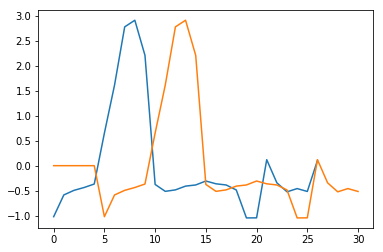

56 B23 Receivables
[-1.34734788 -0.96828585 -0.70136081 -0.62037309] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


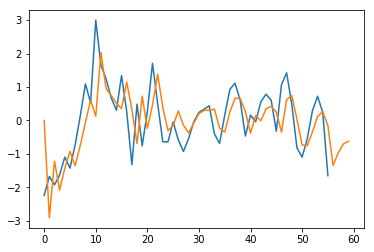

56 B25 Receivables
[2.71334889 2.69297584 2.67370476 2.67186547] $


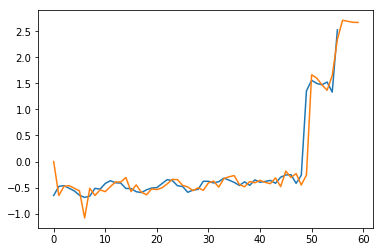

56 B27 Receivables
[1.12465114 1.1173393  1.10743523 1.09493893] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


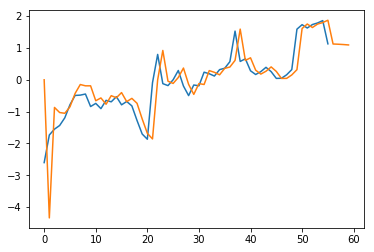

56 C02 Receivables
[1.53370429 1.11628063 1.03829534 1.13724421] $


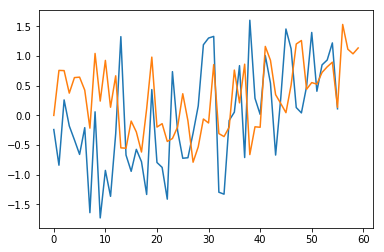

56 C06 Receivables
[0.66676714 0.79374076 0.70395452 0.69077838] $


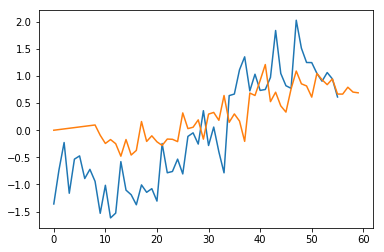

56 D04 Receivables
[-0.5589263  -0.8117217  -1.17317691 -1.56719597] $


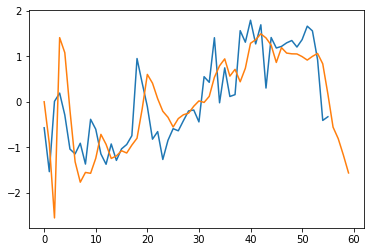

34 E02 Receivables
[0.39613859 1.18022598 1.71008084 2.74090733] $


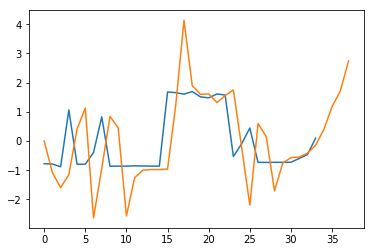

30 E03 Receivables
[-5.00688543e-03  9.83014970e-04 -5.81740463e-05 -1.03769615e-04] $


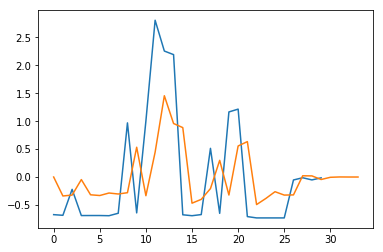

56 E09 Receivables
[1.20172241 1.33694535 1.4613121  1.40732728] $


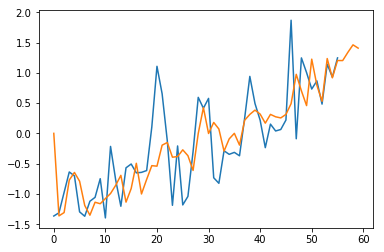

56 E12 Receivables
[1.88335166 1.7876055  1.55349418 1.82336356] $


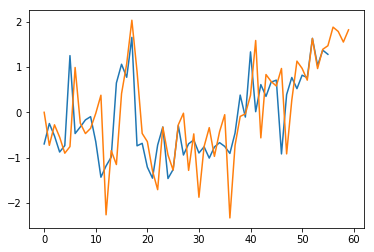

56 E16 Receivables
[0.26377522 0.07073068 0.19465608 0.07001732] $


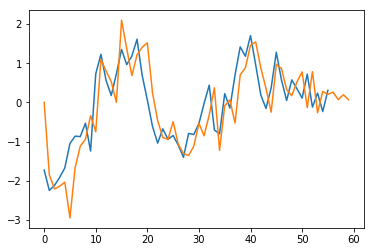

56 F02 Receivables
[-0.68816425 -0.70669483 -0.74075016 -0.77236831] $


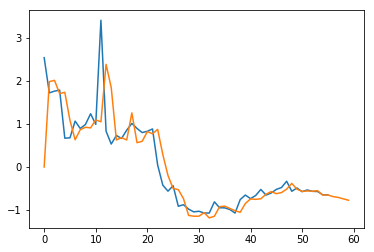

18 F04 Receivables
[0.20919996 0.23144851 0.24703814 0.25793683] $


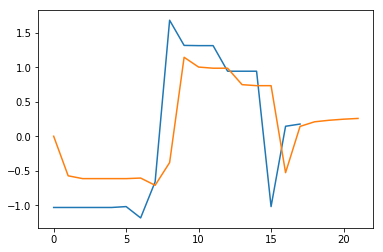

56 G01 Receivables
[-1.69940111 -1.93810579 -2.16796555 -2.41415592] $


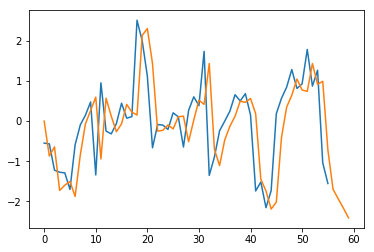

5 G03 Receivables
[-0.76952328 -0.92342794 -1.0773326  -1.23123725] $


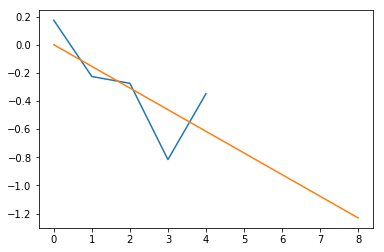

48 G08 Receivables
[-0.14838505 -0.19147816 -0.23443739 -0.27620954] $


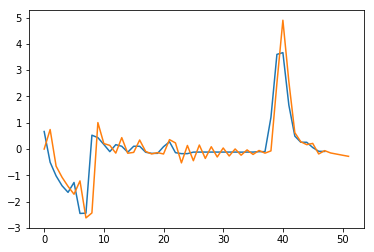

56 G10 Receivables
[-0.00143663 -0.02639577  0.00395697  0.01914351] $


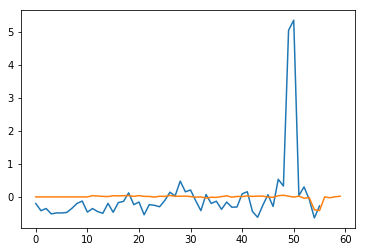

56 G12 Receivables
[2.61886838 1.88827487 2.75588206 2.56144307] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


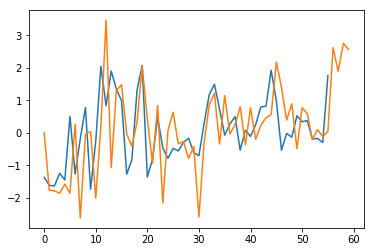

56 A01 Receivables
[ 0.26191372 -0.02752054  0.10676913  0.07430298] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


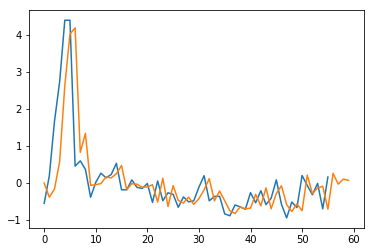

56 A03 Receivables
[2.22285468 2.38906717 2.559983   2.73568326] $


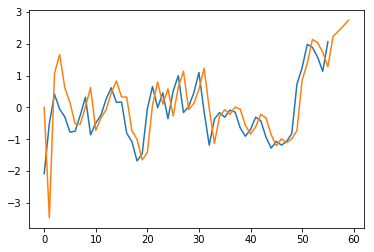

56 B01 Receivables
[2.3800498  3.0066198  3.44320259 3.45680816] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


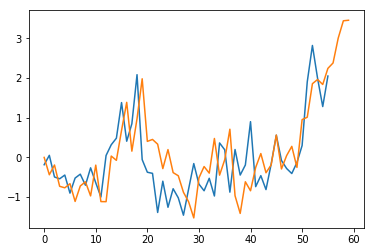

35 B03 Receivables


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


[  0.65116573 -21.15658784 -20.54547229 -19.10869022] $


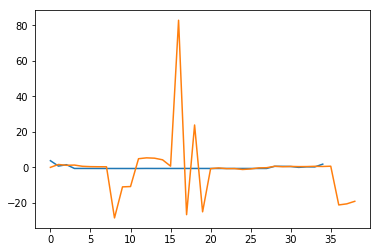

56 B05 Receivables
[0.49455054 0.49626835 0.4942119  0.49029848] $


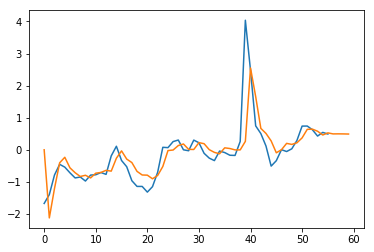

49 B07 Receivables
[ 1.07996799  0.40375605  0.63735743 -0.24685165] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


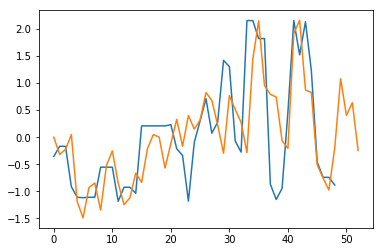

56 B08 Receivables
[-0.99662994 -0.97187217 -0.95272553 -0.93622436] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


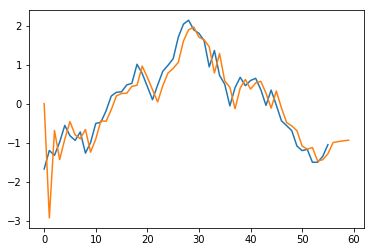

5 B11 Receivables
[-1.38354378 -1.66025254 -1.9369613  -2.21367005] $


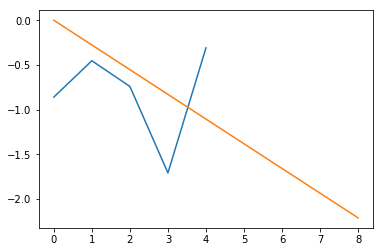

47 B13 Receivables
[-2.95428499 -5.25394387 -7.39573896 -9.14623765] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


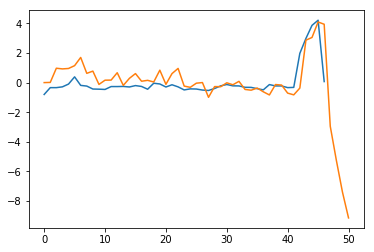

56 B15 Receivables
[-0.26095039 -0.25324386 -0.24556788 -0.23783051] $


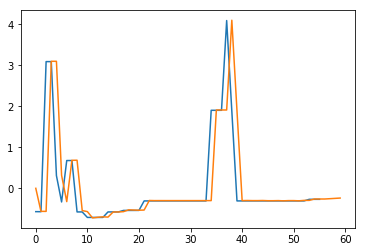

27 B17 Receivables
[-0.34404943 -0.52450923 -0.45954825 -0.51725245] $


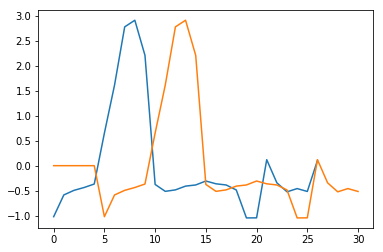

56 B23 Receivables
[-1.34734788 -0.96828585 -0.70136081 -0.62037309] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


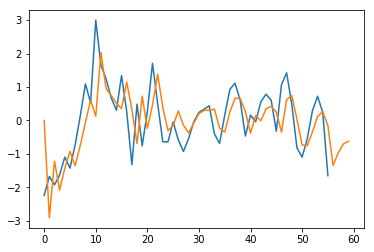

56 B25 Receivables
[2.71334889 2.69297584 2.67370476 2.67186547] $


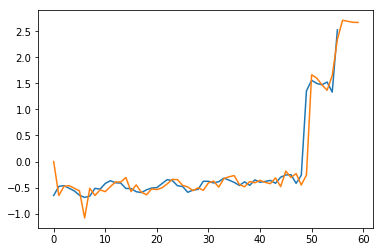

56 B27 Receivables
[1.12465114 1.1173393  1.10743523 1.09493893] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


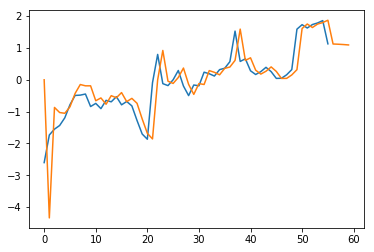

56 C02 Receivables
[1.53370429 1.11628063 1.03829534 1.13724421] $


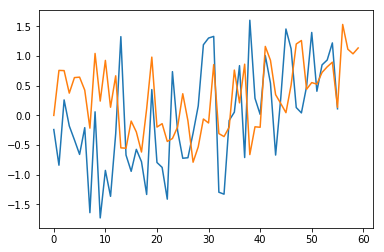

56 C06 Receivables
[0.66676714 0.79374076 0.70395452 0.69077838] $


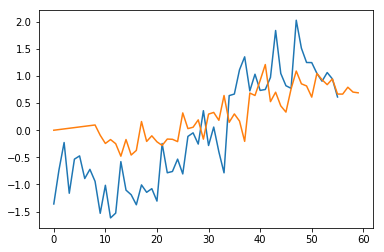

56 D04 Receivables
[-0.5589263  -0.8117217  -1.17317691 -1.56719597] $


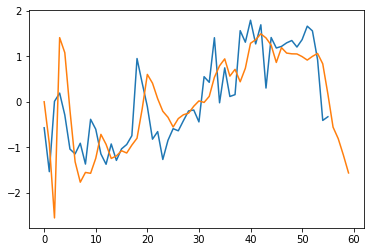

34 E02 Receivables
[0.39613859 1.18022598 1.71008084 2.74090733] $


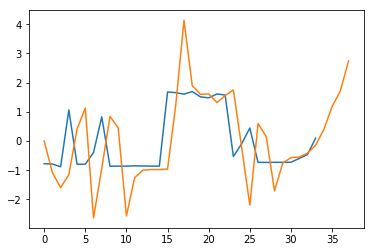

56 E09 Receivables
[1.20172241 1.33694535 1.4613121  1.40732728] $


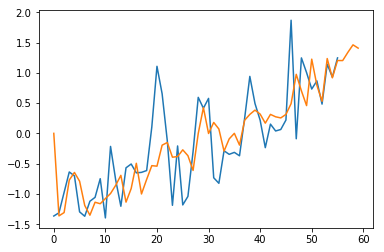

56 E12 Receivables
[1.88335166 1.7876055  1.55349418 1.82336356] $


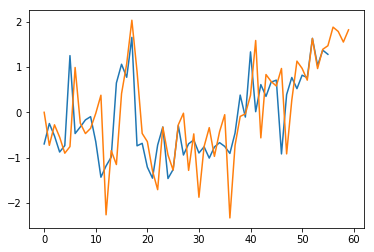

56 E16 Receivables
[0.26377522 0.07073068 0.19465608 0.07001732] $


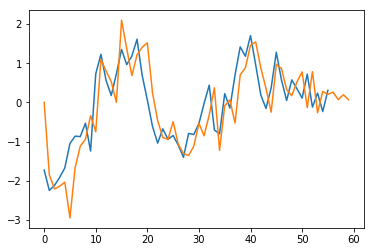

56 F02 Receivables
[-0.68816425 -0.70669483 -0.74075016 -0.77236831] $


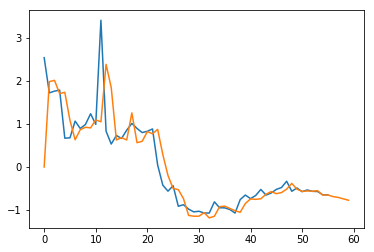

56 G01 Receivables
[-1.69940111 -1.93810579 -2.16796555 -2.41415592] $


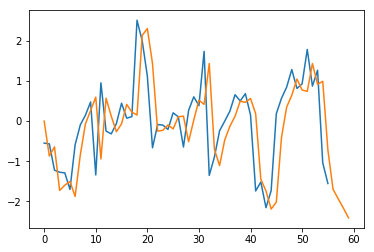

5 G03 Receivables
[-0.76952328 -0.92342794 -1.0773326  -1.23123725] $


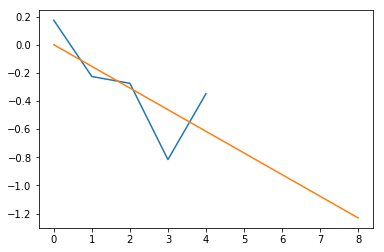

48 G08 Receivables
[-0.14838505 -0.19147816 -0.23443739 -0.27620954] $


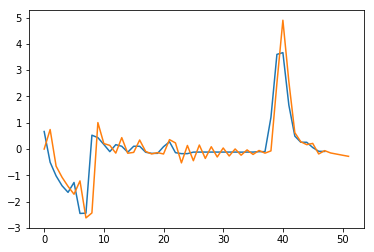

56 G10 Receivables
[-0.00143663 -0.02639577  0.00395697  0.01914351] $


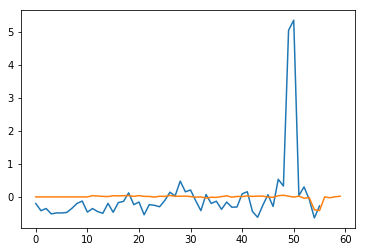

56 G12 Receivables
[2.61886838 1.88827487 2.75588206 2.56144307] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


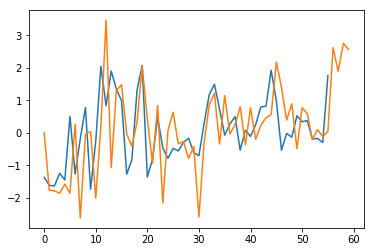

56 A01 Receivables
[ 0.26191372 -0.02752054  0.10676913  0.07430298] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


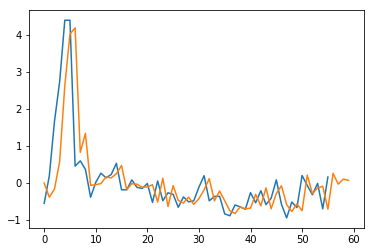

56 A03 Receivables
[2.22285468 2.38906717 2.559983   2.73568326] $


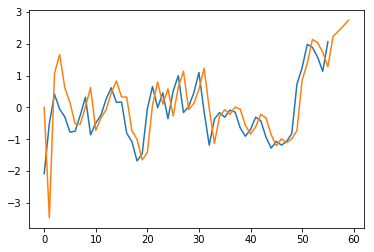

56 B01 Receivables
[2.3800498  3.0066198  3.44320259 3.45680816] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


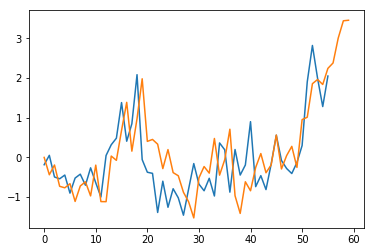

35 B03 Receivables
[  0.65116573 -21.15658784 -20.54547229 -19.10869022] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


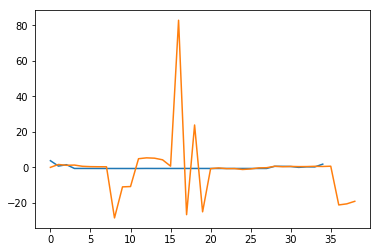

56 B05 Receivables
[0.49455054 0.49626835 0.4942119  0.49029848] $


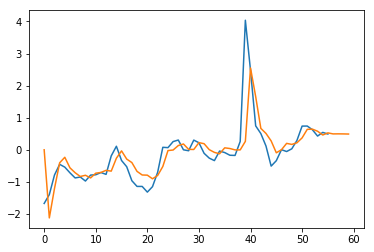

49 B07 Receivables


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


[ 1.07996799  0.40375605  0.63735743 -0.24685165] $


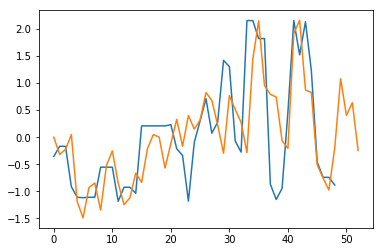

56 B08 Receivables
[-0.99662994 -0.97187217 -0.95272553 -0.93622436] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


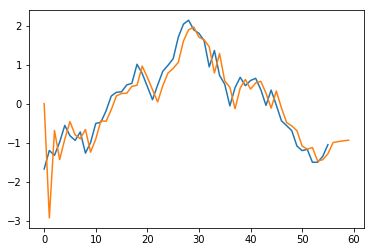

5 B11 Receivables
[-1.38354378 -1.66025254 -1.9369613  -2.21367005] $


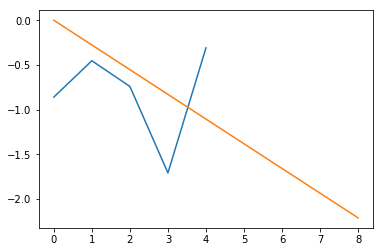

47 B13 Receivables
[-2.95428499 -5.25394387 -7.39573896 -9.14623765] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


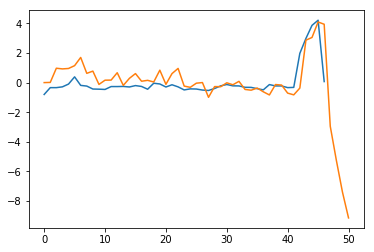

56 B15 Receivables
[-0.26095039 -0.25324386 -0.24556788 -0.23783051] $


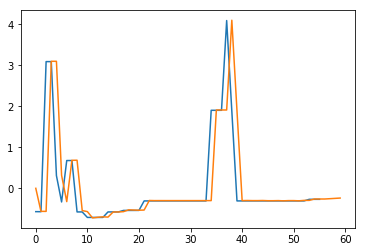

27 B17 Receivables
[-0.34404943 -0.52450923 -0.45954825 -0.51725245] $


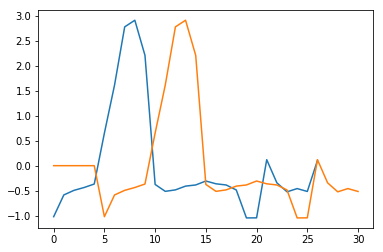

1 B19 Receivables
-1
56 B23 Receivables
[-1.34734788 -0.96828585 -0.70136081 -0.62037309] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


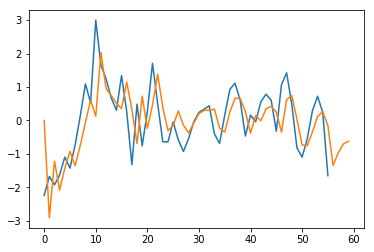

56 B25 Receivables
[2.71334889 2.69297584 2.67370476 2.67186547] $


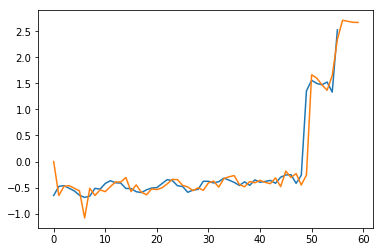

56 B27 Receivables
[1.12465114 1.1173393  1.10743523 1.09493893] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


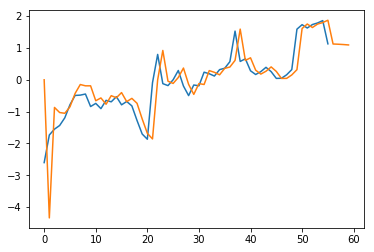

56 C02 Receivables
[1.53370429 1.11628063 1.03829534 1.13724421] $


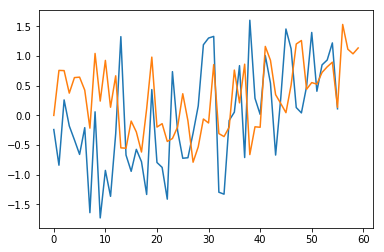

56 C06 Receivables
[0.66676714 0.79374076 0.70395452 0.69077838] $


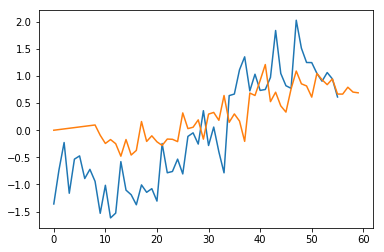

35 C09 Receivables
[-0.01766117 -0.95114081 -1.12276605 -1.01302999] $


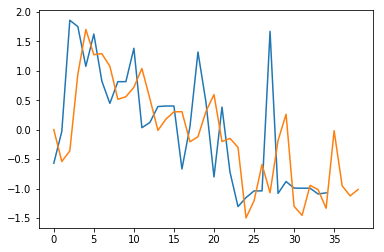

56 D04 Receivables
[-0.5589263  -0.8117217  -1.17317691 -1.56719597] $


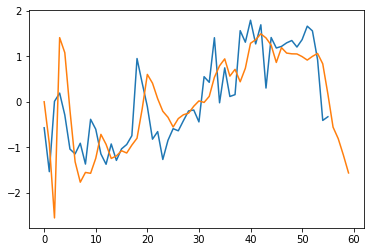

34 E02 Receivables
[0.39613859 1.18022598 1.71008084 2.74090733] $


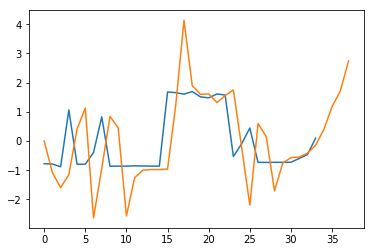

56 E09 Receivables
[1.20172241 1.33694535 1.4613121  1.40732728] $


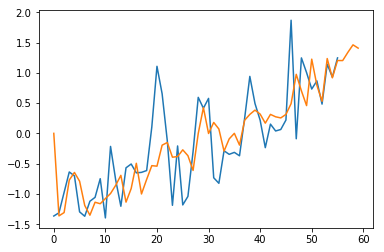

56 E12 Receivables
[1.88335166 1.7876055  1.55349418 1.82336356] $


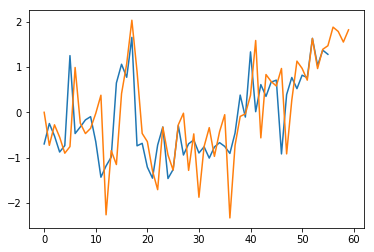

56 E16 Receivables
[0.26377522 0.07073068 0.19465608 0.07001732] $


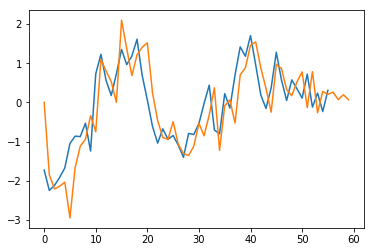

56 F02 Receivables
[-0.68816425 -0.70669483 -0.74075016 -0.77236831] $


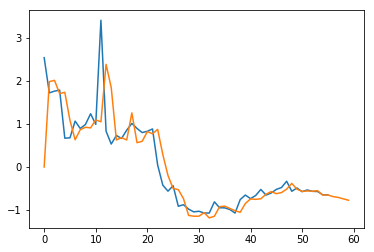

56 G01 Receivables
[-1.69940111 -1.93810579 -2.16796555 -2.41415592] $


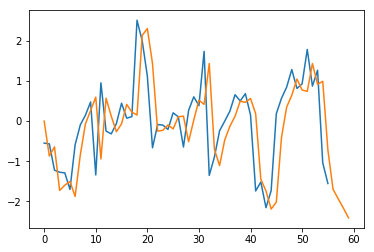

5 G03 Receivables
[-0.76952328 -0.92342794 -1.0773326  -1.23123725] $


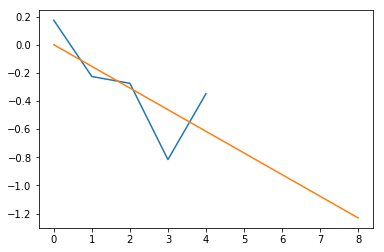

48 G08 Receivables
[-0.14838505 -0.19147816 -0.23443739 -0.27620954] $


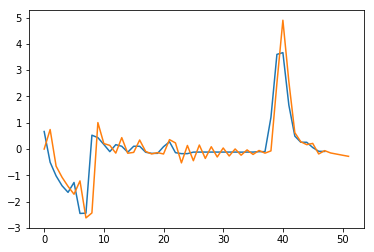

56 G10 Receivables
[-0.00143663 -0.02639577  0.00395697  0.01914351] $


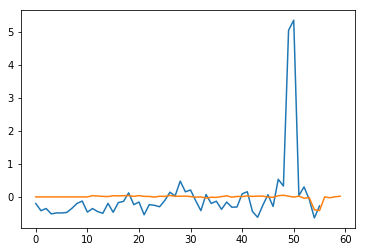

56 G12 Receivables
[2.61886838 1.88827487 2.75588206 2.56144307] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


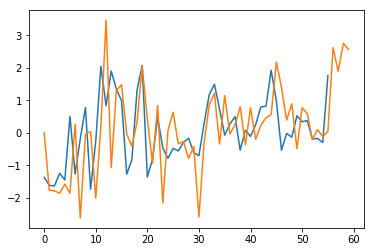

56 A01 Returns and Rebates
[ 0.2046399  -0.38801333 -0.23825107 -0.39180838] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


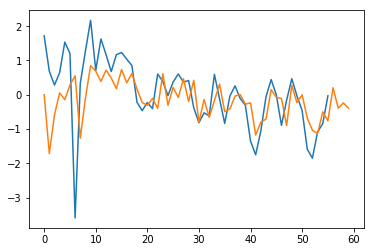

56 A03 Returns and Rebates
[-2.87130131 -2.99419665 -3.90249372 -3.9591801 ] $


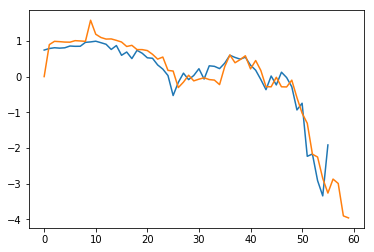

44 B01 Returns and Rebates
[-1.36996197 -1.58738475 -1.80993778 -1.88095543] $


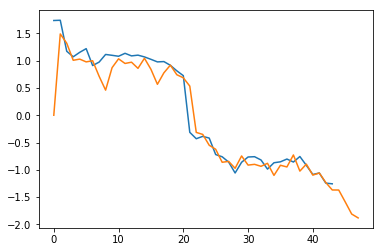

56 B03 Returns and Rebates
[-1.35646812 -1.49987269 -1.60897096 -1.58752161] $


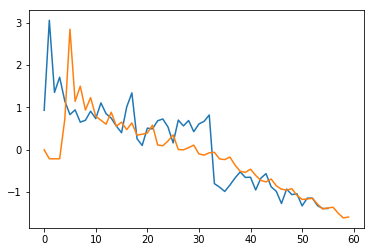

56 B05 Returns and Rebates
[-1.91634035 -2.15896408 -2.13422176 -2.33166385] $


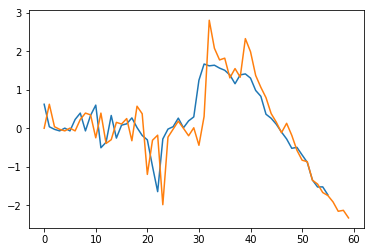

49 B07 Returns and Rebates
[-1.58039514 -1.56436716 -1.64205831 -2.05953062] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


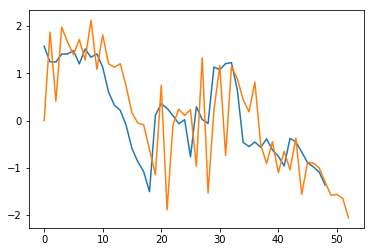

56 B08 Returns and Rebates
[-1.54522507 -1.77829237 -1.78829967 -1.65160013] $


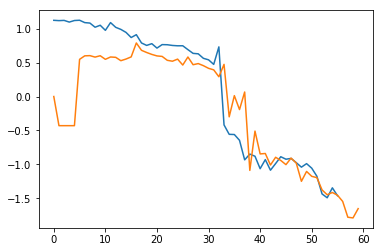

5 B11 Returns and Rebates
[-1.7804879  -2.13658548 -2.49268306 -2.84878064] $


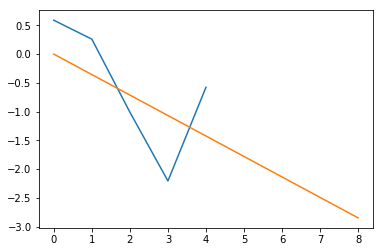

56 B17 Returns and Rebates
[-1.25991363 -1.33819914 -1.4454137  -1.65139304] $


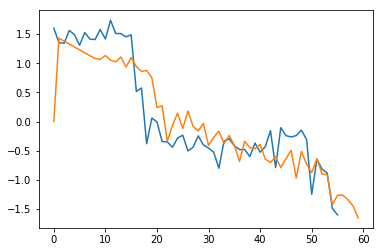

53 B23 Returns and Rebates
[-0.95332562 -1.03840198 -1.05682892 -1.0688352 ] $


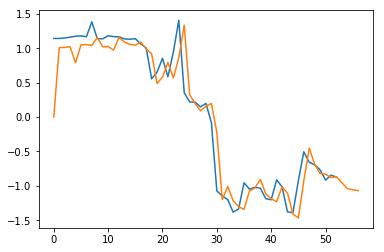

56 B25 Returns and Rebates
[-1.9020591  -1.93649208 -2.19907129 -2.28313816] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


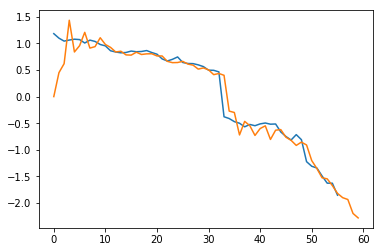

56 B27 Returns and Rebates
[-1.20650032 -1.2002805  -1.29489774 -1.33917979] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


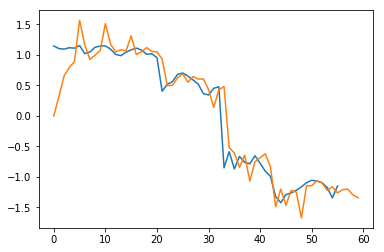

56 C02 Returns and Rebates
[-1.03404142 -1.23750865 -1.44944215 -1.66984192] $


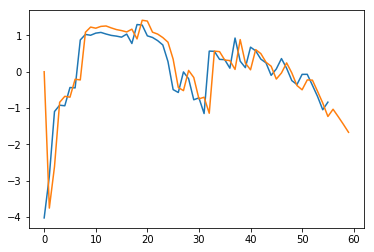

56 C06 Returns and Rebates
[-1.16562414 -0.25267723  0.4206168  -0.05455636] $


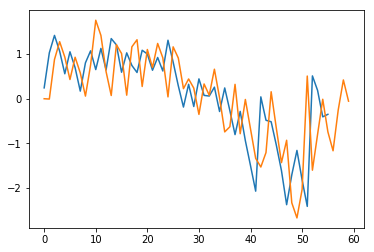

56 D04 Returns and Rebates
[-0.58540159 -0.63660345 -0.63871135 -0.6332052 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


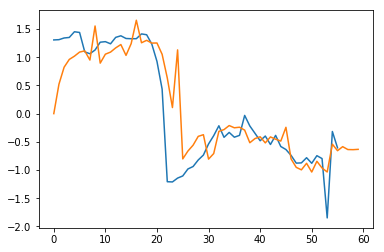

8 E09 Returns and Rebates
[0. 0. 0. 0.] $


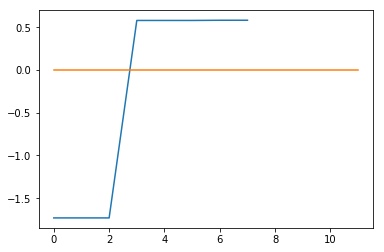

56 G01 Returns and Rebates
[-2.14657295 -2.29883895 -2.36460025 -2.44043418] $


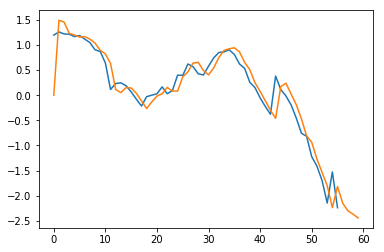

5 G03 Returns and Rebates
[-1.67074724 -2.00489668 -2.33904613 -2.67319558] $


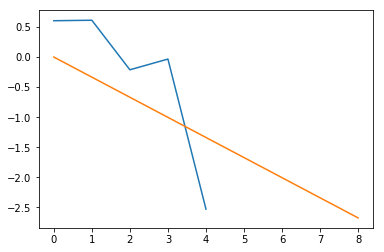

56 G08 Returns and Rebates
[-0.83119017 -1.06399537 -0.97365901 -1.061194  ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


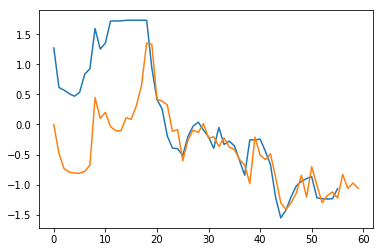

56 G10 Returns and Rebates
[-0.49640845 -0.2664895  -0.11586938 -0.03338645] $


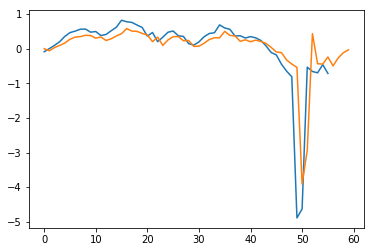

36 G12 Returns and Rebates
[0.26930948 0.28963783 0.22785762 0.25772818] $


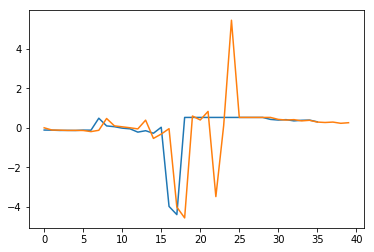

56 A01 Returns and Rebates
[ 0.2046399  -0.38801333 -0.23825107 -0.39180838] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


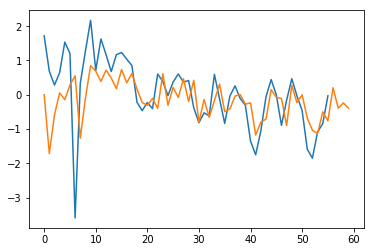

56 A03 Returns and Rebates
[-2.87130131 -2.99419665 -3.90249372 -3.9591801 ] $


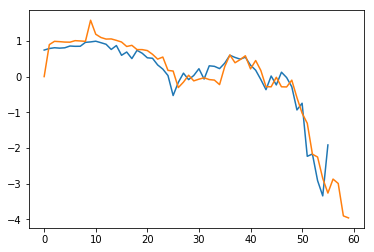

44 B01 Returns and Rebates
[-1.36996197 -1.58738475 -1.80993778 -1.88095543] $


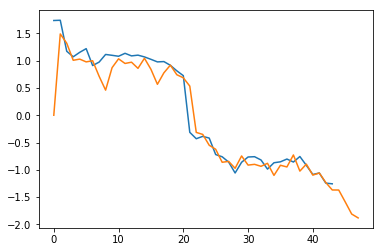

56 B03 Returns and Rebates
[-1.35646812 -1.49987269 -1.60897096 -1.58752161] $


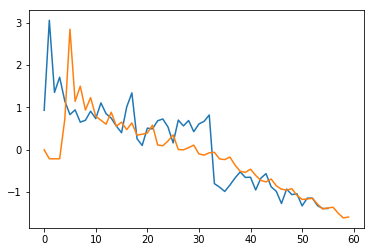

56 B05 Returns and Rebates
[-1.91634035 -2.15896408 -2.13422176 -2.33166385] $


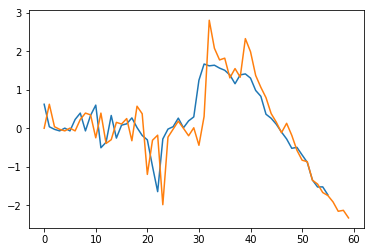

49 B07 Returns and Rebates
[-1.58039514 -1.56436716 -1.64205831 -2.05953062] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


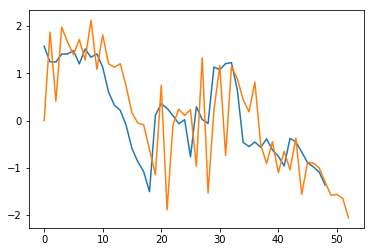

56 B08 Returns and Rebates
[-1.54522507 -1.77829237 -1.78829967 -1.65160013] $


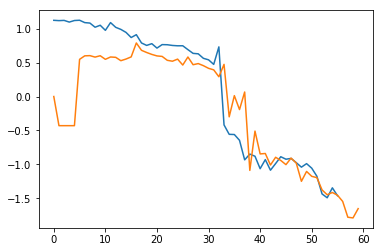

5 B11 Returns and Rebates
[-1.7804879  -2.13658548 -2.49268306 -2.84878064] $


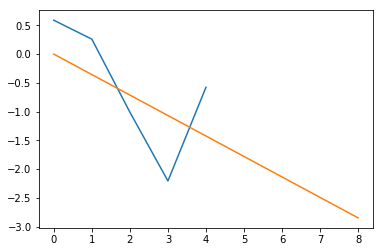

56 B17 Returns and Rebates
[-1.25991363 -1.33819914 -1.4454137  -1.65139304] $


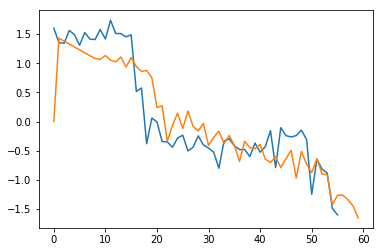

53 B23 Returns and Rebates
[-0.95332562 -1.03840198 -1.05682892 -1.0688352 ] $


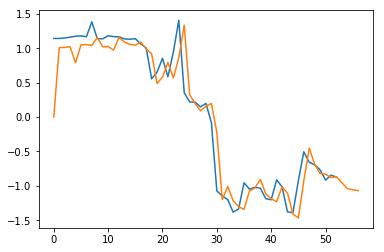

56 B25 Returns and Rebates
[-1.9020591  -1.93649208 -2.19907129 -2.28313816] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


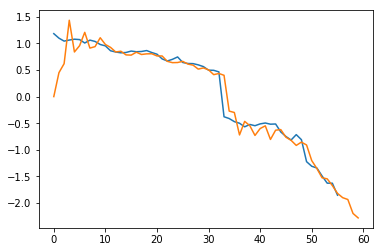

56 B27 Returns and Rebates
[-1.20650032 -1.2002805  -1.29489774 -1.33917979] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


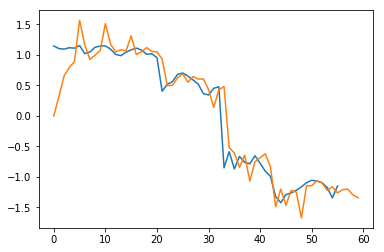

56 C02 Returns and Rebates
[-1.03404142 -1.23750865 -1.44944215 -1.66984192] $


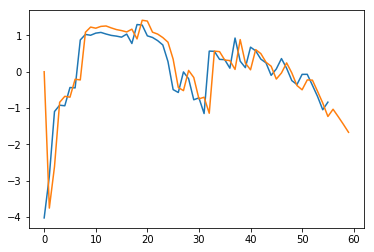

56 C06 Returns and Rebates
[-1.16562414 -0.25267723  0.4206168  -0.05455636] $


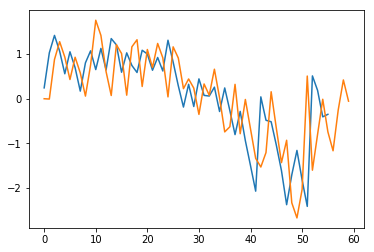

56 D04 Returns and Rebates
[-0.58540159 -0.63660345 -0.63871135 -0.6332052 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


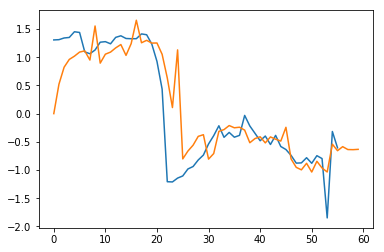

8 E09 Returns and Rebates
[0. 0. 0. 0.] $


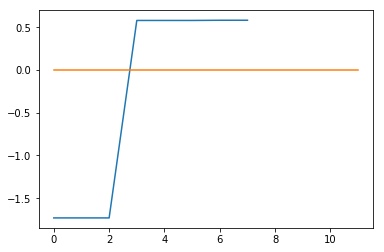

56 G01 Returns and Rebates
[-2.14657295 -2.29883895 -2.36460025 -2.44043418] $


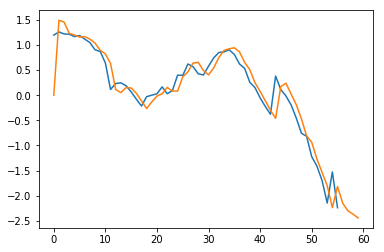

5 G03 Returns and Rebates
[-1.67074724 -2.00489668 -2.33904613 -2.67319558] $


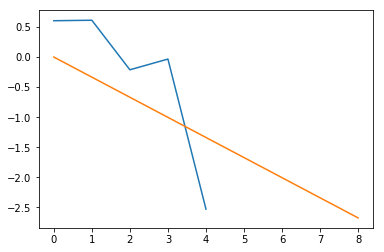

56 G08 Returns and Rebates
[-0.83119017 -1.06399537 -0.97365901 -1.061194  ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


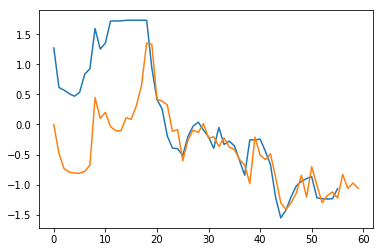

56 G10 Returns and Rebates
[-0.49640845 -0.2664895  -0.11586938 -0.03338645] $


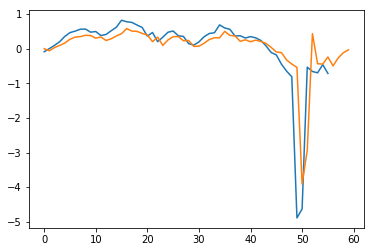

36 G12 Returns and Rebates
[0.26930948 0.28963783 0.22785762 0.25772818] $


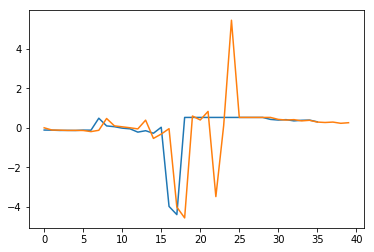

56 A01 Returns and Rebates
[ 0.2046399  -0.38801333 -0.23825107 -0.39180838] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


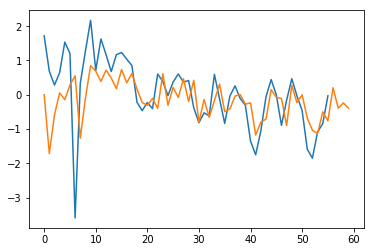

56 A03 Returns and Rebates
[-2.87130131 -2.99419665 -3.90249372 -3.9591801 ] $


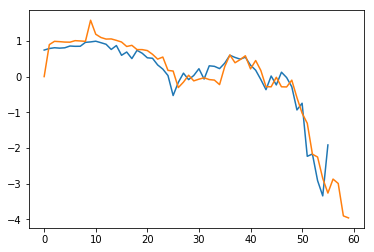

44 B01 Returns and Rebates
[-1.36996197 -1.58738475 -1.80993778 -1.88095543] $


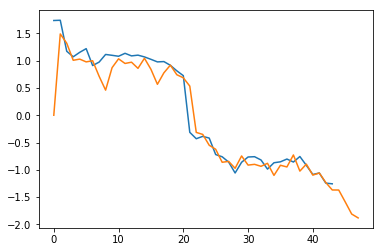

56 B03 Returns and Rebates
[-1.35646812 -1.49987269 -1.60897096 -1.58752161] $


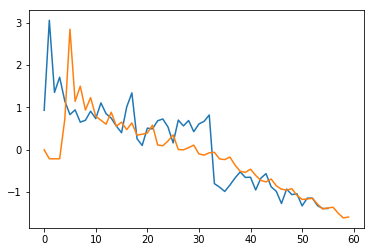

56 B05 Returns and Rebates
[-1.91634035 -2.15896408 -2.13422176 -2.33166385] $


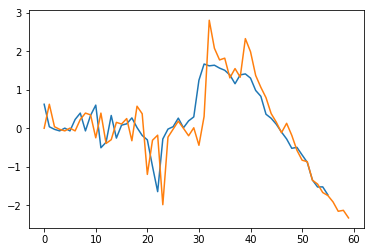

49 B07 Returns and Rebates
[-1.58039514 -1.56436716 -1.64205831 -2.05953062] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


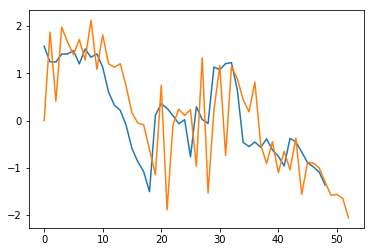

56 B08 Returns and Rebates
[-1.54522507 -1.77829237 -1.78829967 -1.65160013] $


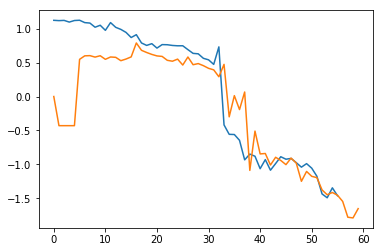

5 B11 Returns and Rebates
[-1.7804879  -2.13658548 -2.49268306 -2.84878064] $


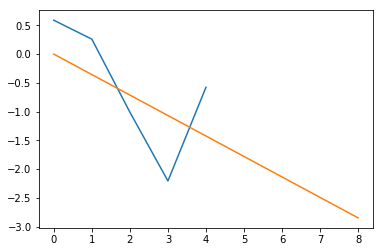

56 B17 Returns and Rebates
[-1.25991363 -1.33819914 -1.4454137  -1.65139304] $


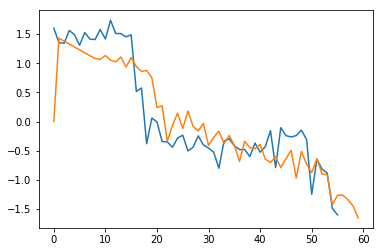

53 B23 Returns and Rebates
[-0.95332562 -1.03840198 -1.05682892 -1.0688352 ] $


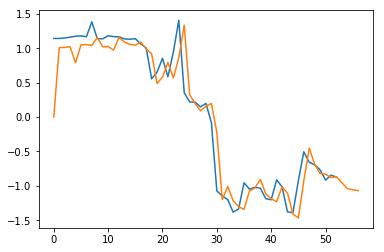

56 B25 Returns and Rebates
[-1.9020591  -1.93649208 -2.19907129 -2.28313816] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


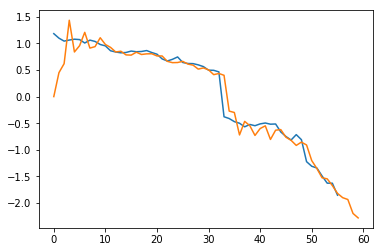

56 B27 Returns and Rebates
[-1.20650032 -1.2002805  -1.29489774 -1.33917979] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


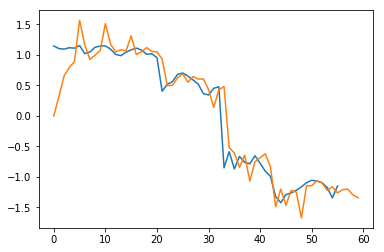

56 C02 Returns and Rebates
[-1.03404142 -1.23750865 -1.44944215 -1.66984192] $


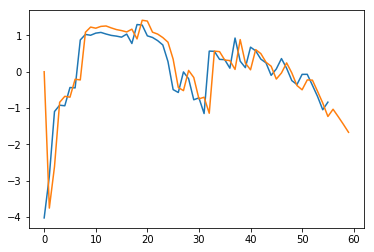

56 C06 Returns and Rebates
[-1.16562414 -0.25267723  0.4206168  -0.05455636] $


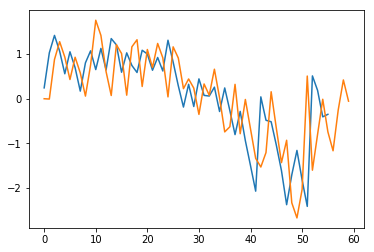

56 D04 Returns and Rebates
[-0.58540159 -0.63660345 -0.63871135 -0.6332052 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


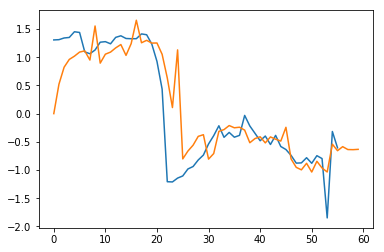

8 E09 Returns and Rebates
[0. 0. 0. 0.] $


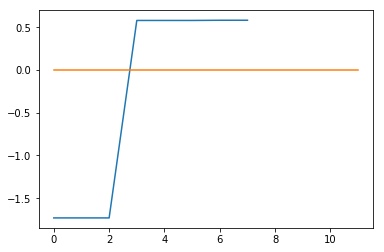

56 G01 Returns and Rebates
[-2.14657295 -2.29883895 -2.36460025 -2.44043418] $


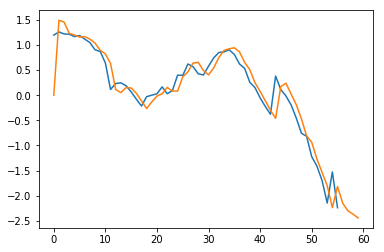

5 G03 Returns and Rebates
[-1.67074724 -2.00489668 -2.33904613 -2.67319558] $


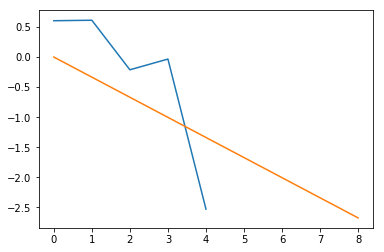

56 G08 Returns and Rebates
[-0.83119017 -1.06399537 -0.97365901 -1.061194  ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


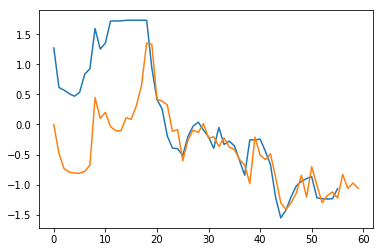

56 G10 Returns and Rebates
[-0.49640845 -0.2664895  -0.11586938 -0.03338645] $


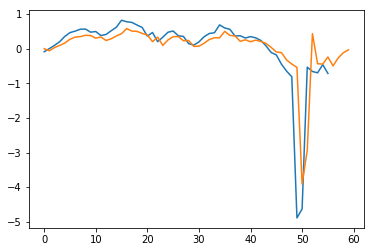

36 G12 Returns and Rebates
[0.26930948 0.28963783 0.22785762 0.25772818] $


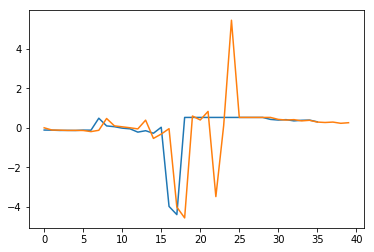

56 A01 Returns and Rebates
[ 0.2046399  -0.38801333 -0.23825107 -0.39180838] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


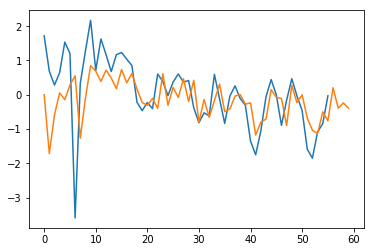

56 A03 Returns and Rebates
[-2.87130131 -2.99419665 -3.90249372 -3.9591801 ] $


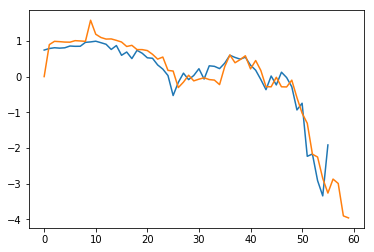

44 B01 Returns and Rebates
[-1.36996197 -1.58738475 -1.80993778 -1.88095543] $


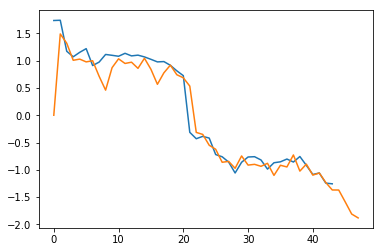

56 B03 Returns and Rebates
[-1.35646812 -1.49987269 -1.60897096 -1.58752161] $


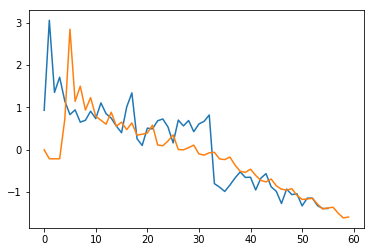

56 B05 Returns and Rebates
[-1.91634035 -2.15896408 -2.13422176 -2.33166385] $


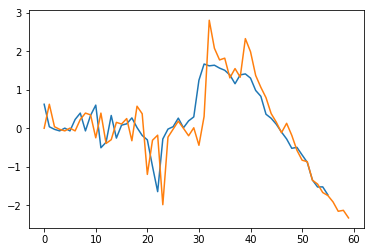

49 B07 Returns and Rebates
[-1.58039514 -1.56436716 -1.64205831 -2.05953062] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


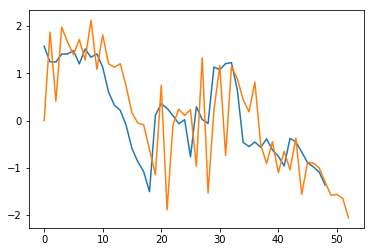

56 B08 Returns and Rebates
[-1.54522507 -1.77829237 -1.78829967 -1.65160013] $


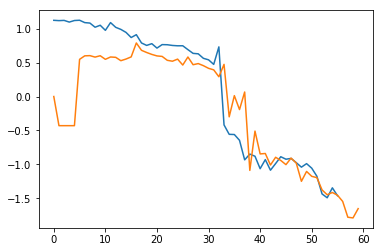

5 B11 Returns and Rebates
[-1.7804879  -2.13658548 -2.49268306 -2.84878064] $


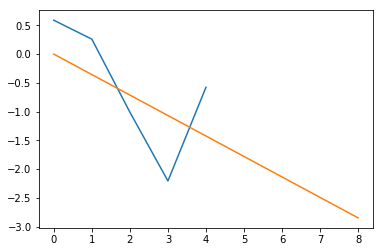

56 B17 Returns and Rebates
[-1.25991363 -1.33819914 -1.4454137  -1.65139304] $


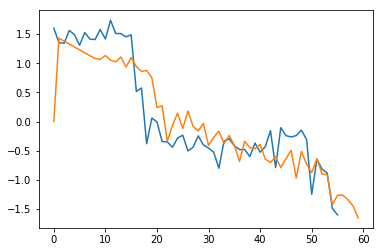

53 B23 Returns and Rebates
[-0.95332562 -1.03840198 -1.05682892 -1.0688352 ] $


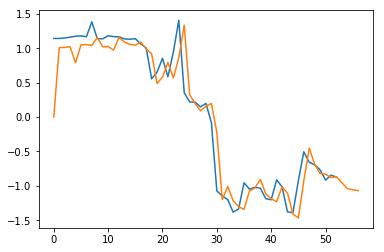

56 B25 Returns and Rebates
[-1.9020591  -1.93649208 -2.19907129 -2.28313816] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


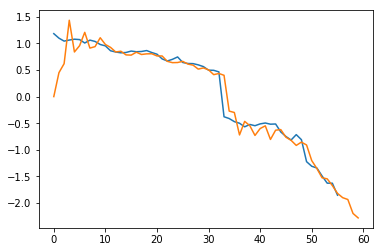

56 B27 Returns and Rebates
[-1.20650032 -1.2002805  -1.29489774 -1.33917979] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


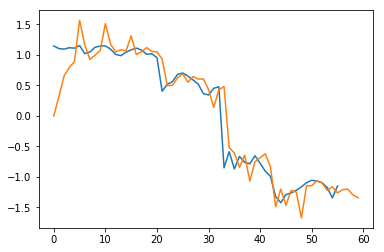

56 C02 Returns and Rebates
[-1.03404142 -1.23750865 -1.44944215 -1.66984192] $


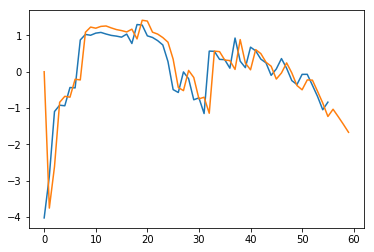

56 C06 Returns and Rebates
[-1.16562414 -0.25267723  0.4206168  -0.05455636] $


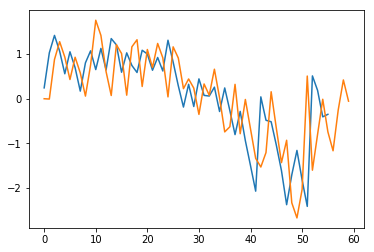

56 D04 Returns and Rebates
[-0.58540159 -0.63660345 -0.63871135 -0.6332052 ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


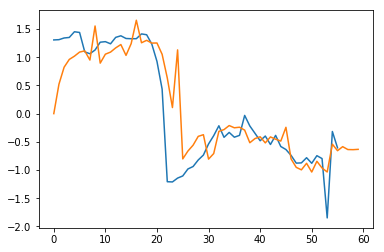

8 E09 Returns and Rebates
[0. 0. 0. 0.] $


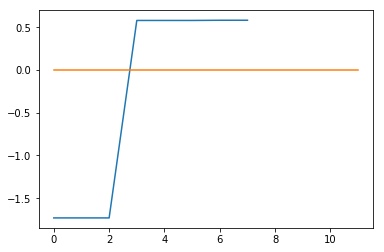

56 G01 Returns and Rebates
[-2.14657295 -2.29883895 -2.36460025 -2.44043418] $


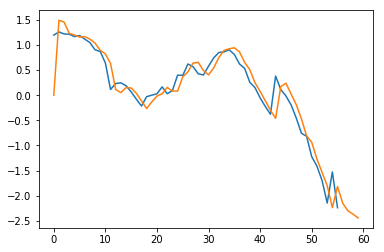

5 G03 Returns and Rebates
[-1.67074724 -2.00489668 -2.33904613 -2.67319558] $


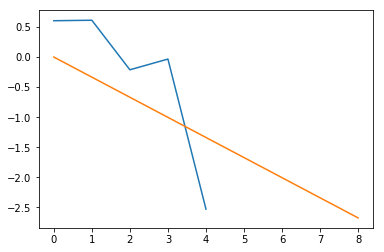

56 G08 Returns and Rebates
[-0.83119017 -1.06399537 -0.97365901 -1.061194  ] $


C:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:508: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  "Check mle_retvals", ConvergenceWarning)


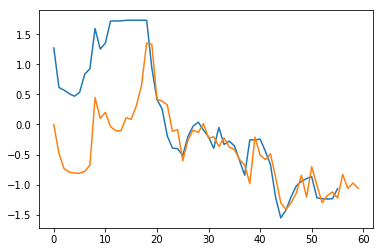

56 G10 Returns and Rebates
[-0.49640845 -0.2664895  -0.11586938 -0.03338645] $


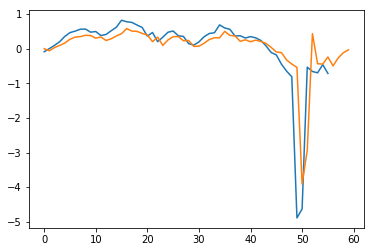

36 G12 Returns and Rebates
[0.26930948 0.28963783 0.22785762 0.25772818] $


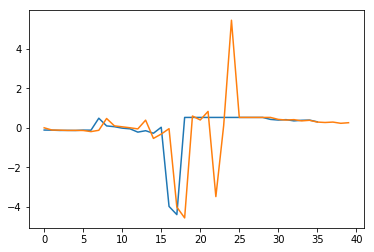

In [8]:
#This is used for predicting or forecasting the values from the selected parameters
#here below I have plotted the curve between the actual and the forecasted values 

market_map = df_test[a[6]].unique()
save_res = []
mar=[]
final_values=[]       #here final values will store the output in the serialized manner
j_val = []
account_map = ['Inventory', 'Payables and Accruals', 'Receivables', 'Returns and Rebates']

for i in range (0,len(df_test)):
    
    if(i>0):
        
        if(int(mar[len(mar)-1:][0])==0):
            final_values.append(0)
            j_val.append(-1)
            
    mar.append(0)
    
    for j in range (0,len(combine_parameter)):
        
        if(df_test['Account-Mapping'][i] == combine_parameter['account_map_m'][j] and df_test['Market-Mapping'][i] == combine_parameter['market_map_m'][j]):
        
        #    if(combine_parameter.iloc[wq,3] ==  market   and  combine_parameter.iloc[wq,4] == account):
        
                param = combine_parameter.iloc[j,0]
                param_seasonal = combine_parameter.iloc[j,1]
                trend = combine_parameter.iloc[j,2]
                                    #break
                j_val.append(j)
                filename = 'training_data.csv'
                transpos=[]
                account = df_test['Account-Mapping'][i]
                market = df_test['Market-Mapping'][i]
                
                with open(filename) as csvfile:
                    
                    reader = csv.DictReader(csvfile)
        
                    ret = {}
                    data = []
    
                    for row in reader:
            
                        if 'Version' in row and row['Version'] != 'ACT':
                            continue
                    
                        if 'Account-Mapping' in row and row['Account-Mapping'] != account:
                            continue
                
                        if 'Acc2-Mapping' in row and row['Acc2-Mapping'] != 'Working Capital':
                            continue
                
                        if 'Market-Mapping' in row and row['Market-Mapping'] != market:
                            continue
    
                        element = row['Account-Mapping']
                        market = row['Market-Mapping']
                        date = row['Year-mapping'] + '-' + row['Month-mapping']
                        month_map = row['Month-mapping']
                        year_map = row['Year-mapping']
                
                        try:
                        
                            value = float(row['Adj_Value_Sum'])
                            
                        except:
                            
                            cast_failed += 1
                            value = 0
                            
                        ret[(element, market, date)] = value
                        transpos.append(value)                 #storing data of given unique variable
                        
           #     data.append((element, market, date, value))
                        data.append((element, market, date,value,month_map,year_map))
            
                    print(len(data),market,account)
                        
                try:
                    
                    #fitting the model
                    
                    param_seasonal = (int(param_seasonal[1]),int(param_seasonal[4]),int(param_seasonal[7]),int(param_seasonal[10]))
                    param = (int(param[1]),int(param[4]),int(param[7]))
                    mod = sm.tsa.statespace.SARIMAX(transpos[:],
                                                        order=param,
                                                        trend=trend,
                                                        seasonal_order=param_seasonal,
                                                        enforce_stationarity=False,
                                                        enforce_invertibility=False)
                #    print(3)
                    
                    #predicting the test results and plotting their curves
                    results = mod.fit()              
                    hh = results.predict(start=0,end=len(transpos)+3,dynamic=False)
                    print(hh[len(hh)-4:],'$')
                    mar[-1]=1
                    plt.plot(transpos)
                    plt.plot(hh)
                    plt.show()
        #            save_res = save_res.append((hh))
                    
                    
                    final_values.append(hh[len(hh)-4 + int(df_test['Month-mapping'][i][1:])-3])
                                        
                except:
                    
      #              final_values.append(0)
                    print(-1)
                    continue
    
    
if(mar[len(mar)-1:]==0):
        final_values.append(0)

In [9]:
len(final_values)    

613

In [10]:
test_sheet=pd.read_csv('empty_test_sheet.csv')
test_sheet

,Account-Mapping,Acc2-Mapping,Version,Year-mapping,Month-mapping,Region-Mapping,Market-Mapping,Adj_Value_Sum
0,Inventory,Working Capital,ACT,Y6,M03,A,A01,NaN
1,Inventory,Working Capital,ACT,Y6,M03,A,A03,NaN
2,Inventory,Working Capital,ACT,Y6,M03,B,B01,NaN
3,Inventory,Working Capital,ACT,Y6,M03,B,B03,NaN
4,Inventory,Working Capital,ACT,Y6,M03,B,B05,NaN
5,Inventory,Working Capital,ACT,Y6,M03,B,B07,NaN
6,Inventory,Working Capital,ACT,Y6,M03,B,B08,NaN
7,Inventory,Working Capital,ACT,Y6,M03,B,B11,NaN
8,Inventory,Working Capital,ACT,Y6,M03,B,B13,NaN
9,Inventory,Working Capital,ACT,Y6,M03,B,B15,NaN


In [11]:
test_sheet['Adj_Value_Sum'] = final_values   
test_sheet                                 #final output

,Account-Mapping,Acc2-Mapping,Version,Year-mapping,Month-mapping,Region-Mapping,Market-Mapping,Adj_Value_Sum
0,Inventory,Working Capital,ACT,Y6,M03,A,A01,-0.386711
1,Inventory,Working Capital,ACT,Y6,M03,A,A03,0.027877
2,Inventory,Working Capital,ACT,Y6,M03,B,B01,-0.927226
3,Inventory,Working Capital,ACT,Y6,M03,B,B03,-1.620231
4,Inventory,Working Capital,ACT,Y6,M03,B,B05,0.436950
5,Inventory,Working Capital,ACT,Y6,M03,B,B07,-0.222383
6,Inventory,Working Capital,ACT,Y6,M03,B,B08,1.210311
7,Inventory,Working Capital,ACT,Y6,M03,B,B11,0.529868
8,Inventory,Working Capital,ACT,Y6,M03,B,B13,-0.520761
9,Inventory,Working Capital,ACT,Y6,M03,B,B15,1.359204


In [12]:
test_sheet.to_csv('test_sheet.csv',index = None)  #output file